In [1]:
# Standard libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sb
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error

# For Machine Learning (PyTorch)
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset

In [2]:
root = "AM_dataset_v2_ALL_bootstrap.xlsx"
main_df = pd.read_excel(root)

### Correlation Table

In [5]:
main_df.tail(3)

,BHN,σu,True Fracture σ,RA,True Fracture Strain,E,σf',b,εf',c
297,280,1000,1220,33,0.41,195,1220,-0.073,0.41,-0.060
298,430,1640,1779,38,0.89,195,1780,-0.067,0.32,-0.056
299,595,2240,2723,41,0.52,205,2725,-0.081,0.07,-0.060


Text(0.5, 1.0, 'Correlation Heatmap of Tensile inputs to Fatigue Constants')

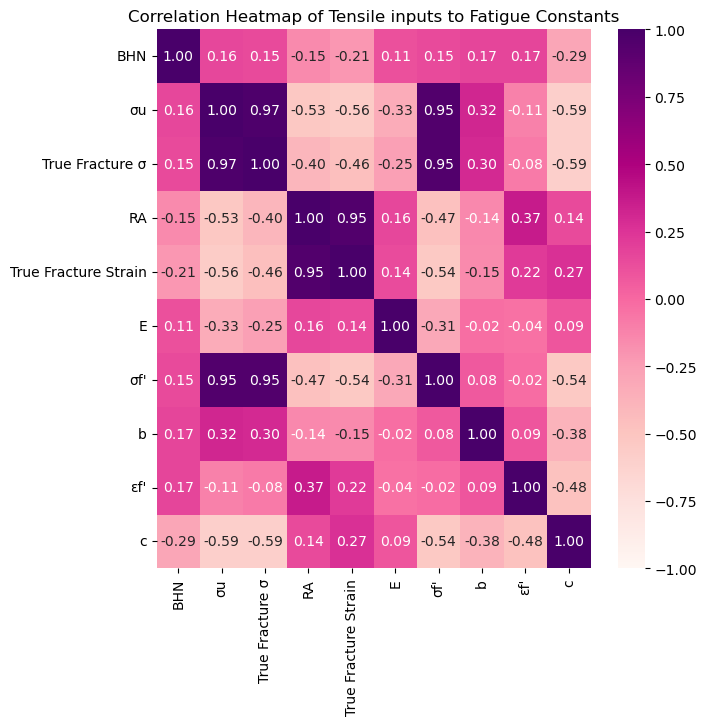

In [6]:
f, axes = plt.subplots(1, 1, figsize = (7, 7), sharey = True)

g2 = sb.heatmap(main_df.corr(), vmin = -1, vmax = 1, annot = True, fmt = ".2f", cmap = "RdPu")
g2.set_title("Correlation Heatmap of Tensile inputs to Fatigue Constants")

---

# GBR + DNN Model

### Function

In [7]:
def GBR_NN(variable):
    name_list = ["Sigmaf", "b", "Epsilonf", "c"]
    
    # 1. Prepare the data
    df_x = pd.read_excel(root,usecols=[0,1,2,3])
    df_y = pd.read_excel(root,usecols=[variable])
    
    X_train, X_test, y_train, y_test = train_test_split(df_x, df_y, test_size = 0.2, random_state = 42)
    
    y_train = np.array(y_train,dtype = np.float32).ravel()
    y_test = np.array(y_test,dtype = np.float32).ravel()
    
    # 2. Train the Gradient Boosting Regressor
    gbr = GradientBoostingRegressor(n_estimators = 10000, learning_rate = 0.01, max_depth = 2, random_state = 42, tol = 1e-5)
    gbr.fit(X_train, y_train)
    
    # Get the predictions from Gradient Boosting Regressor
    gbr_train_pred = gbr.predict(X_train)
    gbr_test_pred = gbr.predict(X_test)
    
    # Combine the original features and the GBR predictions as new inputs for the Neural Network
    X_train_nn = np.hstack([X_train, gbr_train_pred.reshape(-1, 1)])
    X_test_nn = np.hstack([X_test, gbr_test_pred.reshape(-1, 1)])
    
    # Convert data to PyTorch tensors
    X_train_tensor = torch.tensor(X_train_nn, dtype=torch.float32)
    y_train_tensor = torch.tensor(y_train, dtype=torch.float32).unsqueeze(1)
    X_test_tensor = torch.tensor(X_test_nn, dtype=torch.float32)
    y_test_tensor = torch.tensor(y_test, dtype=torch.float32).unsqueeze(1)
    
    # 3. Define a simple neural network in PyTorch
    class RegressionNN(nn.Module):
        def __init__(self, input_size):
            super(RegressionNN, self).__init__()
            self.fc1 = nn.Linear(input_size, 64)
            self.fc2 = nn.Linear(64, 128)
            self.fc3 = nn.Linear(128, 256)
            self.fc4 = nn.Linear(256, 128)
            self.fc5 = nn.Linear(128, 64)
            self.fc6 = nn.Linear(64, 1)
       
        def forward(self, x):
            x = torch.relu(self.fc1(x))
            x = torch.relu(self.fc2(x))
            x = torch.relu(self.fc3(x))
            x = torch.relu(self.fc4(x))
            x = torch.relu(self.fc5(x))
            x = self.fc6(x)
            return x
    
    # Create the neural network
    input_size = X_train_nn.shape[1]
    model = RegressionNN(input_size)
    
    # 4. Define loss function and optimizer
    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=0.001)

    # Regularization parameters
    lambda_l1 = 0   # L1 penalty strength
    lambda_l2 = 0   # L2 penalty strength

    # L2 can also be directly included in the optimizer as weight_decay
    optimizer = optim.Adam(model.parameters(), lr=0.0001, weight_decay=lambda_l2)
    
    plt.ion()
    
    # 5. Train the Neural Network
    n_epochs = 2000 # Default 1000
    for epoch in range(n_epochs):
        model.train()
       
        # Forward pass
        y_train_pred = model(X_train_tensor)
        y_test_pred  = model(X_test_tensor)
        loss = criterion(y_train_pred, y_train_tensor)
        
        #Note: L2 Regularization already handled in optimizer via weight_decay

        # Add L1 Regularization
        l1_norm = sum(param.abs().sum() for param in model.parameters())
        loss += lambda_l1 * l1_norm
       
        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        # Obtaining R2 scores for train and test datasets
        r2_train = r2_score(y_train_tensor.data.numpy(), y_train_pred.detach().numpy())
        r2_test  = r2_score(y_test_tensor.data.numpy(), y_test_pred.detach().numpy())

        if (epoch+1) % 20 == 0:
            print(f'[{name_list[variable-4]}] Epoch [{epoch+1}/{n_epochs}], Loss: {loss.item():.4f}')
            print("Train R²: ", "%.5f" % round(r2_train, 5))
            print("Test R² : ", "%.5f" % round(r2_test, 5))

            fig, axes = plt.subplots(2, 2, figsize = (7,5))
            axes[0, 0].scatter(y_train_tensor, y_train_pred.detach().numpy())
            axes[0, 0].plot([min(y_train_tensor.data.numpy()), max(y_train_tensor.data.numpy())],[min(y_train_tensor.data.numpy()), max(y_train_tensor.data.numpy())], color = 'r')
            axes[0, 0].set_title("Training Data")
            axes[0, 0].set_xlabel("Actual values")
            axes[0, 0].set_ylabel("Predicted values")
    
            axes[0, 1].scatter(y_test_tensor, y_test_pred.detach().numpy())
            axes[0, 1].plot([min(y_test_tensor.data.numpy()), max(y_test_tensor.data.numpy())],[min(y_test_tensor.data.numpy()), max(y_test_tensor.data.numpy())], color = 'r')
            axes[0, 1].set_title("Test Data")
            axes[0, 1].set_xlabel("Actual values")
            axes[0, 1].set_ylabel("Predicted values")
    
            # axes[1, 0].plot(y_train_tensor.data.numpy().squeeze()*10,'tab:orange', label = 'real')
            # axes[1, 0].plot(y_train_pred.detach().numpy()*10,'tab:green',label = 'pred')
            # axes[1, 0].set_xlabel("Sample Number")
            # axes[1, 0].set_ylabel("Fatigue Constant Value")
            # axes[1, 0].legend()
    
            # axes[1, 1].plot(y_test_tensor.data.numpy().squeeze()*10, 'tab:orange',label = 'real')
            # axes[1, 1].plot(y_test_pred.detach().numpy()*10,'tab:green',label = 'pred')
            # axes[1, 1].set_xlabel("Sample Number")
            # axes[1, 1].set_ylabel("Fatigue Constant Value")
            # axes[1, 1].legend()

            plt.tight_layout()
            
            plt.show()
    
            plt.draw();plt.pause(0.05)
    
    plt.ioff()
    plt.show()

### Variable Testing

[Sigmaf] Epoch [20/2000], Loss: 1994851.0000
Train R²:  -0.68890
Test R² :  -1.08806


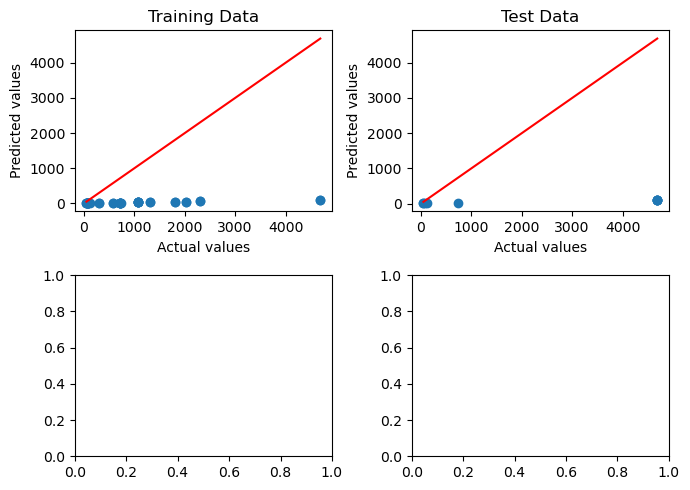

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [40/2000], Loss: 1824789.0000
Train R²:  -0.54492
Test R² :  -0.93090


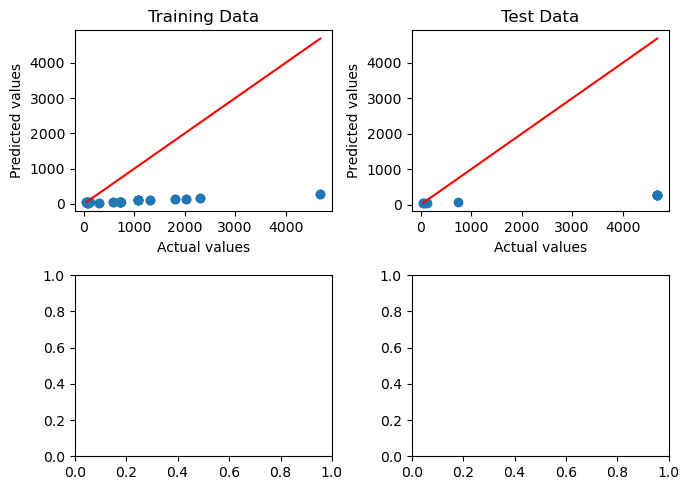

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [60/2000], Loss: 1436351.7500
Train R²:  -0.21606
Test R² :  -0.56943


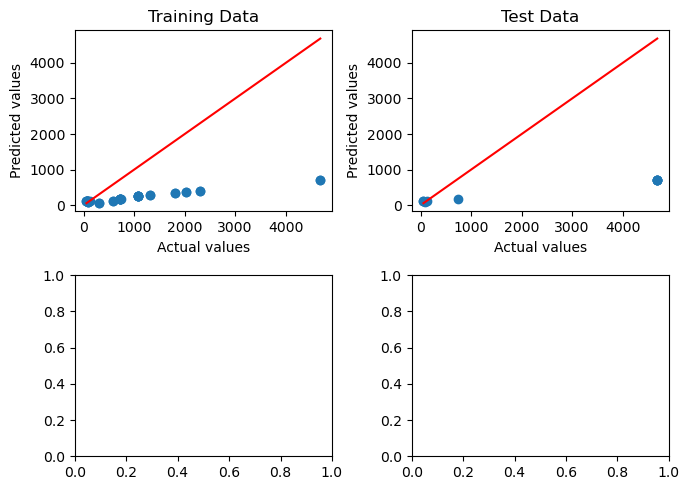

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [80/2000], Loss: 732595.6875
Train R²:  0.37976
Test R² :  0.11769


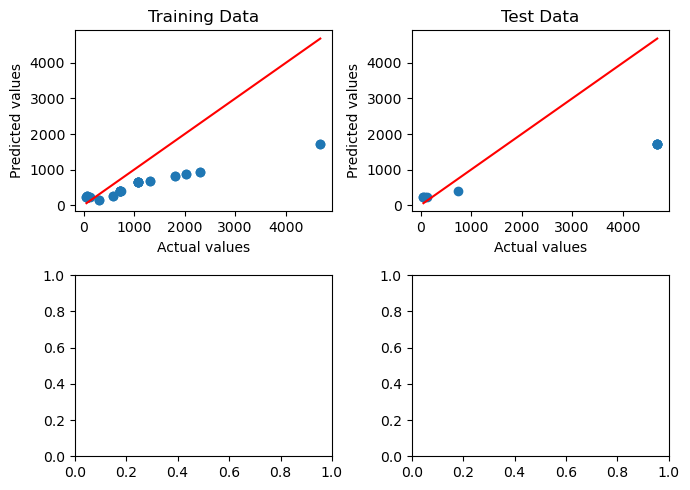

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [100/2000], Loss: 133098.7188
Train R²:  0.88731
Test R² :  0.84038


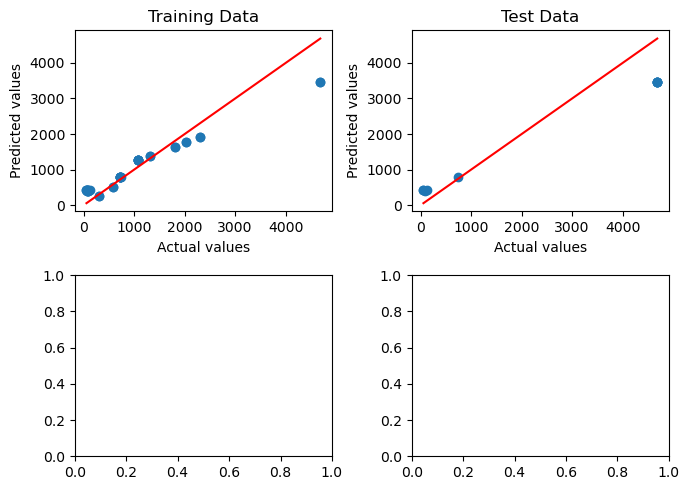

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [120/2000], Loss: 74490.1328
Train R²:  0.93693
Test R² :  0.97105


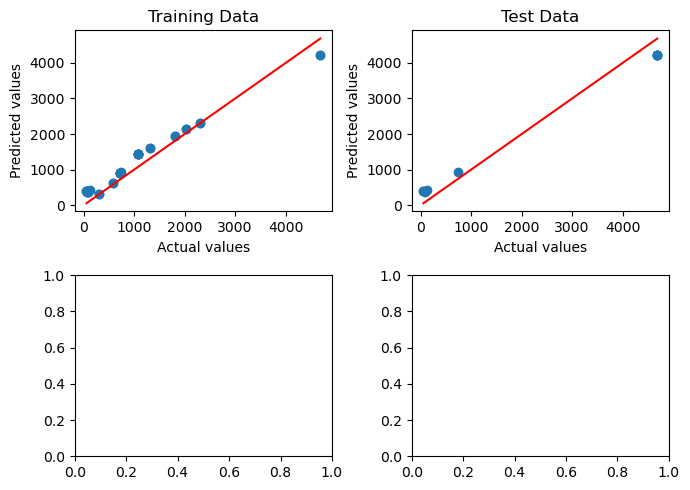

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [140/2000], Loss: 38445.3320
Train R²:  0.96745
Test R² :  0.96274


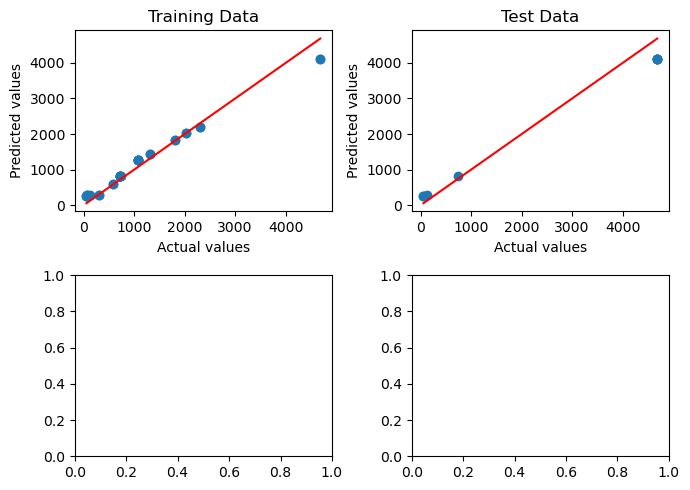

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [160/2000], Loss: 17668.2832
Train R²:  0.98504
Test R² :  0.98663


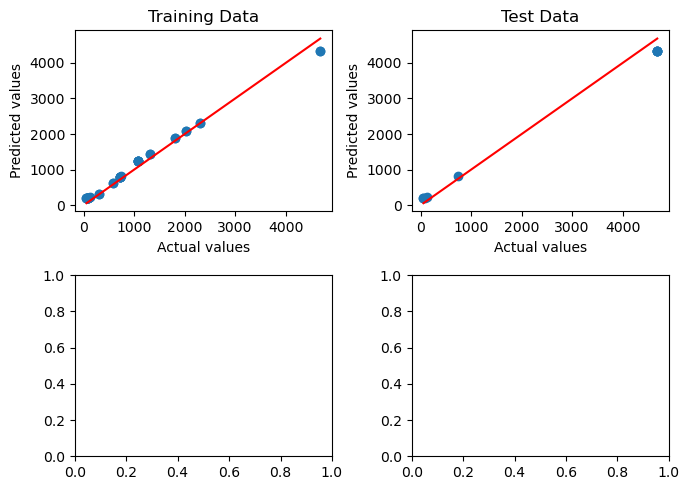

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [180/2000], Loss: 5778.0225
Train R²:  0.99511
Test R² :  0.99395


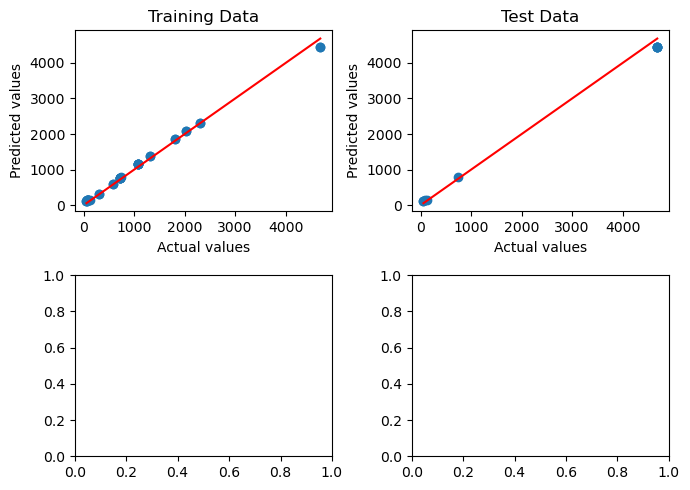

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [200/2000], Loss: 1376.6180
Train R²:  0.99883
Test R² :  0.99842


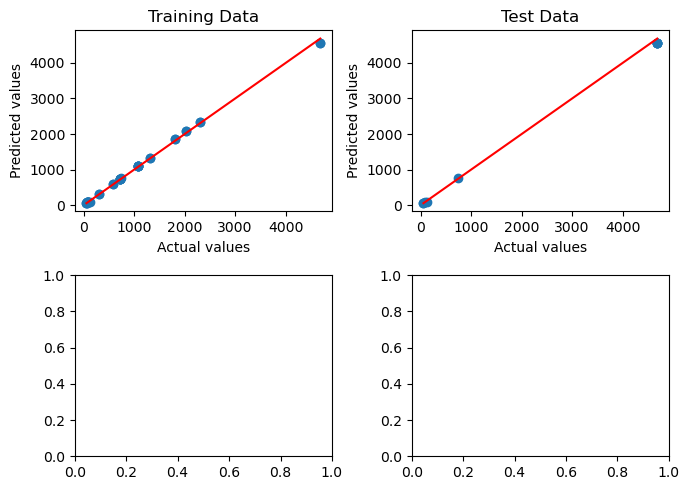

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [220/2000], Loss: 844.6831
Train R²:  0.99928
Test R² :  0.99952


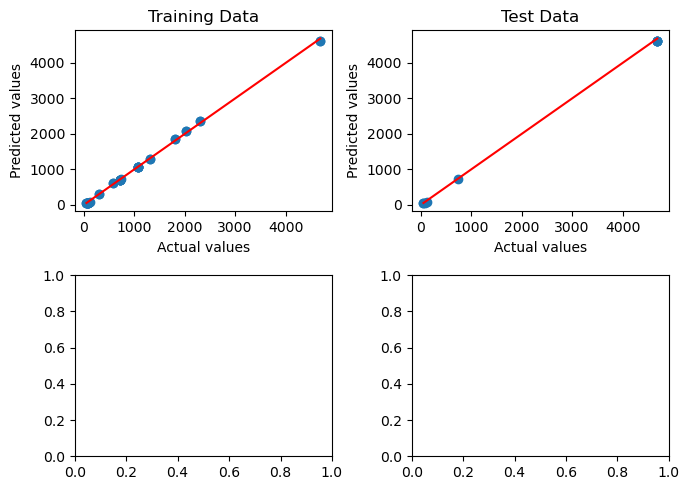

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [240/2000], Loss: 676.1379
Train R²:  0.99943
Test R² :  0.99964


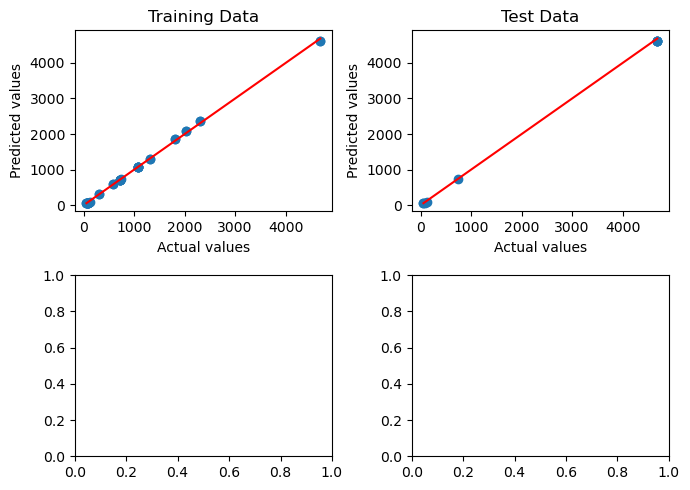

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [260/2000], Loss: 555.8193
Train R²:  0.99953
Test R² :  0.99969


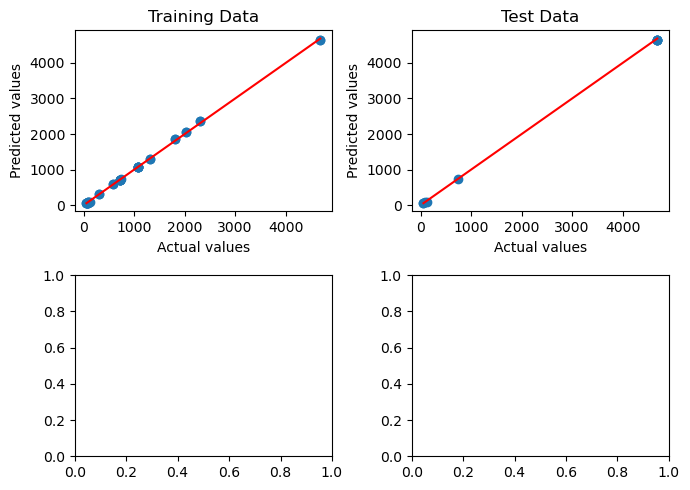

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [280/2000], Loss: 455.8581
Train R²:  0.99961
Test R² :  0.99977


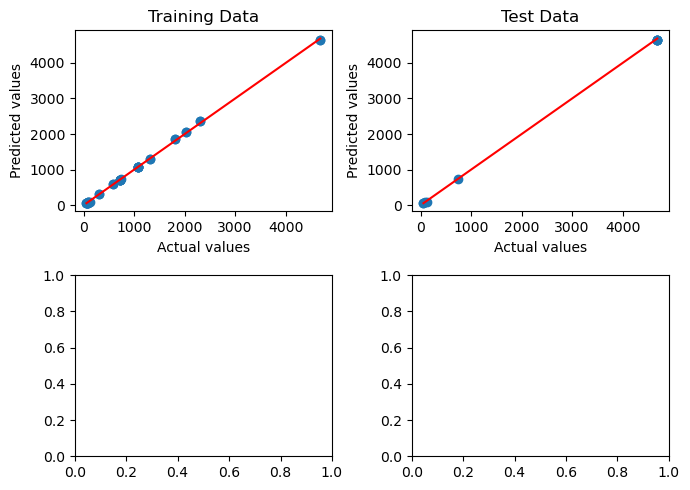

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [300/2000], Loss: 371.3250
Train R²:  0.99969
Test R² :  0.99982


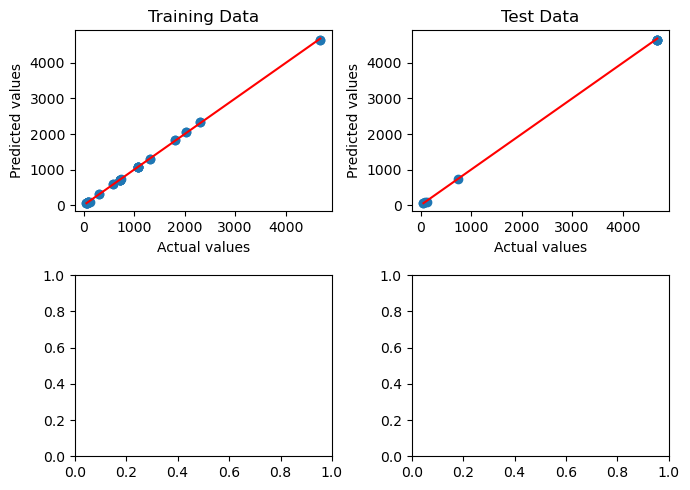

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [320/2000], Loss: 299.1046
Train R²:  0.99975
Test R² :  0.99987


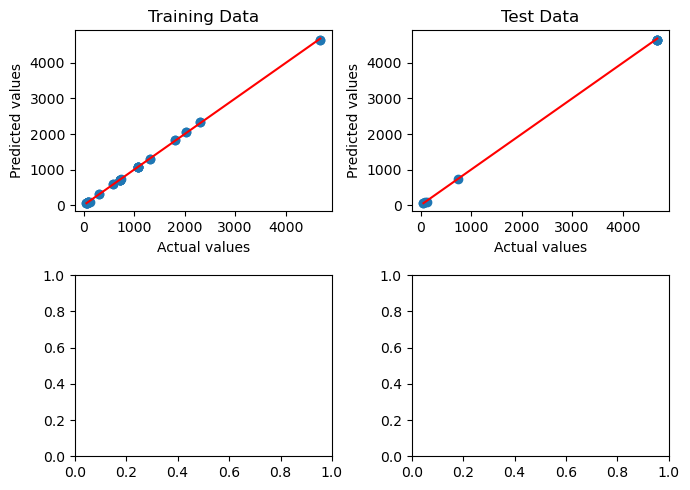

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [340/2000], Loss: 241.1845
Train R²:  0.99980
Test R² :  0.99990


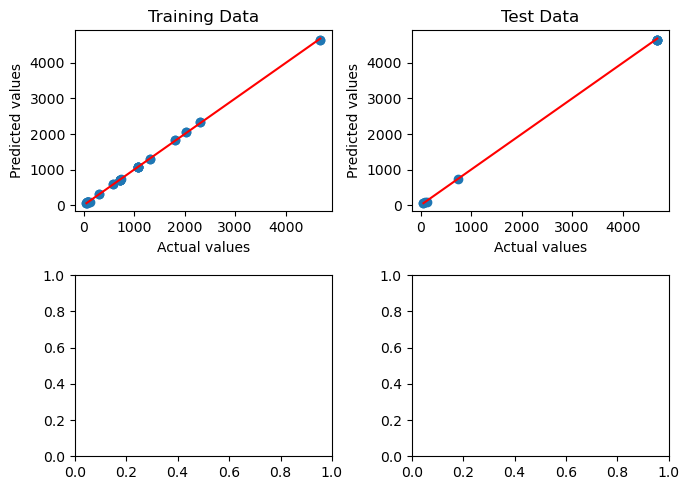

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [360/2000], Loss: 195.1960
Train R²:  0.99983
Test R² :  0.99992


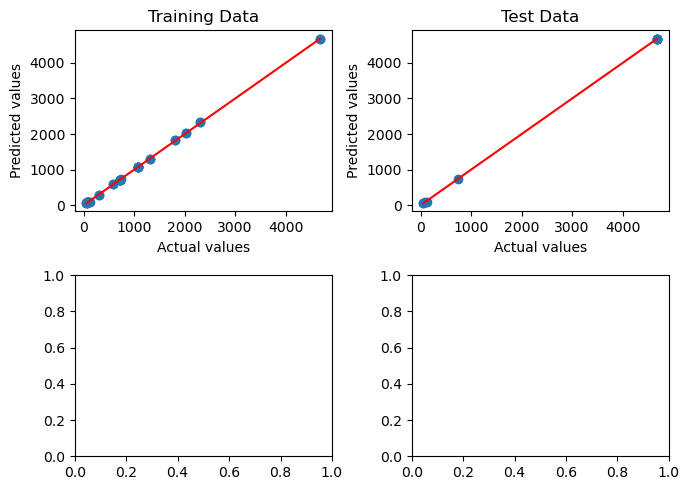

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [380/2000], Loss: 157.8846
Train R²:  0.99987
Test R² :  0.99994


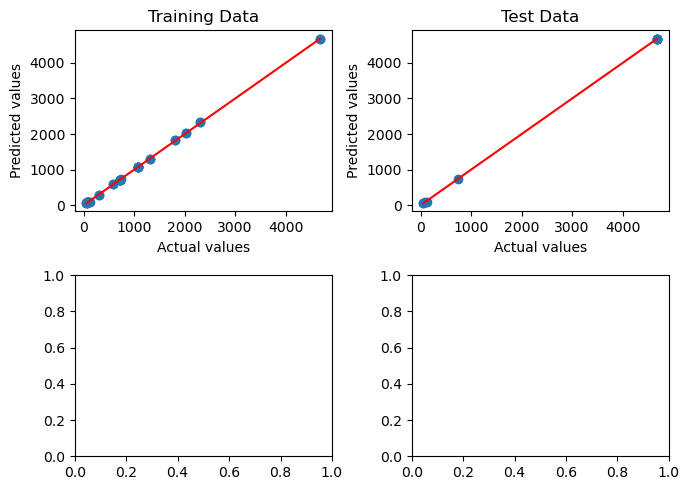

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [400/2000], Loss: 127.8839
Train R²:  0.99989
Test R² :  0.99995


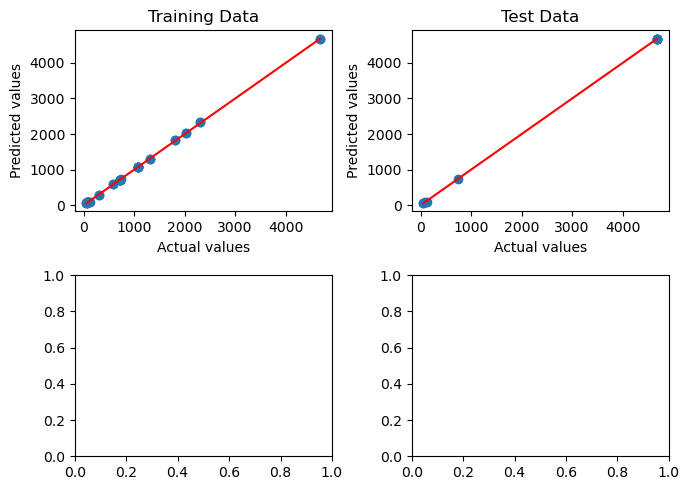

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [420/2000], Loss: 104.2202
Train R²:  0.99991
Test R² :  0.99996


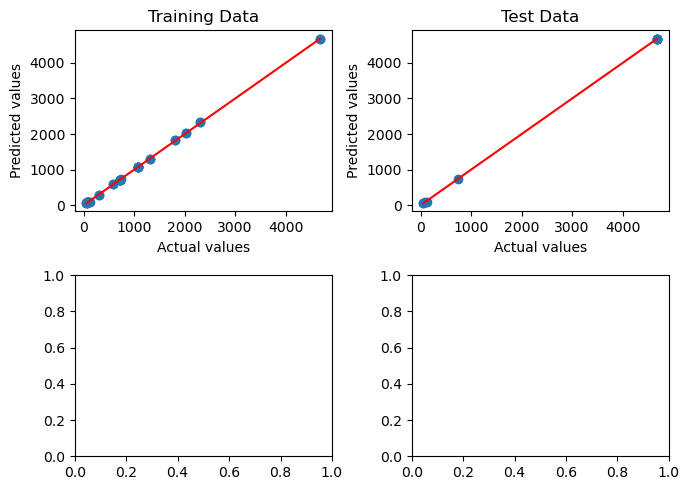

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [440/2000], Loss: 85.7629
Train R²:  0.99993
Test R² :  0.99997


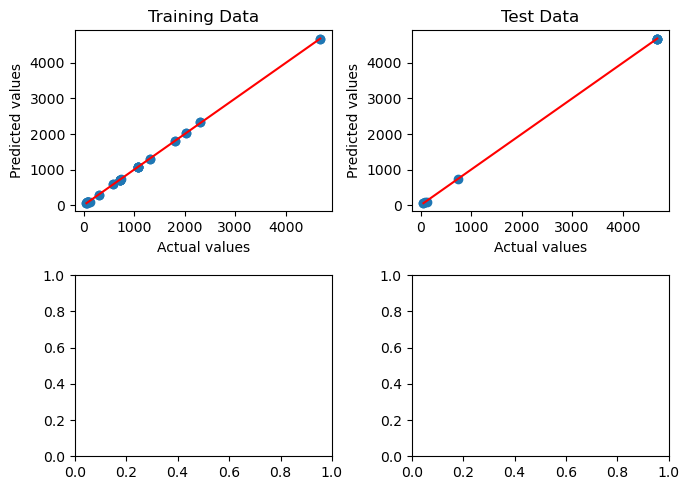

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [460/2000], Loss: 71.7820
Train R²:  0.99994
Test R² :  0.99997


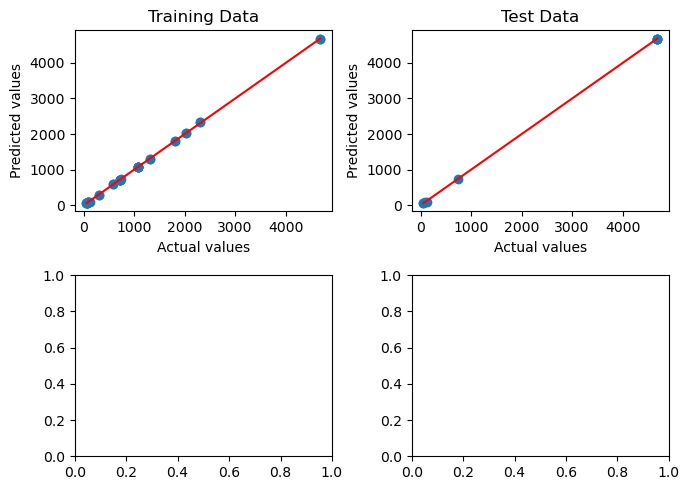

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [480/2000], Loss: 61.2901
Train R²:  0.99995
Test R² :  0.99998


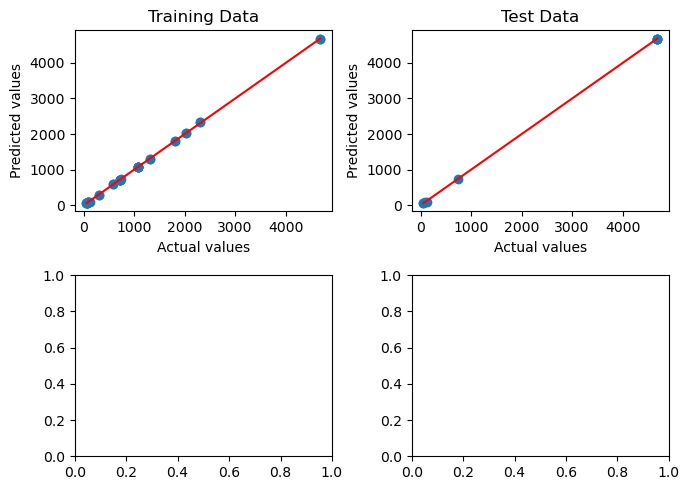

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [500/2000], Loss: 53.3536
Train R²:  0.99995
Test R² :  0.99998


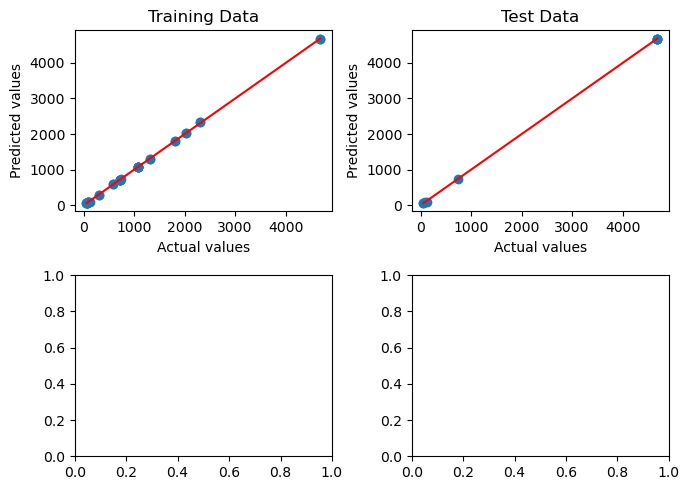

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [520/2000], Loss: 47.1352
Train R²:  0.99996
Test R² :  0.99998


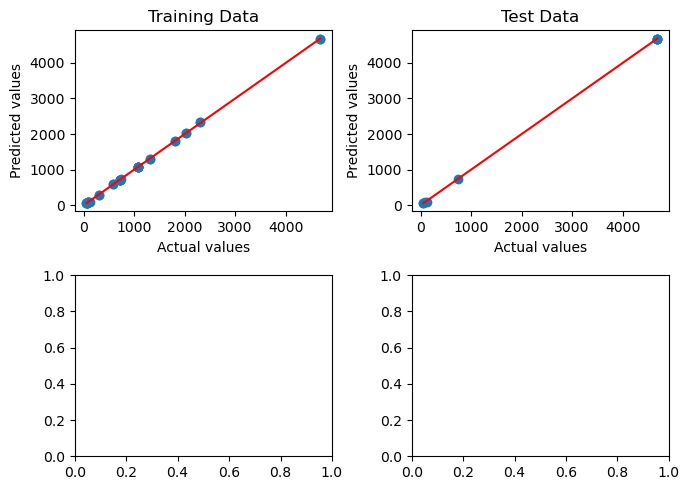

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [540/2000], Loss: 42.0592
Train R²:  0.99996
Test R² :  0.99998


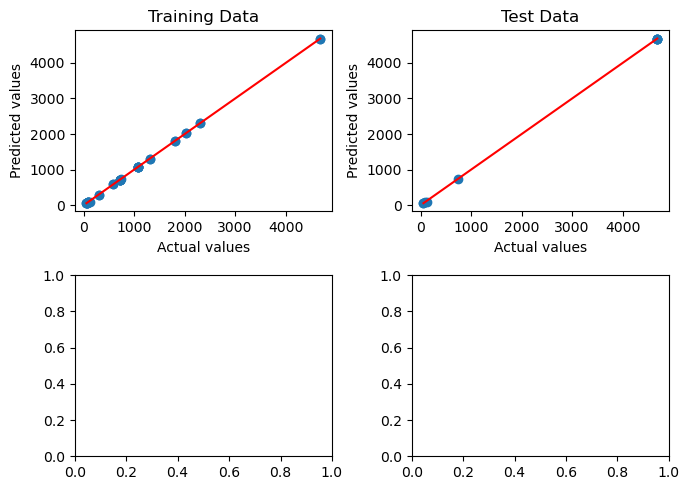

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [560/2000], Loss: 37.8689
Train R²:  0.99997
Test R² :  0.99999


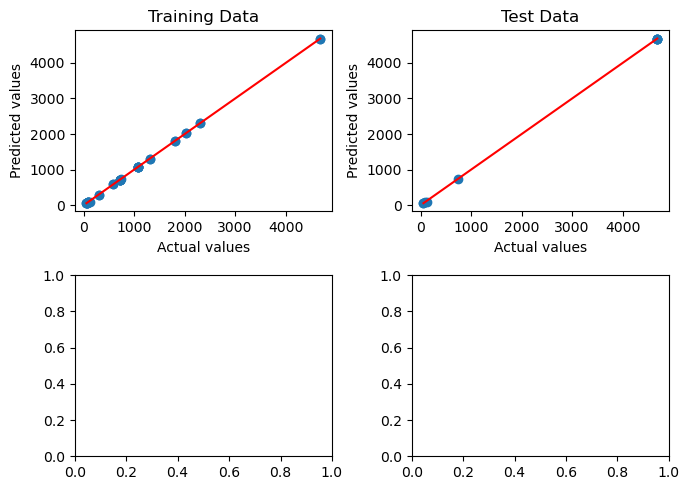

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [580/2000], Loss: 34.4387
Train R²:  0.99997
Test R² :  0.99999


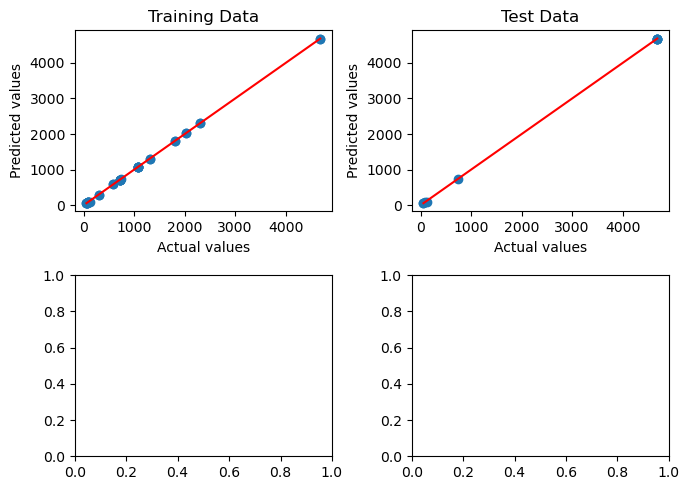

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [600/2000], Loss: 31.6567
Train R²:  0.99997
Test R² :  0.99999


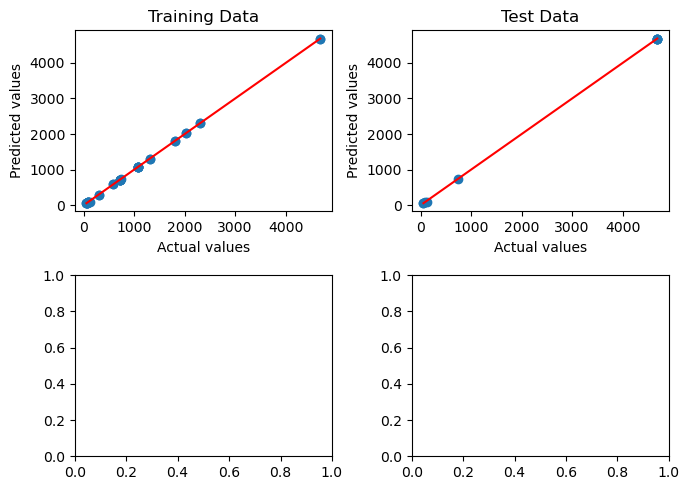

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [620/2000], Loss: 29.4201
Train R²:  0.99998
Test R² :  0.99999


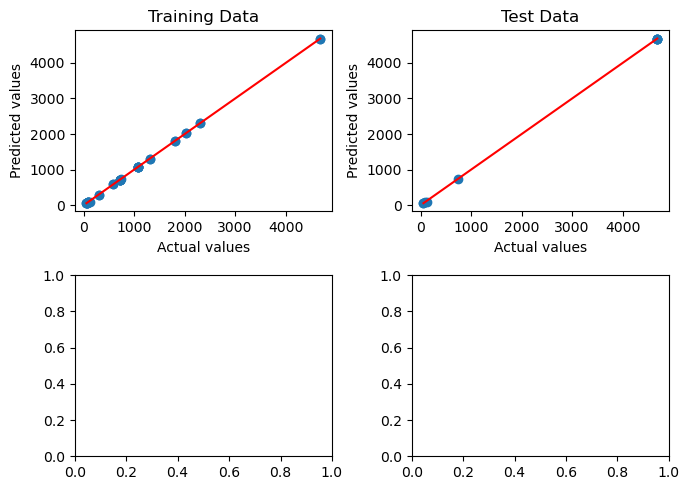

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [640/2000], Loss: 27.5897
Train R²:  0.99998
Test R² :  0.99999


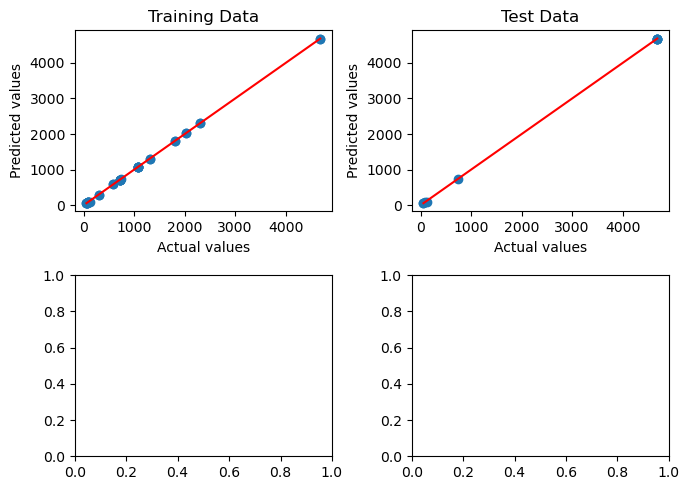

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [660/2000], Loss: 26.1159
Train R²:  0.99998
Test R² :  0.99999


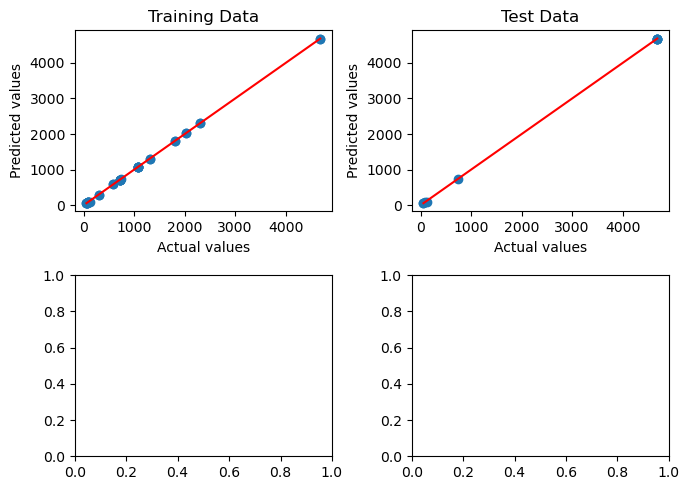

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [680/2000], Loss: 24.8523
Train R²:  0.99998
Test R² :  0.99999


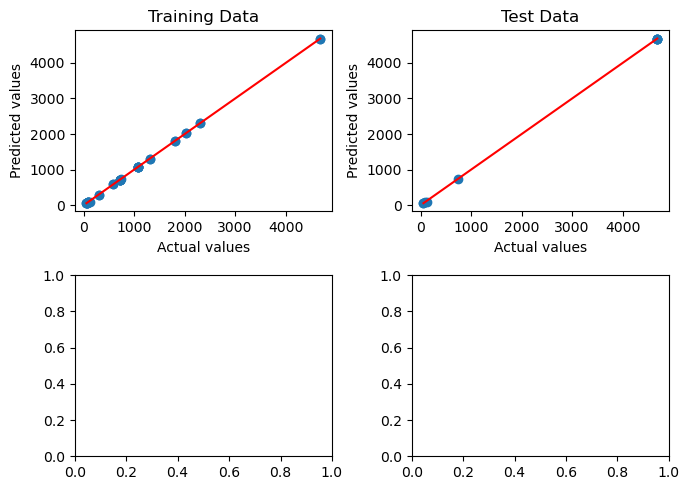

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [700/2000], Loss: 23.7523
Train R²:  0.99998
Test R² :  0.99999


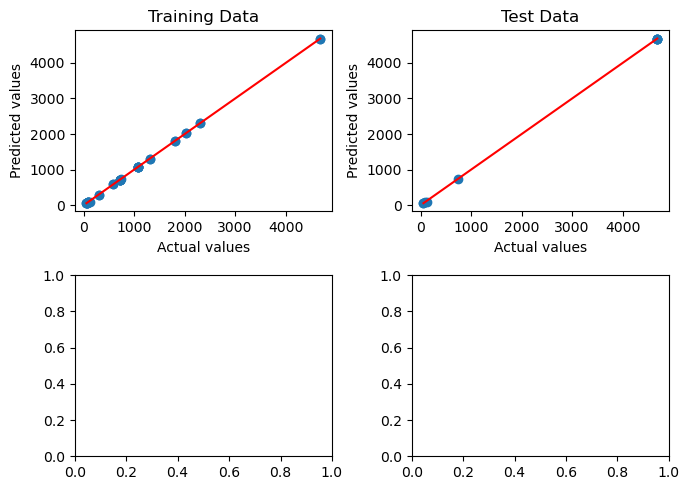

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [720/2000], Loss: 22.7749
Train R²:  0.99998
Test R² :  0.99999


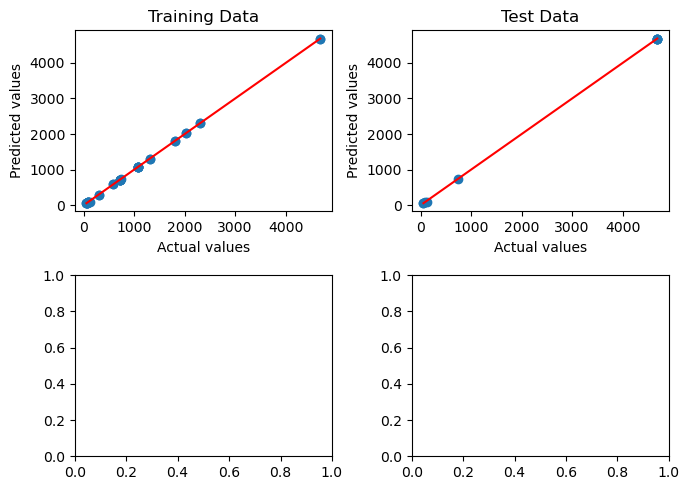

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [740/2000], Loss: 21.8867
Train R²:  0.99998
Test R² :  0.99999


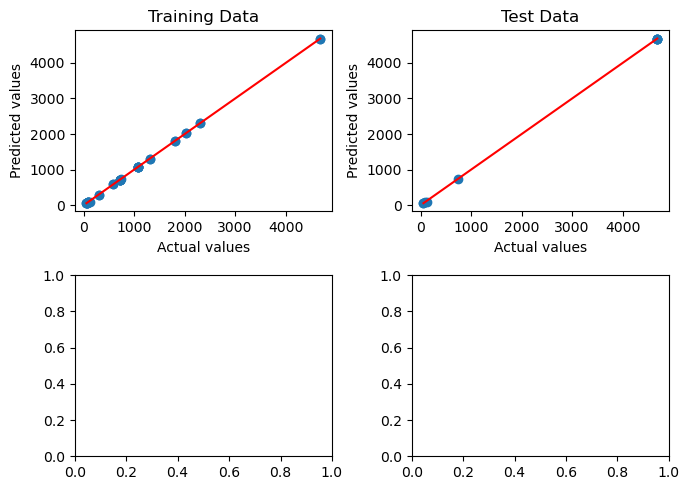

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [760/2000], Loss: 21.0356
Train R²:  0.99998
Test R² :  0.99999


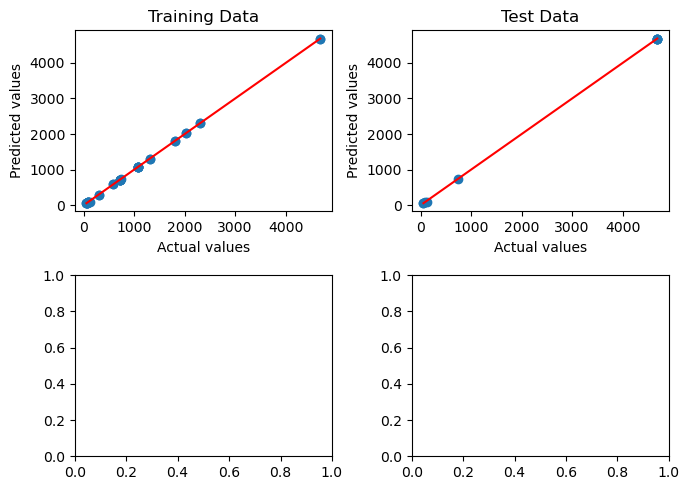

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [780/2000], Loss: 20.2270
Train R²:  0.99998
Test R² :  0.99999


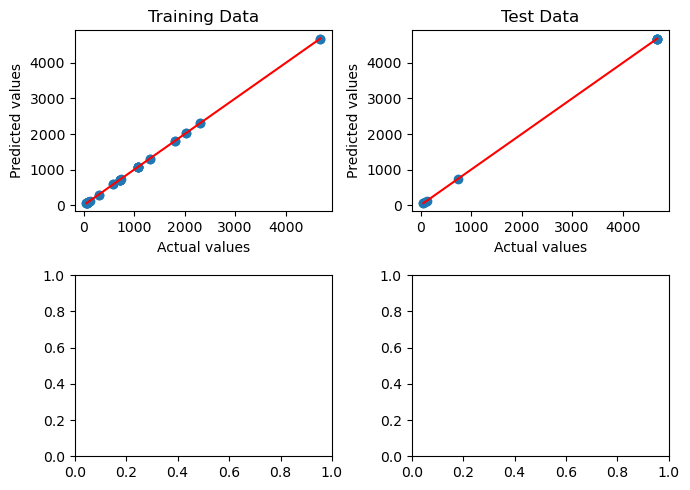

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [800/2000], Loss: 19.2184
Train R²:  0.99998
Test R² :  0.99999


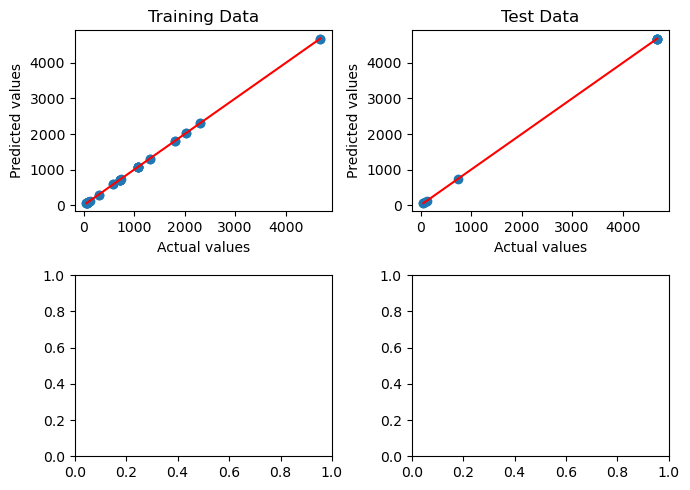

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [820/2000], Loss: 18.2496
Train R²:  0.99998
Test R² :  0.99999


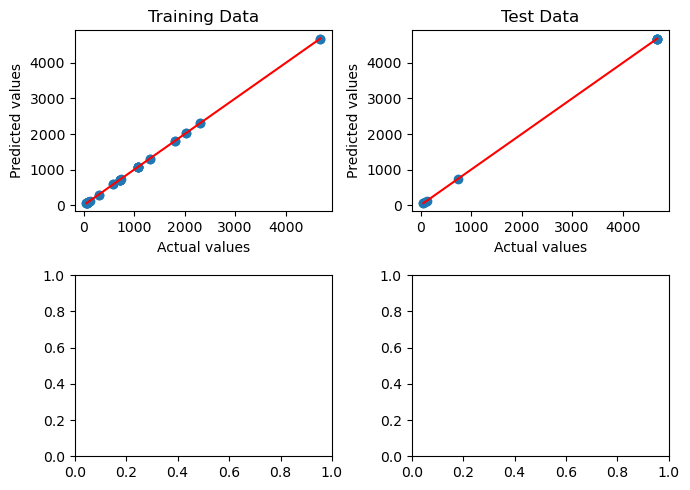

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [840/2000], Loss: 17.3391
Train R²:  0.99999
Test R² :  0.99999


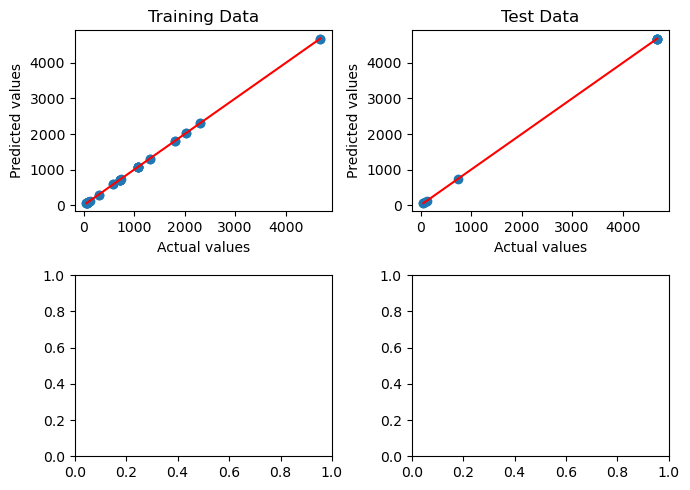

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [860/2000], Loss: 16.5013
Train R²:  0.99999
Test R² :  0.99999


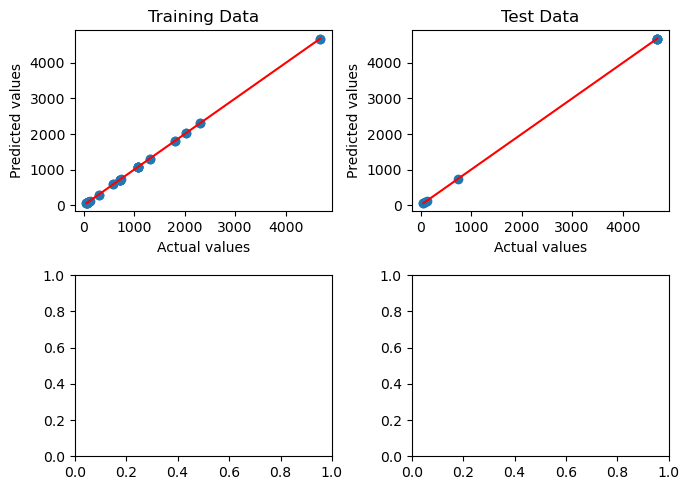

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [880/2000], Loss: 15.6987
Train R²:  0.99999
Test R² :  0.99999


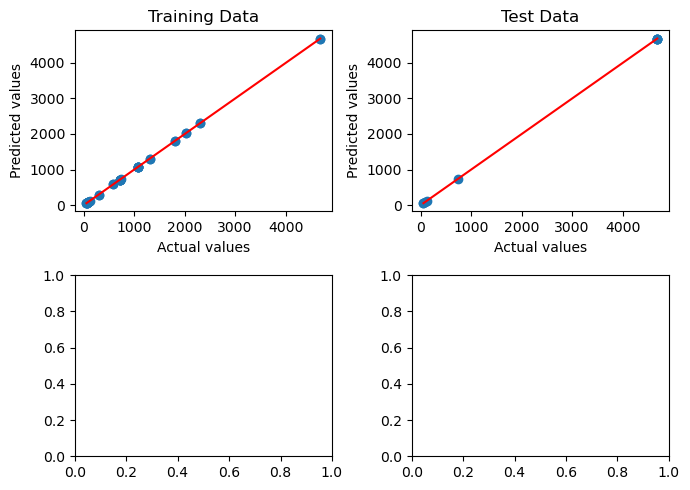

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [900/2000], Loss: 14.9128
Train R²:  0.99999
Test R² :  0.99999


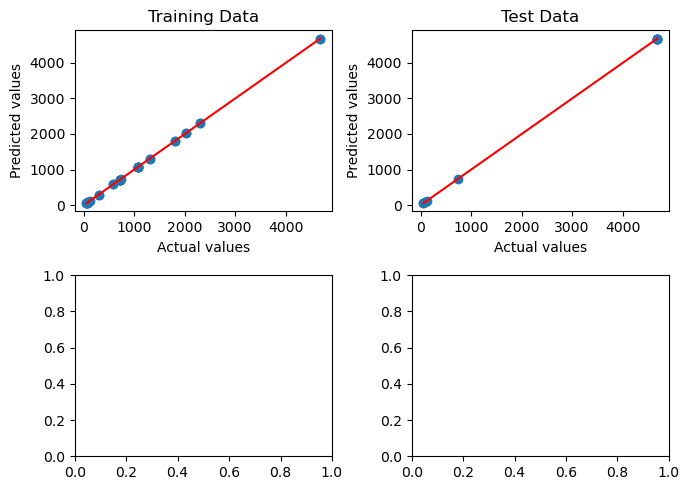

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [920/2000], Loss: 14.1507
Train R²:  0.99999
Test R² :  0.99999


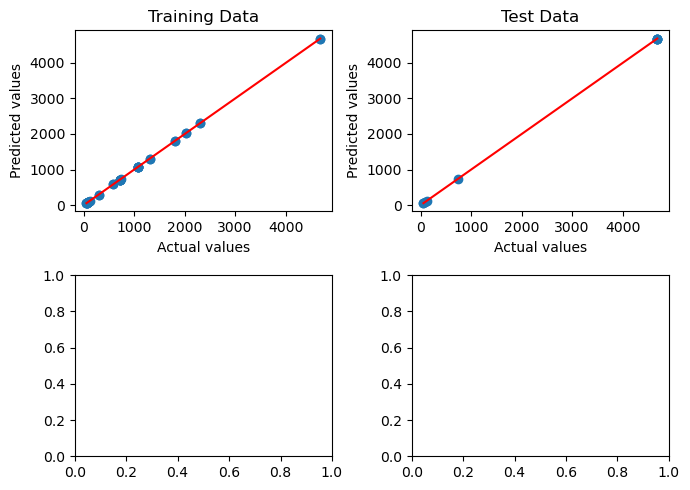

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [940/2000], Loss: 13.3845
Train R²:  0.99999
Test R² :  1.00000


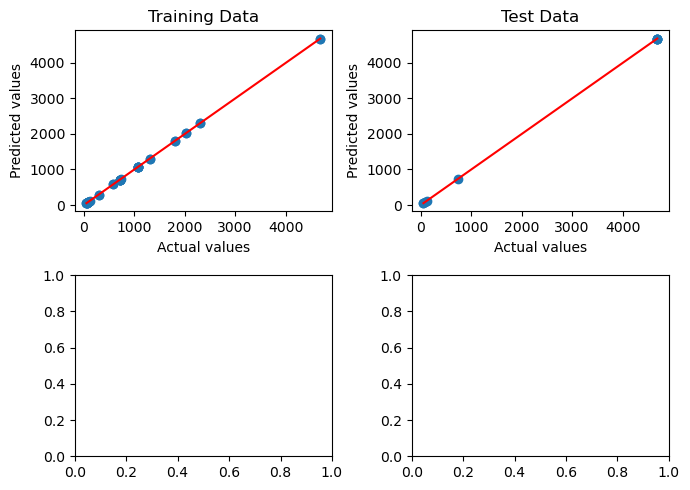

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [960/2000], Loss: 12.6568
Train R²:  0.99999
Test R² :  1.00000


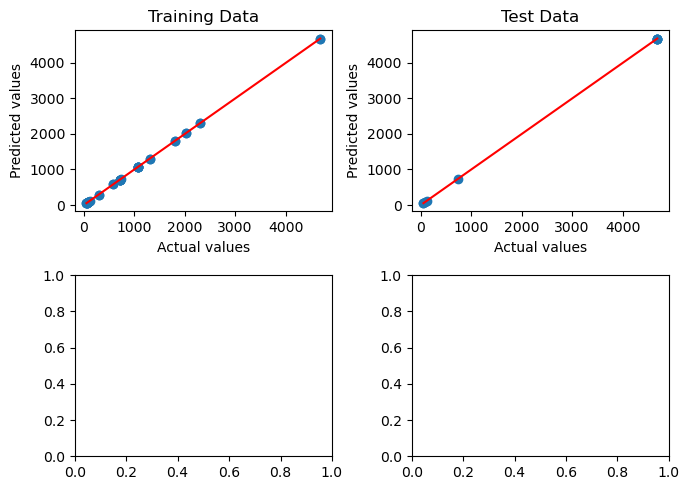

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [980/2000], Loss: 11.9345
Train R²:  0.99999
Test R² :  1.00000


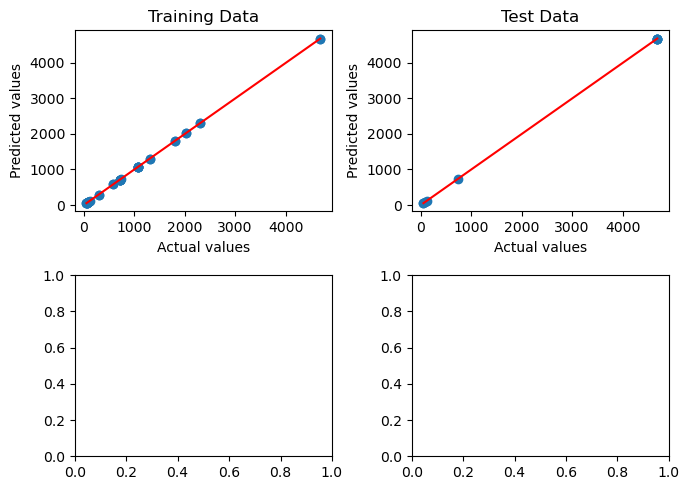

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [1000/2000], Loss: 11.2330
Train R²:  0.99999
Test R² :  1.00000


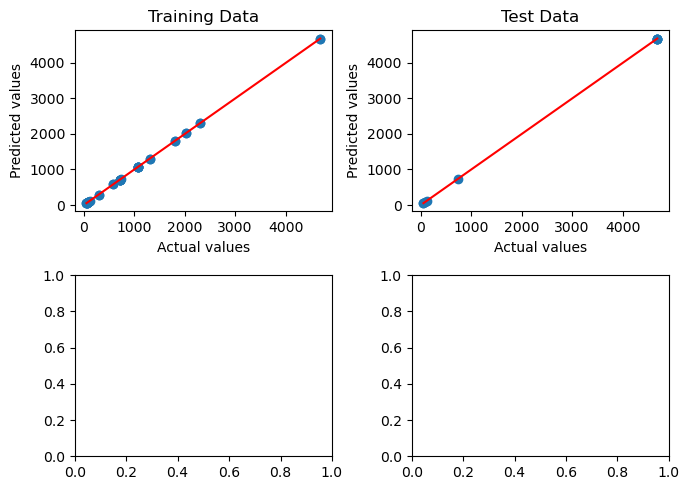

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [1020/2000], Loss: 10.6046
Train R²:  0.99999
Test R² :  1.00000


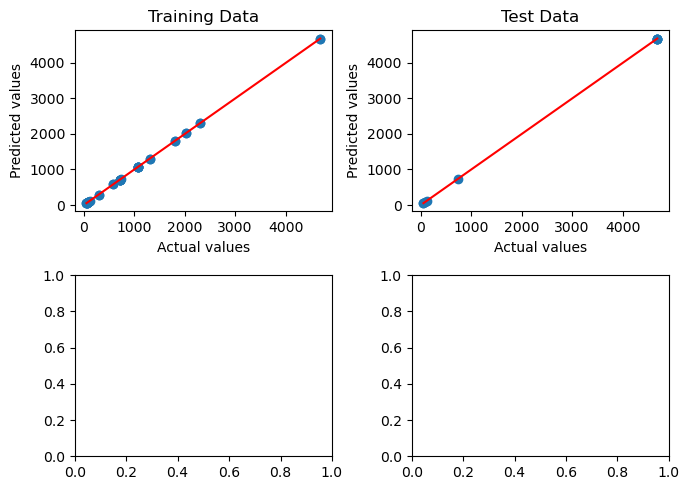

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [1040/2000], Loss: 9.9306
Train R²:  0.99999
Test R² :  1.00000


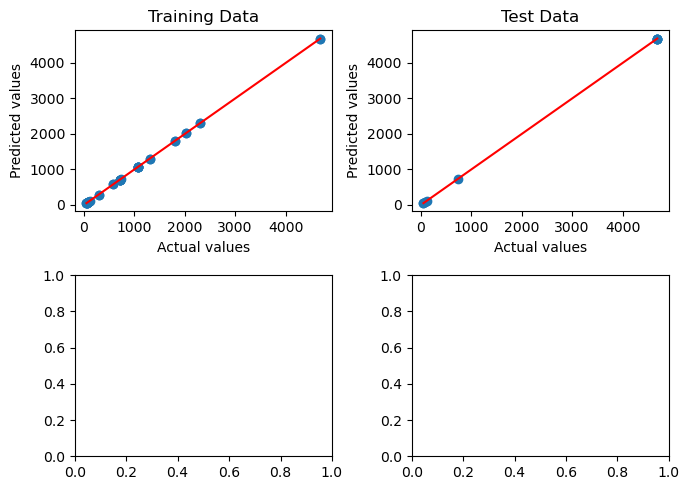

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [1060/2000], Loss: 9.3059
Train R²:  0.99999
Test R² :  1.00000


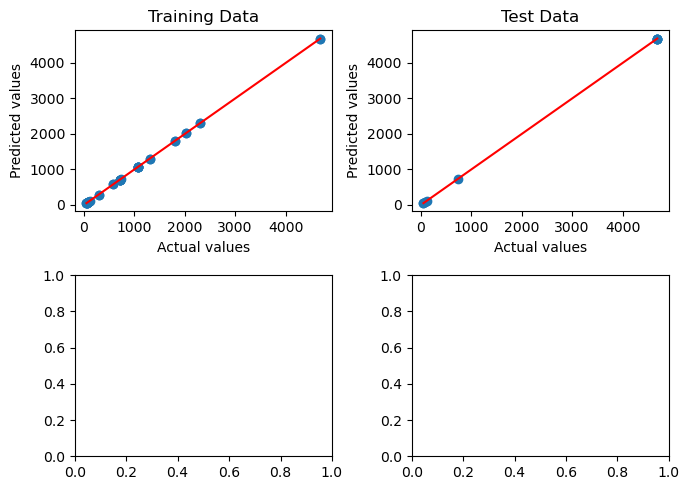

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [1080/2000], Loss: 8.7275
Train R²:  0.99999
Test R² :  1.00000


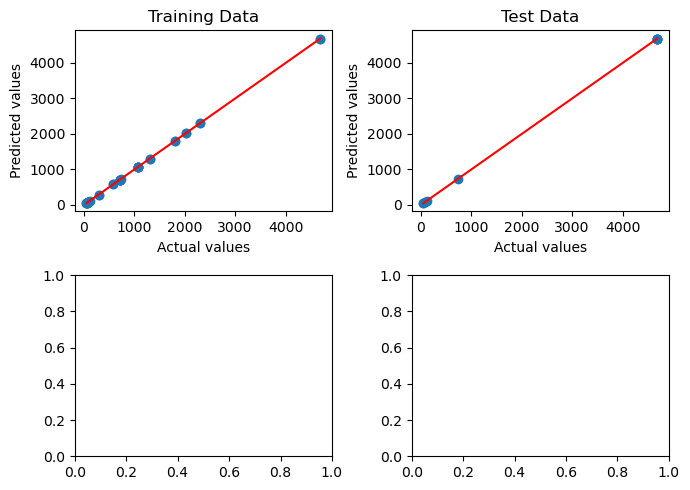

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [1100/2000], Loss: 8.1522
Train R²:  0.99999
Test R² :  1.00000


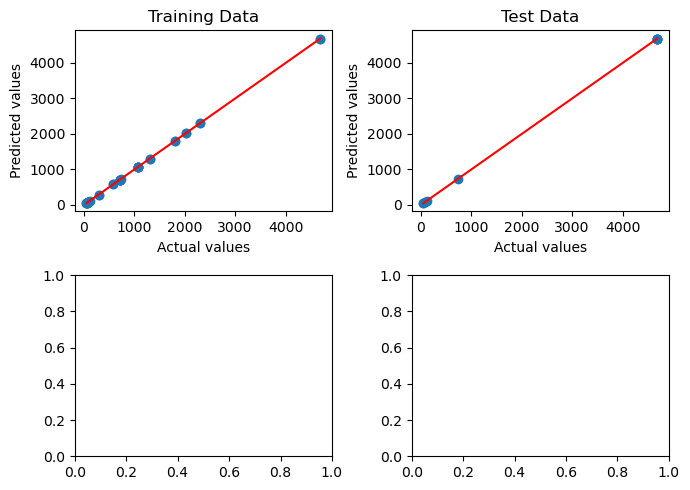

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [1120/2000], Loss: 7.6235
Train R²:  0.99999
Test R² :  1.00000


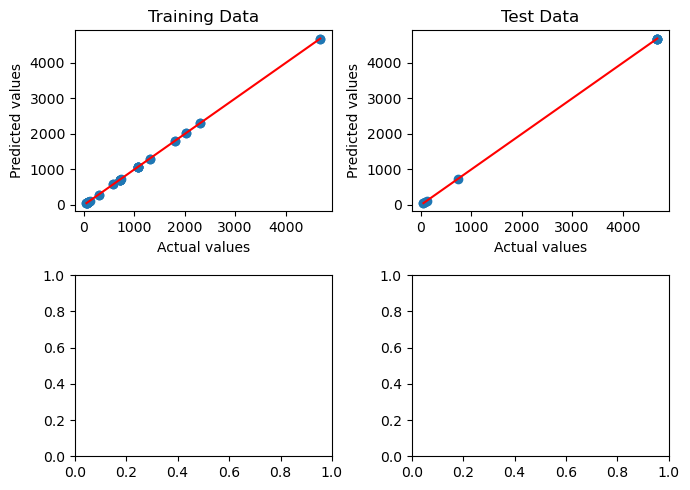

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [1140/2000], Loss: 7.0922
Train R²:  0.99999
Test R² :  1.00000


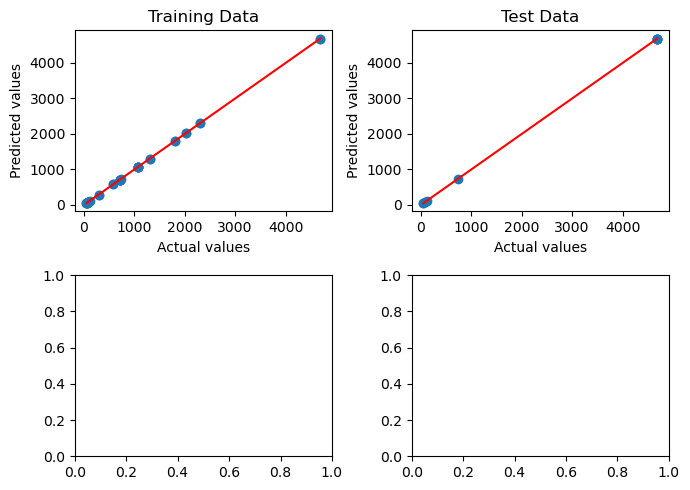

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [1160/2000], Loss: 6.6163
Train R²:  0.99999
Test R² :  1.00000


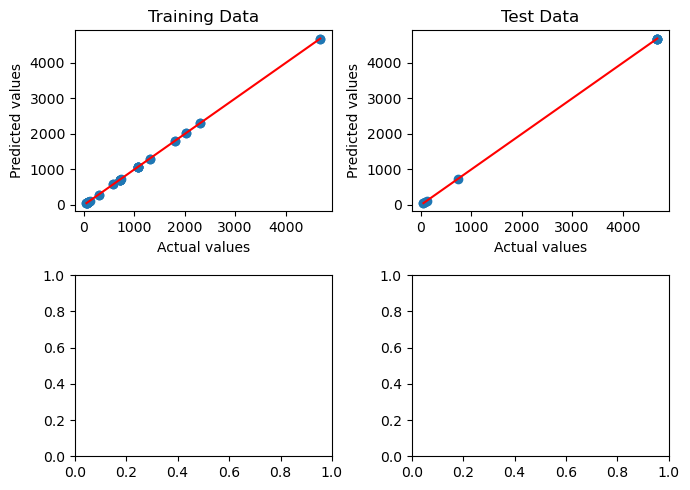

<Figure size 640x480 with 0 Axes>

[Sigmaf] Epoch [1180/2000], Loss: 6.1034
Train R²:  0.99999
Test R² :  1.00000


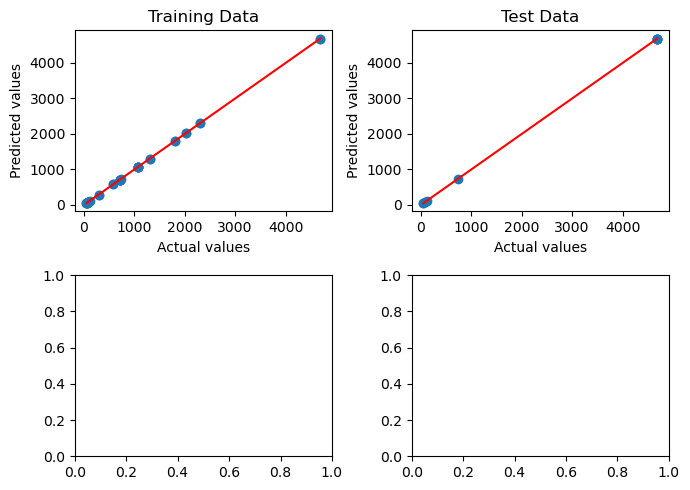

<Figure size 640x480 with 0 Axes>

KeyboardInterrupt: 

In [8]:
GBR_NN(4)

[b] Epoch [20/2000], Loss: 0.0893
Train R²:  -50.20696
Test R² :  -15.40912


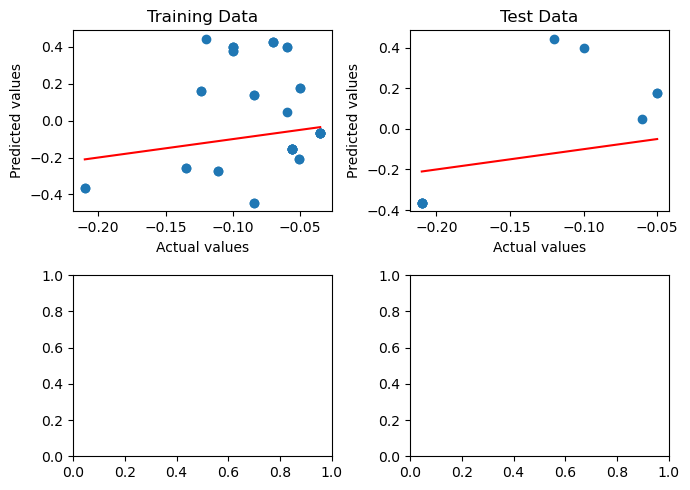

<Figure size 640x480 with 0 Axes>

[b] Epoch [40/2000], Loss: 0.2125
Train R²:  -120.82709
Test R² :  -34.31750


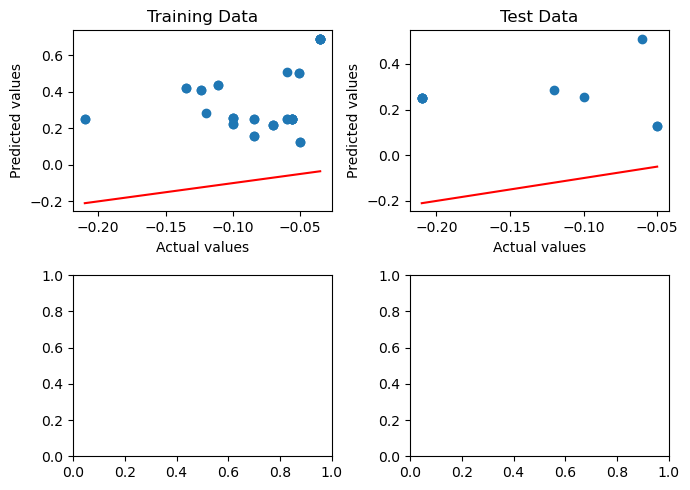

<Figure size 640x480 with 0 Axes>

[b] Epoch [60/2000], Loss: 0.0216
Train R²:  -11.36238
Test R² :  -2.49025


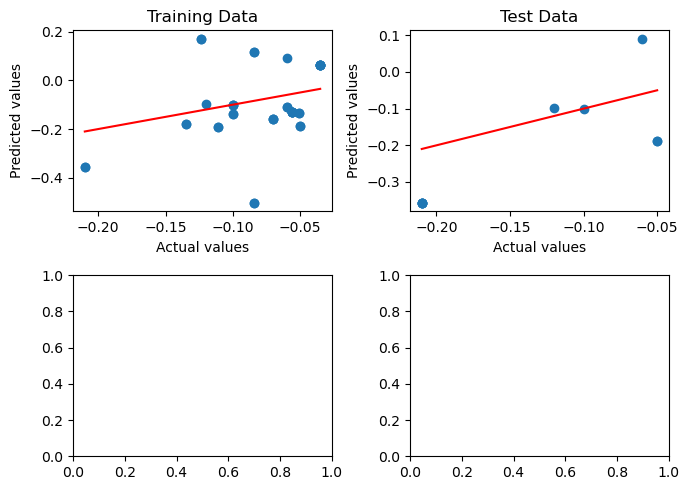

<Figure size 640x480 with 0 Axes>

[b] Epoch [80/2000], Loss: 0.0161
Train R²:  -8.25290
Test R² :  -1.81756


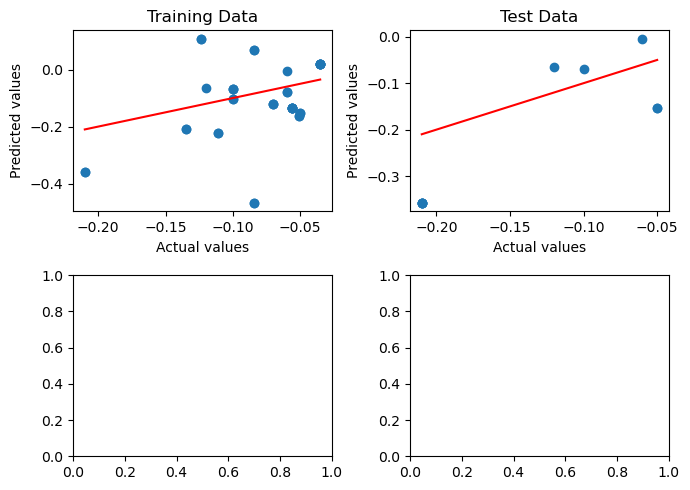

<Figure size 640x480 with 0 Axes>

[b] Epoch [100/2000], Loss: 0.0063
Train R²:  -2.63654
Test R² :  0.47036


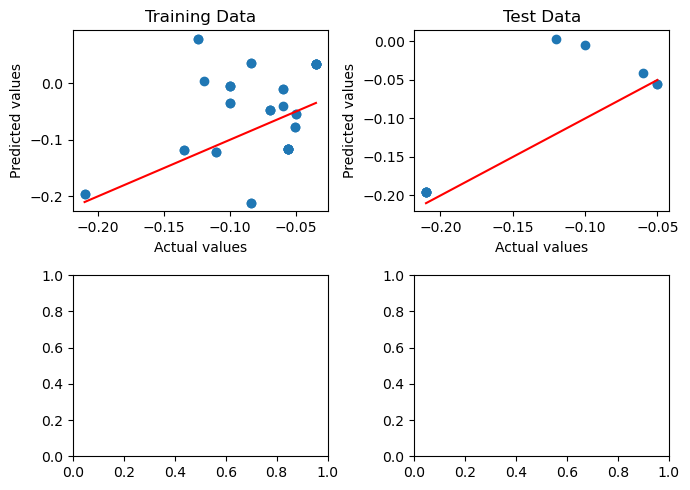

<Figure size 640x480 with 0 Axes>

[b] Epoch [120/2000], Loss: 0.0034
Train R²:  -0.95273
Test R² :  0.79331


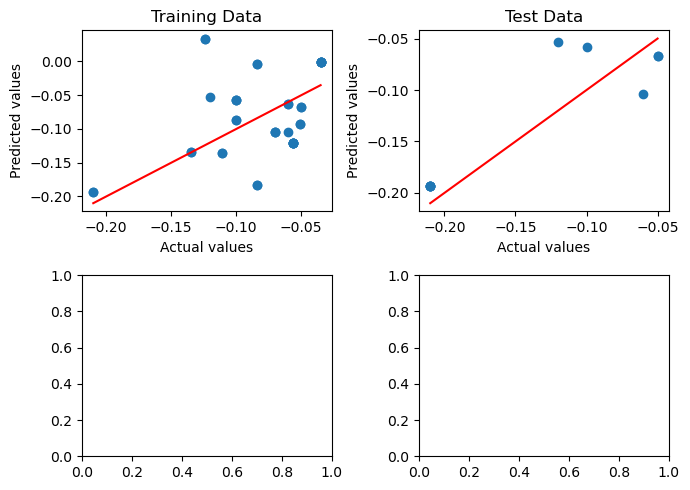

<Figure size 640x480 with 0 Axes>

[b] Epoch [140/2000], Loss: 0.0022
Train R²:  -0.28675
Test R² :  0.56776


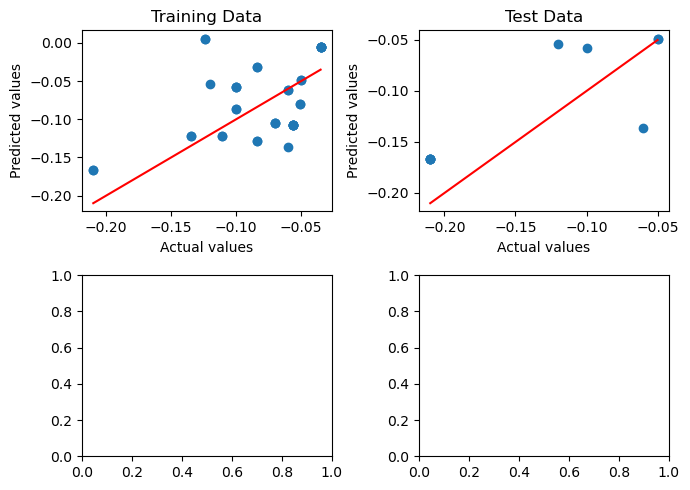

<Figure size 640x480 with 0 Axes>

[b] Epoch [160/2000], Loss: 0.0017
Train R²:  0.00642
Test R² :  0.42770


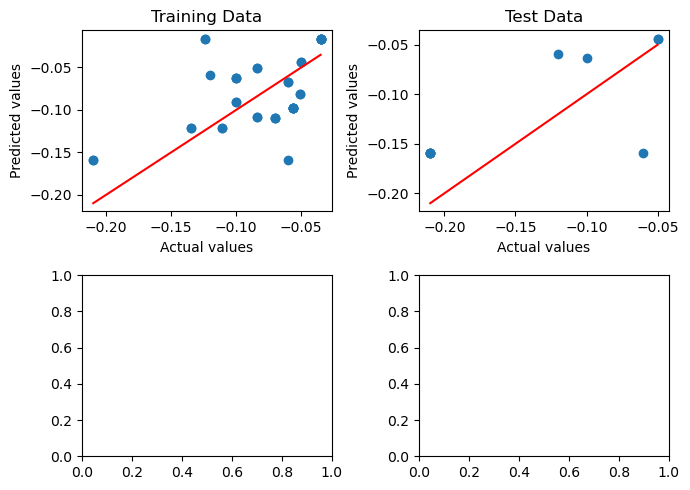

<Figure size 640x480 with 0 Axes>

[b] Epoch [180/2000], Loss: 0.0015
Train R²:  0.16300
Test R² :  0.38028


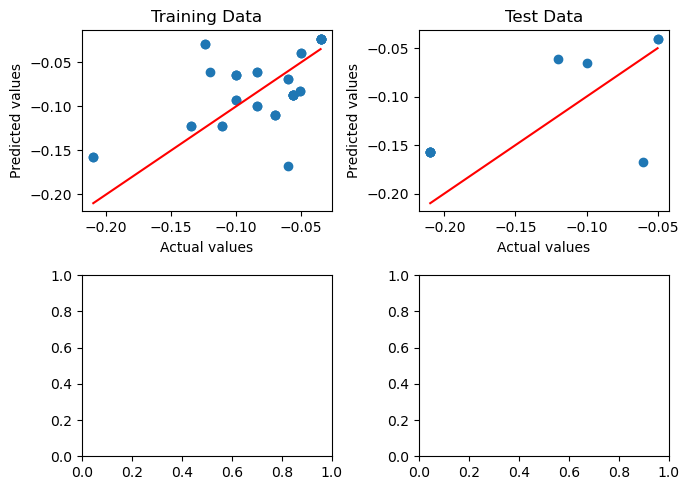

<Figure size 640x480 with 0 Axes>

[b] Epoch [200/2000], Loss: 0.0013
Train R²:  0.25540
Test R² :  0.38616


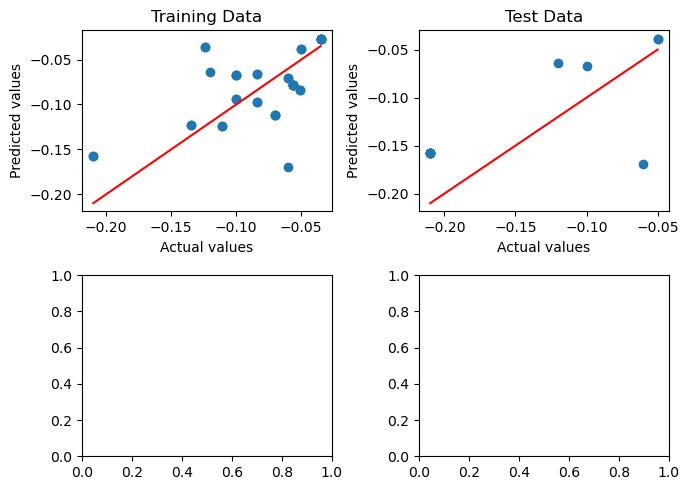

<Figure size 640x480 with 0 Axes>

[b] Epoch [220/2000], Loss: 0.0012
Train R²:  0.31012
Test R² :  0.40079


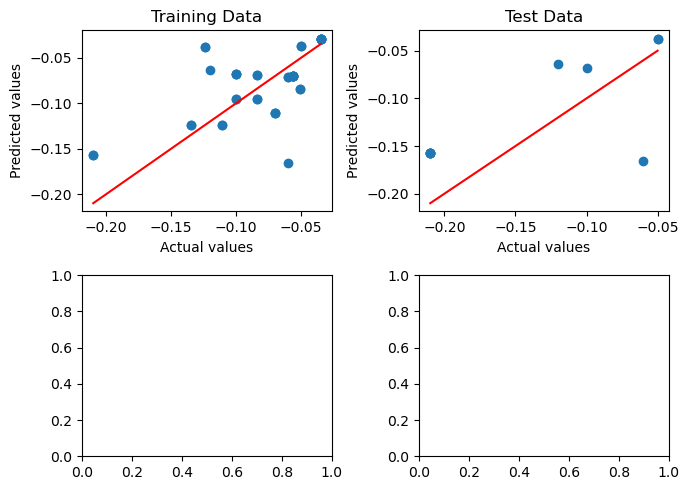

<Figure size 640x480 with 0 Axes>

[b] Epoch [240/2000], Loss: 0.0011
Train R²:  0.34921
Test R² :  0.42985


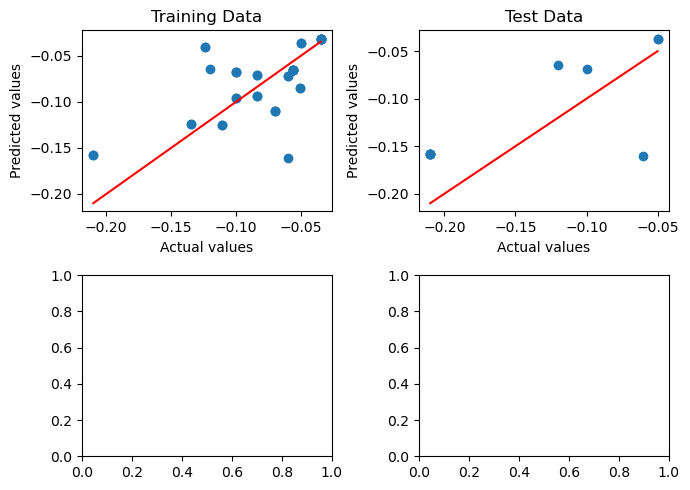

<Figure size 640x480 with 0 Axes>

[b] Epoch [260/2000], Loss: 0.0011
Train R²:  0.37864
Test R² :  0.45261


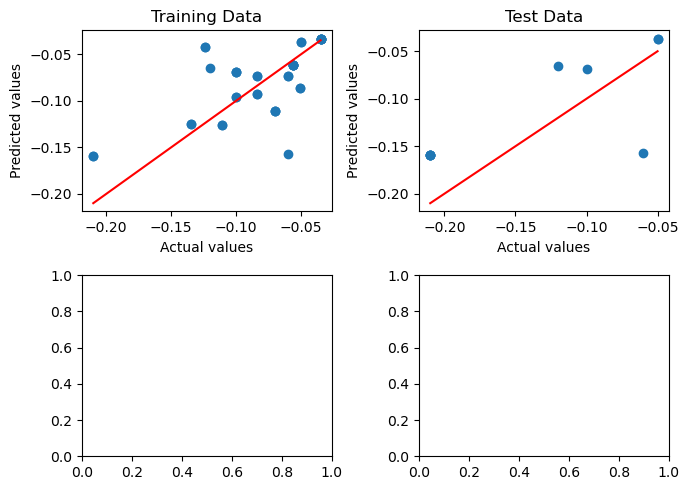

<Figure size 640x480 with 0 Axes>

[b] Epoch [280/2000], Loss: 0.0010
Train R²:  0.40390
Test R² :  0.47269


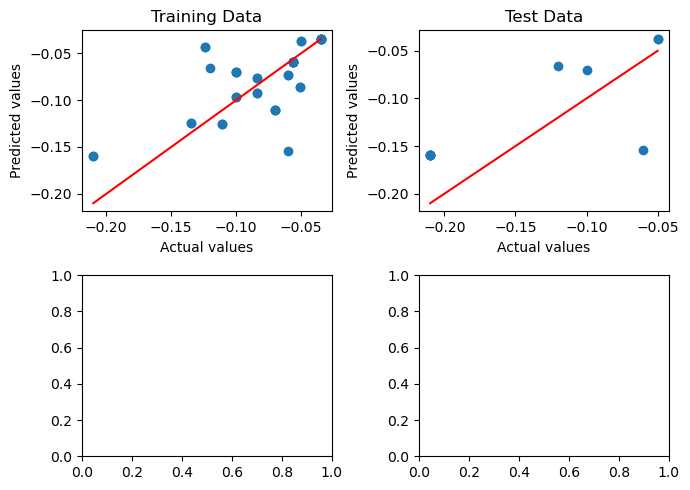

<Figure size 640x480 with 0 Axes>

[b] Epoch [300/2000], Loss: 0.0010
Train R²:  0.42437
Test R² :  0.48045


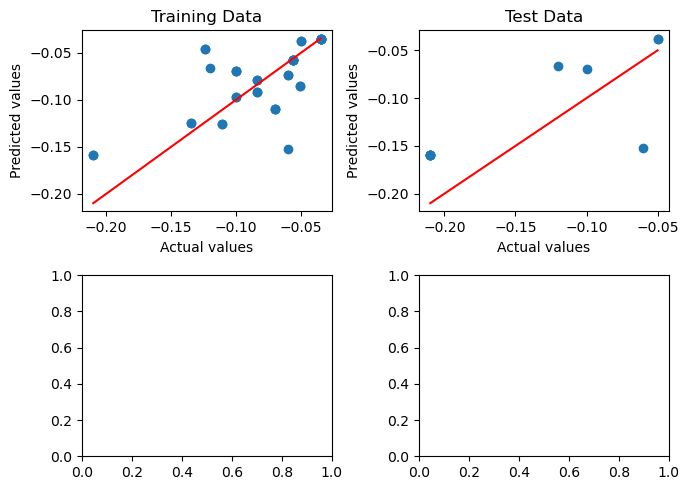

<Figure size 640x480 with 0 Axes>

[b] Epoch [320/2000], Loss: 0.0010
Train R²:  0.44314
Test R² :  0.48722


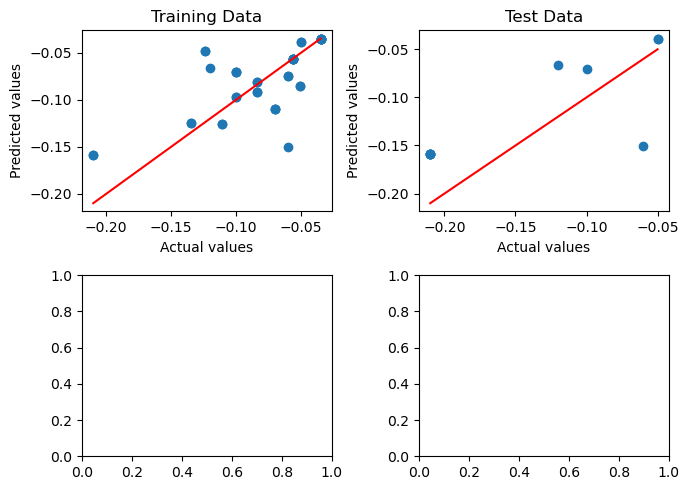

<Figure size 640x480 with 0 Axes>

[b] Epoch [340/2000], Loss: 0.0009
Train R²:  0.46136
Test R² :  0.49797


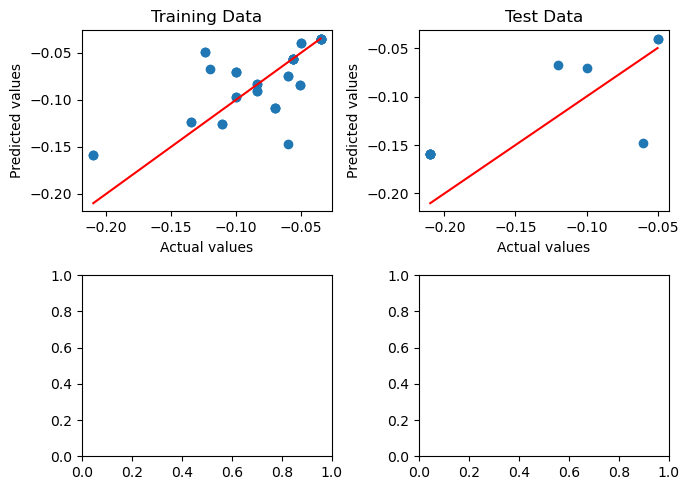

<Figure size 640x480 with 0 Axes>

[b] Epoch [360/2000], Loss: 0.0009
Train R²:  0.47927
Test R² :  0.51035


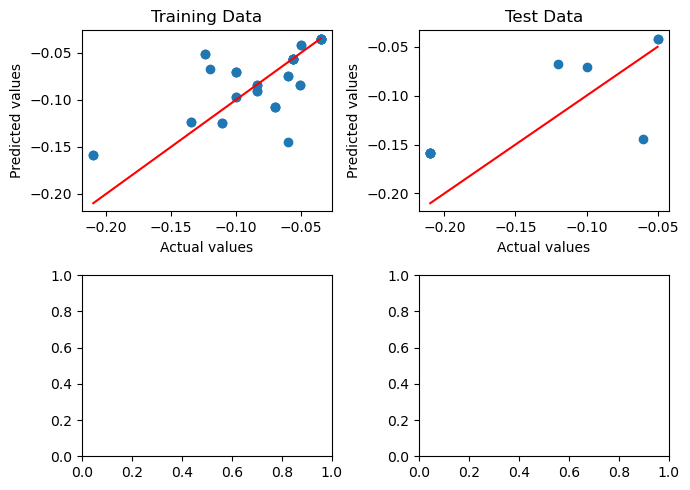

<Figure size 640x480 with 0 Axes>

[b] Epoch [380/2000], Loss: 0.0009
Train R²:  0.49691
Test R² :  0.52335


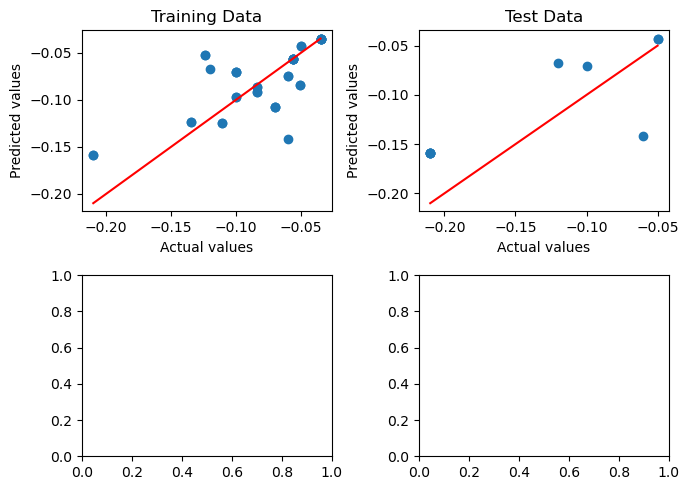

<Figure size 640x480 with 0 Axes>

[b] Epoch [400/2000], Loss: 0.0008
Train R²:  0.51402
Test R² :  0.53962


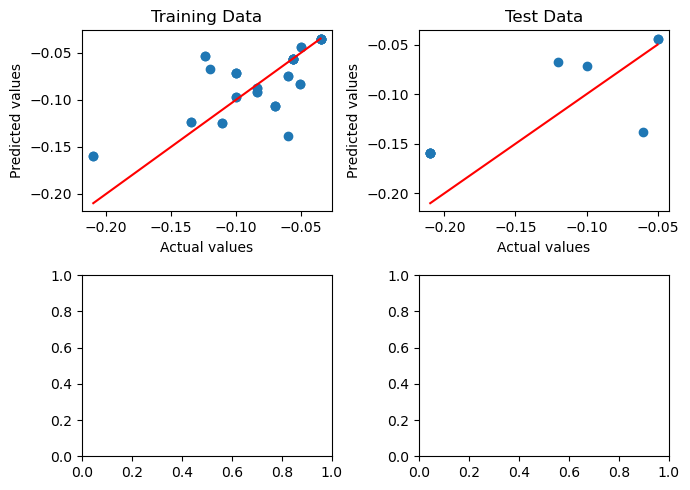

<Figure size 640x480 with 0 Axes>

[b] Epoch [420/2000], Loss: 0.0008
Train R²:  0.53147
Test R² :  0.55021


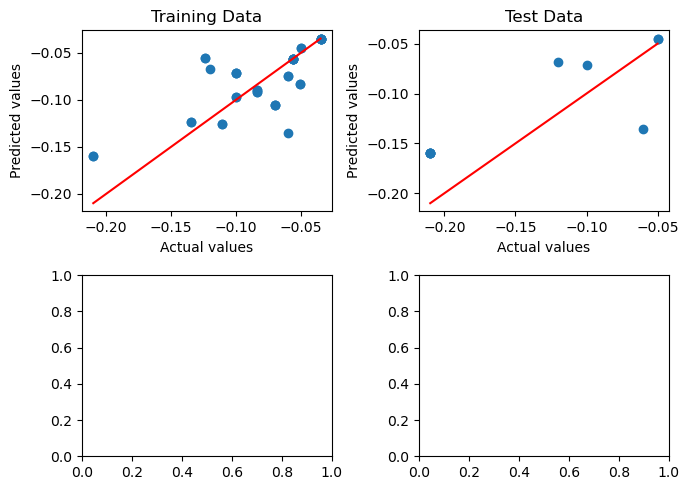

<Figure size 640x480 with 0 Axes>

[b] Epoch [440/2000], Loss: 0.0008
Train R²:  0.54833
Test R² :  0.56323


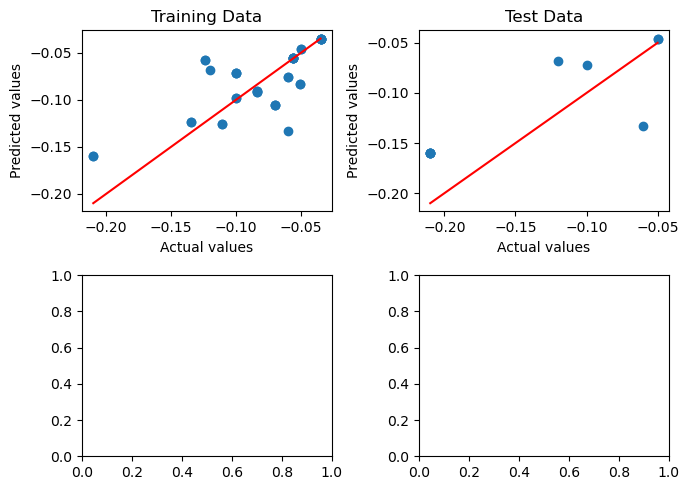

<Figure size 640x480 with 0 Axes>

[b] Epoch [460/2000], Loss: 0.0008
Train R²:  0.56502
Test R² :  0.57520


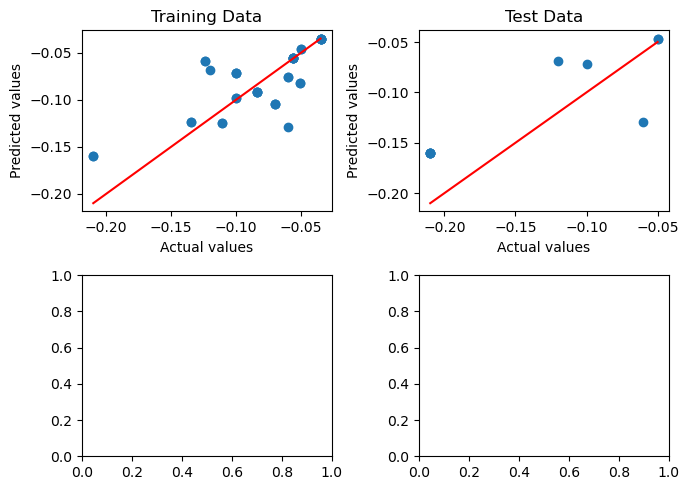

<Figure size 640x480 with 0 Axes>

[b] Epoch [480/2000], Loss: 0.0007
Train R²:  0.58111
Test R² :  0.59146


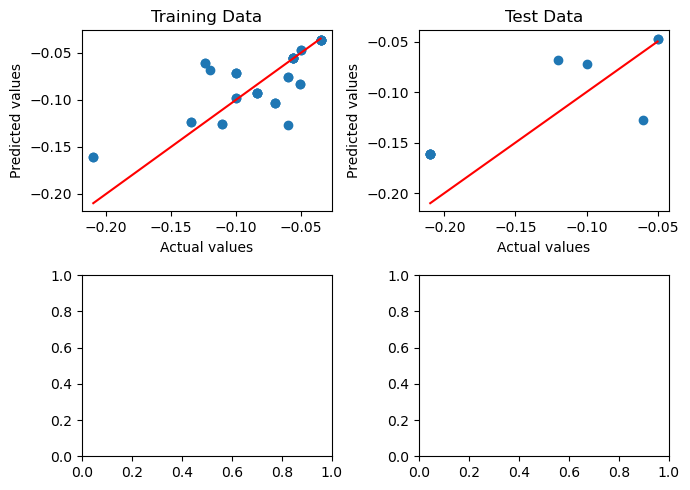

<Figure size 640x480 with 0 Axes>

[b] Epoch [500/2000], Loss: 0.0007
Train R²:  0.59648
Test R² :  0.60481


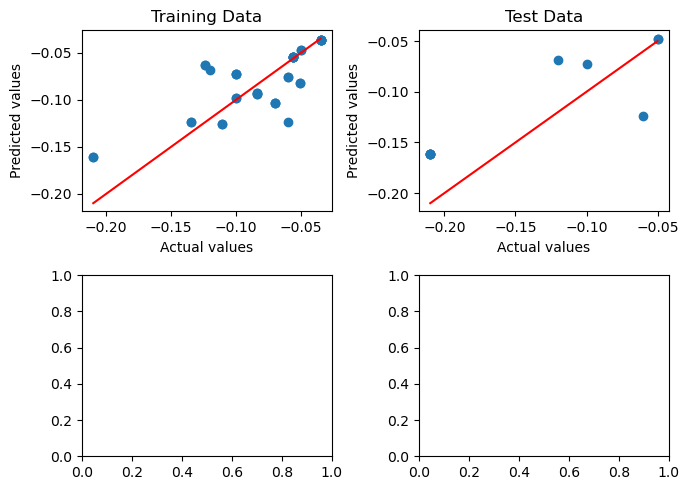

<Figure size 640x480 with 0 Axes>

[b] Epoch [520/2000], Loss: 0.0007
Train R²:  0.61176
Test R² :  0.61743


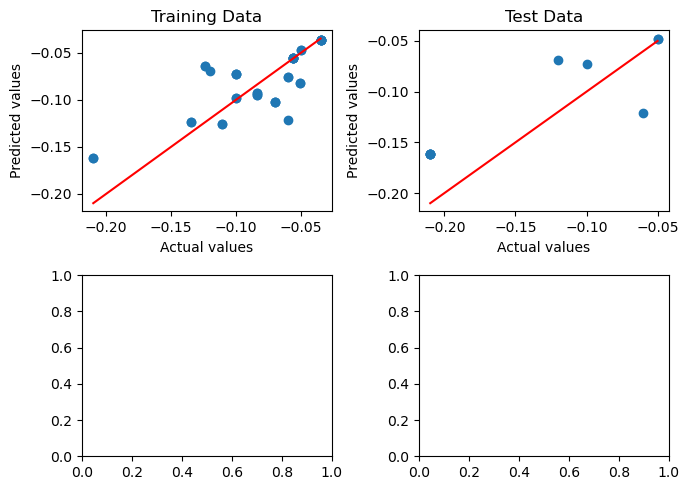

<Figure size 640x480 with 0 Axes>

[b] Epoch [540/2000], Loss: 0.0007
Train R²:  0.62671
Test R² :  0.63015


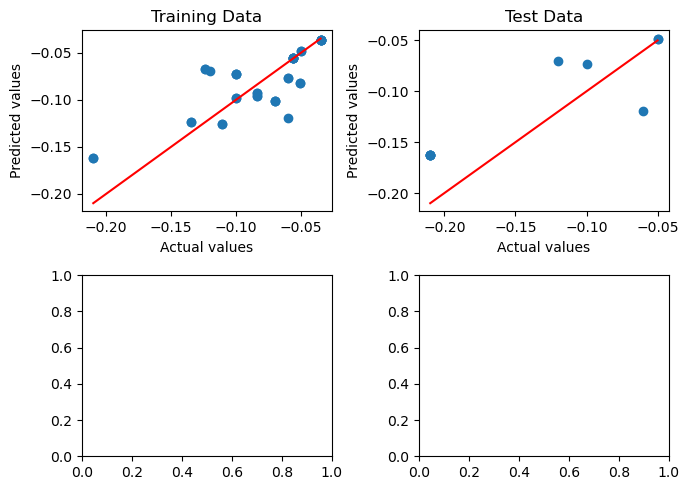

<Figure size 640x480 with 0 Axes>

[b] Epoch [560/2000], Loss: 0.0006
Train R²:  0.64160
Test R² :  0.64156


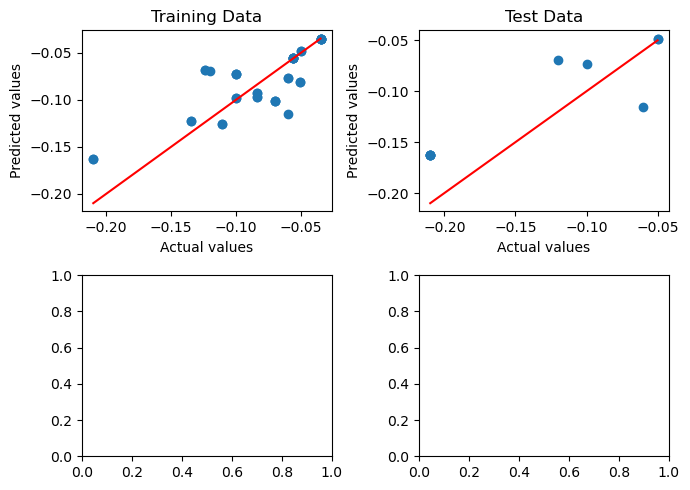

<Figure size 640x480 with 0 Axes>

[b] Epoch [580/2000], Loss: 0.0006
Train R²:  0.65612
Test R² :  0.65929


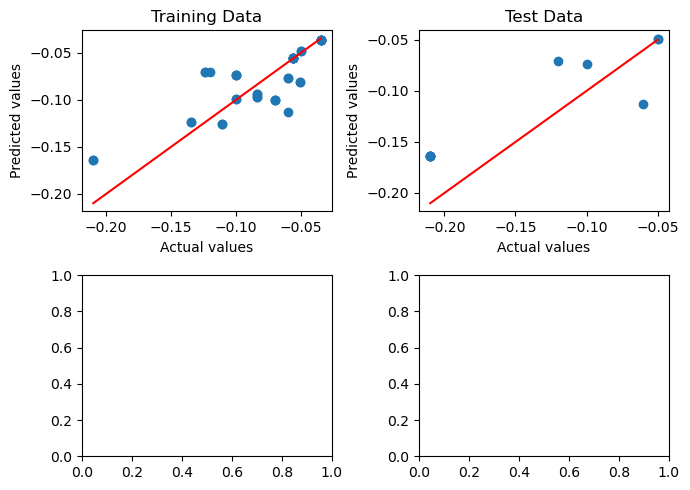

<Figure size 640x480 with 0 Axes>

[b] Epoch [600/2000], Loss: 0.0006
Train R²:  0.67014
Test R² :  0.66507


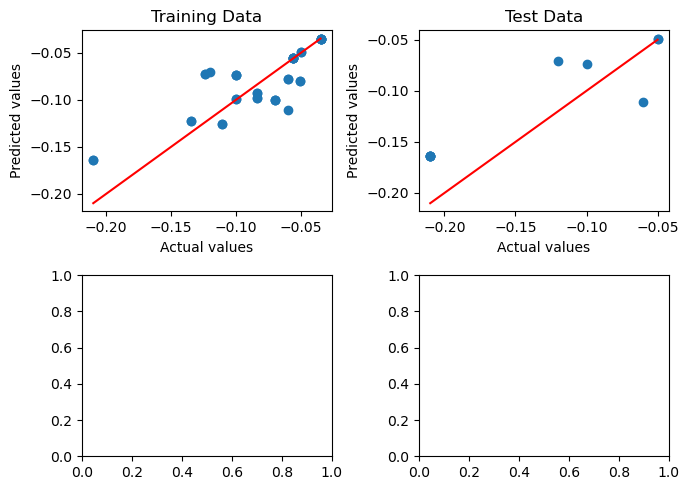

<Figure size 640x480 with 0 Axes>

[b] Epoch [620/2000], Loss: 0.0006
Train R²:  0.68397
Test R² :  0.67733


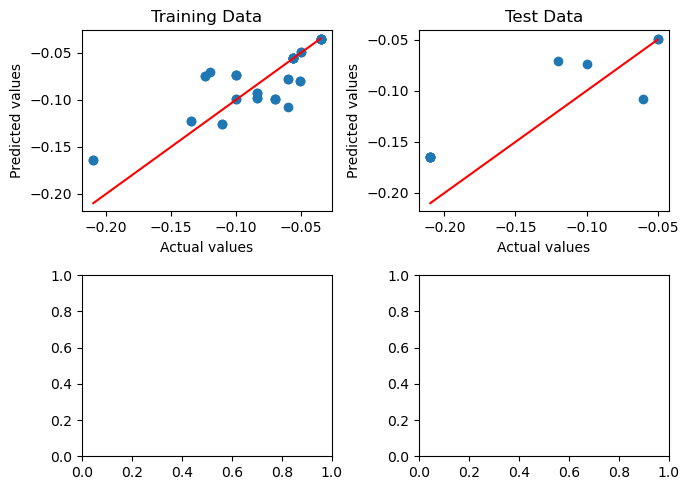

<Figure size 640x480 with 0 Axes>

[b] Epoch [640/2000], Loss: 0.0005
Train R²:  0.69735
Test R² :  0.69120


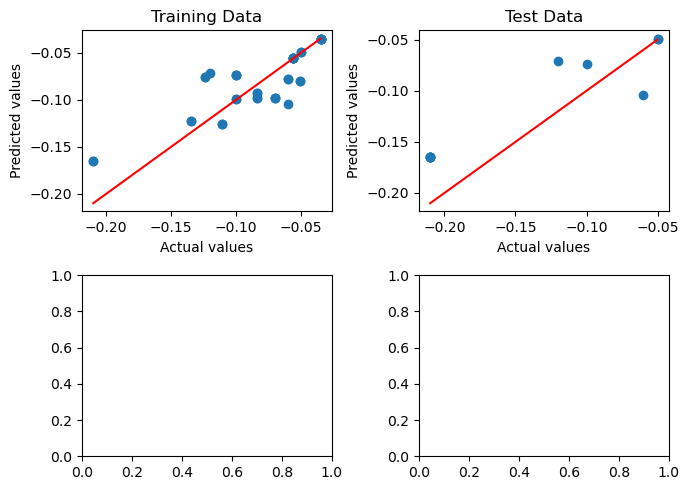

<Figure size 640x480 with 0 Axes>

[b] Epoch [660/2000], Loss: 0.0005
Train R²:  0.71025
Test R² :  0.70191


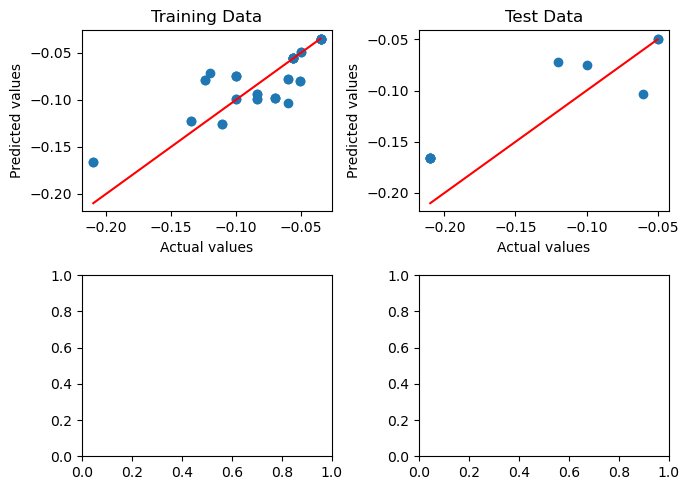

<Figure size 640x480 with 0 Axes>

[b] Epoch [680/2000], Loss: 0.0005
Train R²:  0.72251
Test R² :  0.71217


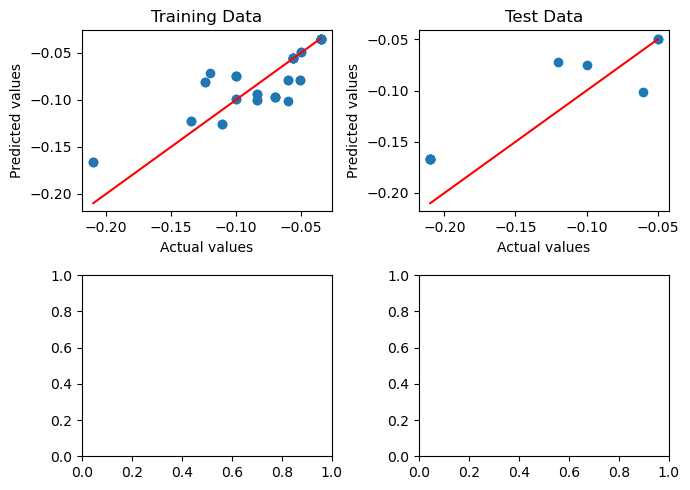

<Figure size 640x480 with 0 Axes>

[b] Epoch [700/2000], Loss: 0.0005
Train R²:  0.73472
Test R² :  0.72821


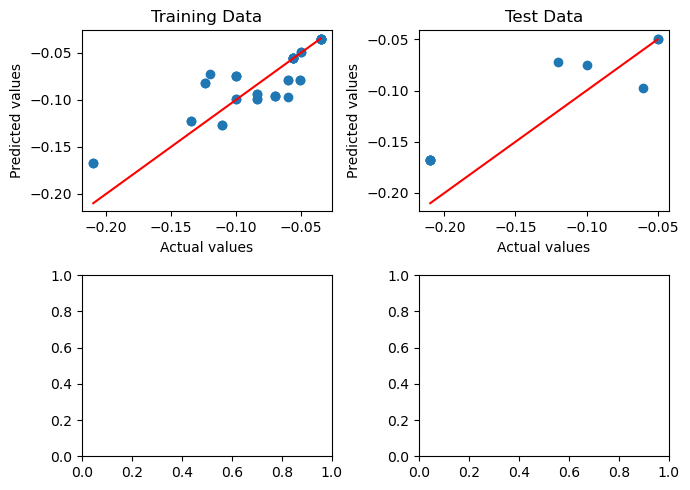

<Figure size 640x480 with 0 Axes>

[b] Epoch [720/2000], Loss: 0.0004
Train R²:  0.74625
Test R² :  0.73273


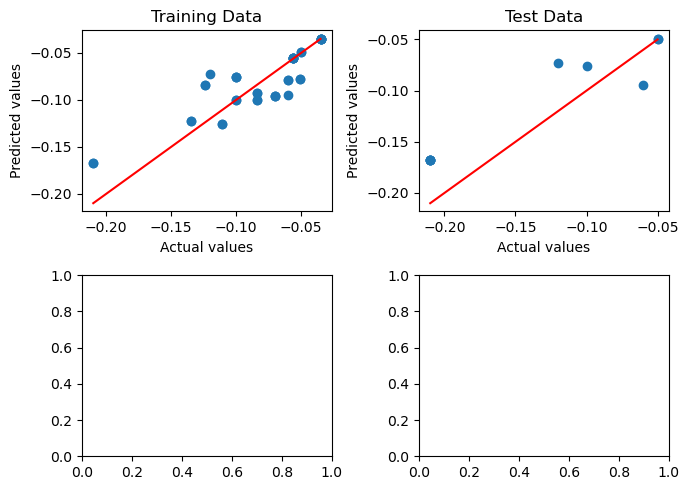

<Figure size 640x480 with 0 Axes>

[b] Epoch [740/2000], Loss: 0.0004
Train R²:  0.75711
Test R² :  0.74394


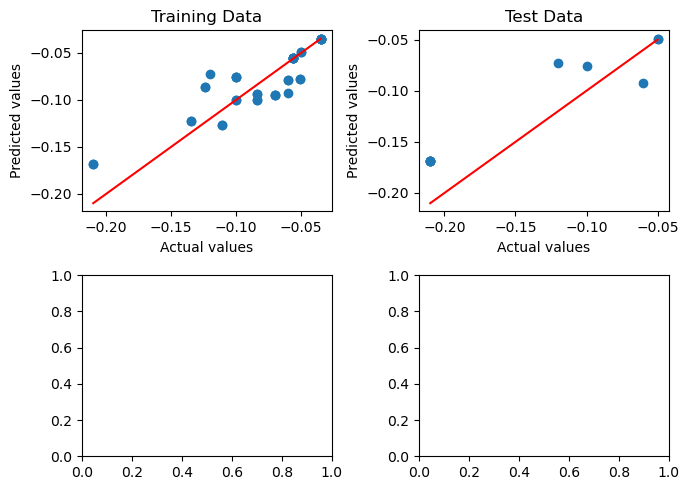

<Figure size 640x480 with 0 Axes>

[b] Epoch [760/2000], Loss: 0.0004
Train R²:  0.76667
Test R² :  0.75264


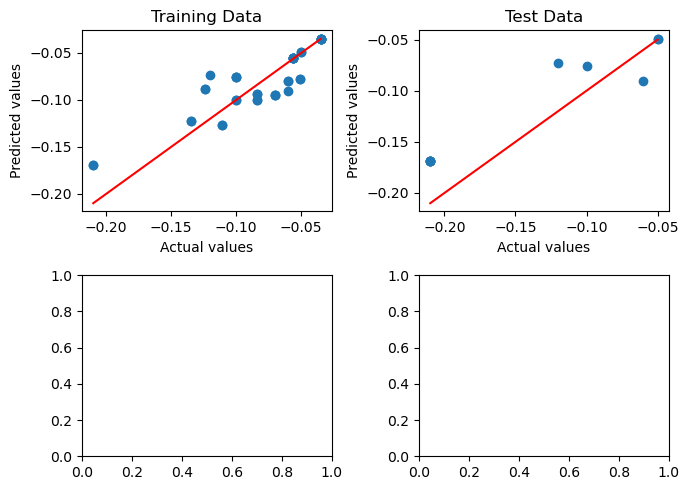

<Figure size 640x480 with 0 Axes>

[b] Epoch [780/2000], Loss: 0.0004
Train R²:  0.77559
Test R² :  0.76395


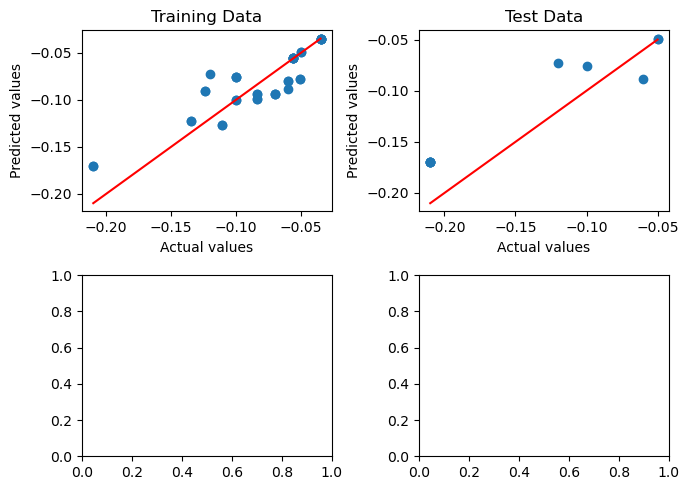

<Figure size 640x480 with 0 Axes>

[b] Epoch [800/2000], Loss: 0.0004
Train R²:  0.78402
Test R² :  0.76896


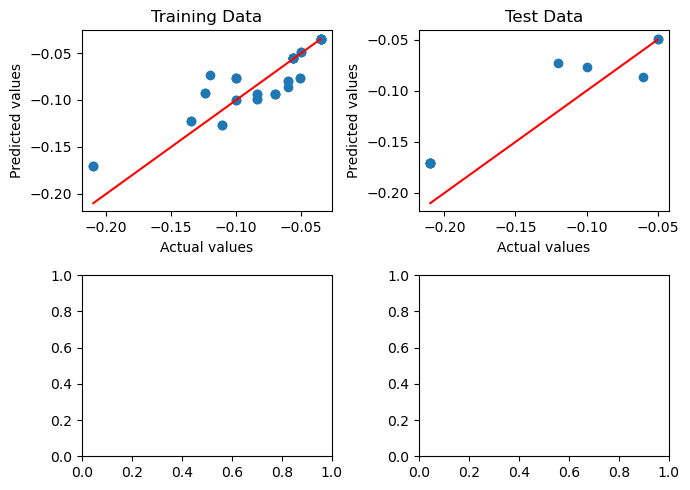

<Figure size 640x480 with 0 Axes>

[b] Epoch [820/2000], Loss: 0.0004
Train R²:  0.79206
Test R² :  0.77951


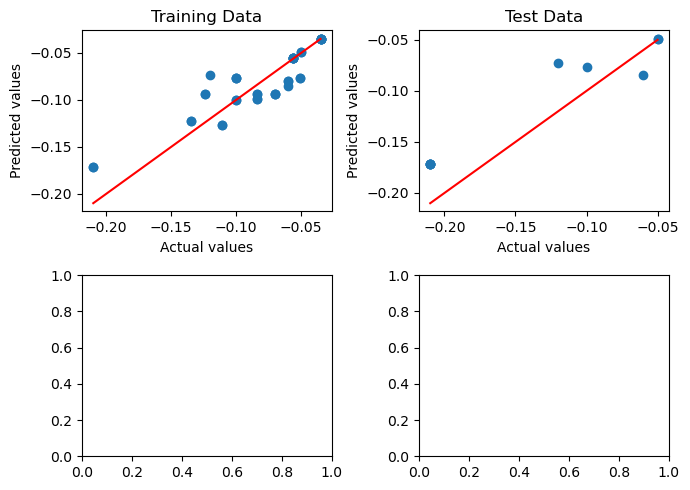

<Figure size 640x480 with 0 Axes>

[b] Epoch [840/2000], Loss: 0.0003
Train R²:  0.79970
Test R² :  0.78536


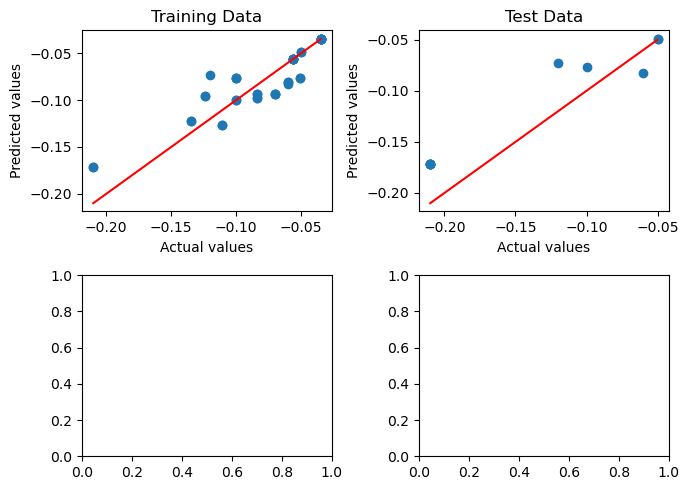

<Figure size 640x480 with 0 Axes>

[b] Epoch [860/2000], Loss: 0.0003
Train R²:  0.80689
Test R² :  0.79208


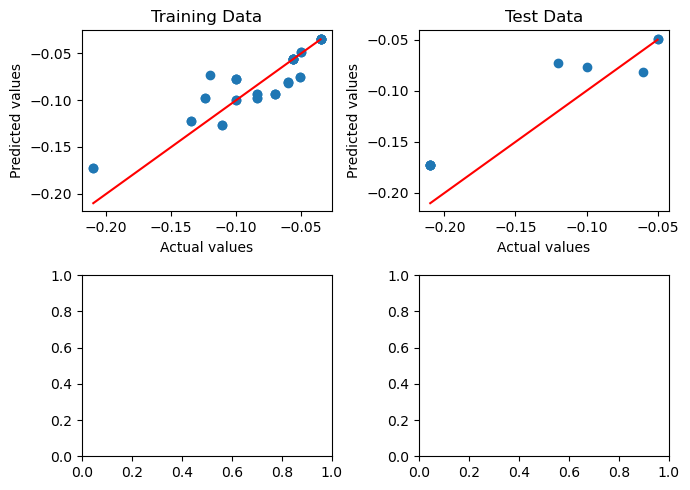

<Figure size 640x480 with 0 Axes>

[b] Epoch [880/2000], Loss: 0.0003
Train R²:  0.81349
Test R² :  0.80016


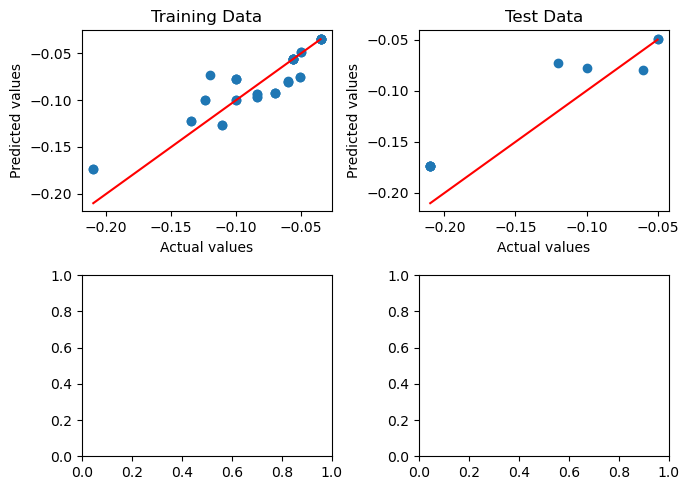

<Figure size 640x480 with 0 Axes>

[b] Epoch [900/2000], Loss: 0.0003
Train R²:  0.81958
Test R² :  0.80556


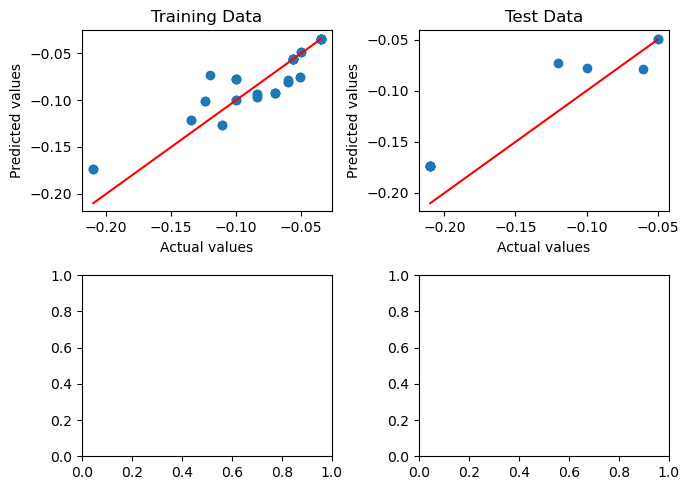

<Figure size 640x480 with 0 Axes>

[b] Epoch [920/2000], Loss: 0.0003
Train R²:  0.82528
Test R² :  0.81125


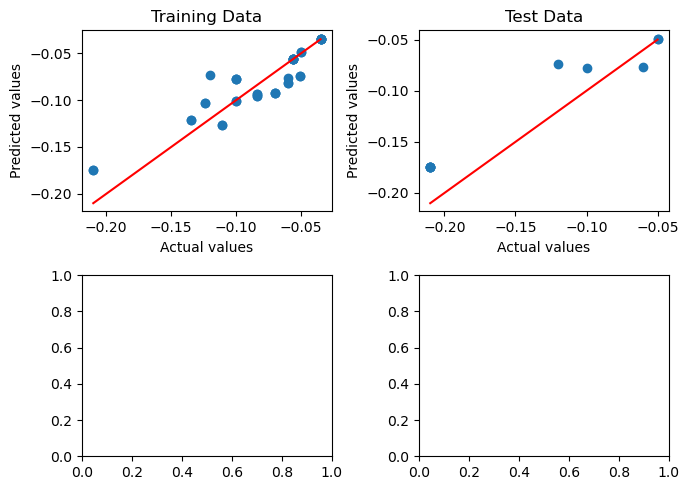

<Figure size 640x480 with 0 Axes>

[b] Epoch [940/2000], Loss: 0.0003
Train R²:  0.83062
Test R² :  0.81666


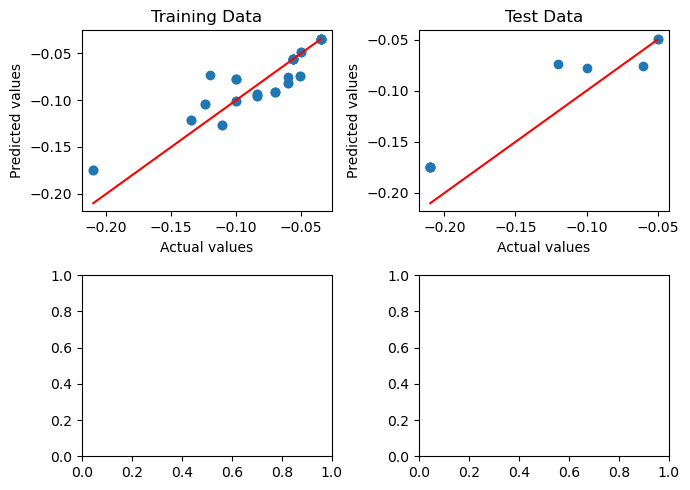

<Figure size 640x480 with 0 Axes>

[b] Epoch [960/2000], Loss: 0.0003
Train R²:  0.83565
Test R² :  0.82210


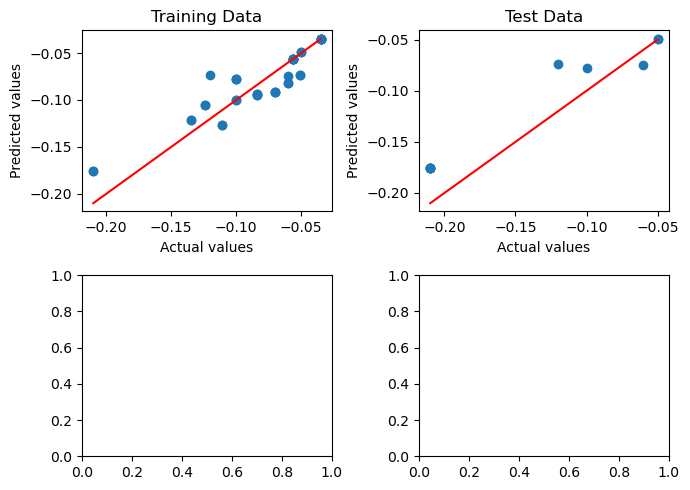

<Figure size 640x480 with 0 Axes>

[b] Epoch [980/2000], Loss: 0.0003
Train R²:  0.84039
Test R² :  0.82717


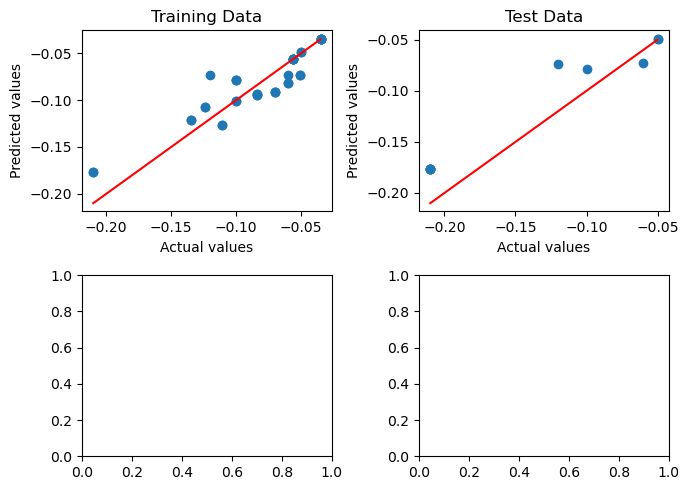

<Figure size 640x480 with 0 Axes>

[b] Epoch [1000/2000], Loss: 0.0003
Train R²:  0.84480
Test R² :  0.83086


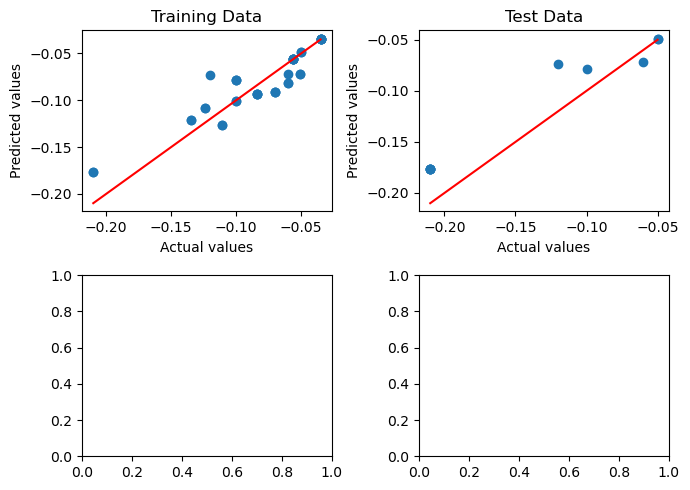

<Figure size 640x480 with 0 Axes>

[b] Epoch [1020/2000], Loss: 0.0003
Train R²:  0.84899
Test R² :  0.83722


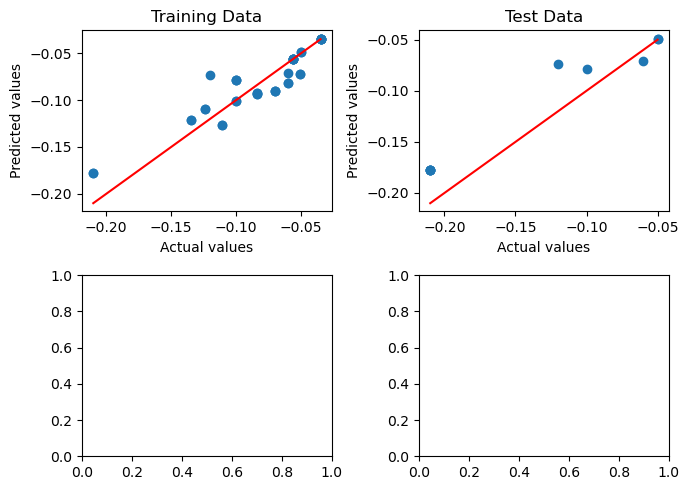

<Figure size 640x480 with 0 Axes>

[b] Epoch [1040/2000], Loss: 0.0003
Train R²:  0.85294
Test R² :  0.84096


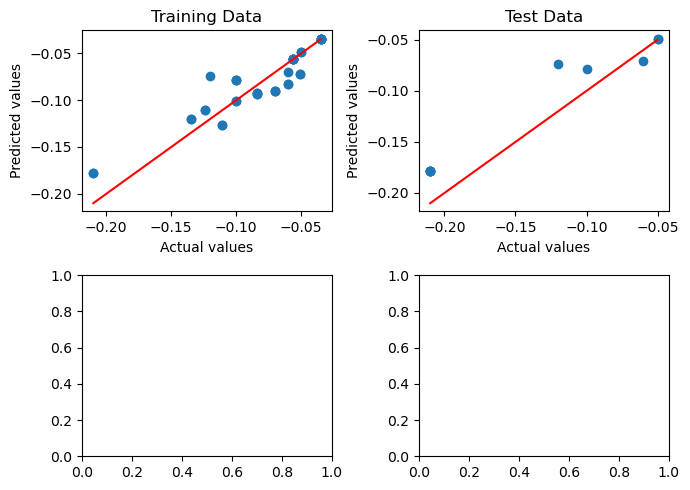

<Figure size 640x480 with 0 Axes>

[b] Epoch [1060/2000], Loss: 0.0003
Train R²:  0.85642
Test R² :  0.84552


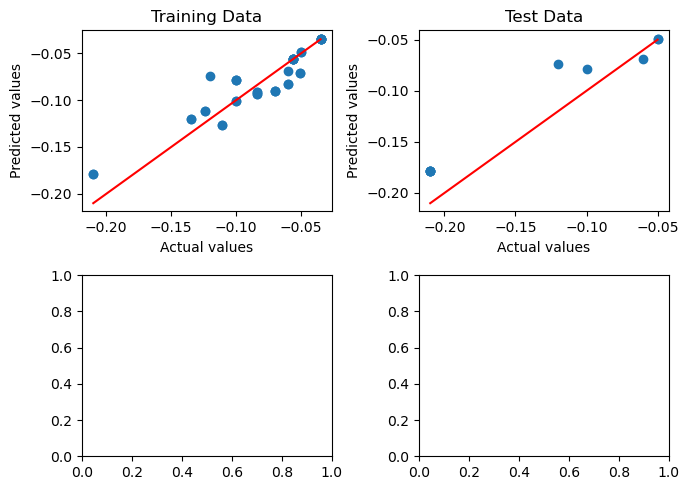

<Figure size 640x480 with 0 Axes>

[b] Epoch [1080/2000], Loss: 0.0002
Train R²:  0.85961
Test R² :  0.84974


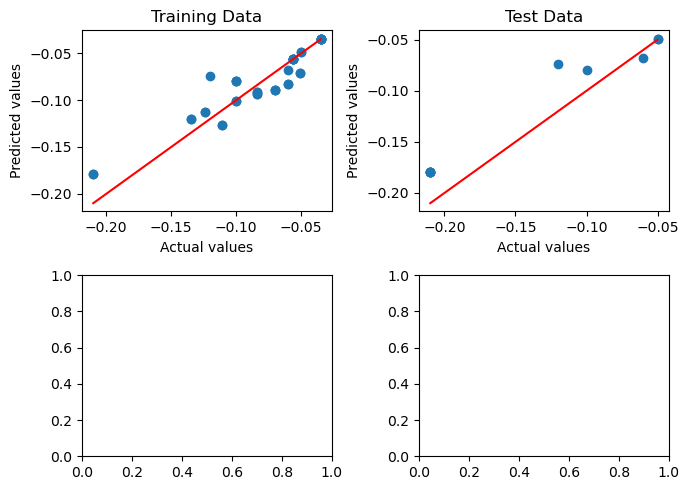

<Figure size 640x480 with 0 Axes>

[b] Epoch [1100/2000], Loss: 0.0002
Train R²:  0.86260
Test R² :  0.85264


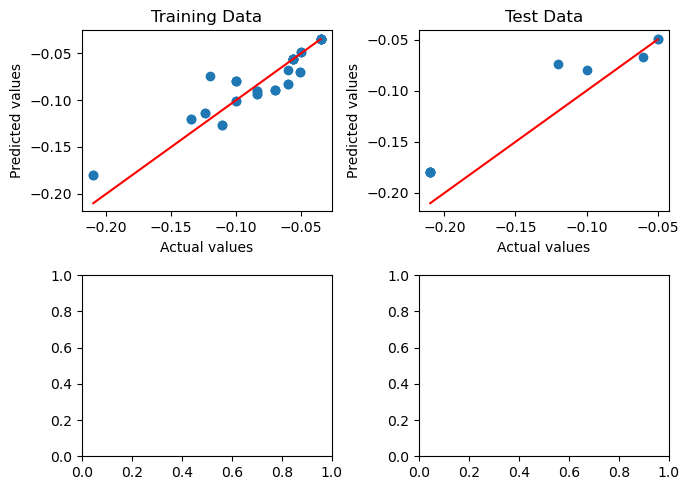

<Figure size 640x480 with 0 Axes>

[b] Epoch [1120/2000], Loss: 0.0002
Train R²:  0.86533
Test R² :  0.85574


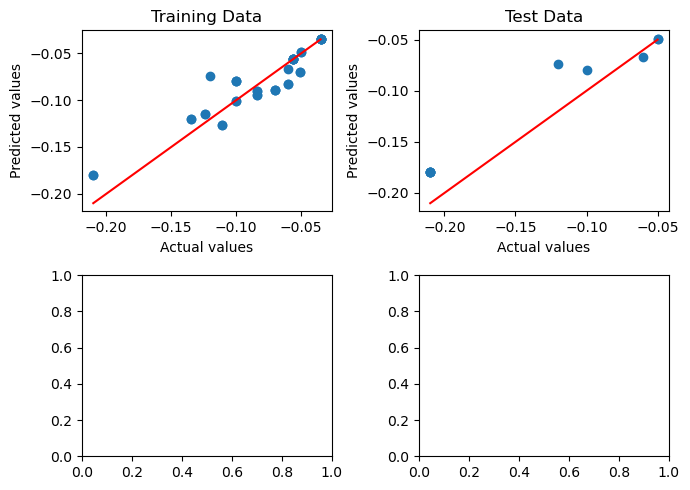

<Figure size 640x480 with 0 Axes>

[b] Epoch [1140/2000], Loss: 0.0002
Train R²:  0.86803
Test R² :  0.86056


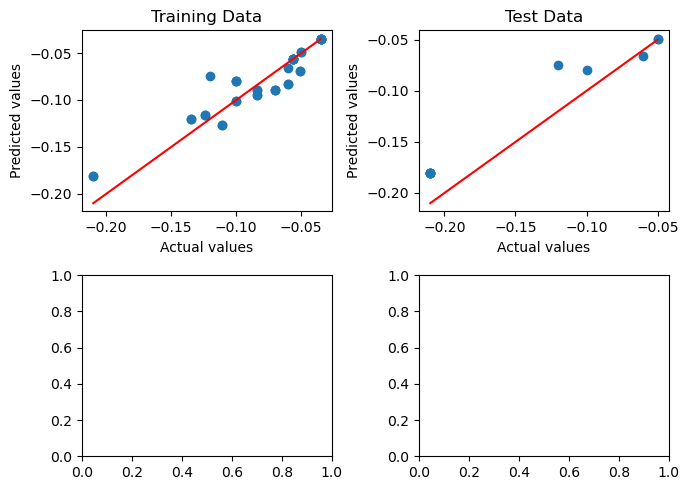

<Figure size 640x480 with 0 Axes>

[b] Epoch [1160/2000], Loss: 0.0002
Train R²:  0.87064
Test R² :  0.86286


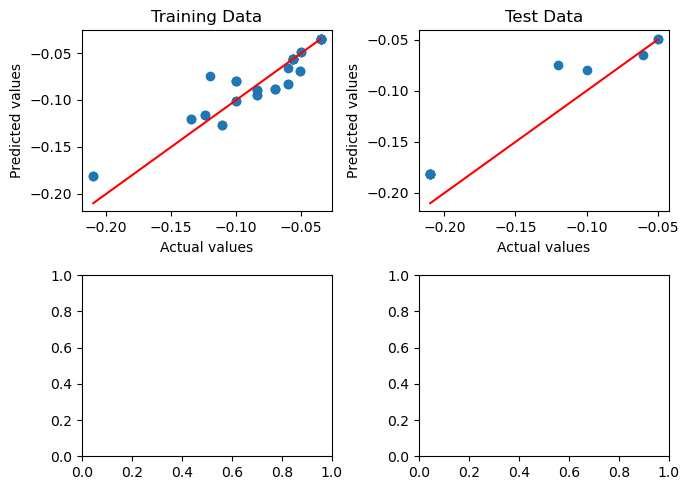

<Figure size 640x480 with 0 Axes>

[b] Epoch [1180/2000], Loss: 0.0002
Train R²:  0.87301
Test R² :  0.86538


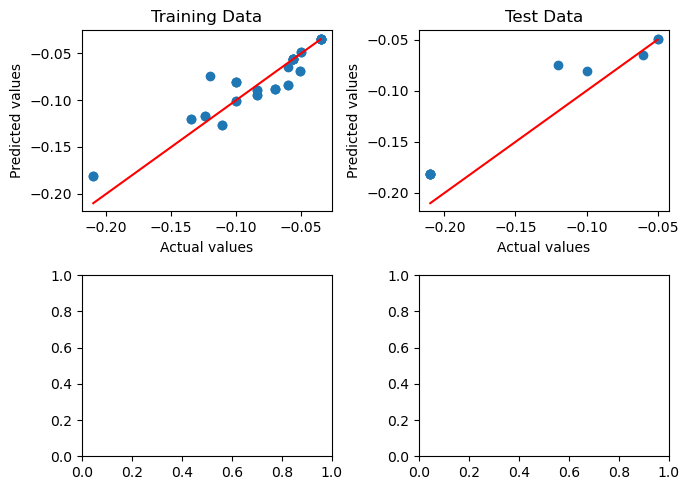

<Figure size 640x480 with 0 Axes>

[b] Epoch [1200/2000], Loss: 0.0002
Train R²:  0.87535
Test R² :  0.86987


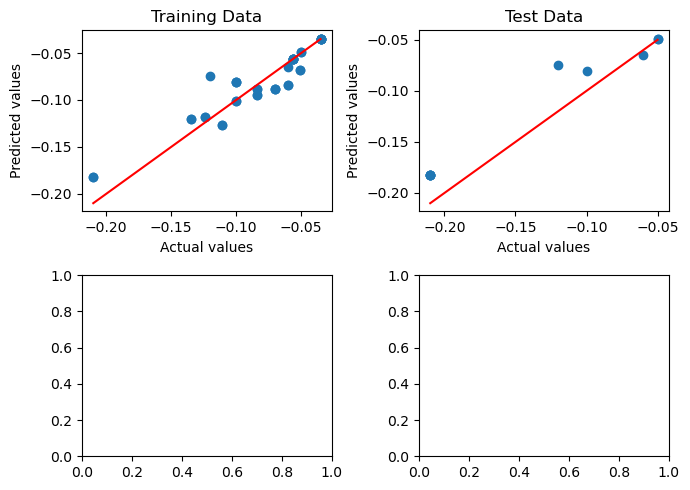

<Figure size 640x480 with 0 Axes>

[b] Epoch [1220/2000], Loss: 0.0002
Train R²:  0.87756
Test R² :  0.87165


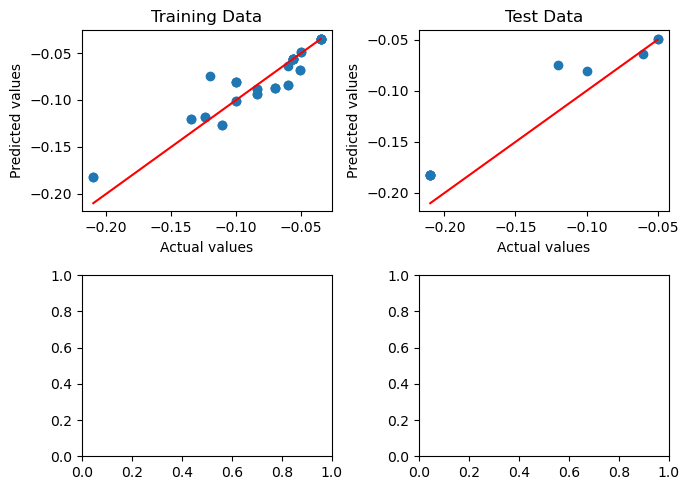

<Figure size 640x480 with 0 Axes>

[b] Epoch [1240/2000], Loss: 0.0002
Train R²:  0.87960
Test R² :  0.87425


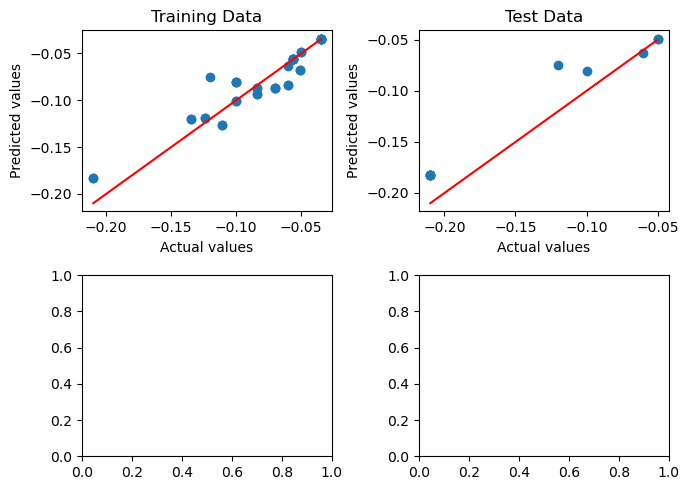

<Figure size 640x480 with 0 Axes>

[b] Epoch [1260/2000], Loss: 0.0002
Train R²:  0.88154
Test R² :  0.88022


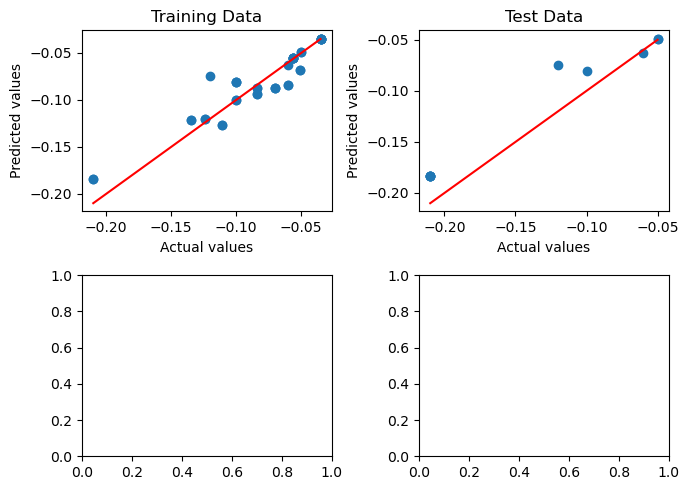

<Figure size 640x480 with 0 Axes>

[b] Epoch [1280/2000], Loss: 0.0002
Train R²:  0.88346
Test R² :  0.88155


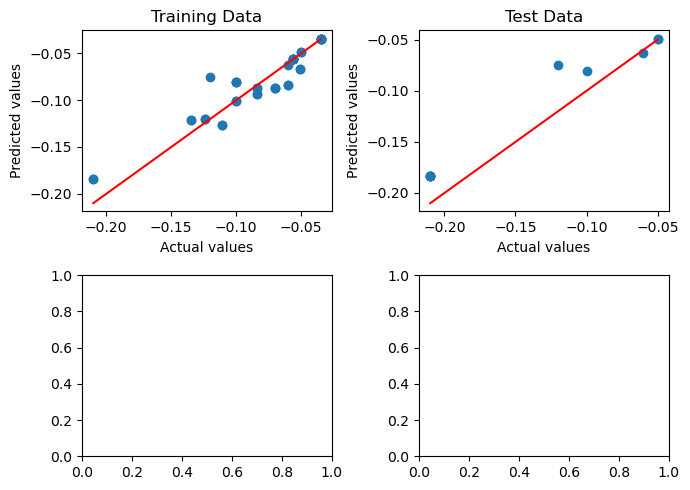

<Figure size 640x480 with 0 Axes>

[b] Epoch [1300/2000], Loss: 0.0002
Train R²:  0.88520
Test R² :  0.88601


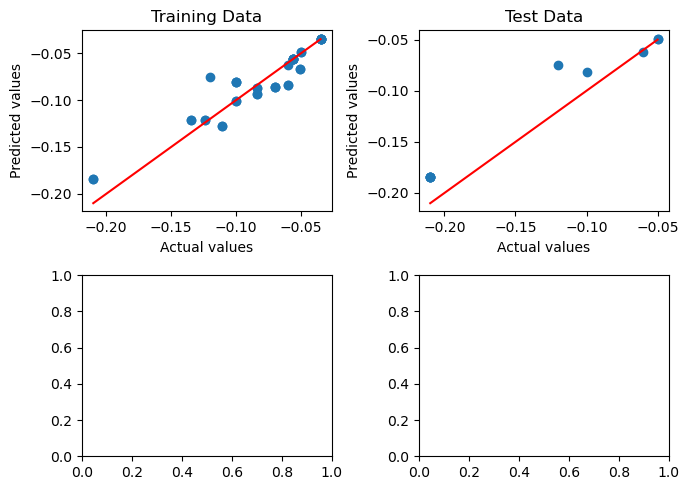

<Figure size 640x480 with 0 Axes>

[b] Epoch [1320/2000], Loss: 0.0002
Train R²:  0.88699
Test R² :  0.88612


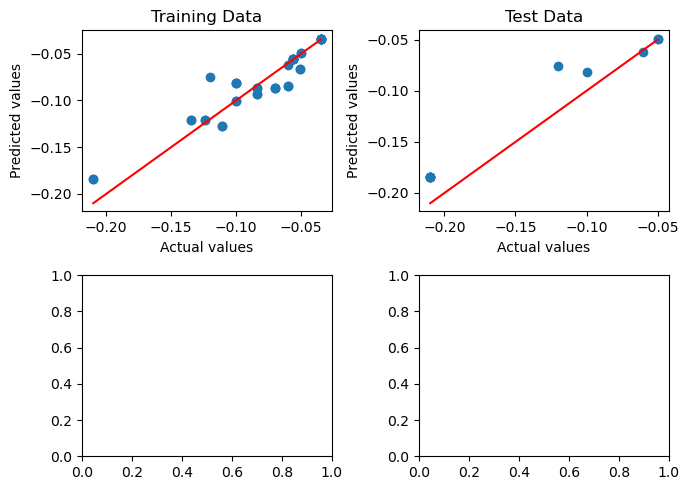

<Figure size 640x480 with 0 Axes>

[b] Epoch [1340/2000], Loss: 0.0002
Train R²:  0.88864
Test R² :  0.88894


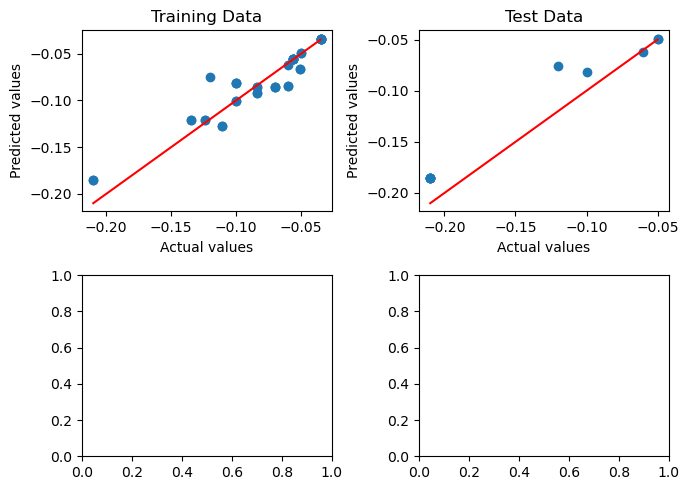

<Figure size 640x480 with 0 Axes>

[b] Epoch [1360/2000], Loss: 0.0002
Train R²:  0.89025
Test R² :  0.89214


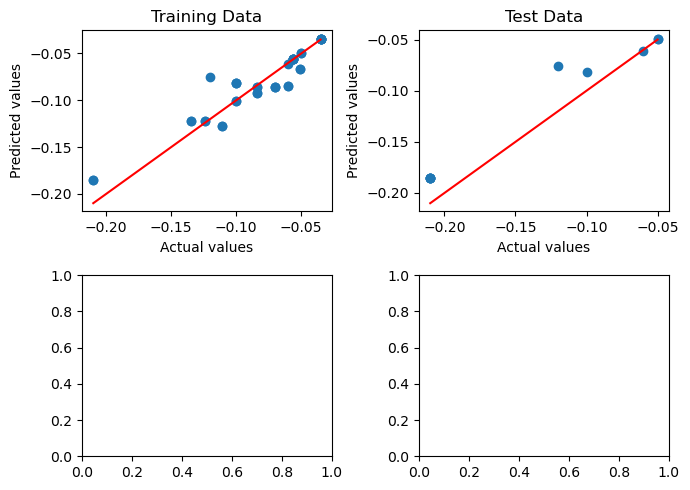

<Figure size 640x480 with 0 Axes>

[b] Epoch [1380/2000], Loss: 0.0002
Train R²:  0.89182
Test R² :  0.89403


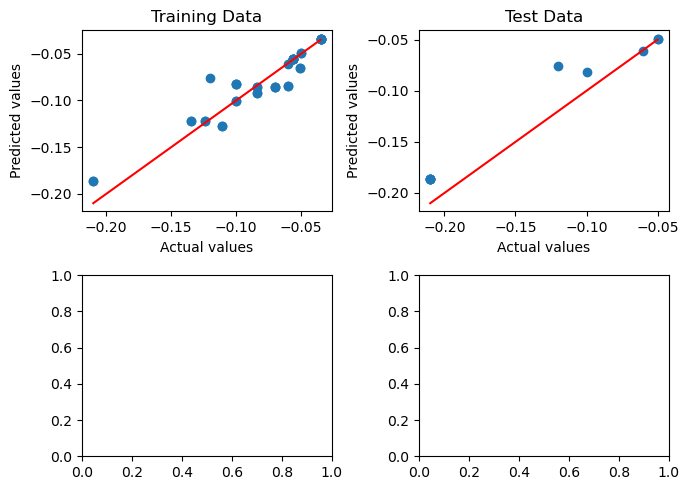

<Figure size 640x480 with 0 Axes>

[b] Epoch [1400/2000], Loss: 0.0002
Train R²:  0.89331
Test R² :  0.89677


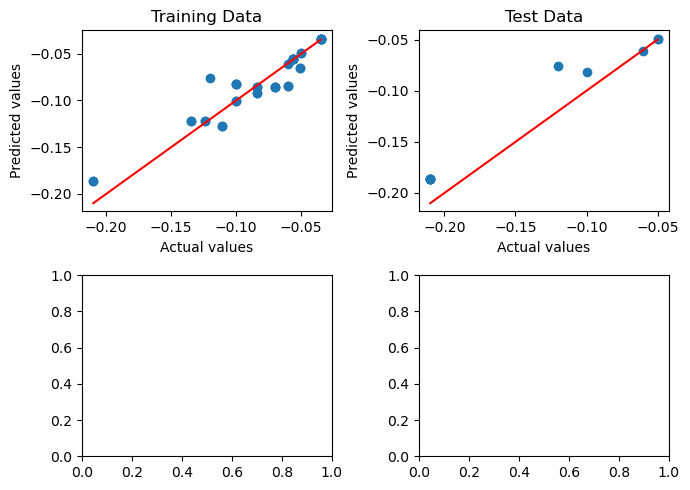

<Figure size 640x480 with 0 Axes>

[b] Epoch [1420/2000], Loss: 0.0002
Train R²:  0.89482
Test R² :  0.90002


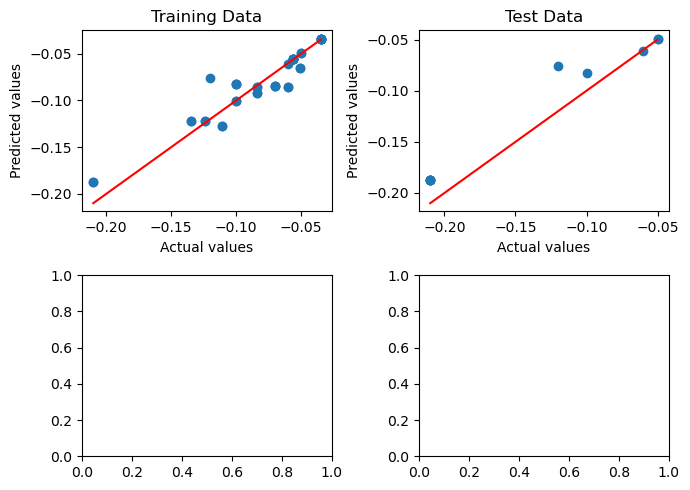

<Figure size 640x480 with 0 Axes>

[b] Epoch [1440/2000], Loss: 0.0002
Train R²:  0.89628
Test R² :  0.90198


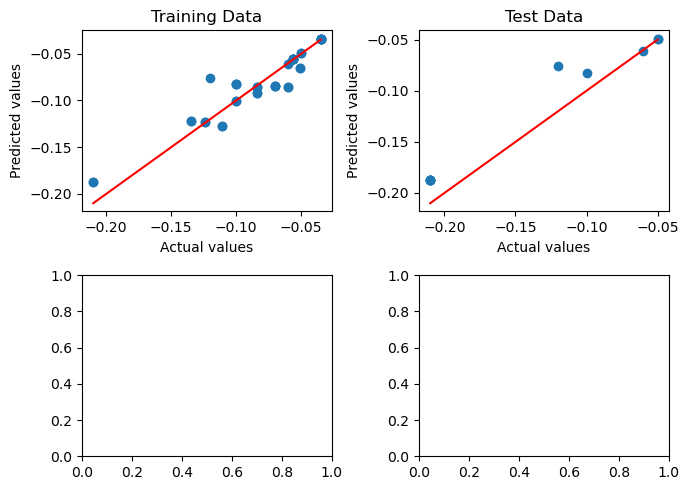

<Figure size 640x480 with 0 Axes>

[b] Epoch [1460/2000], Loss: 0.0002
Train R²:  0.89769
Test R² :  0.90380


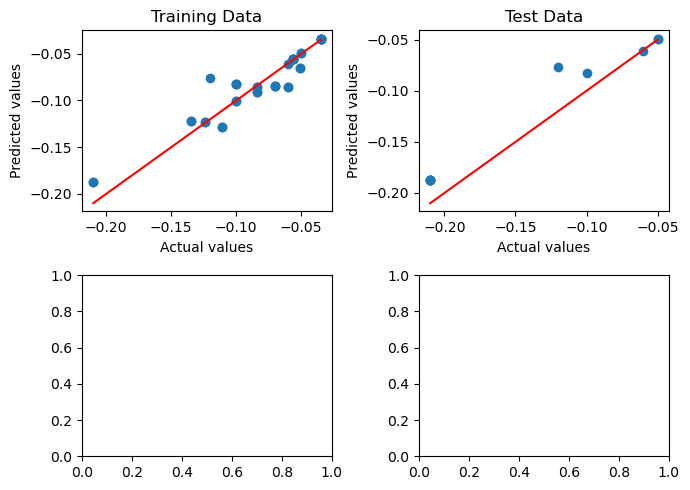

<Figure size 640x480 with 0 Axes>

[b] Epoch [1480/2000], Loss: 0.0002
Train R²:  0.89908
Test R² :  0.90662


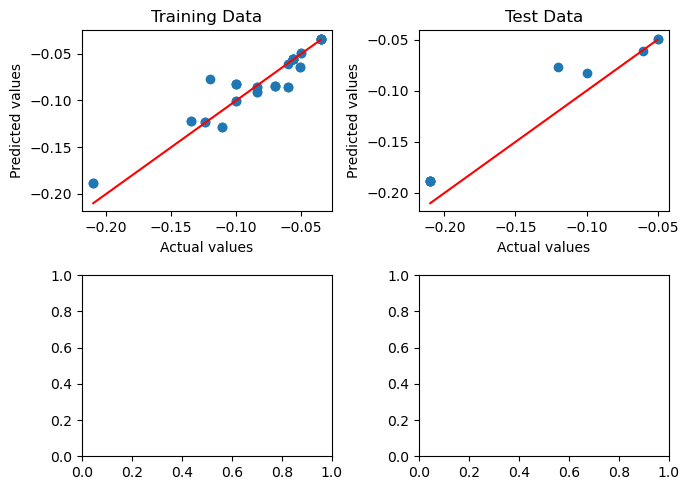

<Figure size 640x480 with 0 Axes>

[b] Epoch [1500/2000], Loss: 0.0002
Train R²:  0.90045
Test R² :  0.90837


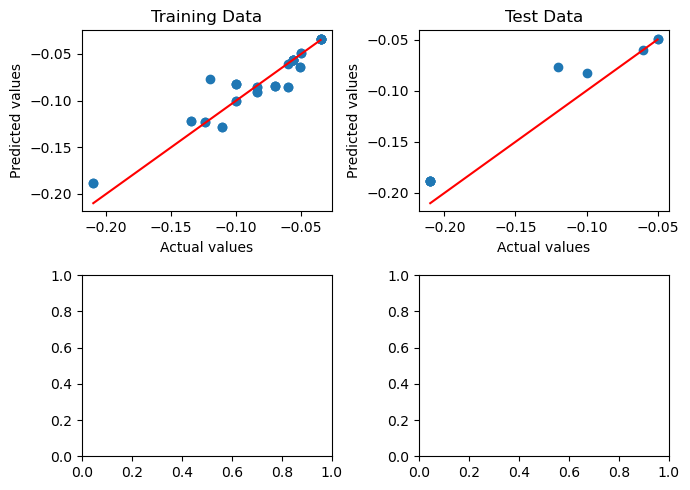

<Figure size 640x480 with 0 Axes>

[b] Epoch [1520/2000], Loss: 0.0002
Train R²:  0.90175
Test R² :  0.90901


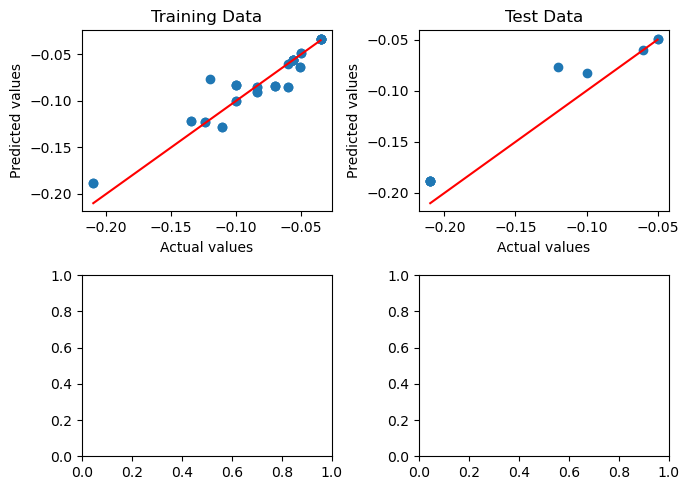

<Figure size 640x480 with 0 Axes>

[b] Epoch [1540/2000], Loss: 0.0002
Train R²:  0.90310
Test R² :  0.91224


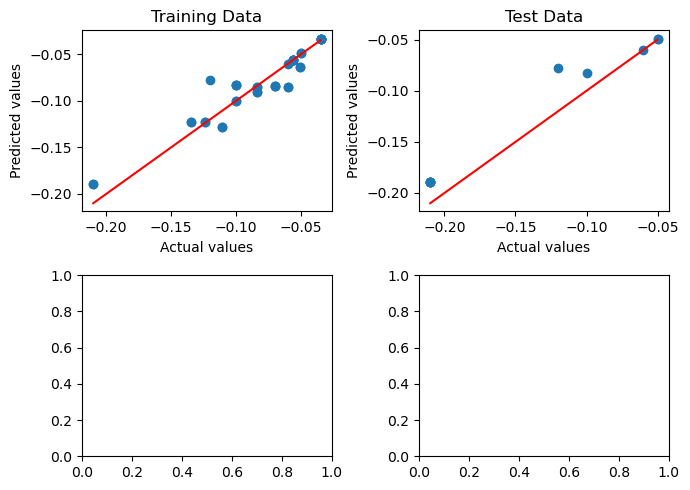

<Figure size 640x480 with 0 Axes>

[b] Epoch [1560/2000], Loss: 0.0002
Train R²:  0.90438
Test R² :  0.91572


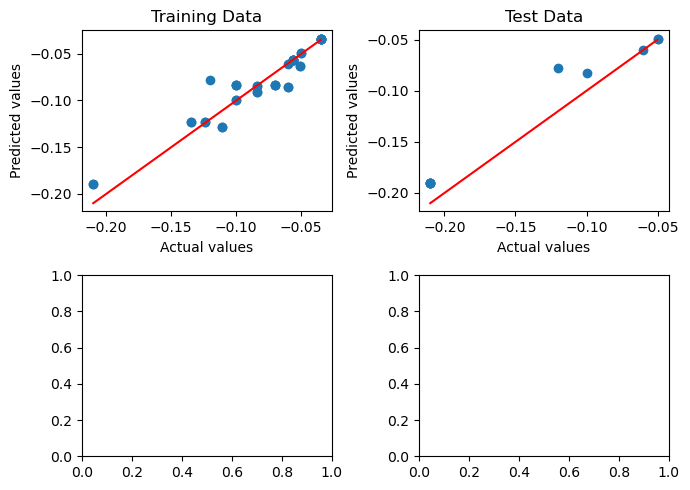

<Figure size 640x480 with 0 Axes>

[b] Epoch [1580/2000], Loss: 0.0002
Train R²:  0.90566
Test R² :  0.91734


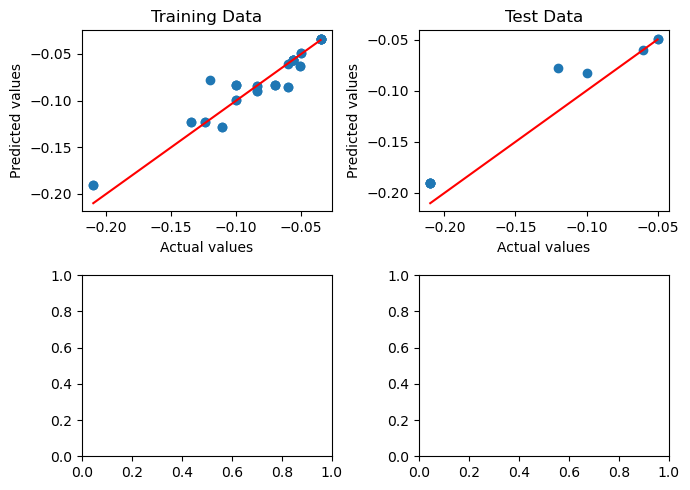

<Figure size 640x480 with 0 Axes>

[b] Epoch [1600/2000], Loss: 0.0002
Train R²:  0.90687
Test R² :  0.91893


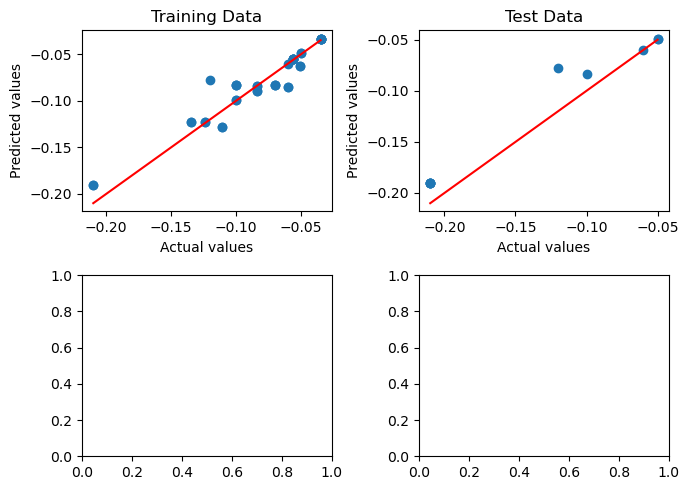

<Figure size 640x480 with 0 Axes>

[b] Epoch [1620/2000], Loss: 0.0002
Train R²:  0.90812
Test R² :  0.92120


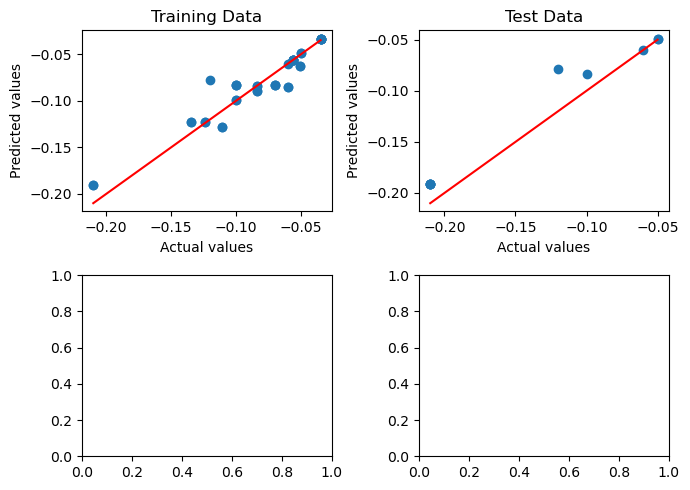

<Figure size 640x480 with 0 Axes>

[b] Epoch [1640/2000], Loss: 0.0002
Train R²:  0.90934
Test R² :  0.92322


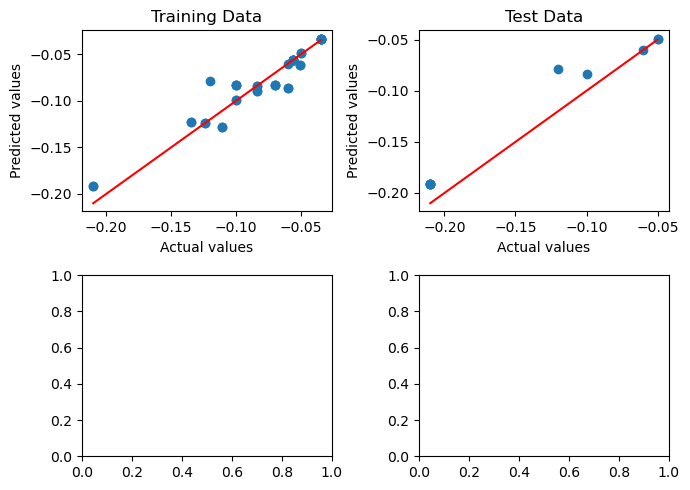

<Figure size 640x480 with 0 Axes>

[b] Epoch [1660/2000], Loss: 0.0002
Train R²:  0.91052
Test R² :  0.92612


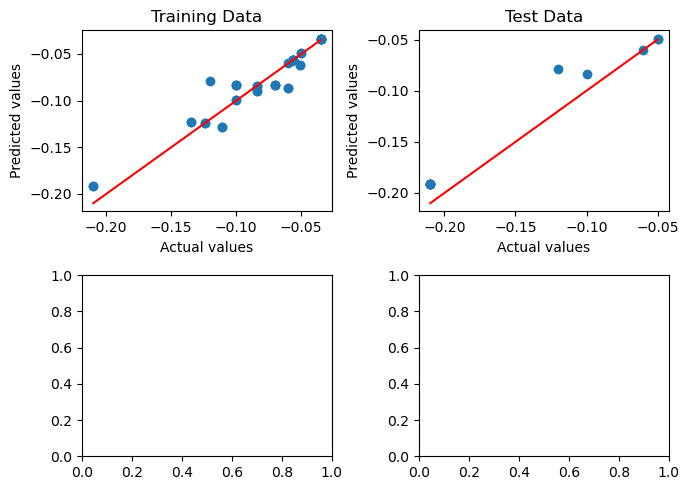

<Figure size 640x480 with 0 Axes>

[b] Epoch [1680/2000], Loss: 0.0002
Train R²:  0.91167
Test R² :  0.92672


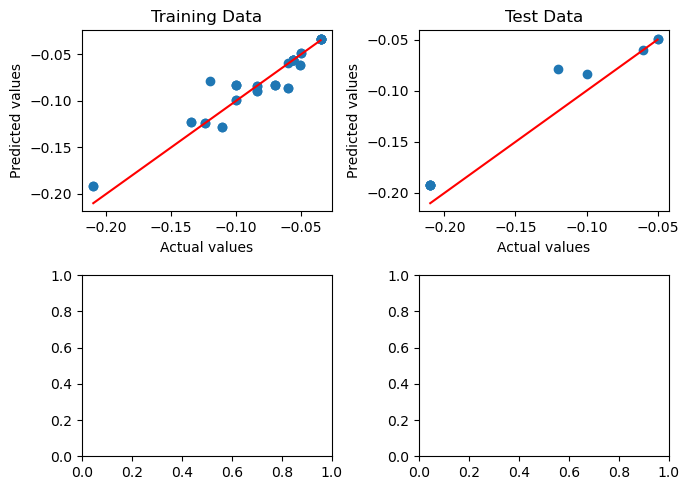

<Figure size 640x480 with 0 Axes>

[b] Epoch [1700/2000], Loss: 0.0002
Train R²:  0.91284
Test R² :  0.92954


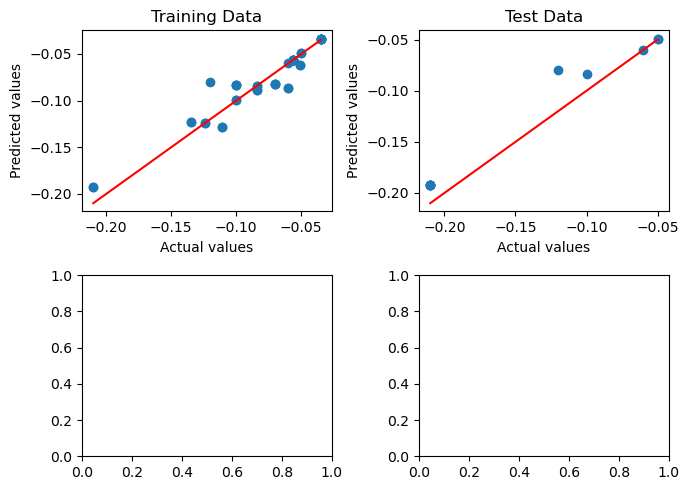

<Figure size 640x480 with 0 Axes>

[b] Epoch [1720/2000], Loss: 0.0002
Train R²:  0.91398
Test R² :  0.93092


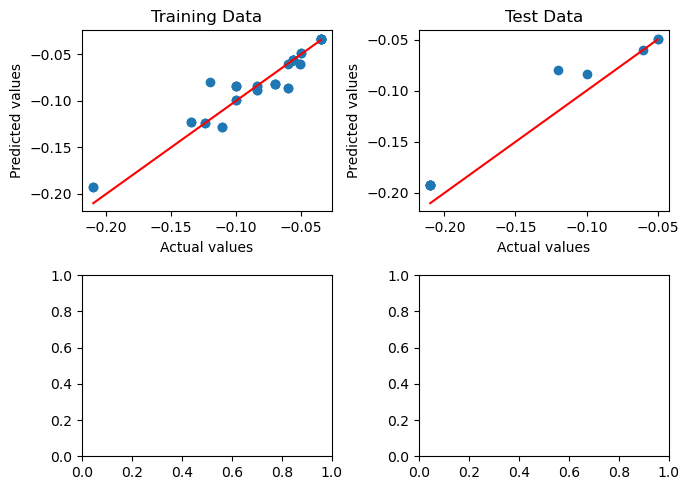

<Figure size 640x480 with 0 Axes>

[b] Epoch [1740/2000], Loss: 0.0001
Train R²:  0.91509
Test R² :  0.93368


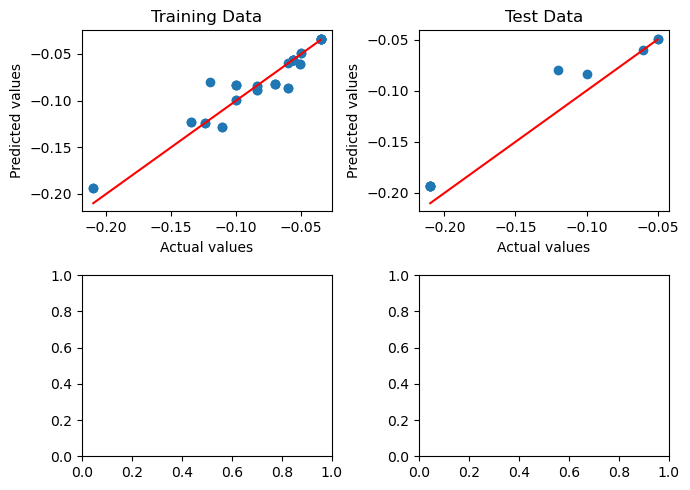

<Figure size 640x480 with 0 Axes>

[b] Epoch [1760/2000], Loss: 0.0001
Train R²:  0.91619
Test R² :  0.93545


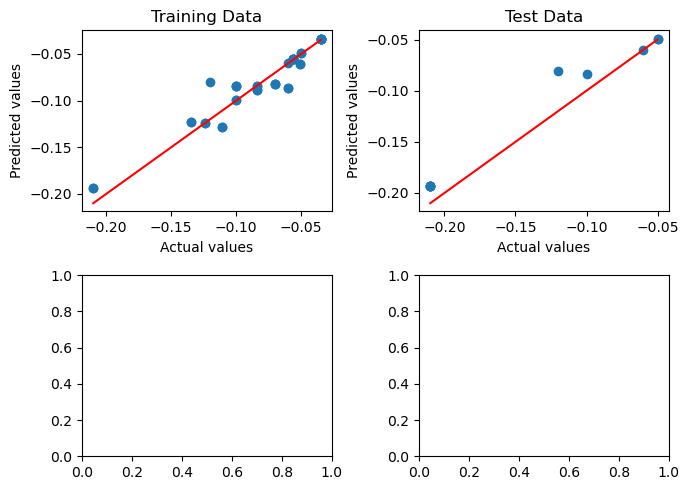

<Figure size 640x480 with 0 Axes>

[b] Epoch [1780/2000], Loss: 0.0001
Train R²:  0.91730
Test R² :  0.93666


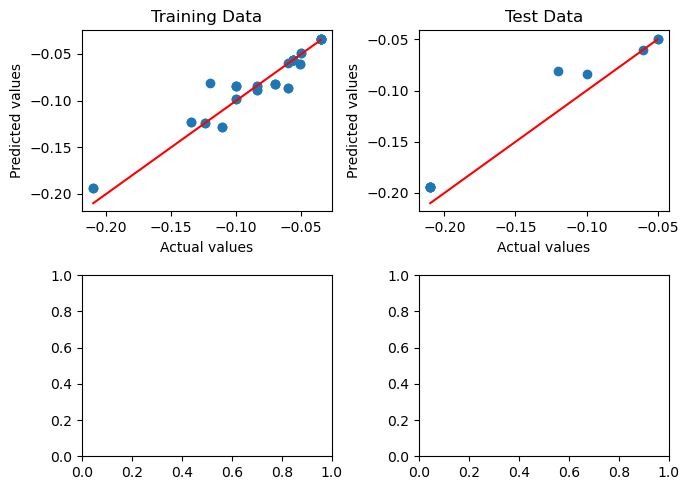

<Figure size 640x480 with 0 Axes>

[b] Epoch [1800/2000], Loss: 0.0001
Train R²:  0.91835
Test R² :  0.93891


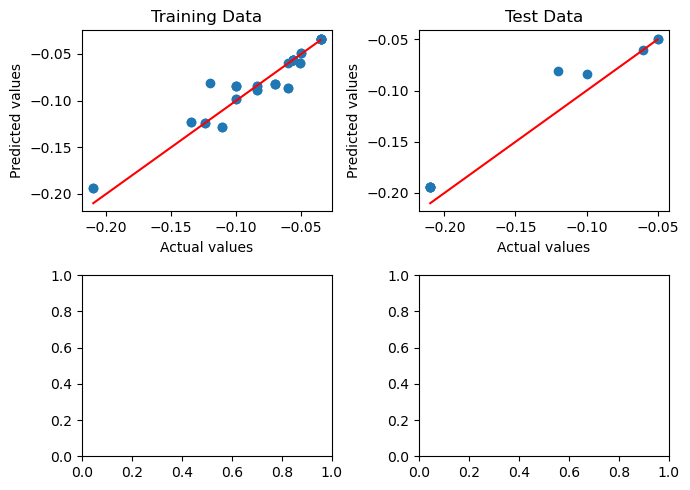

<Figure size 640x480 with 0 Axes>

[b] Epoch [1820/2000], Loss: 0.0001
Train R²:  0.92068
Test R² :  0.94214


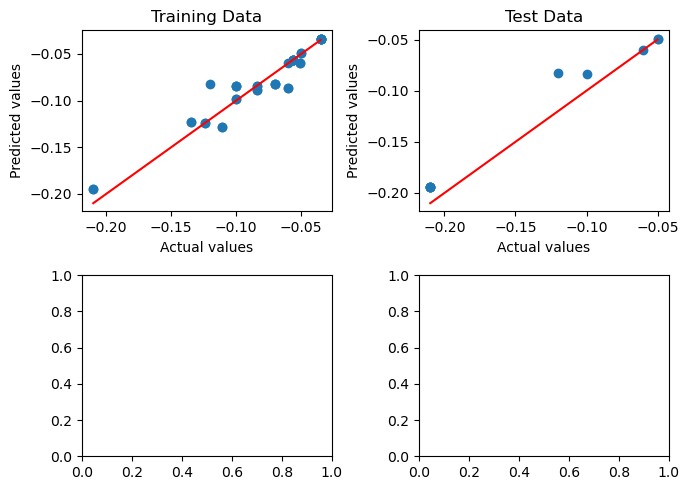

<Figure size 640x480 with 0 Axes>

[b] Epoch [1840/2000], Loss: 0.0001
Train R²:  0.92357
Test R² :  0.94654


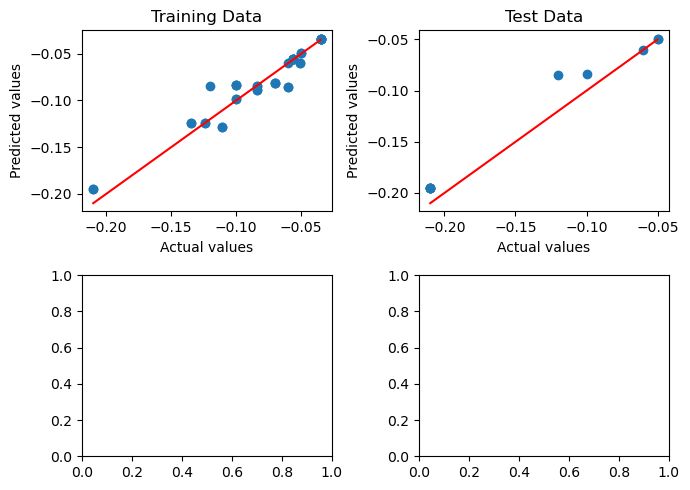

<Figure size 640x480 with 0 Axes>

[b] Epoch [1860/2000], Loss: 0.0001
Train R²:  0.92457
Test R² :  0.94710


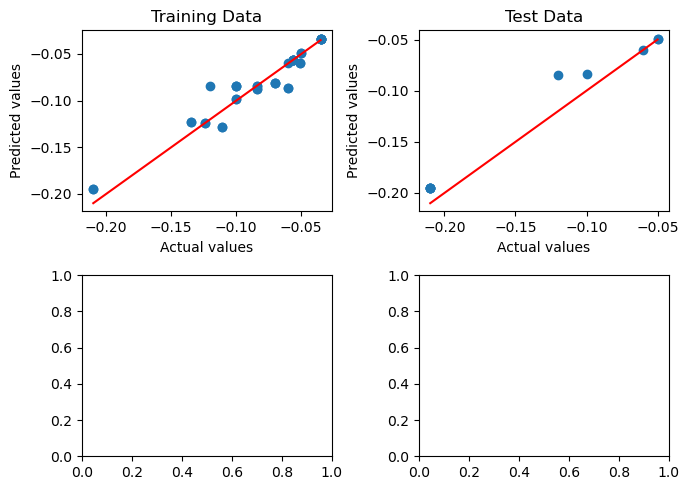

<Figure size 640x480 with 0 Axes>

[b] Epoch [1880/2000], Loss: 0.0001
Train R²:  0.92551
Test R² :  0.94813


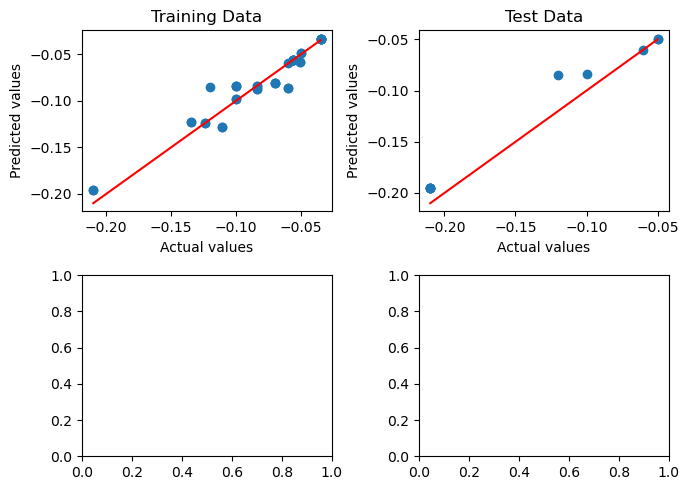

<Figure size 640x480 with 0 Axes>

[b] Epoch [1900/2000], Loss: 0.0001
Train R²:  0.92644
Test R² :  0.95035


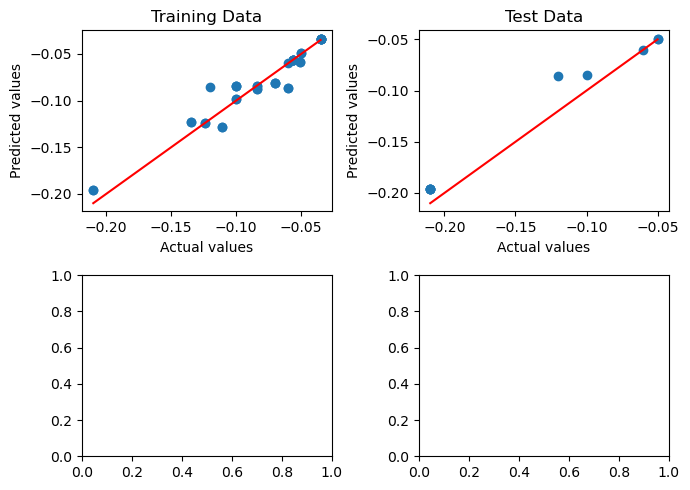

<Figure size 640x480 with 0 Axes>

[b] Epoch [1920/2000], Loss: 0.0001
Train R²:  0.92733
Test R² :  0.95154


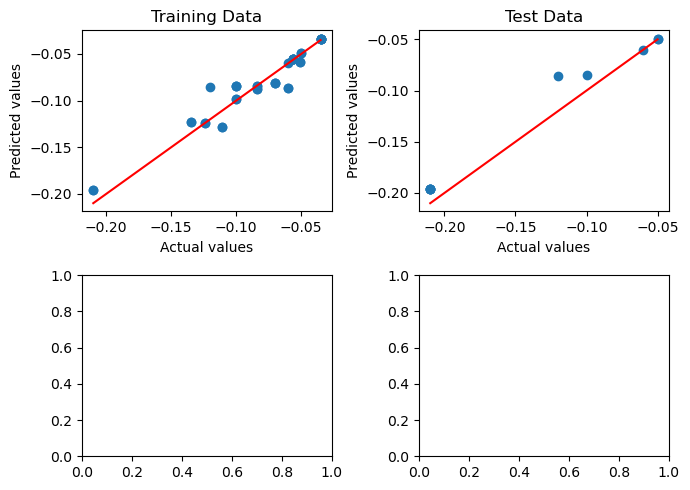

<Figure size 640x480 with 0 Axes>

[b] Epoch [1940/2000], Loss: 0.0001
Train R²:  0.92819
Test R² :  0.95233


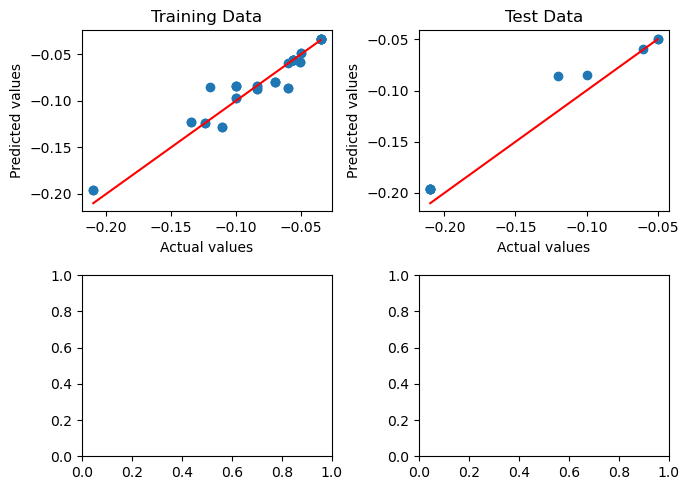

<Figure size 640x480 with 0 Axes>

[b] Epoch [1960/2000], Loss: 0.0001
Train R²:  0.92901
Test R² :  0.95396


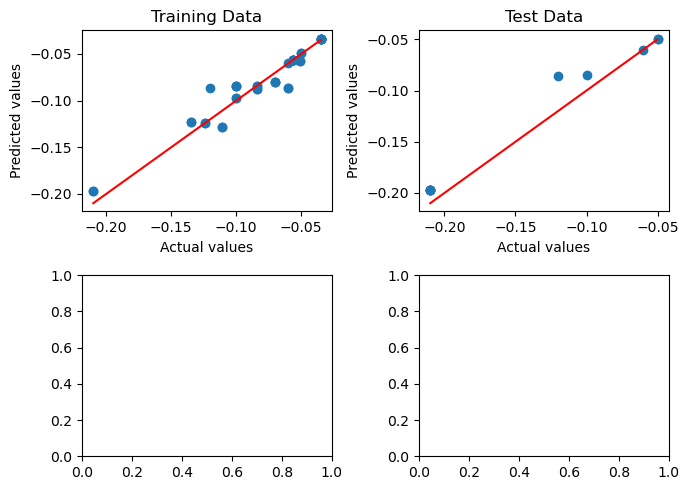

<Figure size 640x480 with 0 Axes>

[b] Epoch [1980/2000], Loss: 0.0001
Train R²:  0.92981
Test R² :  0.95527


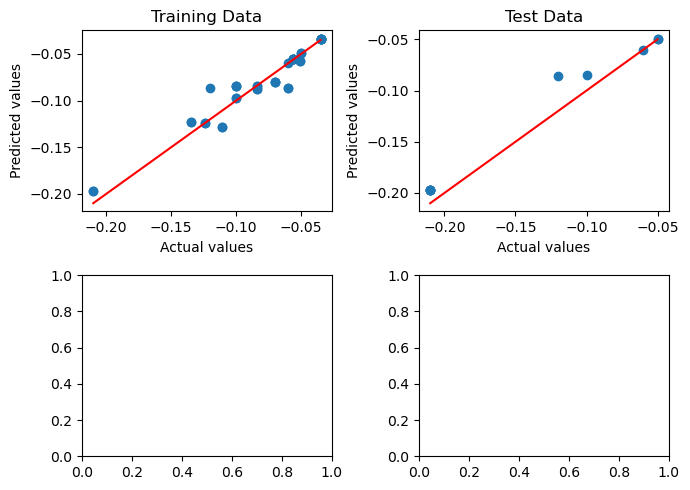

<Figure size 640x480 with 0 Axes>

[b] Epoch [2000/2000], Loss: 0.0001
Train R²:  0.93059
Test R² :  0.95651


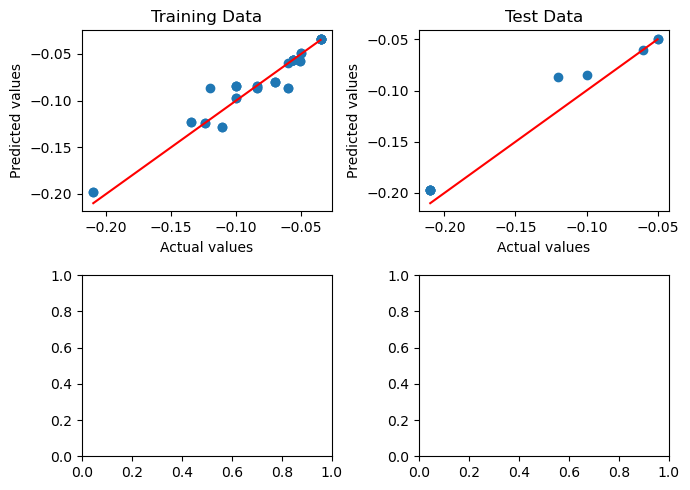

<Figure size 640x480 with 0 Axes>

In [9]:
GBR_NN(5)

[Epsilonf] Epoch [20/2000], Loss: 0.8715
Train R²:  0.19211
Test R² :  0.51356


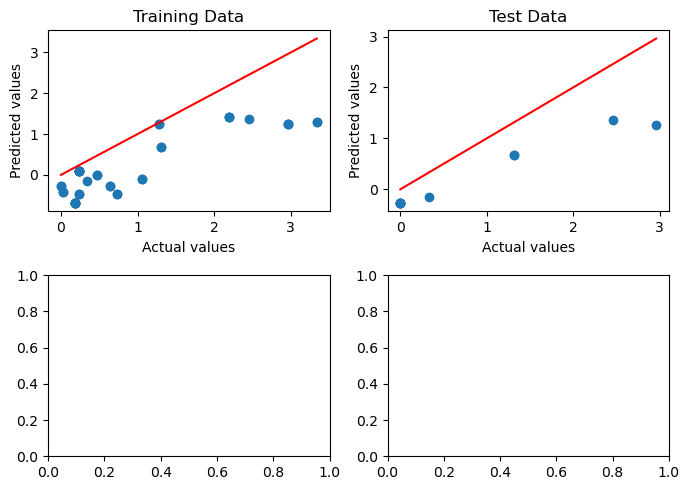

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [40/2000], Loss: 0.2519
Train R²:  0.76648
Test R² :  0.86593


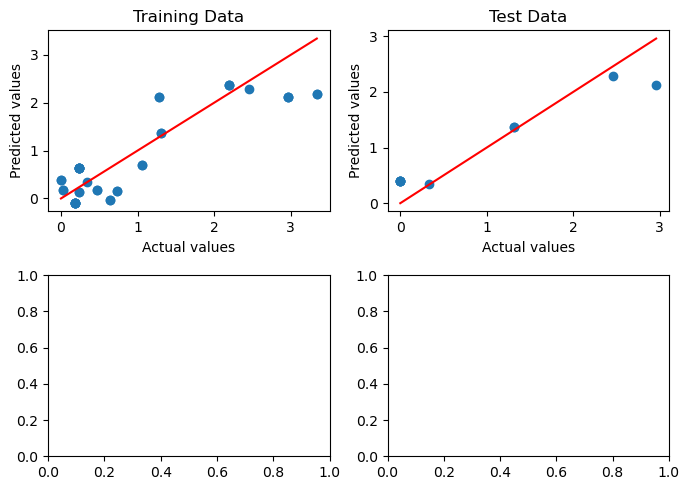

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [60/2000], Loss: 0.2130
Train R²:  0.80253
Test R² :  0.89131


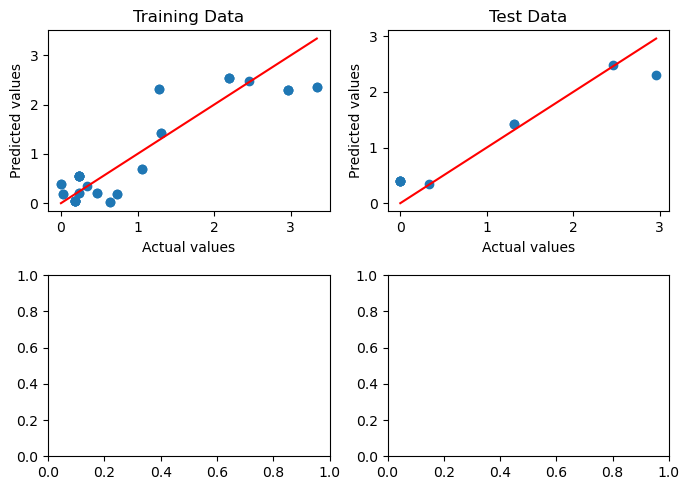

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [80/2000], Loss: 0.1949
Train R²:  0.81934
Test R² :  0.89748


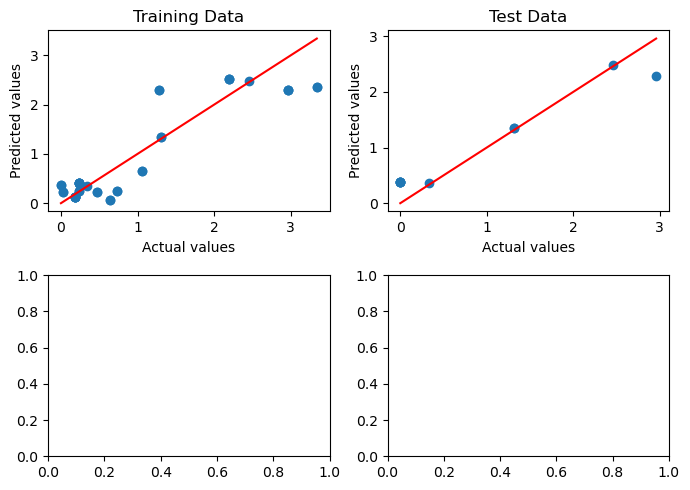

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [100/2000], Loss: 0.1847
Train R²:  0.82878
Test R² :  0.88756


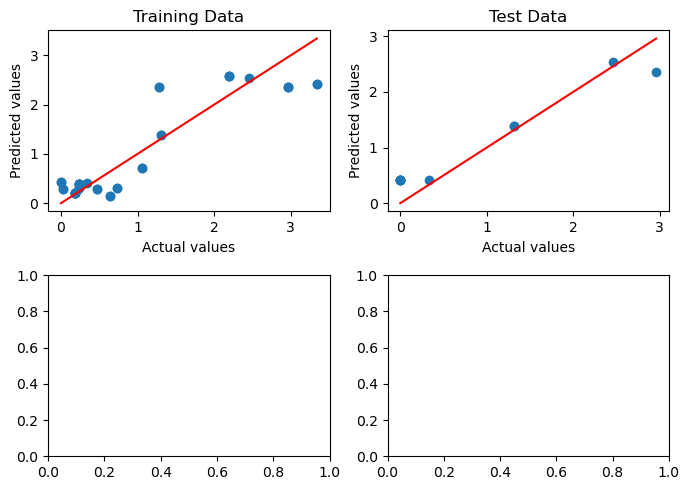

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [120/2000], Loss: 0.1775
Train R²:  0.83541
Test R² :  0.90133


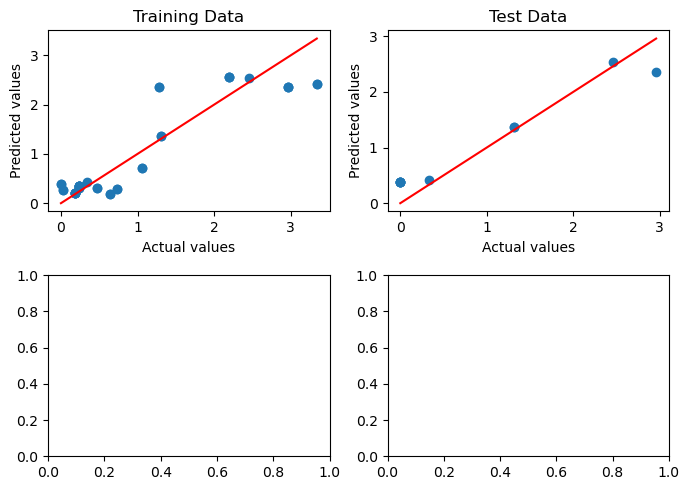

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [140/2000], Loss: 0.1732
Train R²:  0.83945
Test R² :  0.90043


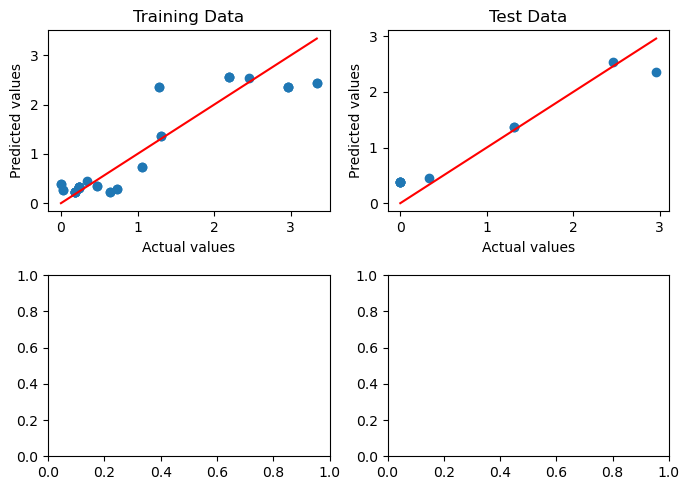

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [160/2000], Loss: 0.1698
Train R²:  0.84260
Test R² :  0.90594


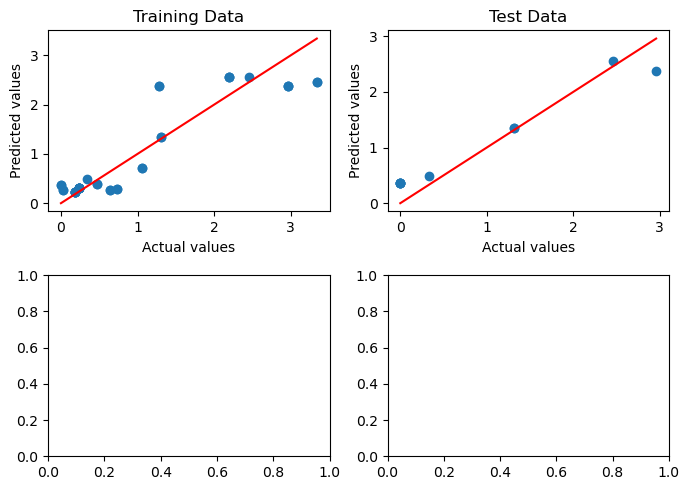

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [180/2000], Loss: 0.1672
Train R²:  0.84498
Test R² :  0.90583


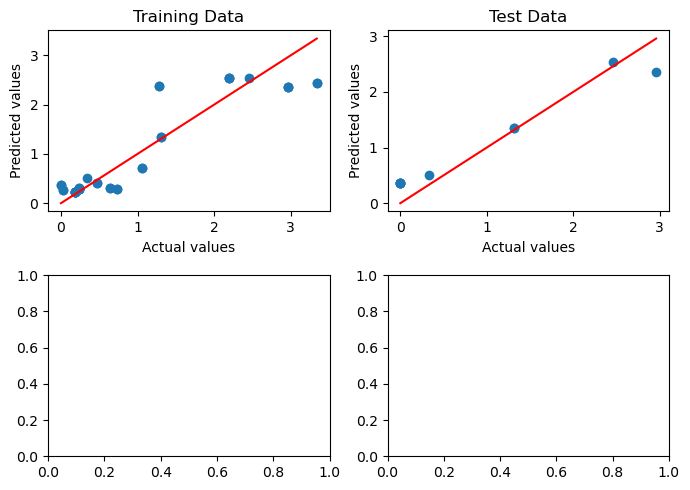

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [200/2000], Loss: 0.1650
Train R²:  0.84704
Test R² :  0.90575


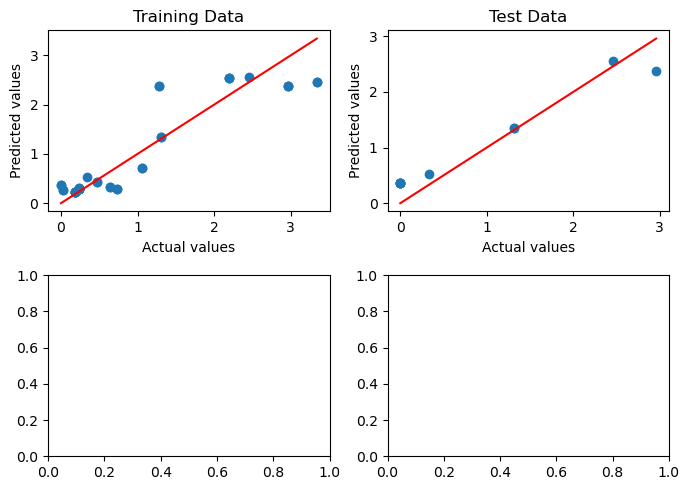

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [220/2000], Loss: 0.1630
Train R²:  0.84885
Test R² :  0.90618


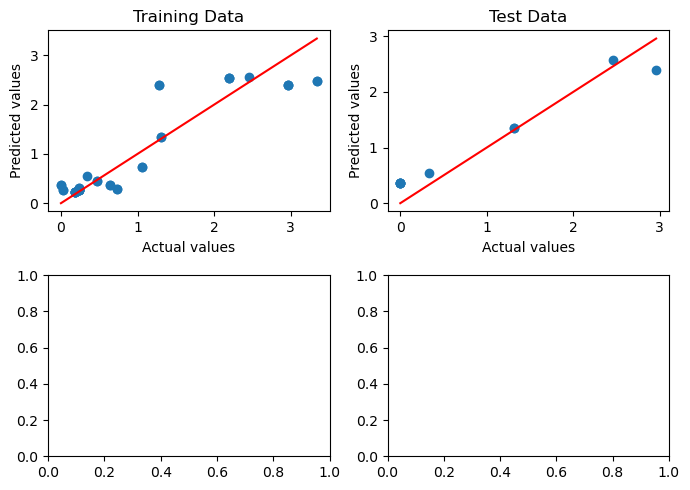

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [240/2000], Loss: 0.1610
Train R²:  0.85072
Test R² :  0.90723


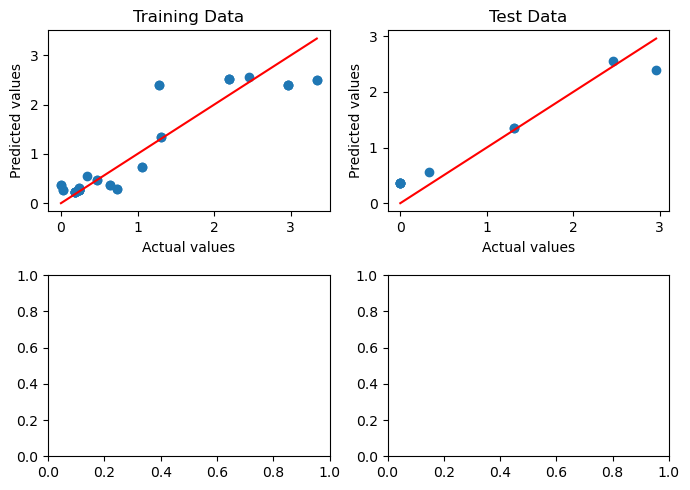

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [260/2000], Loss: 0.1591
Train R²:  0.85248
Test R² :  0.90751


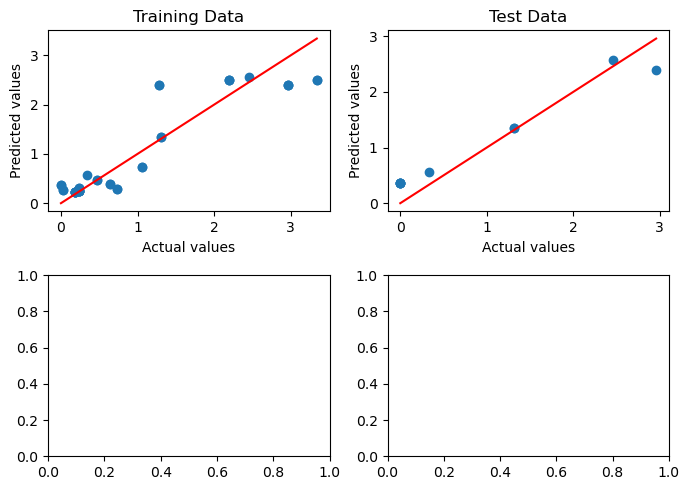

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [280/2000], Loss: 0.1576
Train R²:  0.85387
Test R² :  0.90870


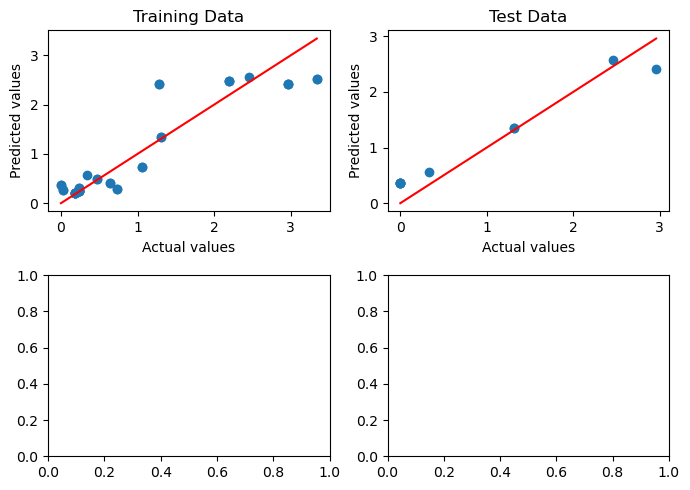

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [300/2000], Loss: 0.1556
Train R²:  0.85575
Test R² :  0.91017


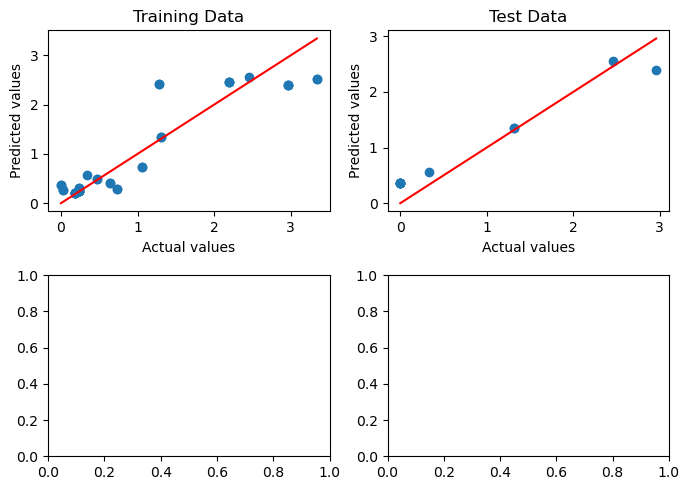

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [320/2000], Loss: 0.1538
Train R²:  0.85738
Test R² :  0.90584


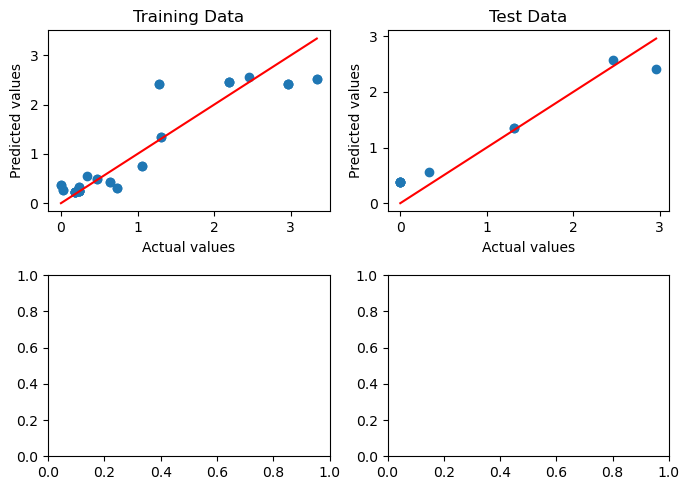

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [340/2000], Loss: 0.1516
Train R²:  0.85949
Test R² :  0.91072


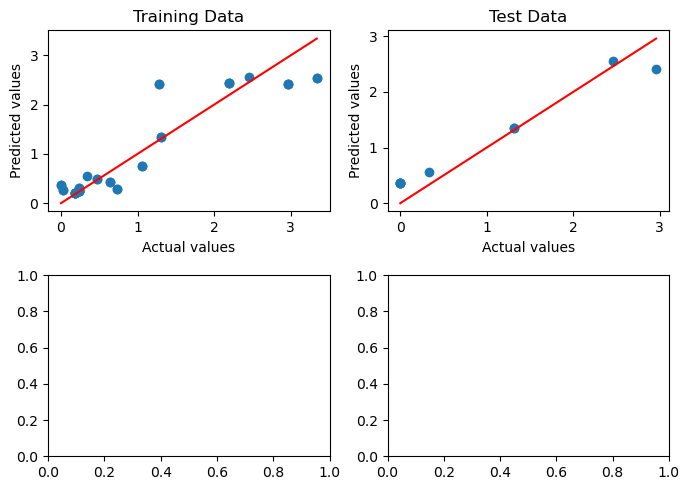

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [360/2000], Loss: 0.1501
Train R²:  0.86086
Test R² :  0.91044


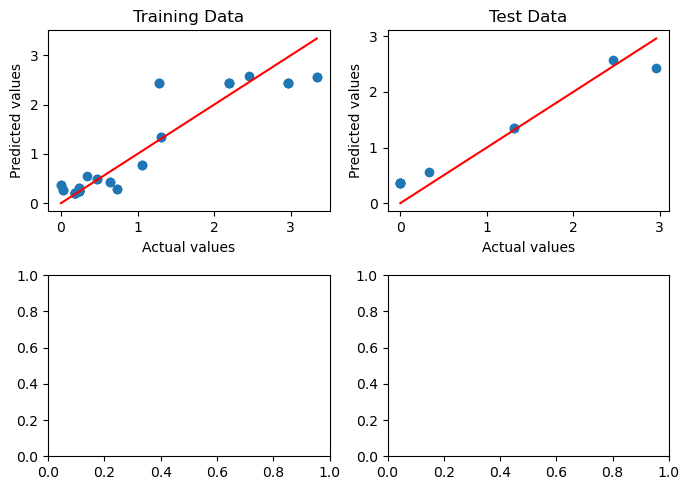

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [380/2000], Loss: 0.1481
Train R²:  0.86267
Test R² :  0.91232


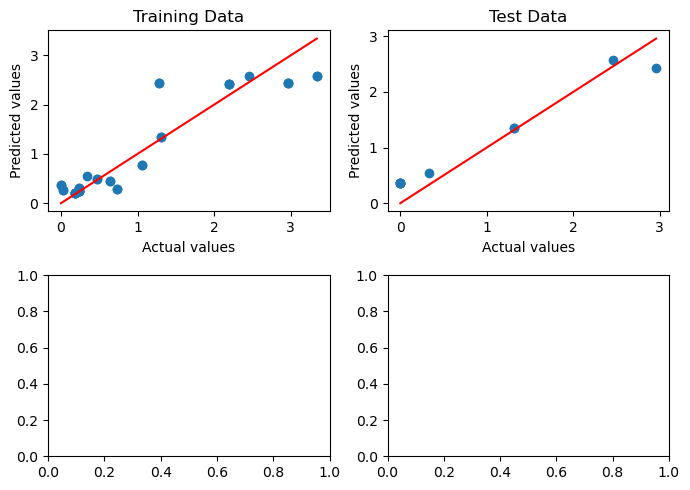

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [400/2000], Loss: 0.1467
Train R²:  0.86399
Test R² :  0.90933


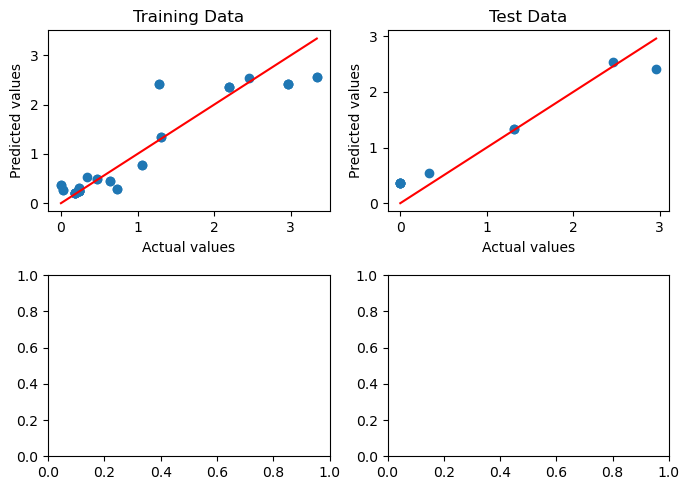

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [420/2000], Loss: 0.1445
Train R²:  0.86606
Test R² :  0.90915


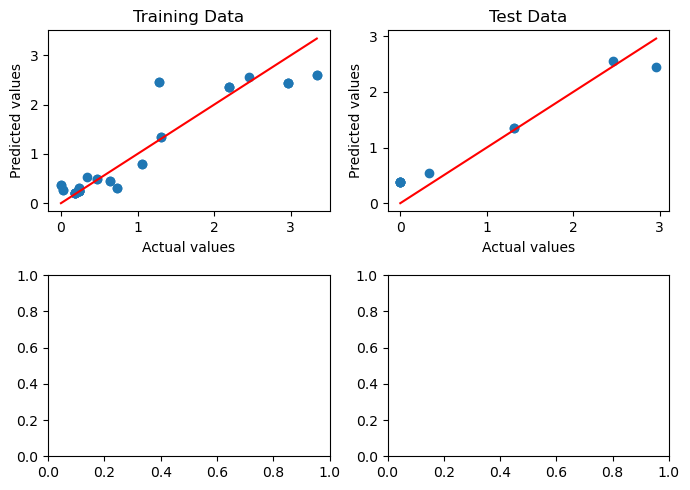

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [440/2000], Loss: 0.1431
Train R²:  0.86736
Test R² :  0.91204


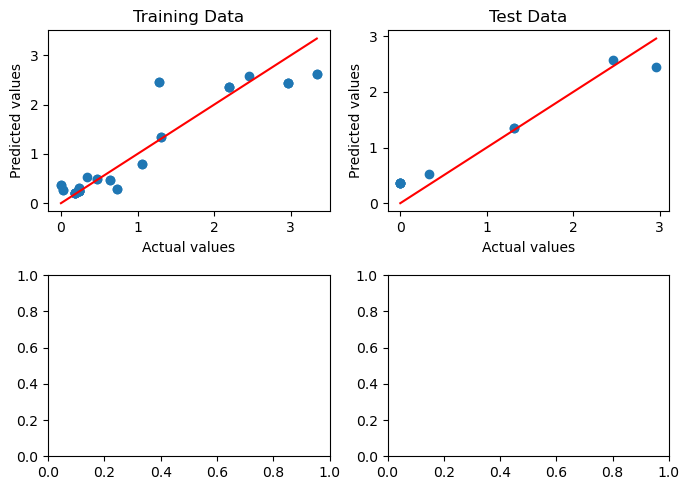

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [460/2000], Loss: 0.1410
Train R²:  0.86928
Test R² :  0.91459


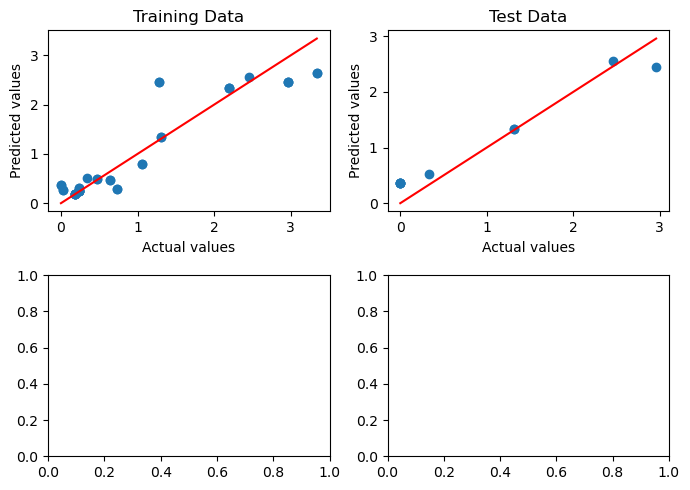

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [480/2000], Loss: 0.1396
Train R²:  0.87054
Test R² :  0.91321


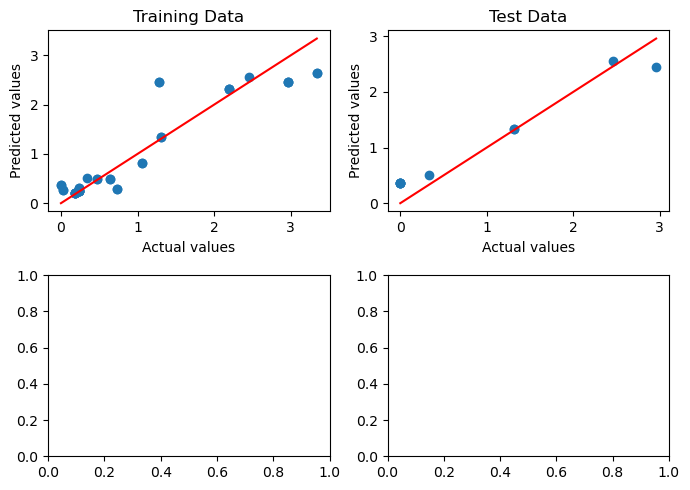

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [500/2000], Loss: 0.1377
Train R²:  0.87230
Test R² :  0.91588


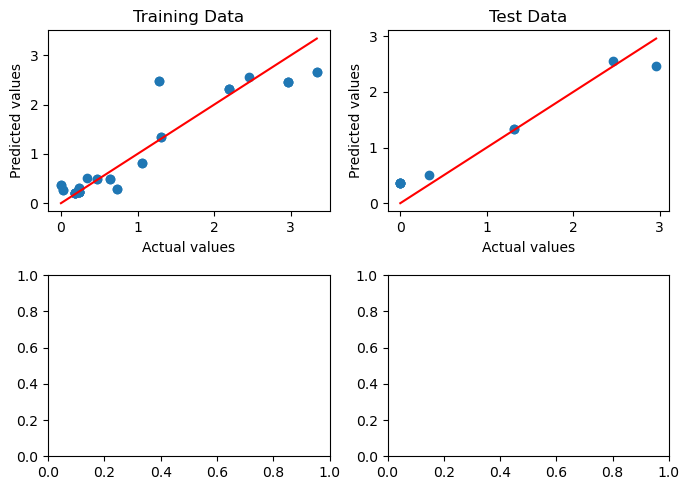

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [520/2000], Loss: 0.1370
Train R²:  0.87302
Test R² :  0.91896


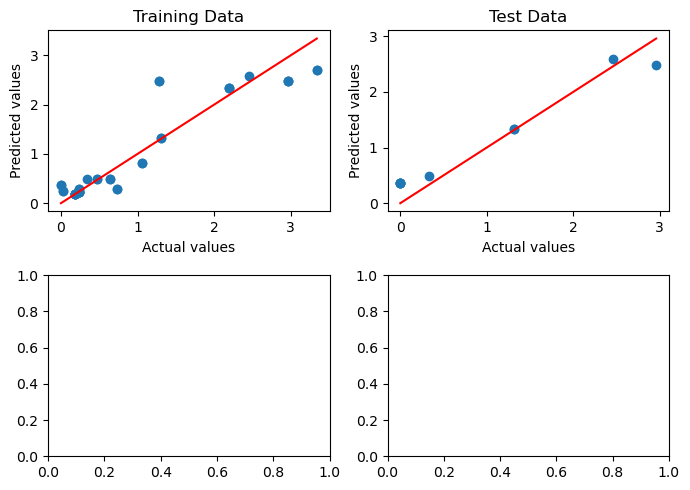

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [540/2000], Loss: 0.1346
Train R²:  0.87526
Test R² :  0.91442


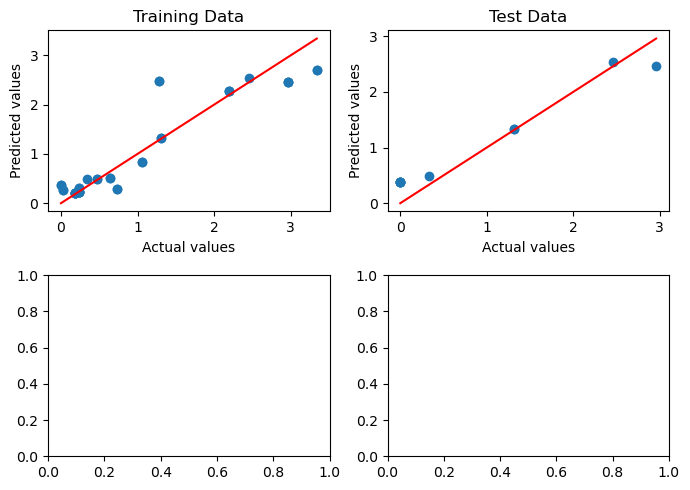

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [560/2000], Loss: 0.1328
Train R²:  0.87693
Test R² :  0.91773


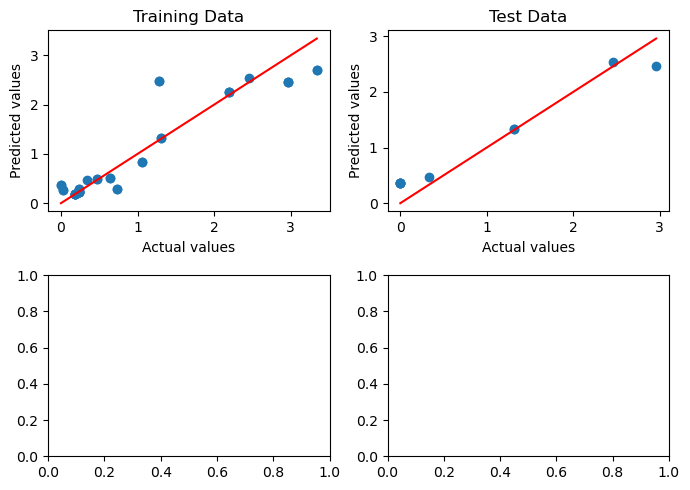

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [580/2000], Loss: 0.1310
Train R²:  0.87853
Test R² :  0.91771


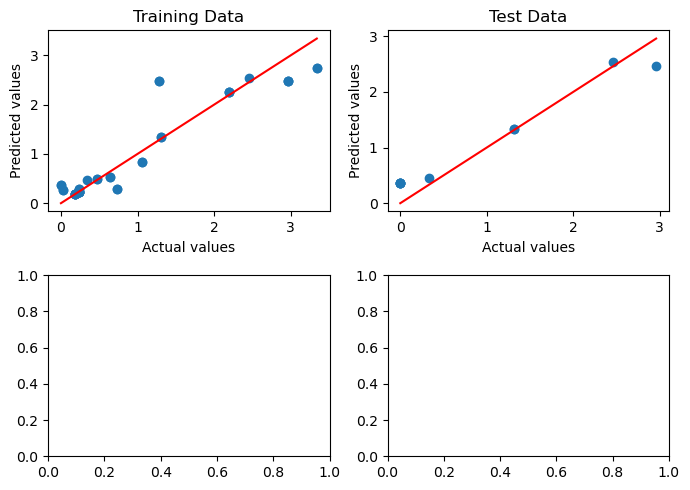

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [600/2000], Loss: 0.1293
Train R²:  0.88016
Test R² :  0.91826


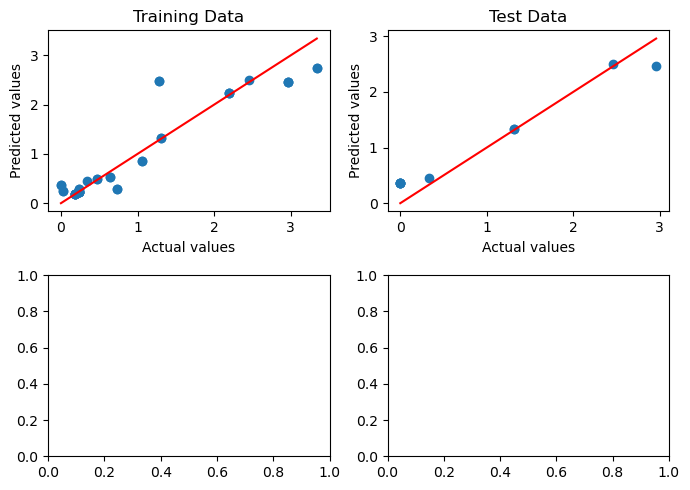

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [620/2000], Loss: 0.1280
Train R²:  0.88131
Test R² :  0.92064


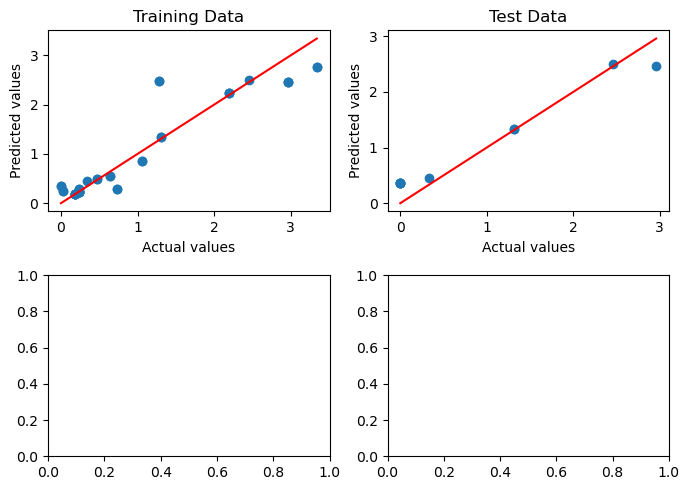

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [640/2000], Loss: 0.1259
Train R²:  0.88329
Test R² :  0.92160


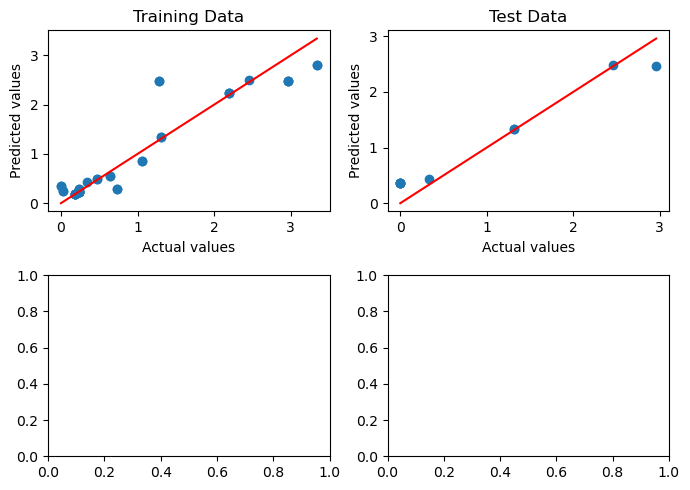

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [660/2000], Loss: 0.1244
Train R²:  0.88464
Test R² :  0.91946


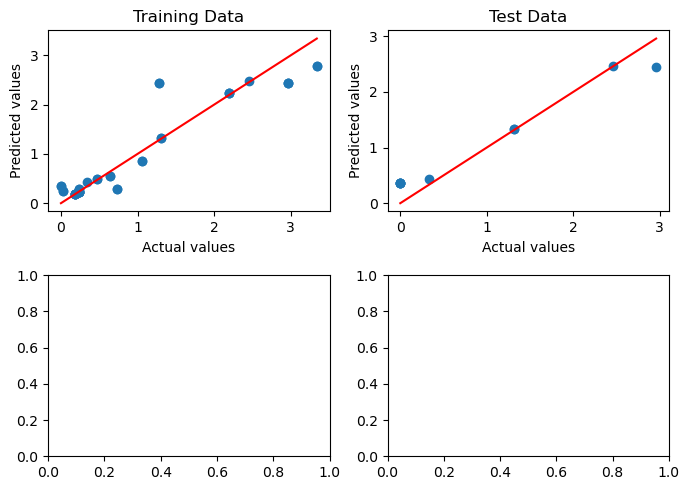

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [680/2000], Loss: 0.1223
Train R²:  0.88665
Test R² :  0.92200


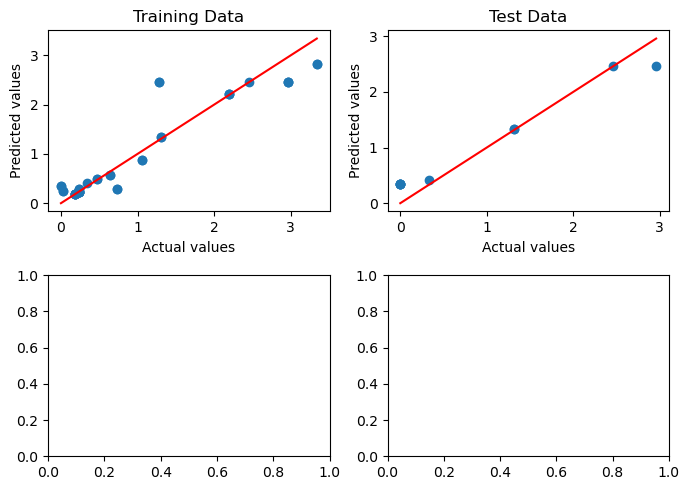

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [700/2000], Loss: 0.1205
Train R²:  0.88832
Test R² :  0.92493


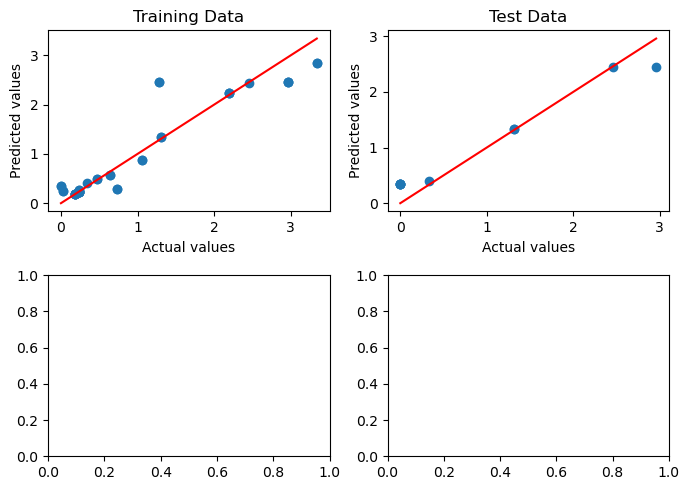

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [720/2000], Loss: 0.1186
Train R²:  0.89006
Test R² :  0.92333


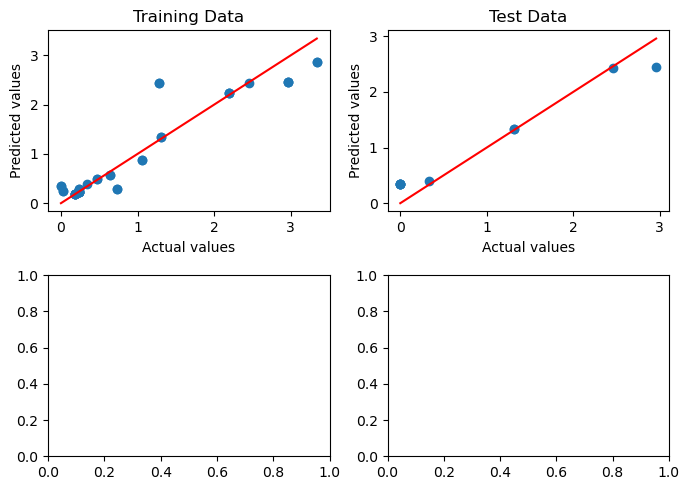

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [740/2000], Loss: 0.1169
Train R²:  0.89163
Test R² :  0.92675


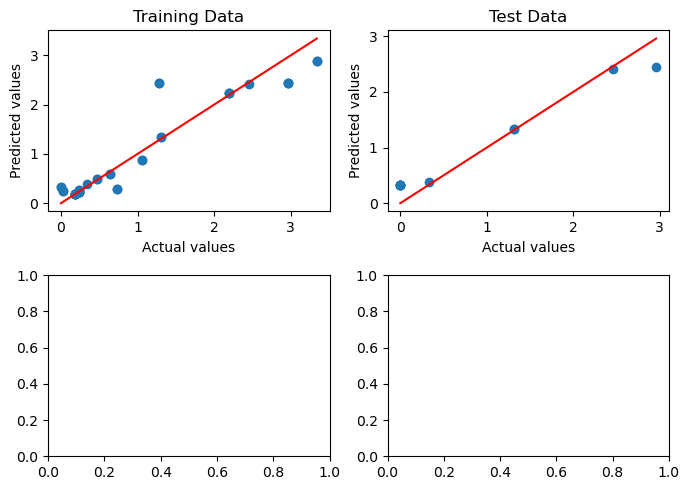

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [760/2000], Loss: 0.1144
Train R²:  0.89392
Test R² :  0.92709


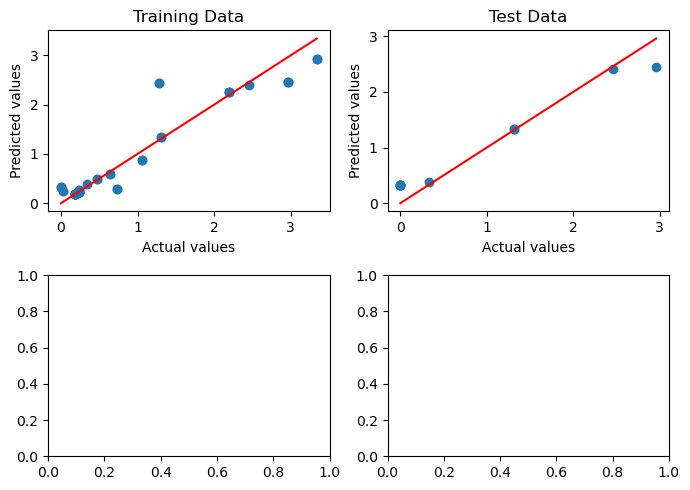

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [780/2000], Loss: 0.1126
Train R²:  0.89565
Test R² :  0.92584


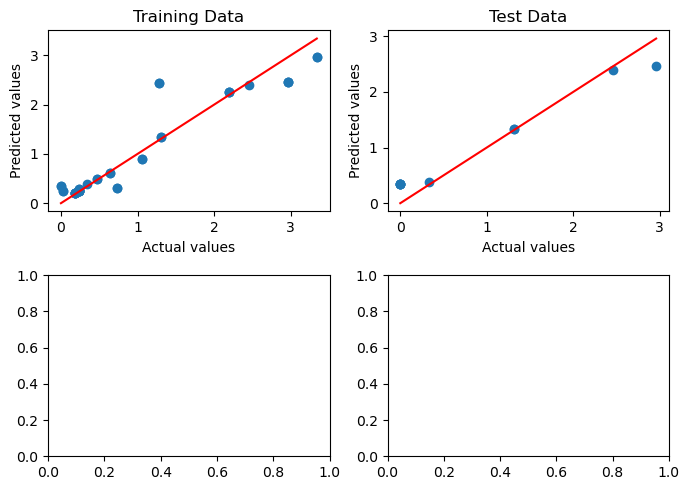

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [800/2000], Loss: 0.1107
Train R²:  0.89733
Test R² :  0.92958


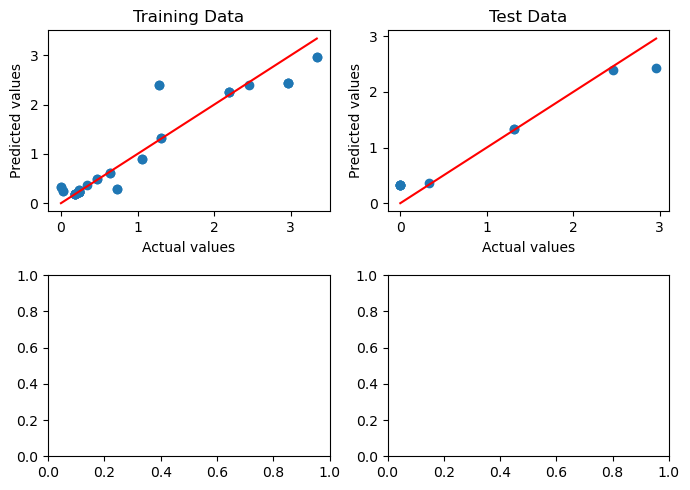

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [820/2000], Loss: 0.1087
Train R²:  0.89925
Test R² :  0.92267


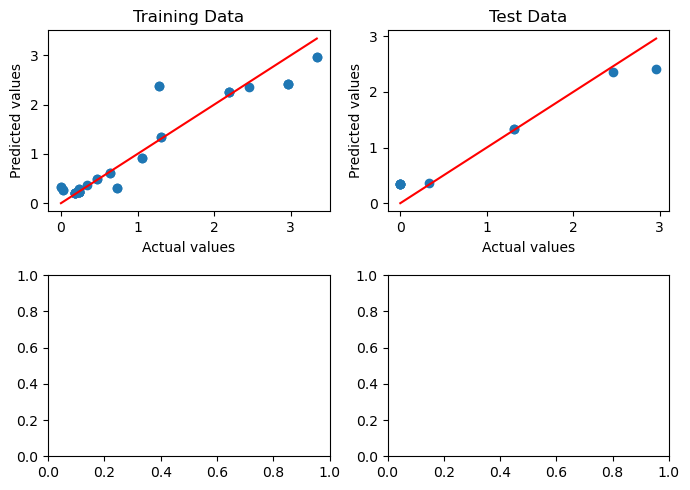

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [840/2000], Loss: 0.1067
Train R²:  0.90107
Test R² :  0.92571


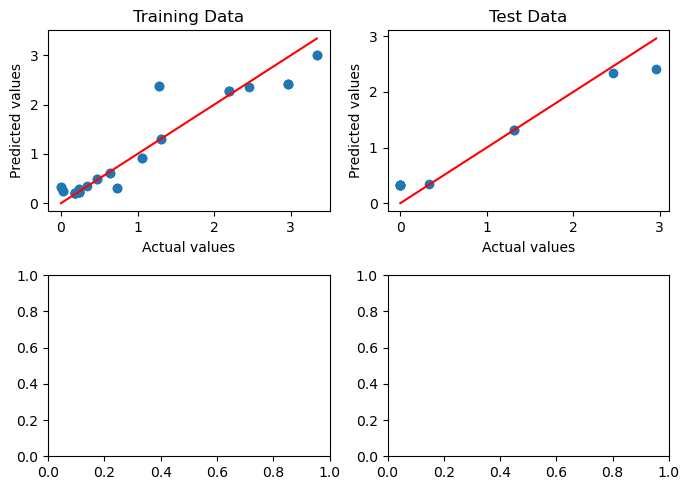

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [860/2000], Loss: 0.1047
Train R²:  0.90295
Test R² :  0.93026


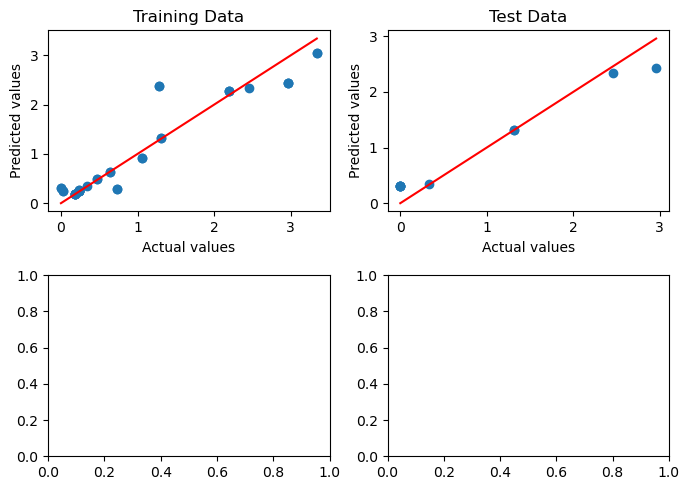

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [880/2000], Loss: 0.1024
Train R²:  0.90505
Test R² :  0.92945


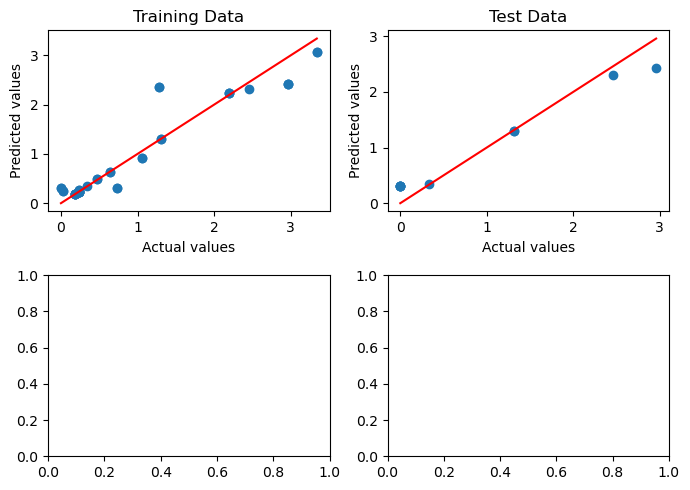

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [900/2000], Loss: 0.1005
Train R²:  0.90683
Test R² :  0.93051


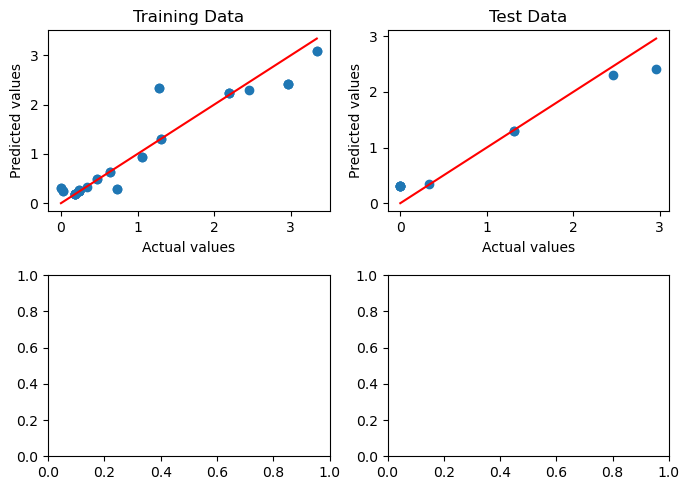

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [920/2000], Loss: 0.0987
Train R²:  0.90849
Test R² :  0.93276


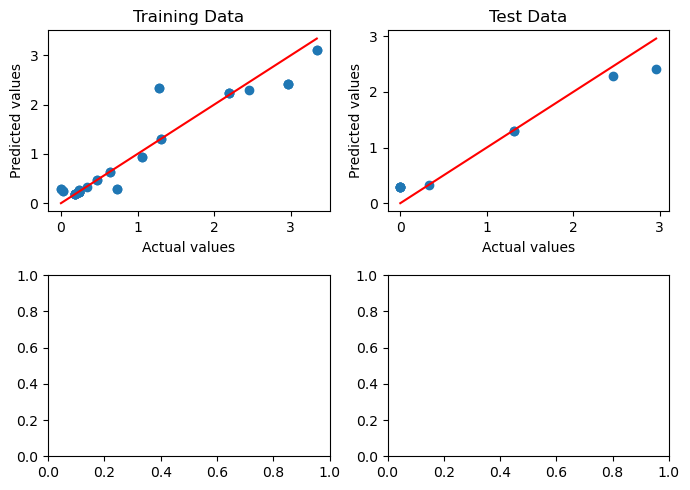

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [940/2000], Loss: 0.0969
Train R²:  0.91013
Test R² :  0.93227


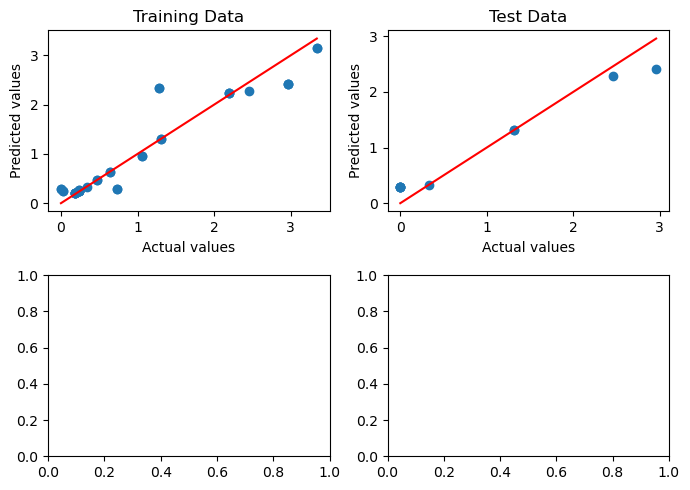

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [960/2000], Loss: 0.0953
Train R²:  0.91166
Test R² :  0.93338


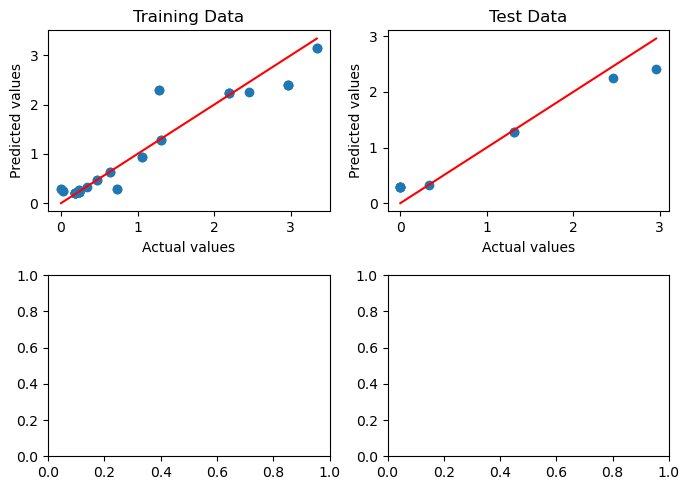

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [980/2000], Loss: 0.0935
Train R²:  0.91334
Test R² :  0.93288


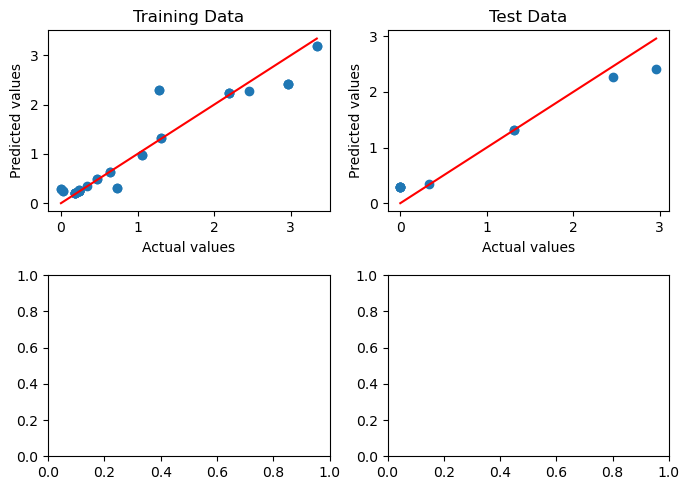

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1000/2000], Loss: 0.0917
Train R²:  0.91495
Test R² :  0.93900


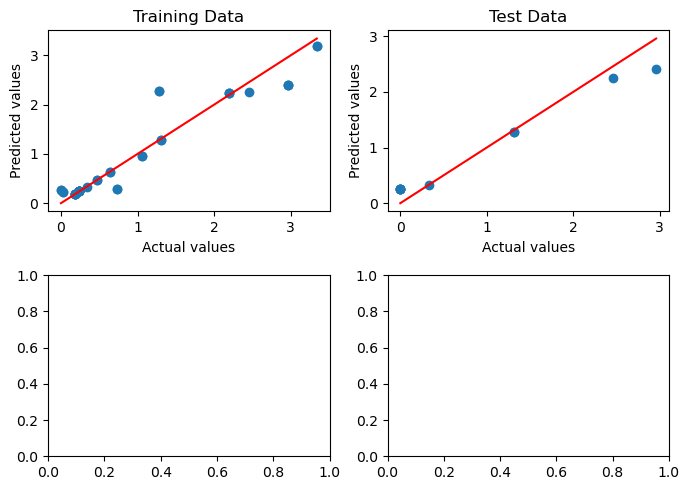

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1020/2000], Loss: 0.0900
Train R²:  0.91661
Test R² :  0.93746


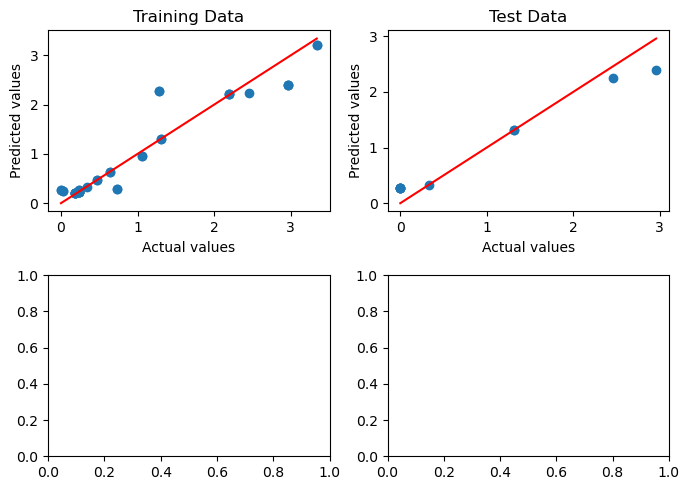

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1040/2000], Loss: 0.0883
Train R²:  0.91815
Test R² :  0.93711


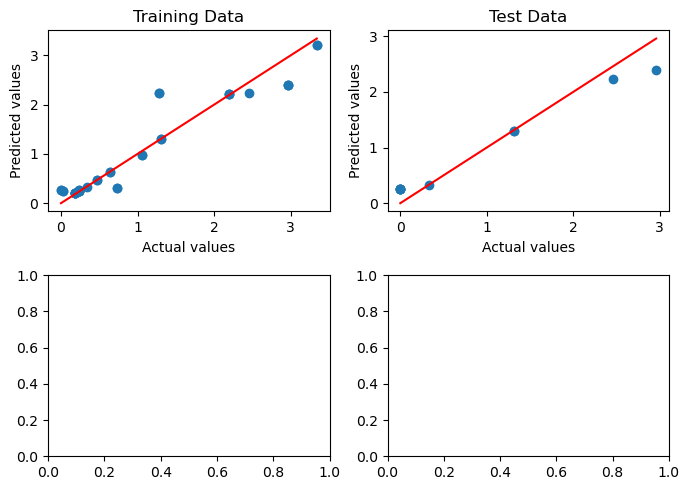

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1060/2000], Loss: 0.0865
Train R²:  0.91977
Test R² :  0.94074


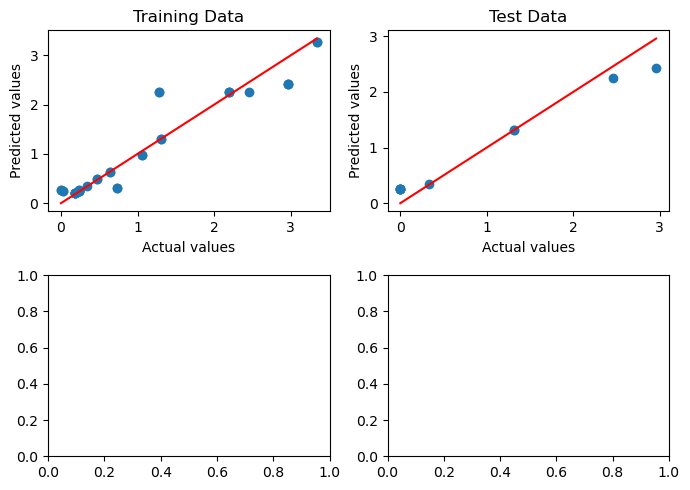

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1080/2000], Loss: 0.0849
Train R²:  0.92133
Test R² :  0.94518


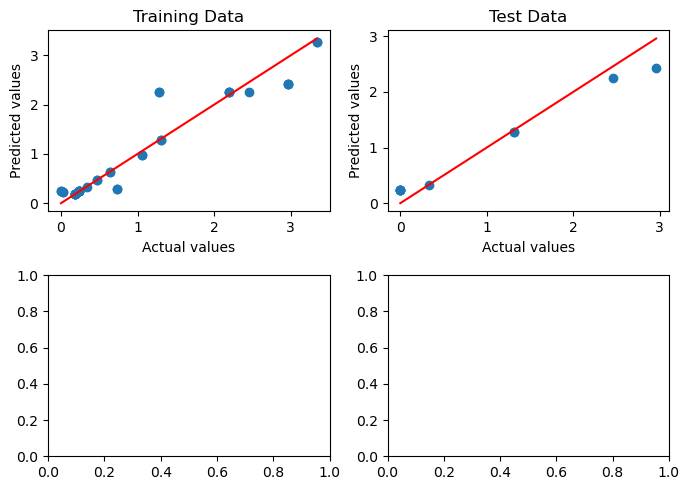

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1100/2000], Loss: 0.0828
Train R²:  0.92326
Test R² :  0.94667


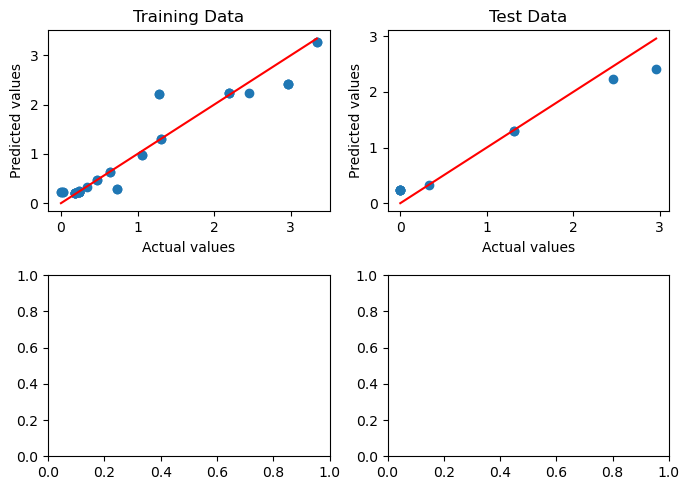

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1120/2000], Loss: 0.0810
Train R²:  0.92491
Test R² :  0.94767


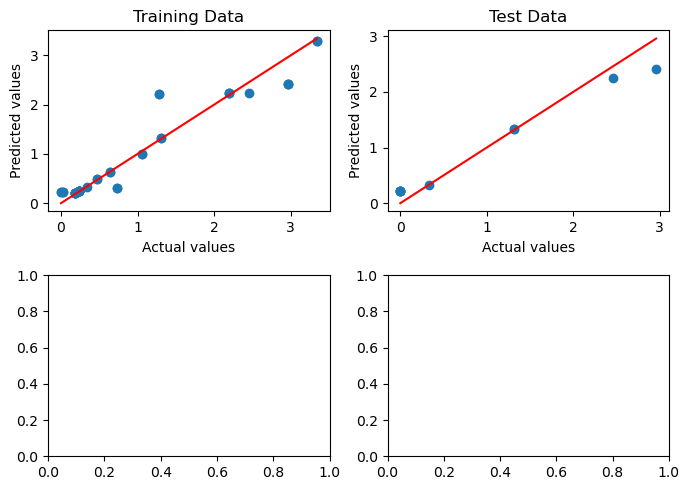

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1140/2000], Loss: 0.0788
Train R²:  0.92697
Test R² :  0.94887


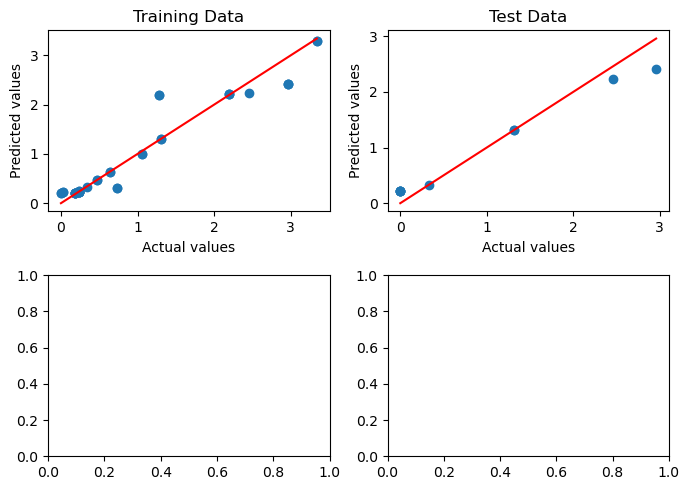

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1160/2000], Loss: 0.0774
Train R²:  0.92820
Test R² :  0.95488


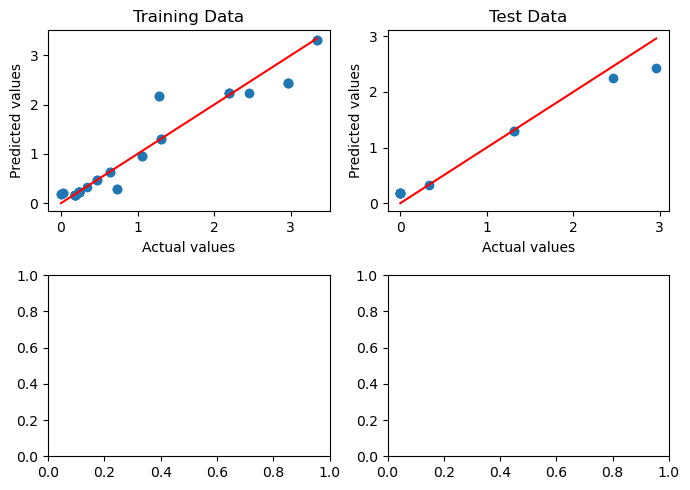

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1180/2000], Loss: 0.0762
Train R²:  0.92935
Test R² :  0.95635


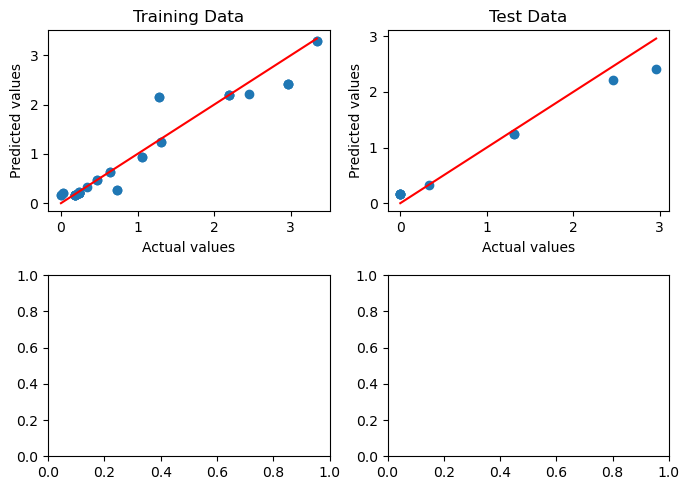

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1200/2000], Loss: 0.0737
Train R²:  0.93171
Test R² :  0.95264


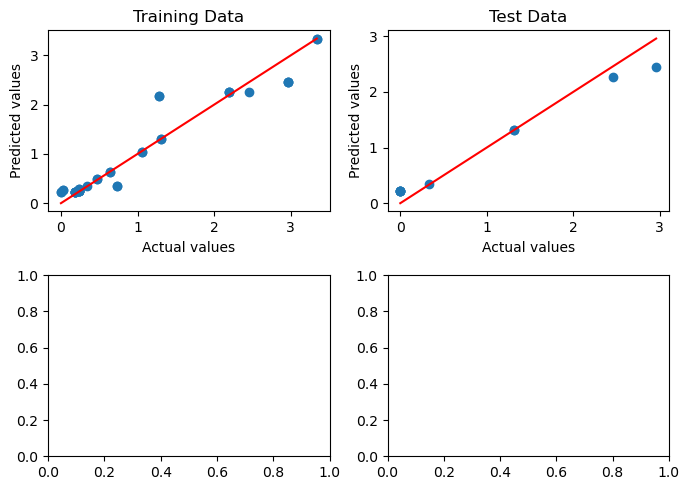

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1220/2000], Loss: 0.0713
Train R²:  0.93388
Test R² :  0.95723


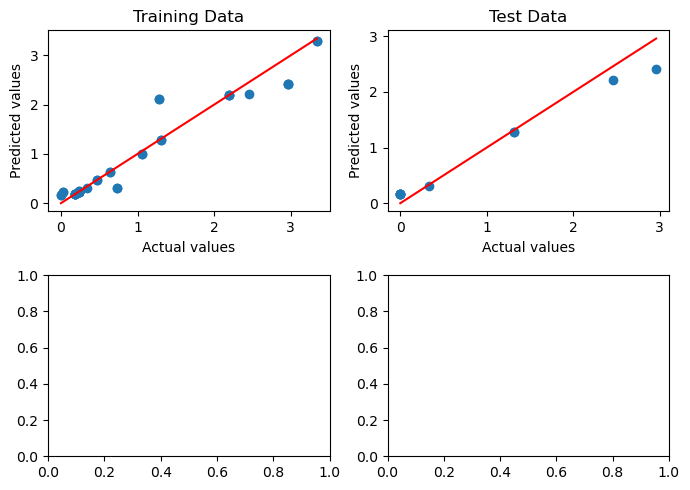

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1240/2000], Loss: 0.0692
Train R²:  0.93581
Test R² :  0.95866


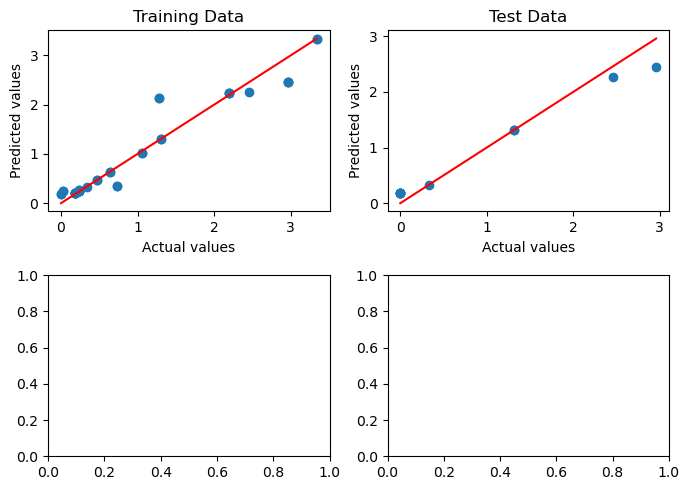

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1260/2000], Loss: 0.0681
Train R²:  0.93686
Test R² :  0.96215


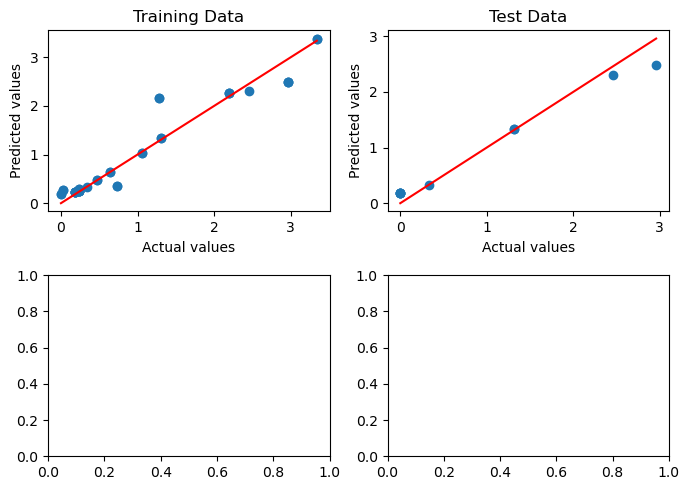

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1280/2000], Loss: 0.0654
Train R²:  0.93934
Test R² :  0.96151


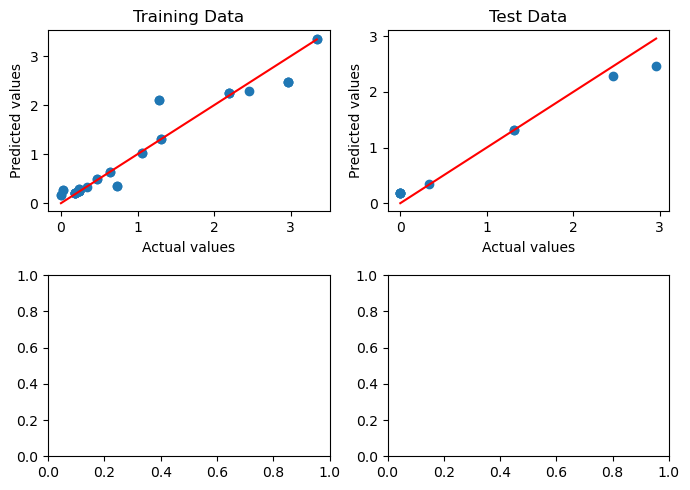

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1300/2000], Loss: 0.0645
Train R²:  0.94022
Test R² :  0.96282


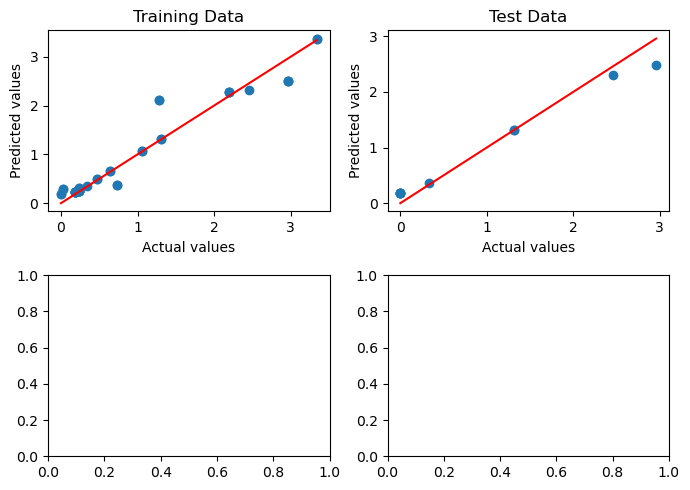

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1320/2000], Loss: 0.0616
Train R²:  0.94288
Test R² :  0.96411


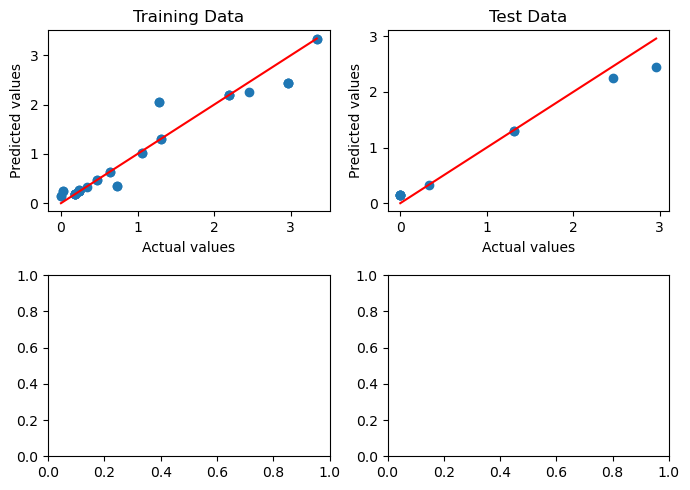

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1340/2000], Loss: 0.0599
Train R²:  0.94449
Test R² :  0.96703


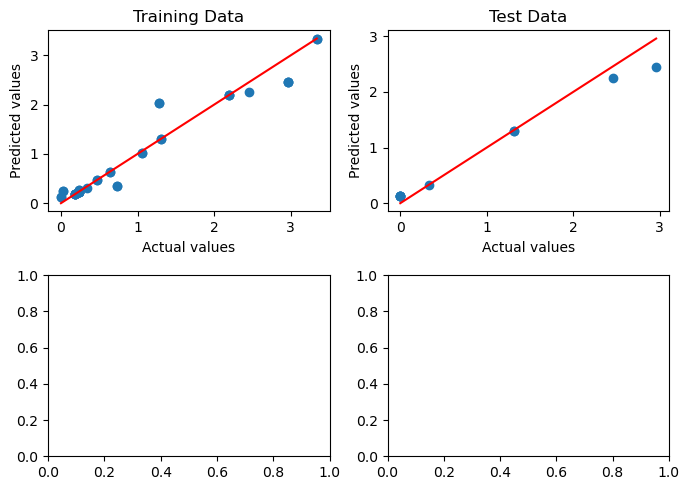

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1360/2000], Loss: 0.0577
Train R²:  0.94653
Test R² :  0.96821


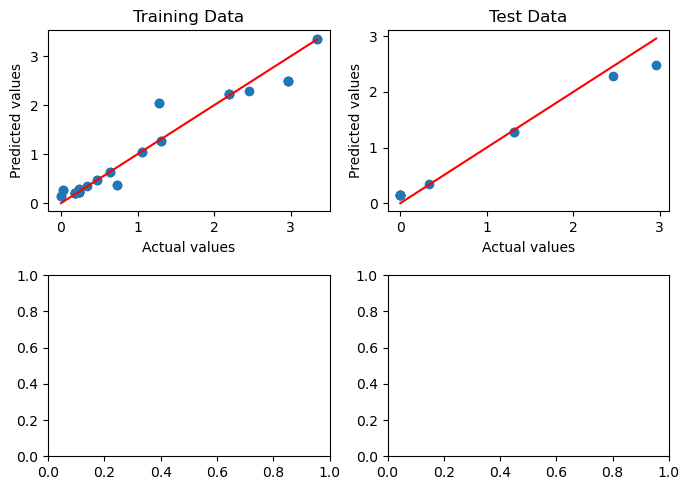

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1380/2000], Loss: 0.0562
Train R²:  0.94795
Test R² :  0.97110


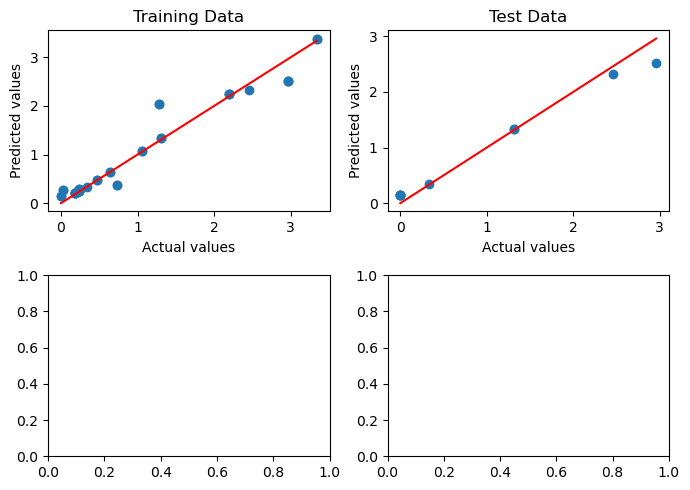

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1400/2000], Loss: 0.0539
Train R²:  0.95002
Test R² :  0.97081


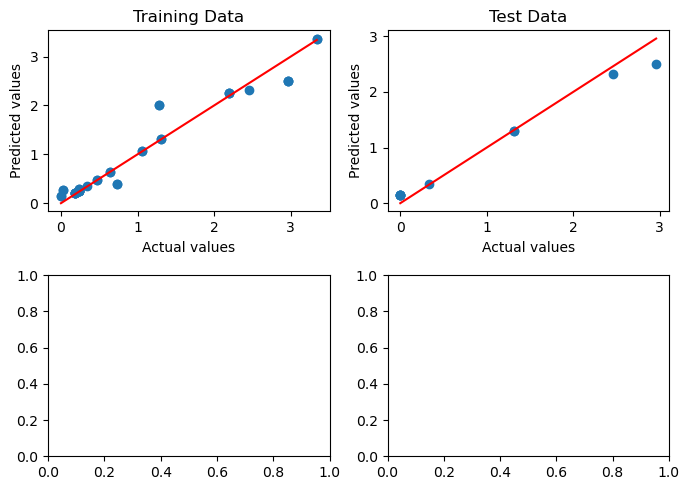

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1420/2000], Loss: 0.0533
Train R²:  0.95060
Test R² :  0.97063


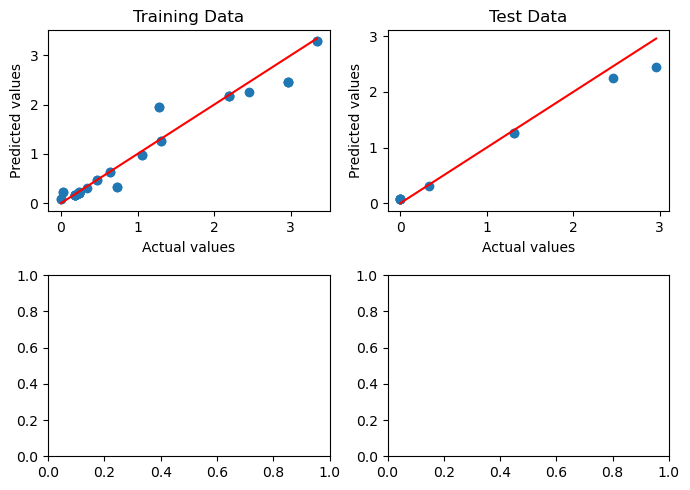

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1440/2000], Loss: 0.0506
Train R²:  0.95305
Test R² :  0.97698


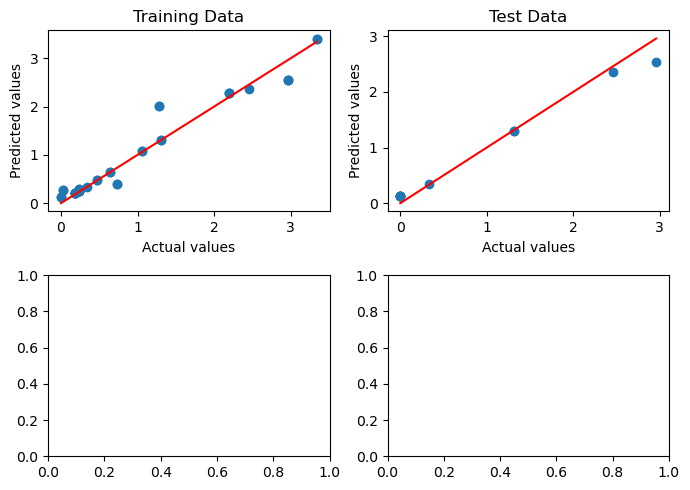

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1460/2000], Loss: 0.0485
Train R²:  0.95503
Test R² :  0.97985


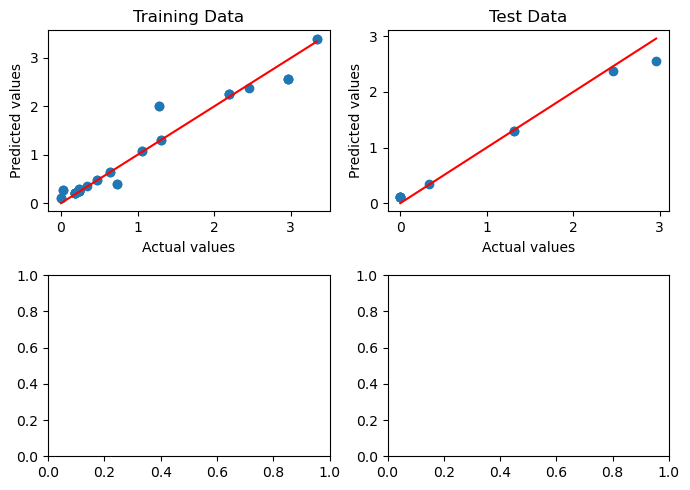

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1480/2000], Loss: 0.0499
Train R²:  0.95377
Test R² :  0.97358


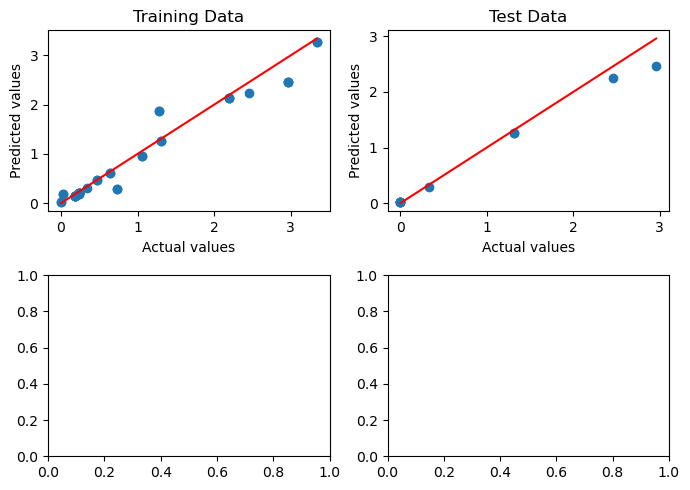

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1500/2000], Loss: 0.0455
Train R²:  0.95779
Test R² :  0.97679


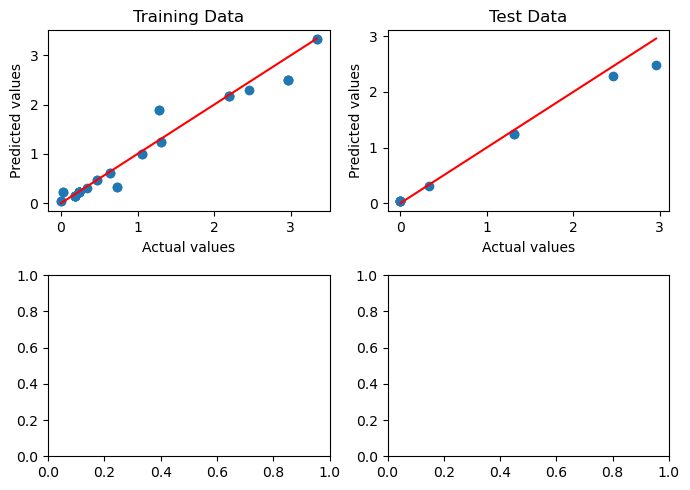

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1520/2000], Loss: 0.0424
Train R²:  0.96065
Test R² :  0.98243


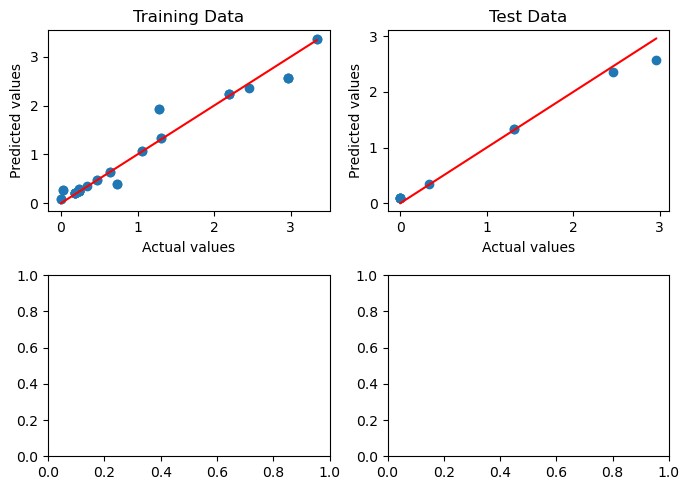

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1540/2000], Loss: 0.0424
Train R²:  0.96068
Test R² :  0.97959


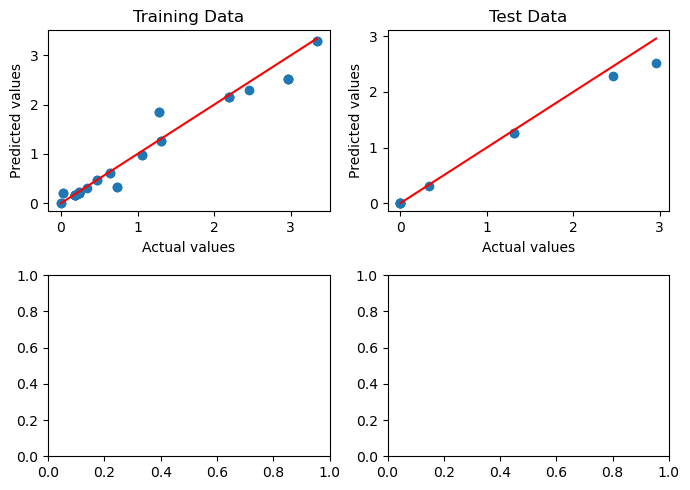

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1560/2000], Loss: 0.0389
Train R²:  0.96392
Test R² :  0.98195


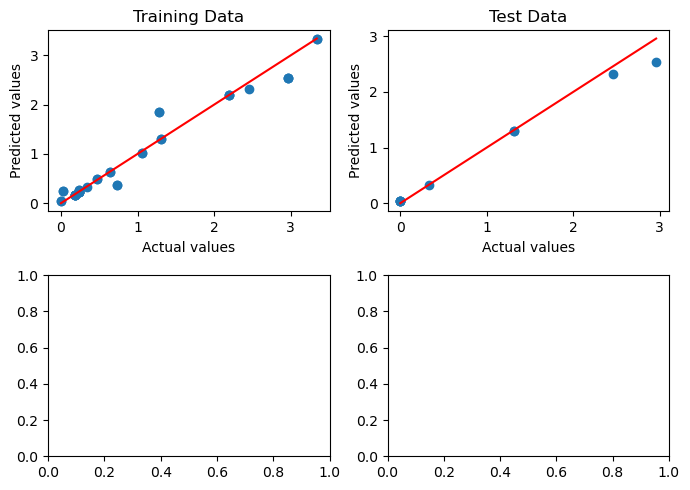

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1580/2000], Loss: 0.0383
Train R²:  0.96451
Test R² :  0.98607


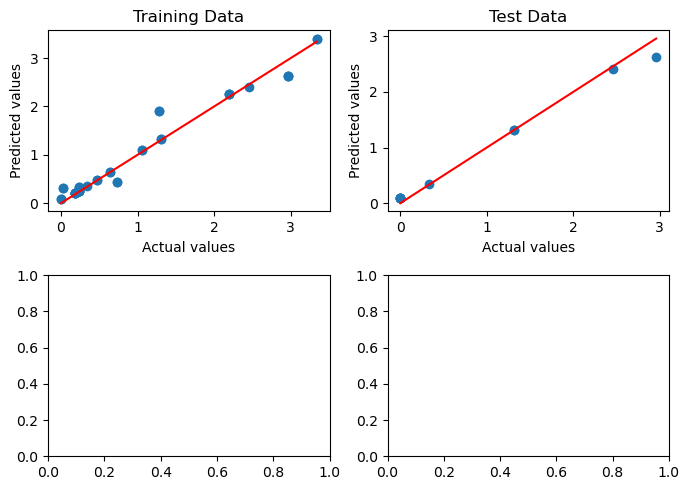

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1600/2000], Loss: 0.0382
Train R²:  0.96457
Test R² :  0.98570


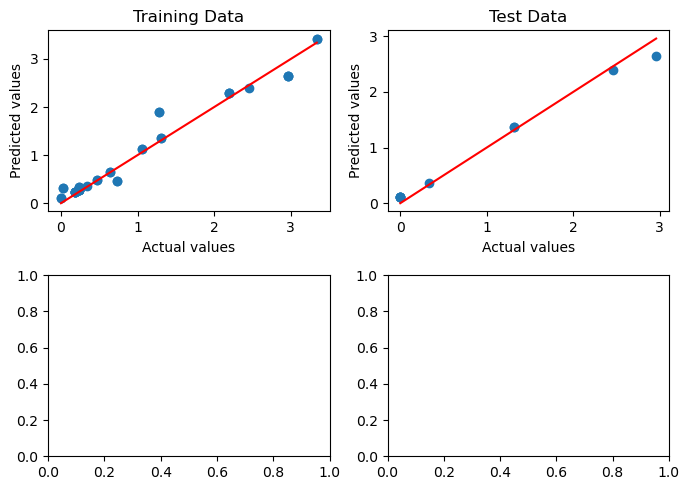

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1620/2000], Loss: 0.0366
Train R²:  0.96604
Test R² :  0.97915


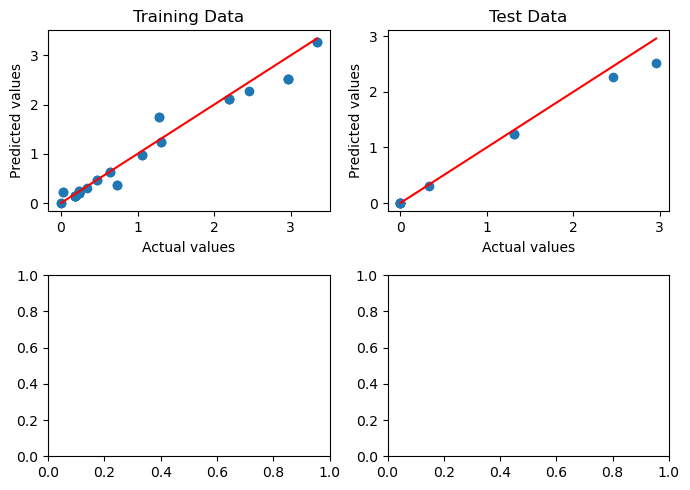

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1640/2000], Loss: 0.0347
Train R²:  0.96784
Test R² :  0.98154


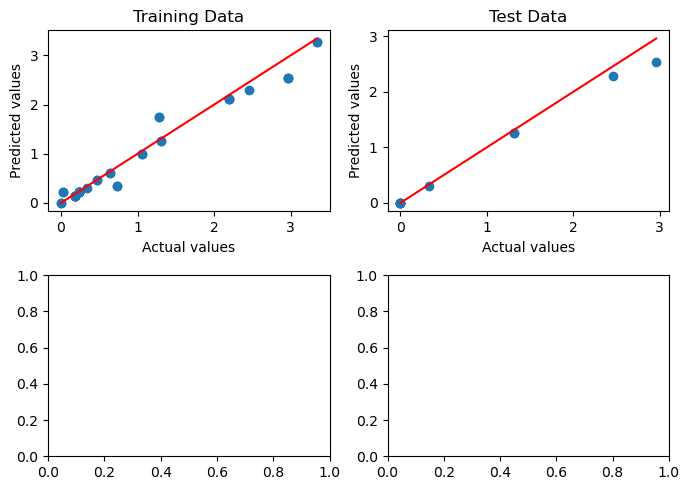

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1660/2000], Loss: 0.0305
Train R²:  0.97173
Test R² :  0.98651


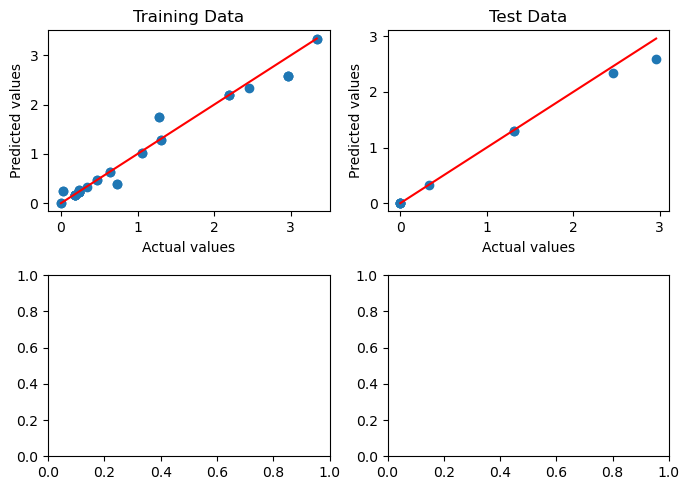

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1680/2000], Loss: 0.0317
Train R²:  0.97059
Test R² :  0.99022


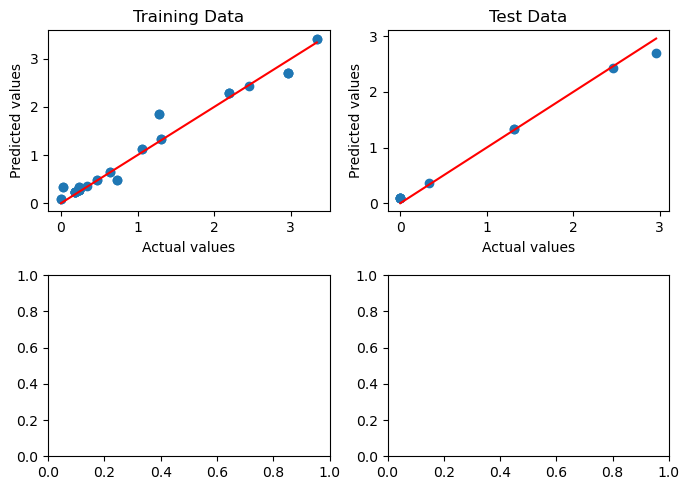

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1700/2000], Loss: 0.0327
Train R²:  0.96967
Test R² :  0.97772


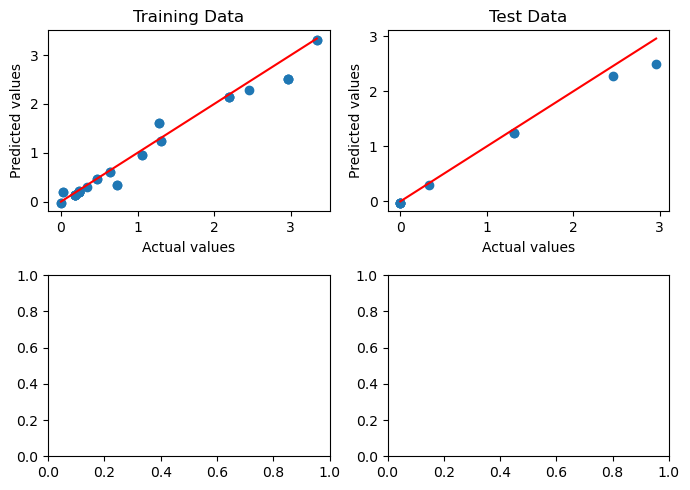

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1720/2000], Loss: 0.0267
Train R²:  0.97526
Test R² :  0.98730


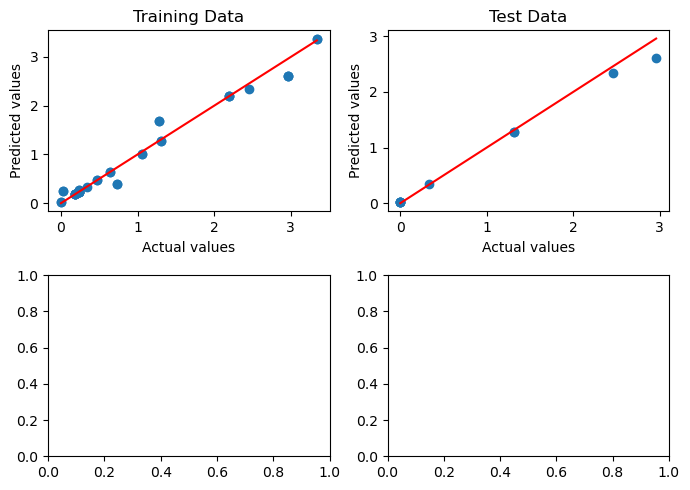

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1740/2000], Loss: 0.0249
Train R²:  0.97695
Test R² :  0.99221


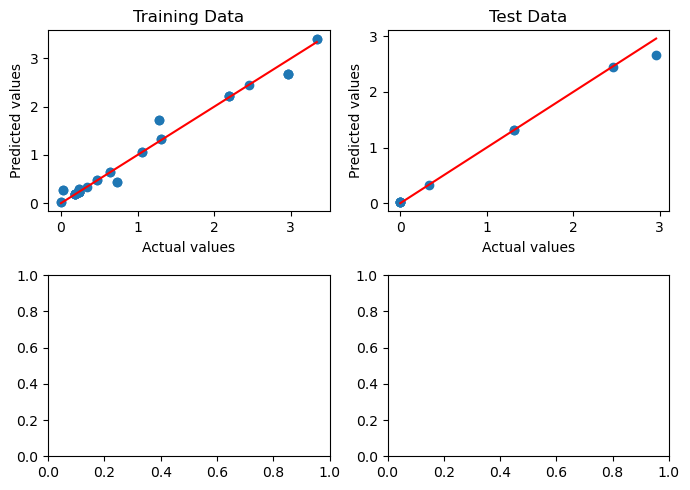

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1760/2000], Loss: 0.0235
Train R²:  0.97823
Test R² :  0.99198


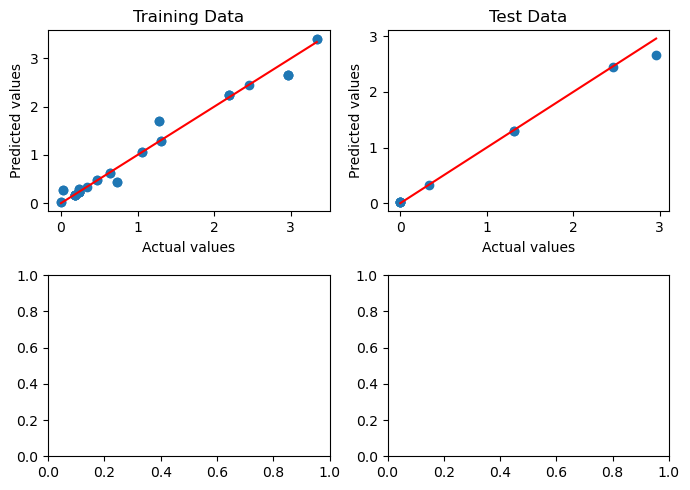

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1780/2000], Loss: 0.0281
Train R²:  0.97391
Test R² :  0.98184


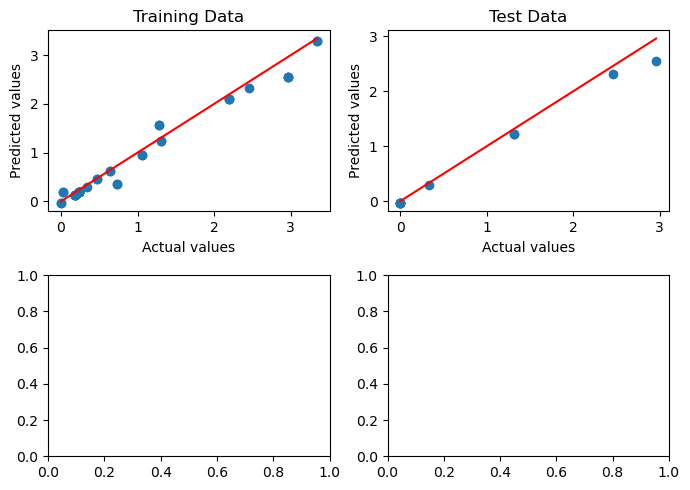

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1800/2000], Loss: 0.0220
Train R²:  0.97956
Test R² :  0.99330


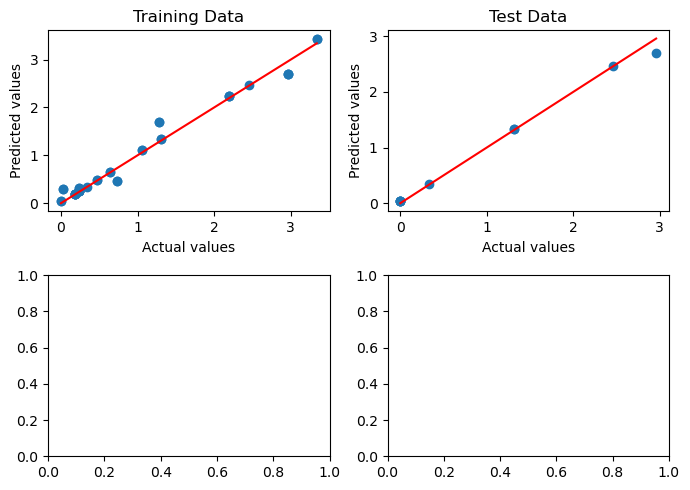

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1820/2000], Loss: 0.0208
Train R²:  0.98067
Test R² :  0.99506


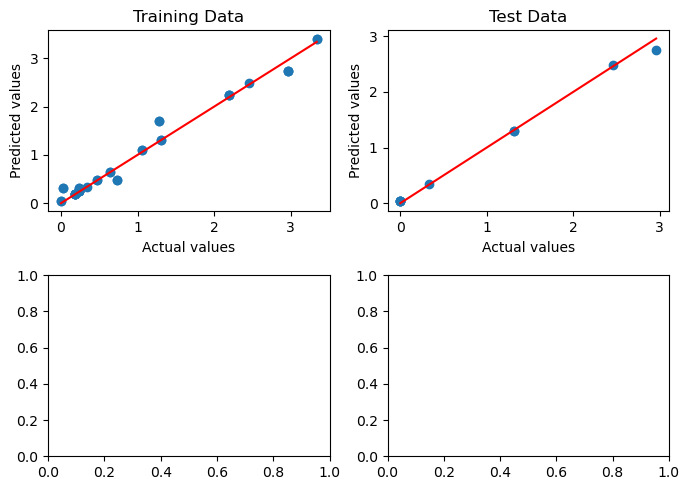

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1840/2000], Loss: 0.0188
Train R²:  0.98254
Test R² :  0.99446


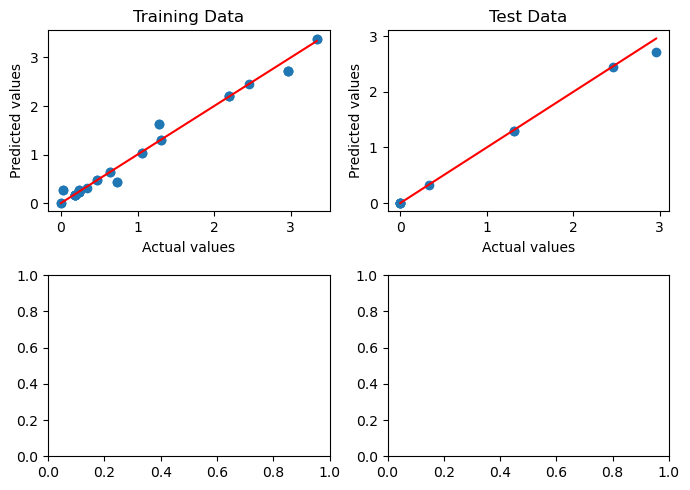

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1860/2000], Loss: 0.0183
Train R²:  0.98304
Test R² :  0.99613


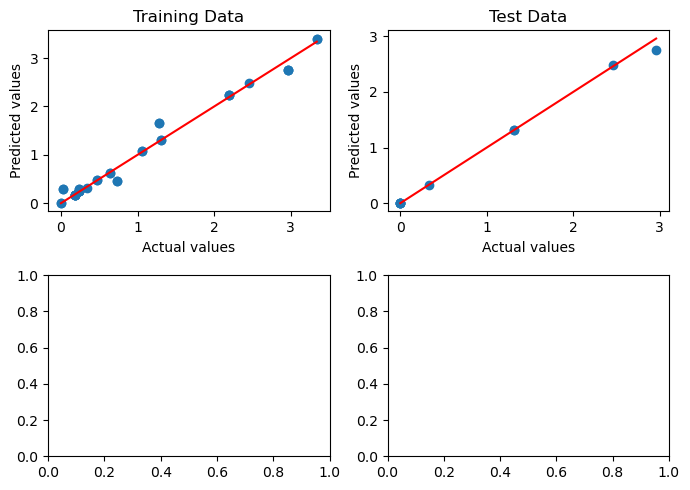

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1880/2000], Loss: 0.0240
Train R²:  0.97773
Test R² :  0.98523


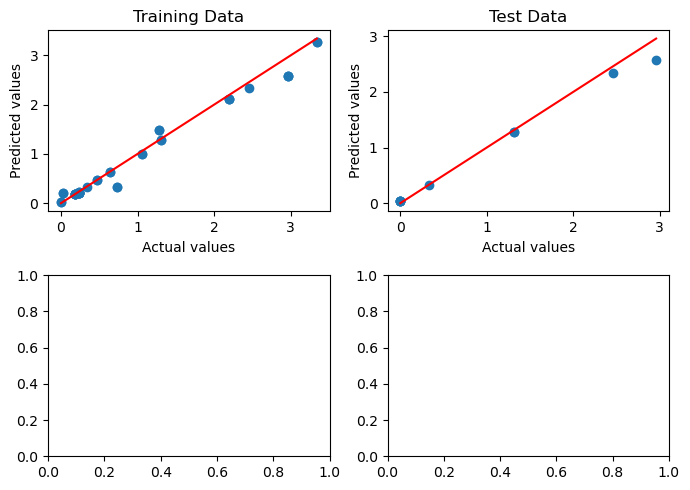

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1900/2000], Loss: 0.0190
Train R²:  0.98235
Test R² :  0.99171


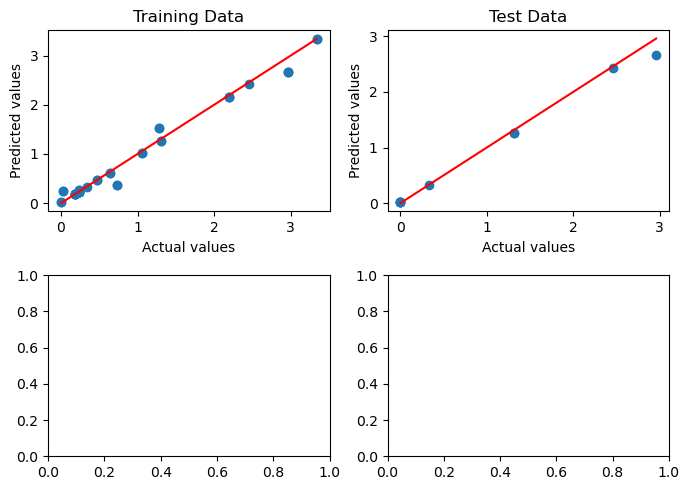

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1920/2000], Loss: 0.0173
Train R²:  0.98394
Test R² :  0.99412


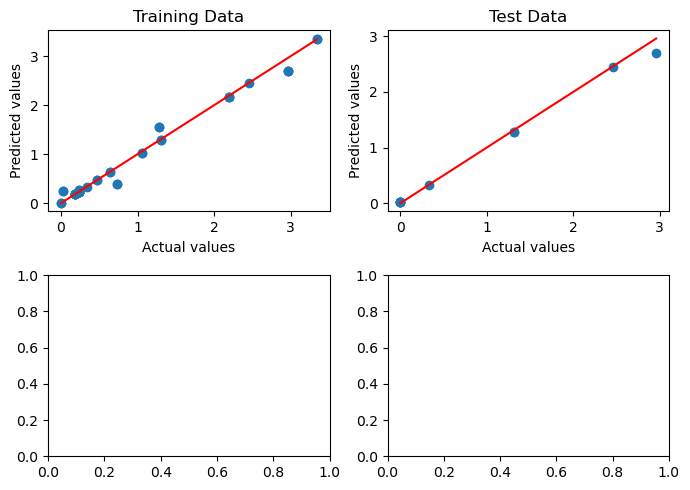

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1940/2000], Loss: 0.0164
Train R²:  0.98478
Test R² :  0.99570


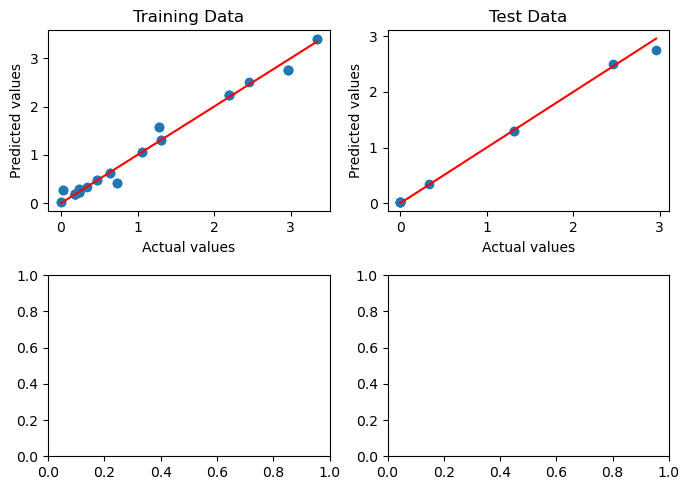

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1960/2000], Loss: 0.0155
Train R²:  0.98566
Test R² :  0.99507


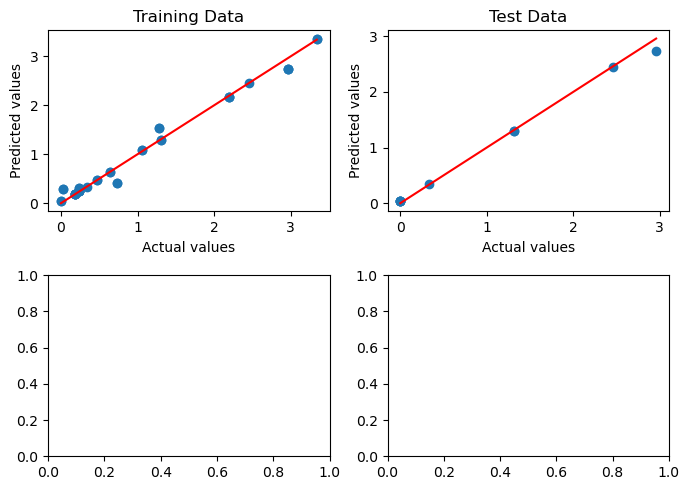

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [1980/2000], Loss: 0.0146
Train R²:  0.98643
Test R² :  0.99607


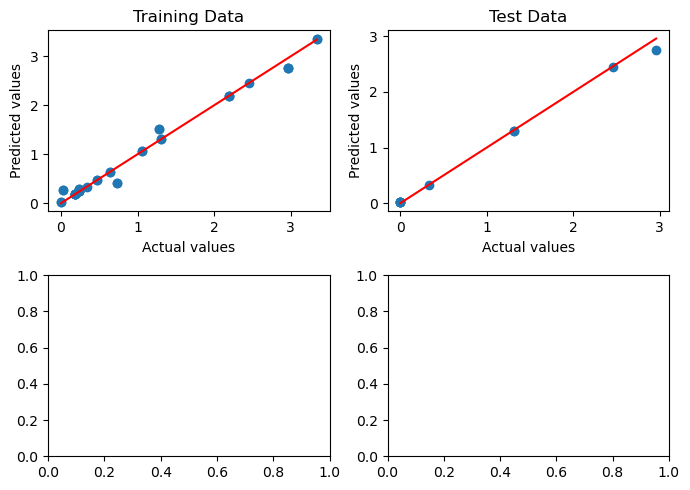

<Figure size 640x480 with 0 Axes>

[Epsilonf] Epoch [2000/2000], Loss: 0.0142
Train R²:  0.98681
Test R² :  0.99725


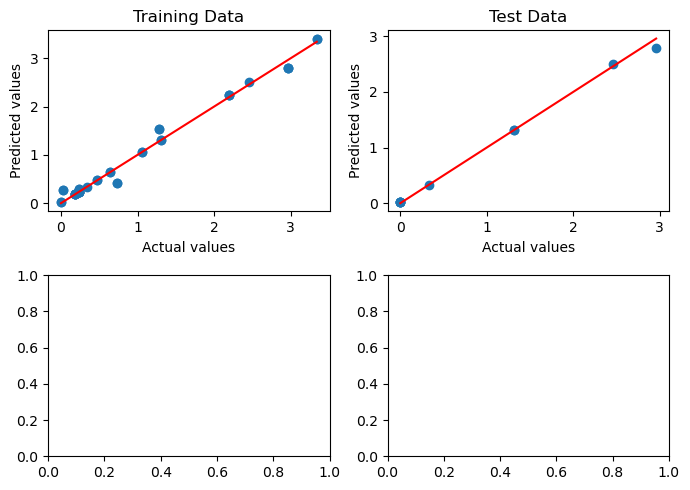

<Figure size 640x480 with 0 Axes>

In [10]:
GBR_NN(6)

[c] Epoch [20/2000], Loss: 1.2702
Train R²:  -25.78573
Test R² :  -22.07708


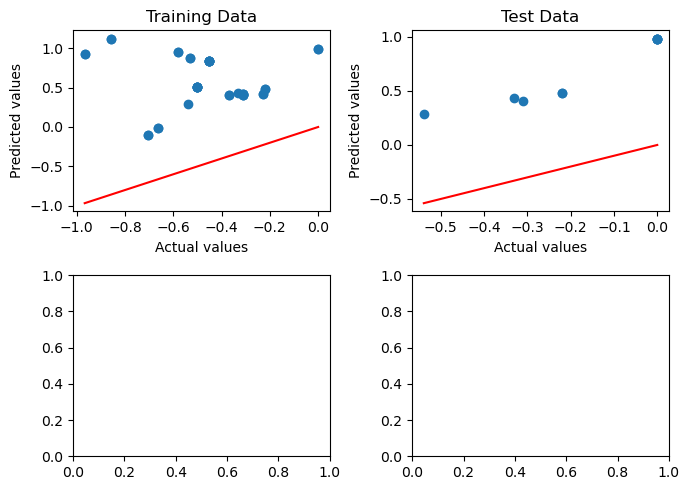

<Figure size 640x480 with 0 Axes>

[c] Epoch [40/2000], Loss: 0.0654
Train R²:  -0.37979
Test R² :  -7.13019


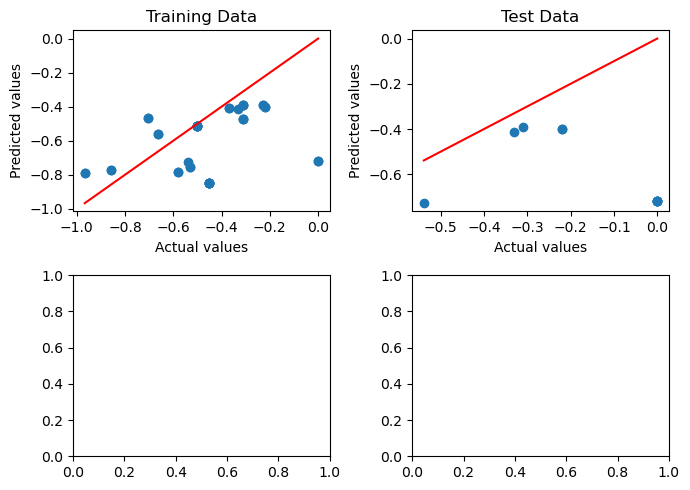

<Figure size 640x480 with 0 Axes>

[c] Epoch [60/2000], Loss: 0.0385
Train R²:  0.18727
Test R² :  -4.75737


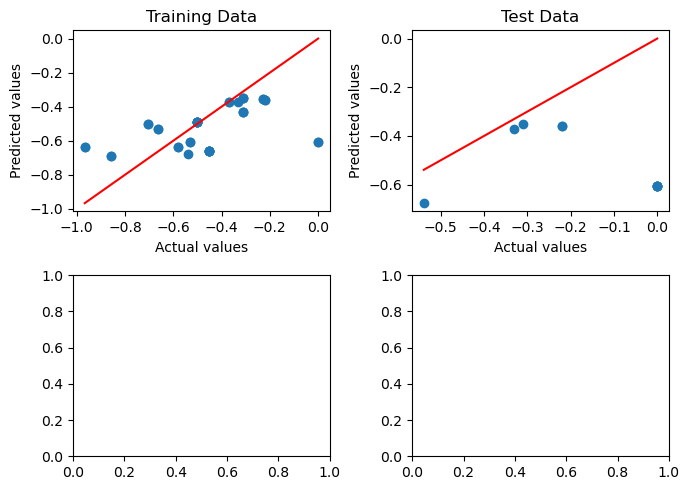

<Figure size 640x480 with 0 Axes>

[c] Epoch [80/2000], Loss: 0.0342
Train R²:  0.27845
Test R² :  -1.94734


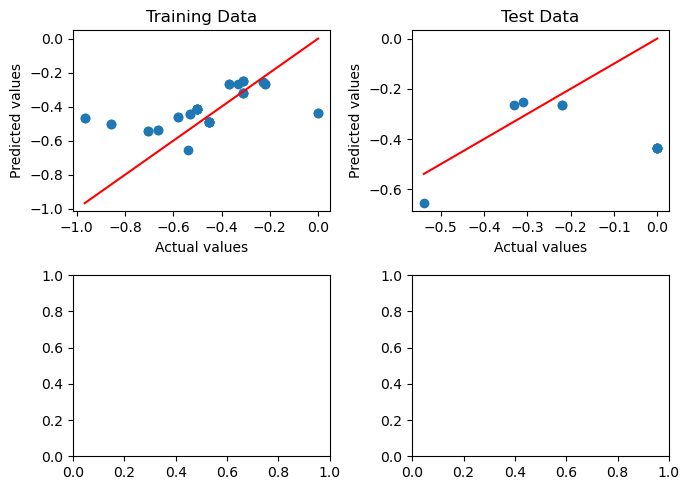

<Figure size 640x480 with 0 Axes>

[c] Epoch [100/2000], Loss: 0.0300
Train R²:  0.36713
Test R² :  -3.01683


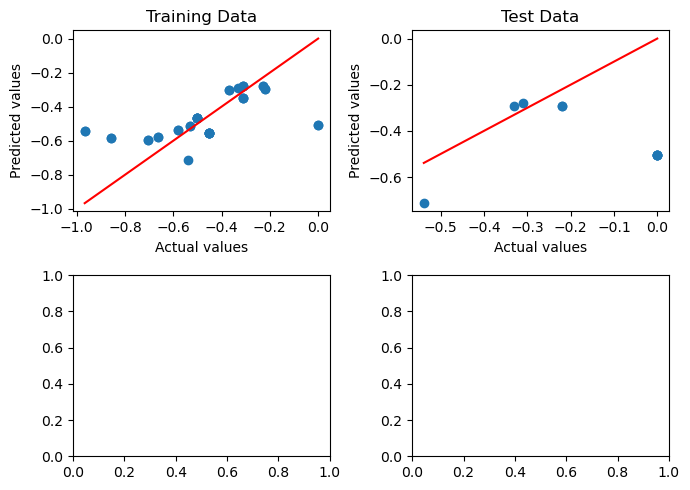

<Figure size 640x480 with 0 Axes>

[c] Epoch [120/2000], Loss: 0.0292
Train R²:  0.38370
Test R² :  -3.03722


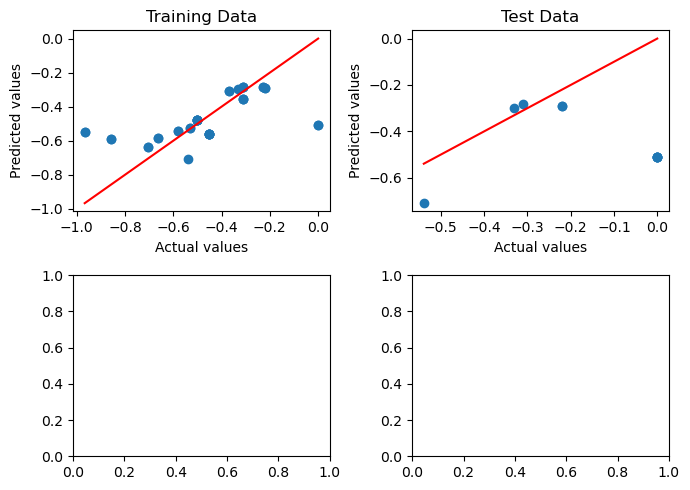

<Figure size 640x480 with 0 Axes>

[c] Epoch [140/2000], Loss: 0.0286
Train R²:  0.39741
Test R² :  -2.92674


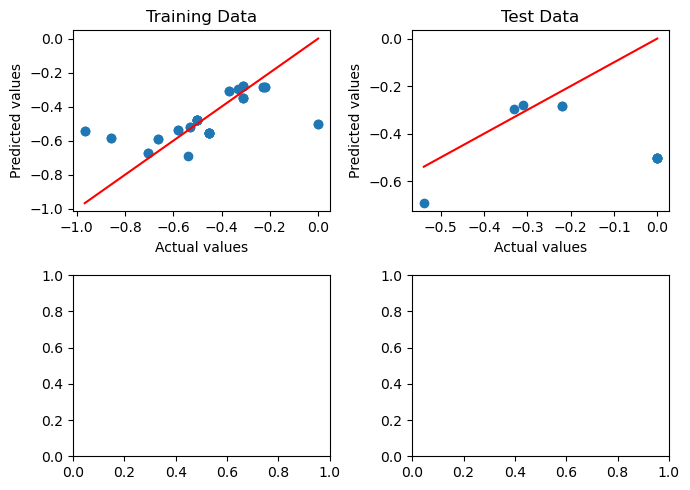

<Figure size 640x480 with 0 Axes>

[c] Epoch [160/2000], Loss: 0.0281
Train R²:  0.40736
Test R² :  -2.83015


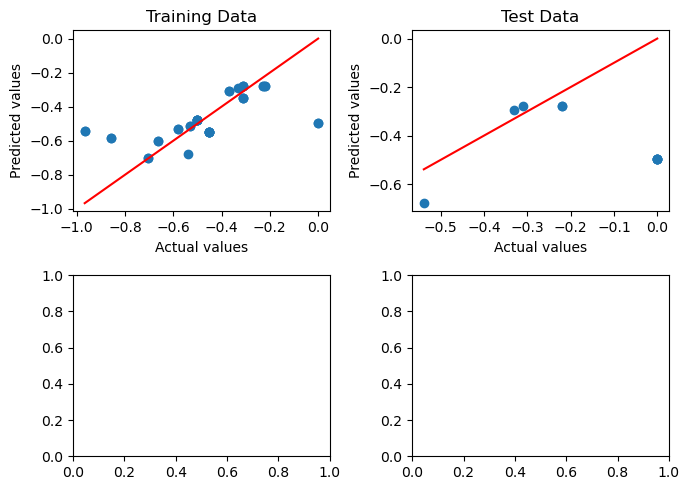

<Figure size 640x480 with 0 Axes>

[c] Epoch [180/2000], Loss: 0.0277
Train R²:  0.41566
Test R² :  -2.81540


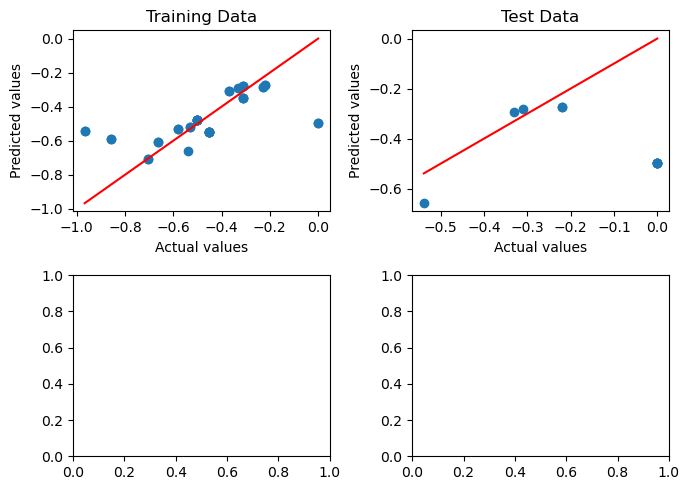

<Figure size 640x480 with 0 Axes>

[c] Epoch [200/2000], Loss: 0.0275
Train R²:  0.42068
Test R² :  -2.79090


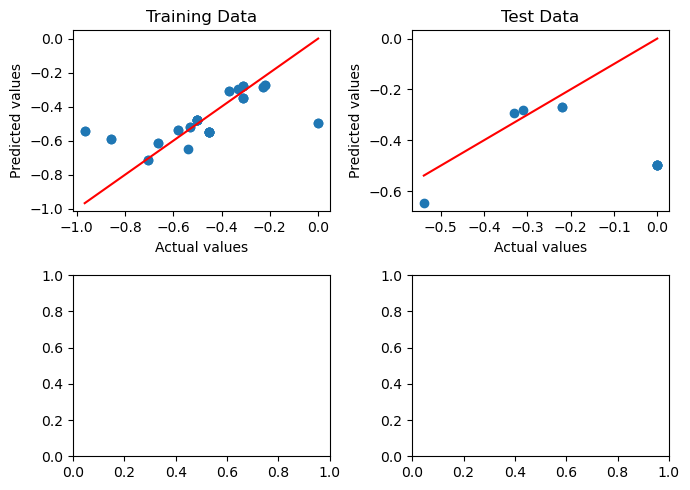

<Figure size 640x480 with 0 Axes>

[c] Epoch [220/2000], Loss: 0.0273
Train R²:  0.42490
Test R² :  -2.76924


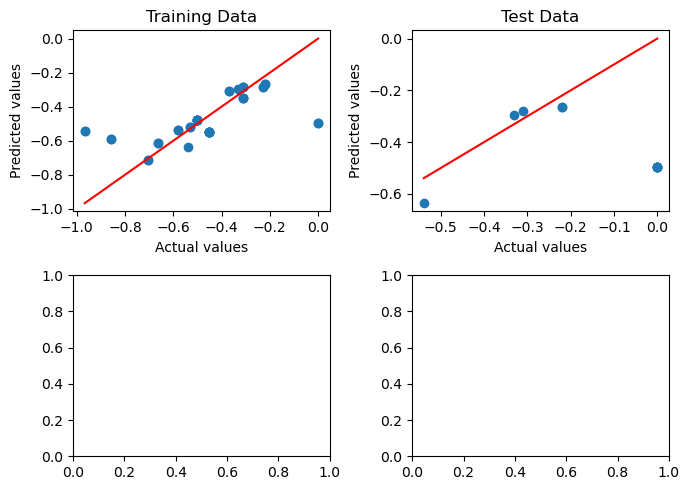

<Figure size 640x480 with 0 Axes>

[c] Epoch [240/2000], Loss: 0.0271
Train R²:  0.42783
Test R² :  -2.77352


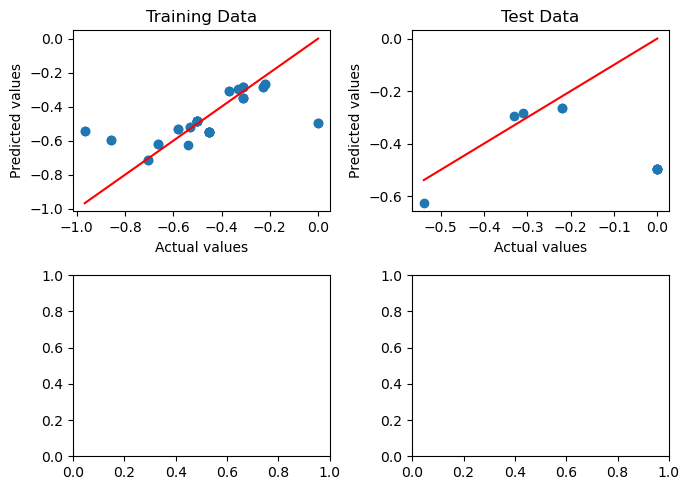

<Figure size 640x480 with 0 Axes>

[c] Epoch [260/2000], Loss: 0.0270
Train R²:  0.43037
Test R² :  -2.78637


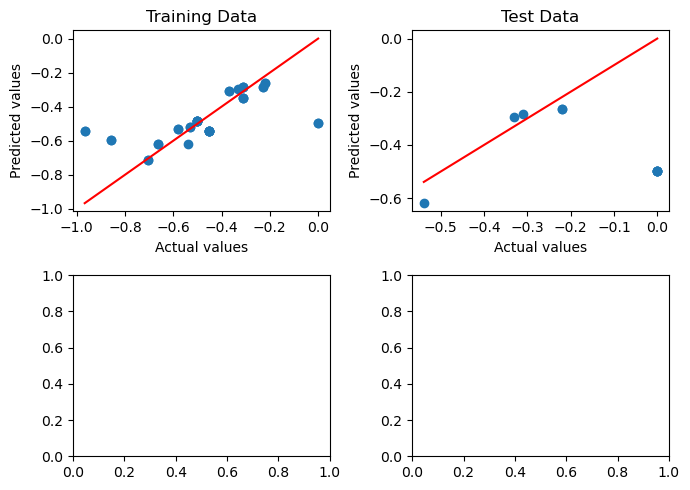

<Figure size 640x480 with 0 Axes>

[c] Epoch [280/2000], Loss: 0.0269
Train R²:  0.43260
Test R² :  -2.79636


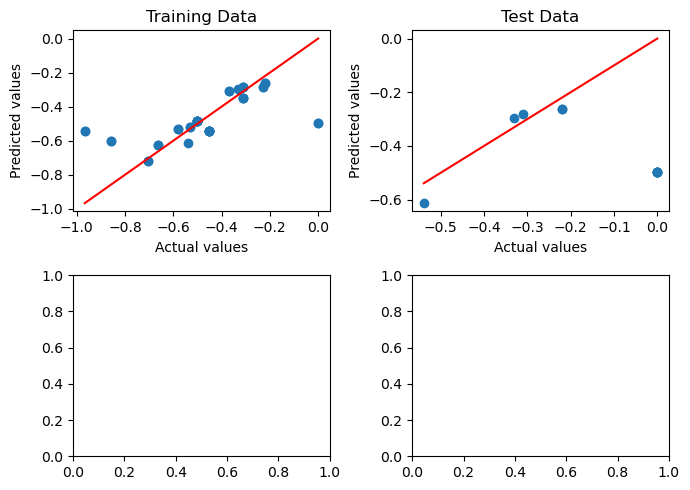

<Figure size 640x480 with 0 Axes>

[c] Epoch [300/2000], Loss: 0.0268
Train R²:  0.43452
Test R² :  -2.80766


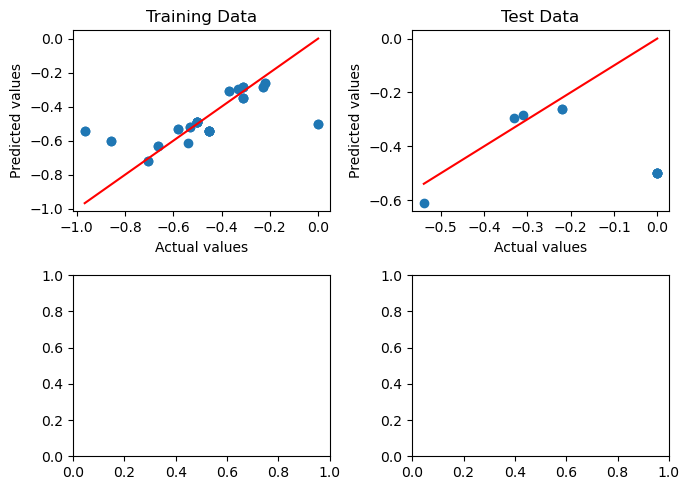

<Figure size 640x480 with 0 Axes>

[c] Epoch [320/2000], Loss: 0.0267
Train R²:  0.43682
Test R² :  -2.81592


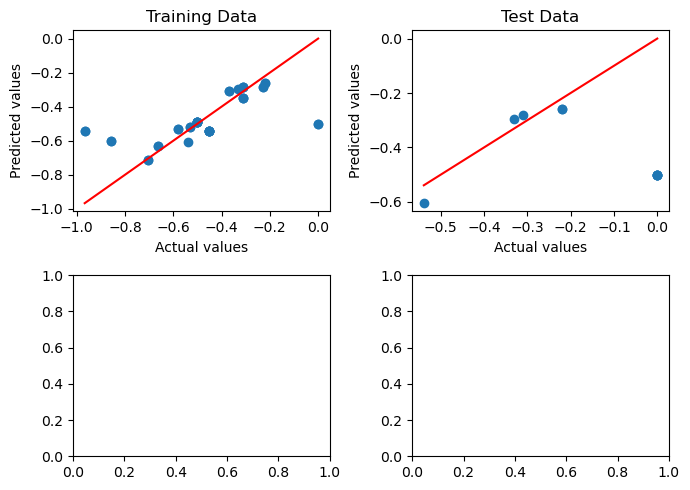

<Figure size 640x480 with 0 Axes>

[c] Epoch [340/2000], Loss: 0.0266
Train R²:  0.43939
Test R² :  -2.81246


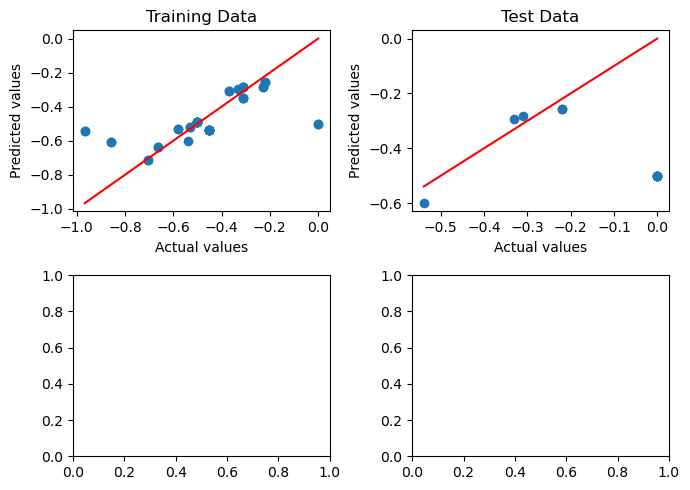

<Figure size 640x480 with 0 Axes>

[c] Epoch [360/2000], Loss: 0.0265
Train R²:  0.44127
Test R² :  -2.83968


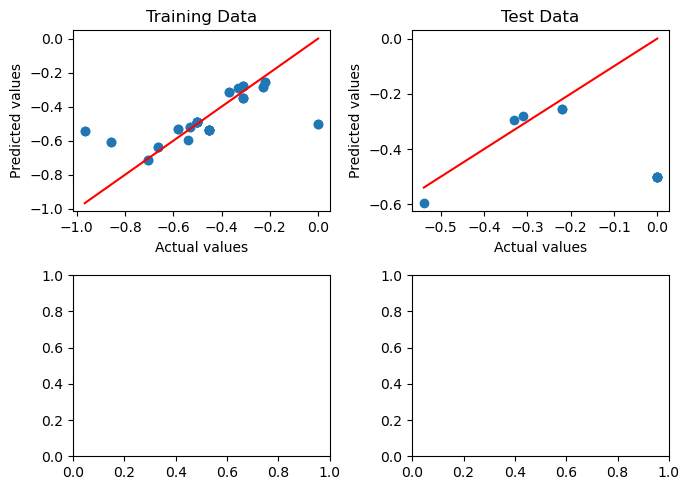

<Figure size 640x480 with 0 Axes>

[c] Epoch [380/2000], Loss: 0.0264
Train R²:  0.44333
Test R² :  -2.84572


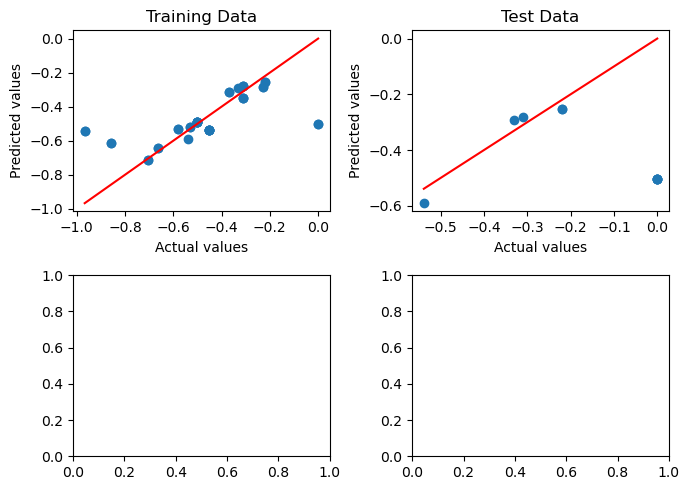

<Figure size 640x480 with 0 Axes>

[c] Epoch [400/2000], Loss: 0.0263
Train R²:  0.44514
Test R² :  -2.84990


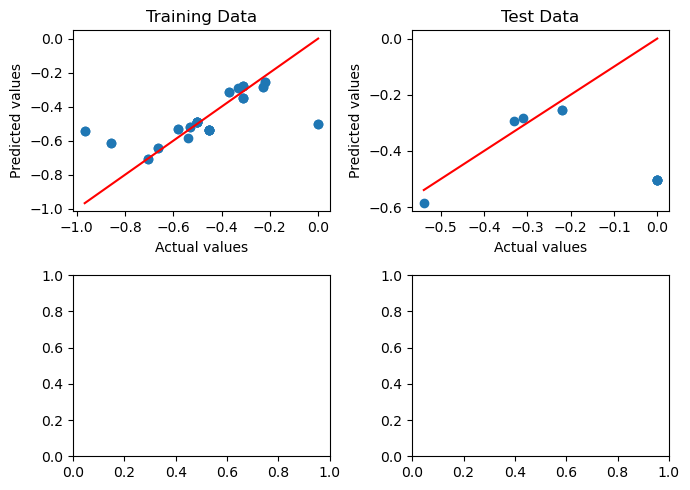

<Figure size 640x480 with 0 Axes>

[c] Epoch [420/2000], Loss: 0.0262
Train R²:  0.44656
Test R² :  -2.86067


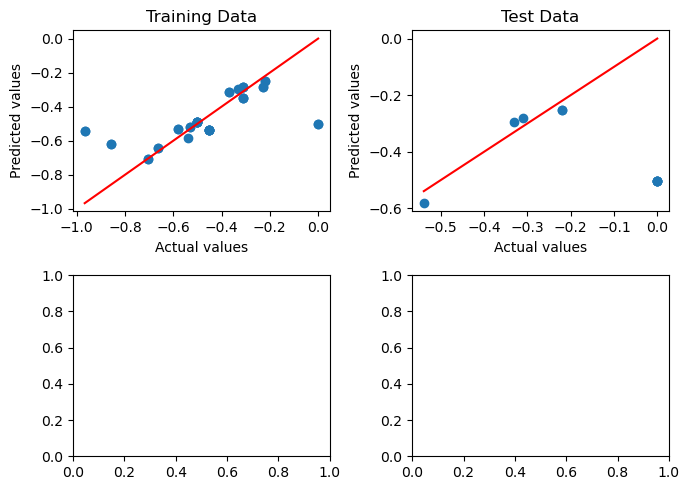

<Figure size 640x480 with 0 Axes>

[c] Epoch [440/2000], Loss: 0.0262
Train R²:  0.44786
Test R² :  -2.89605


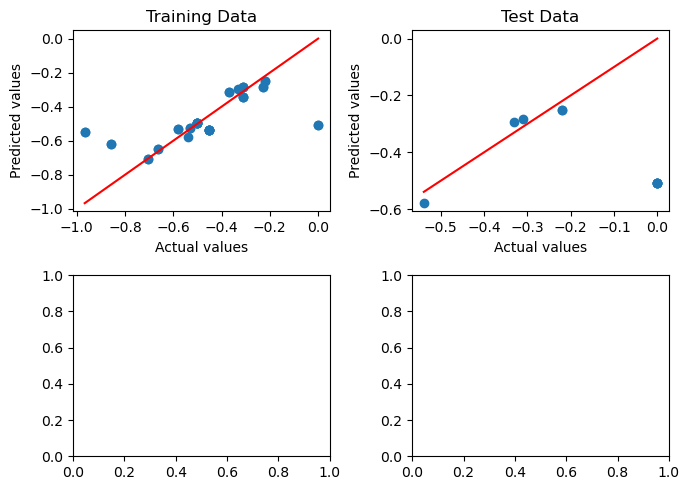

<Figure size 640x480 with 0 Axes>

[c] Epoch [460/2000], Loss: 0.0261
Train R²:  0.44994
Test R² :  -2.88480


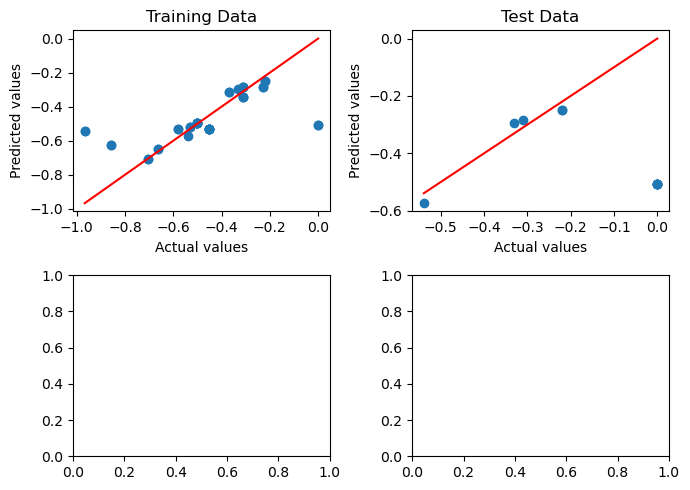

<Figure size 640x480 with 0 Axes>

[c] Epoch [480/2000], Loss: 0.0260
Train R²:  0.45121
Test R² :  -2.90207


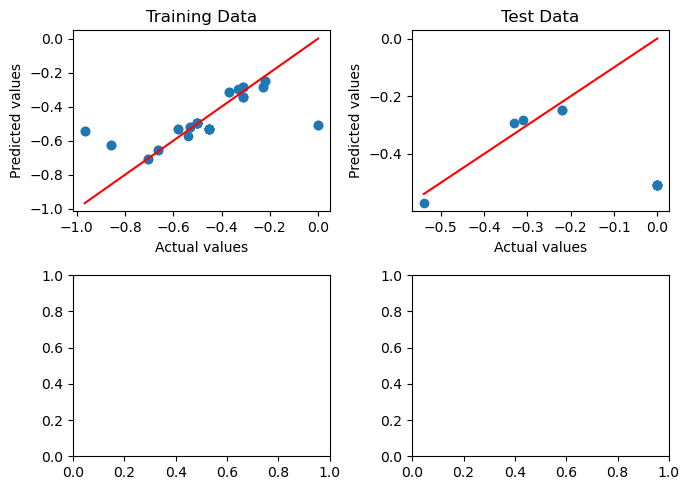

<Figure size 640x480 with 0 Axes>

[c] Epoch [500/2000], Loss: 0.0260
Train R²:  0.45254
Test R² :  -2.89377


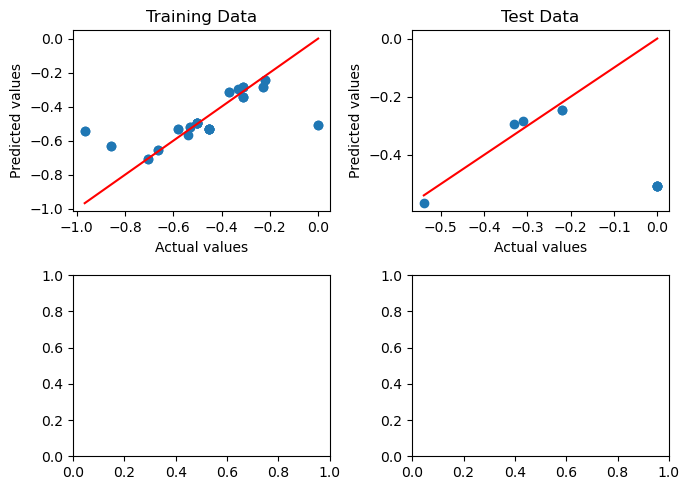

<Figure size 640x480 with 0 Axes>

[c] Epoch [520/2000], Loss: 0.0259
Train R²:  0.45444
Test R² :  -2.91393


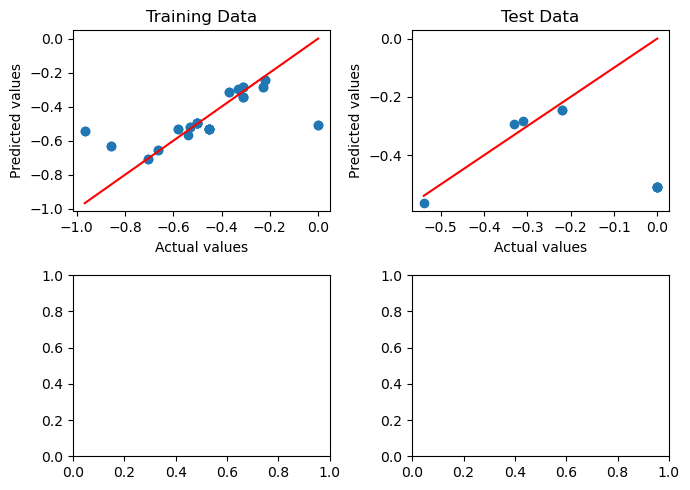

<Figure size 640x480 with 0 Axes>

[c] Epoch [540/2000], Loss: 0.0258
Train R²:  0.45586
Test R² :  -2.92236


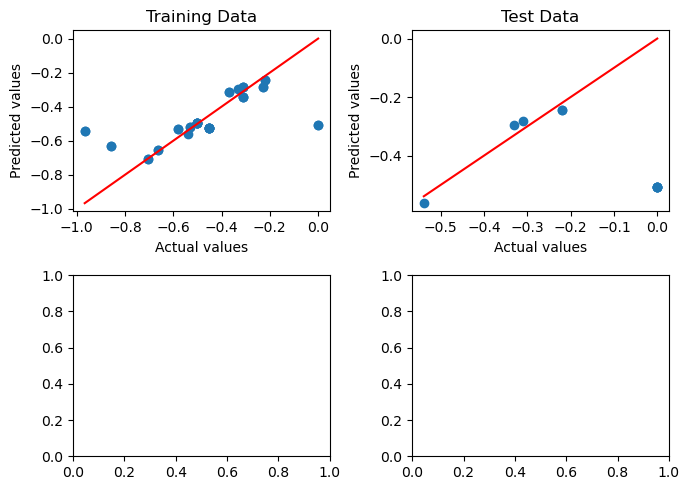

<Figure size 640x480 with 0 Axes>

[c] Epoch [560/2000], Loss: 0.0257
Train R²:  0.45713
Test R² :  -2.93762


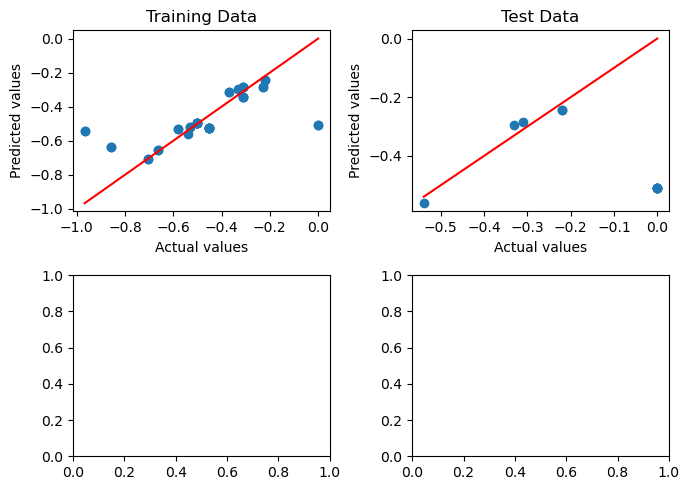

<Figure size 640x480 with 0 Axes>

[c] Epoch [580/2000], Loss: 0.0257
Train R²:  0.45831
Test R² :  -2.95301


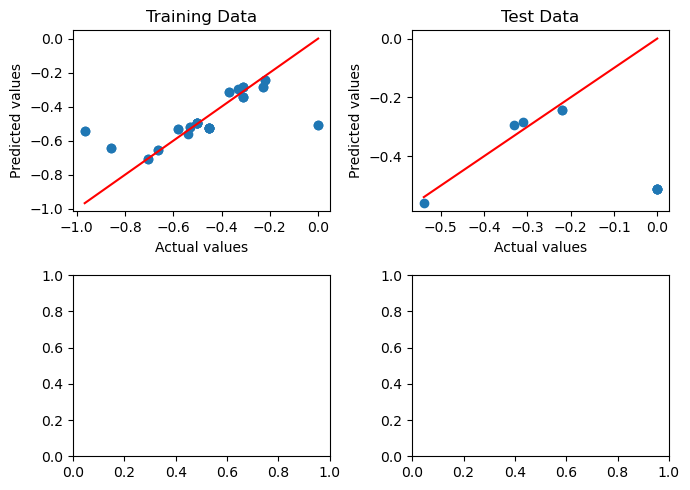

<Figure size 640x480 with 0 Axes>

[c] Epoch [600/2000], Loss: 0.0256
Train R²:  0.45947
Test R² :  -2.95892


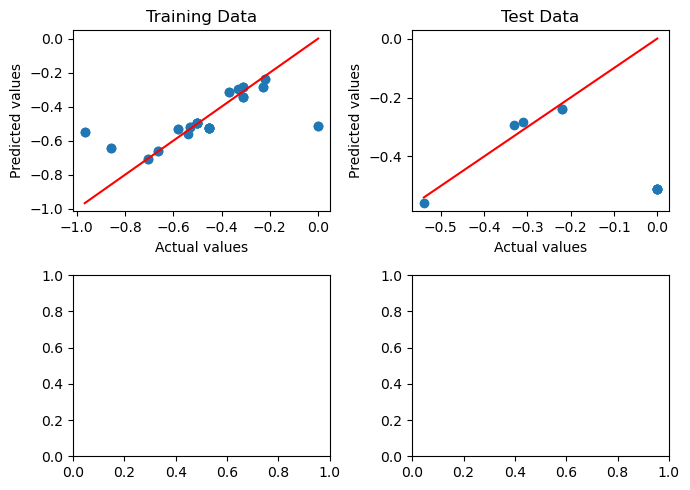

<Figure size 640x480 with 0 Axes>

[c] Epoch [620/2000], Loss: 0.0256
Train R²:  0.46087
Test R² :  -2.96292


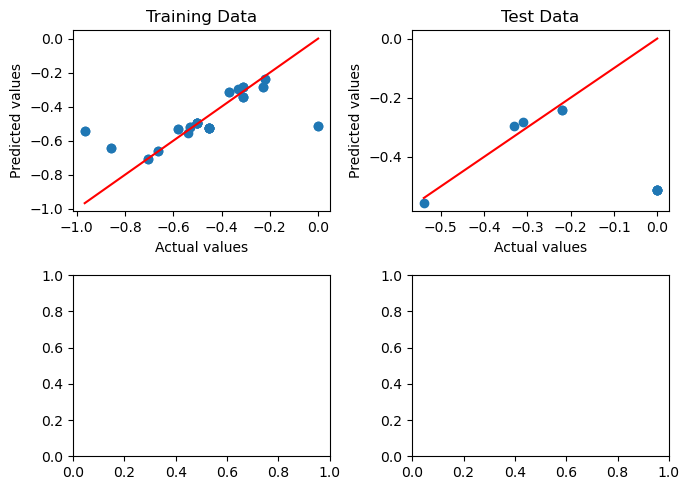

<Figure size 640x480 with 0 Axes>

[c] Epoch [640/2000], Loss: 0.0255
Train R²:  0.46194
Test R² :  -2.96864


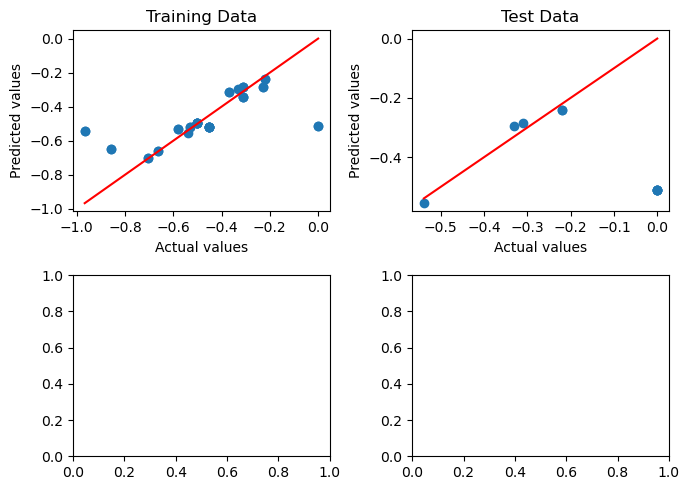

<Figure size 640x480 with 0 Axes>

[c] Epoch [660/2000], Loss: 0.0255
Train R²:  0.46317
Test R² :  -2.98347


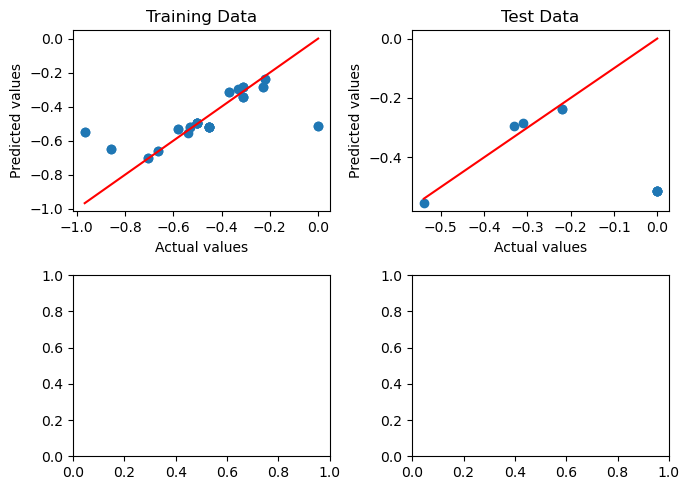

<Figure size 640x480 with 0 Axes>

[c] Epoch [680/2000], Loss: 0.0254
Train R²:  0.46392
Test R² :  -2.98621


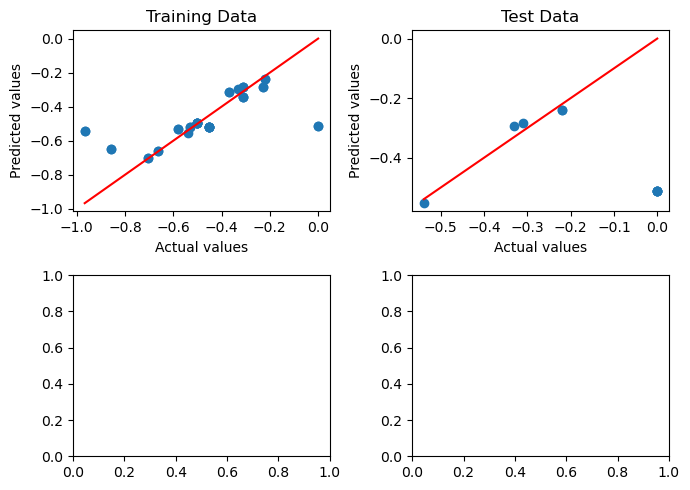

<Figure size 640x480 with 0 Axes>

[c] Epoch [700/2000], Loss: 0.0254
Train R²:  0.46479
Test R² :  -2.99863


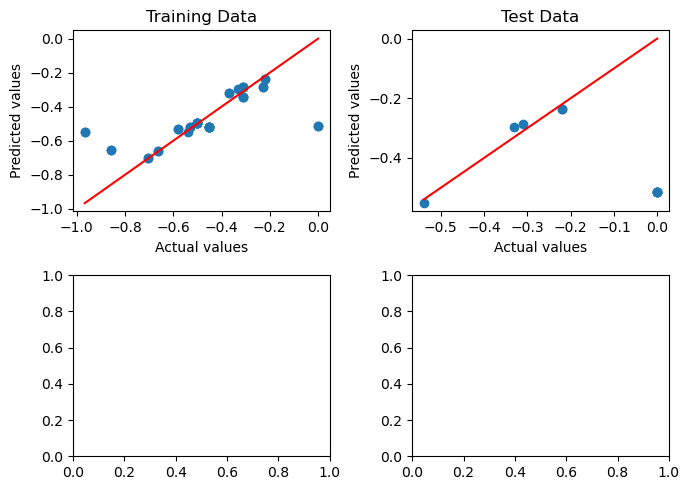

<Figure size 640x480 with 0 Axes>

[c] Epoch [720/2000], Loss: 0.0253
Train R²:  0.46638
Test R² :  -3.00879


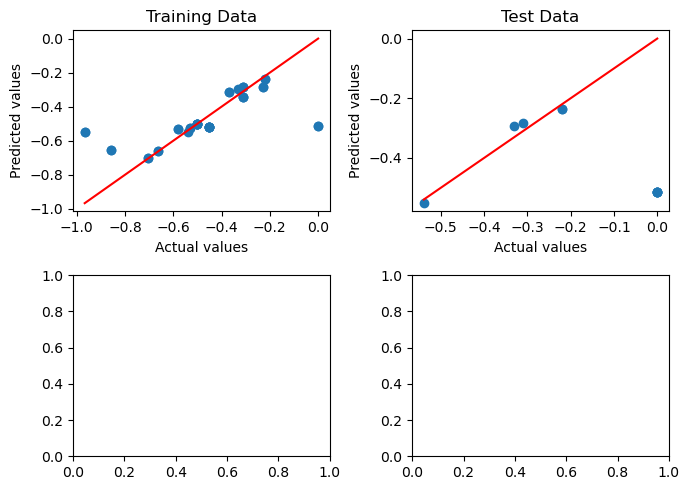

<Figure size 640x480 with 0 Axes>

[c] Epoch [740/2000], Loss: 0.0253
Train R²:  0.46740
Test R² :  -3.00945


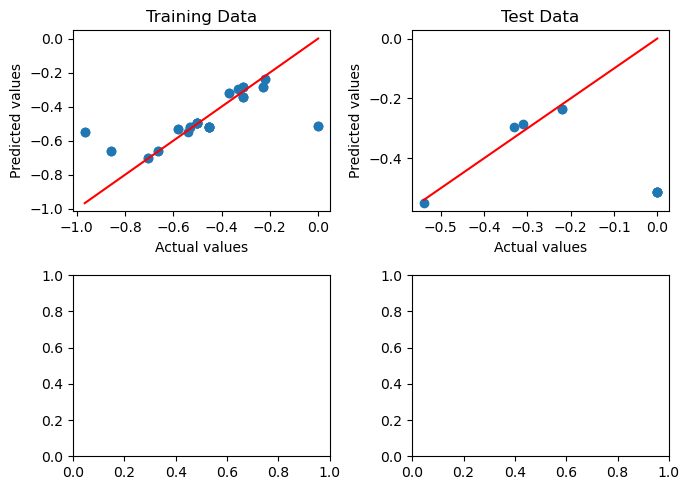

<Figure size 640x480 with 0 Axes>

[c] Epoch [760/2000], Loss: 0.0252
Train R²:  0.46843
Test R² :  -2.99876


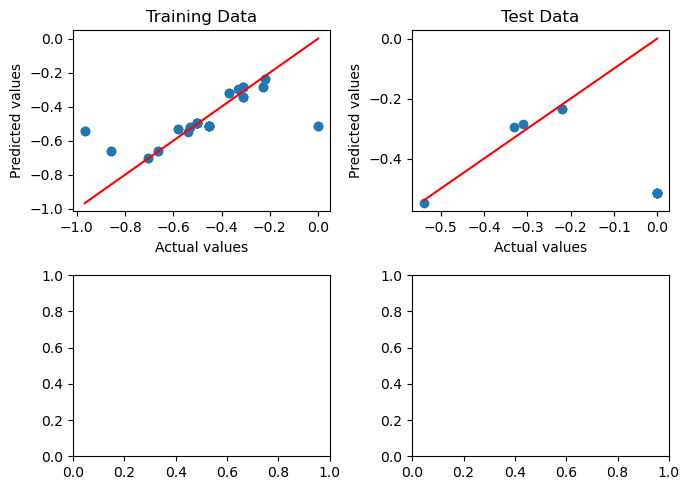

<Figure size 640x480 with 0 Axes>

[c] Epoch [780/2000], Loss: 0.0252
Train R²:  0.46919
Test R² :  -3.01219


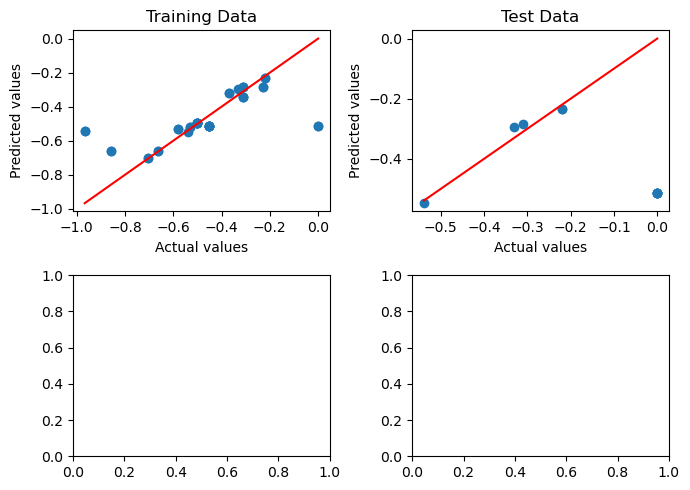

<Figure size 640x480 with 0 Axes>

[c] Epoch [800/2000], Loss: 0.0251
Train R²:  0.47025
Test R² :  -2.99097


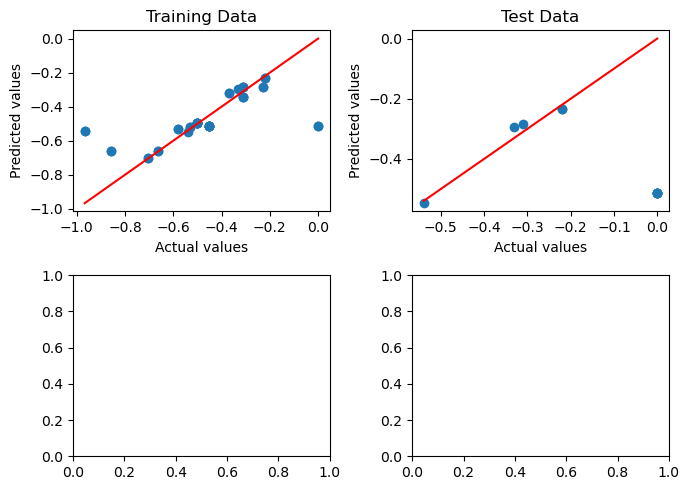

<Figure size 640x480 with 0 Axes>

[c] Epoch [820/2000], Loss: 0.0251
Train R²:  0.47115
Test R² :  -3.03283


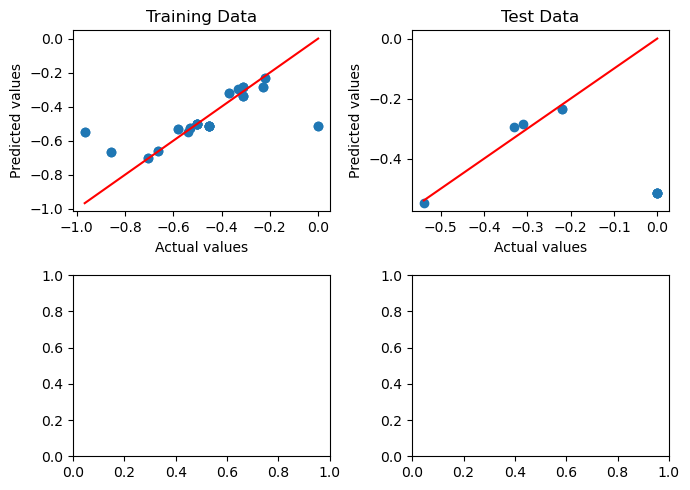

<Figure size 640x480 with 0 Axes>

[c] Epoch [840/2000], Loss: 0.0250
Train R²:  0.47213
Test R² :  -3.02163


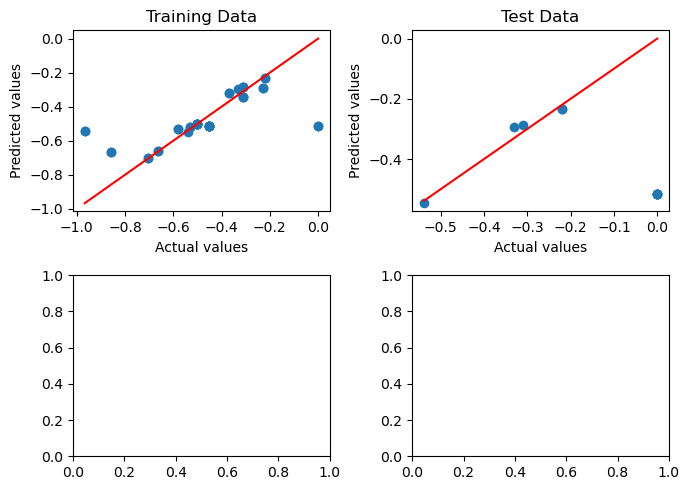

<Figure size 640x480 with 0 Axes>

[c] Epoch [860/2000], Loss: 0.0250
Train R²:  0.47296
Test R² :  -3.05231


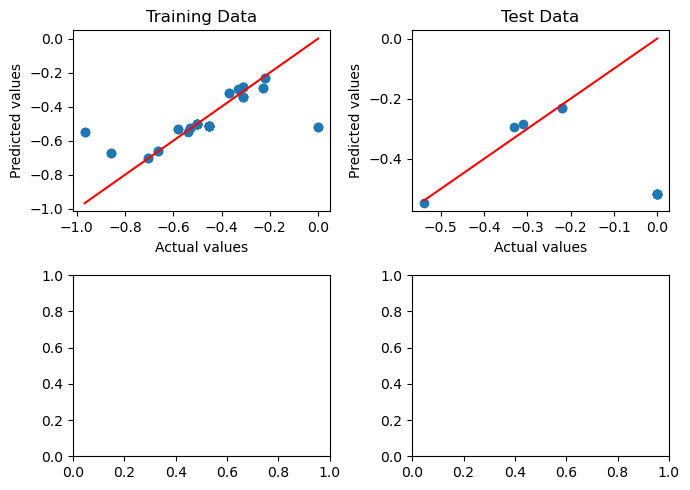

<Figure size 640x480 with 0 Axes>

[c] Epoch [880/2000], Loss: 0.0250
Train R²:  0.47289
Test R² :  -3.05932


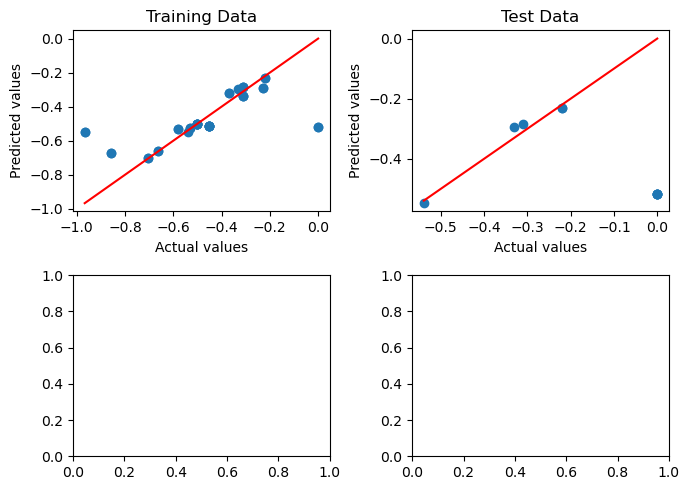

<Figure size 640x480 with 0 Axes>

[c] Epoch [900/2000], Loss: 0.0249
Train R²:  0.47515
Test R² :  -3.01141


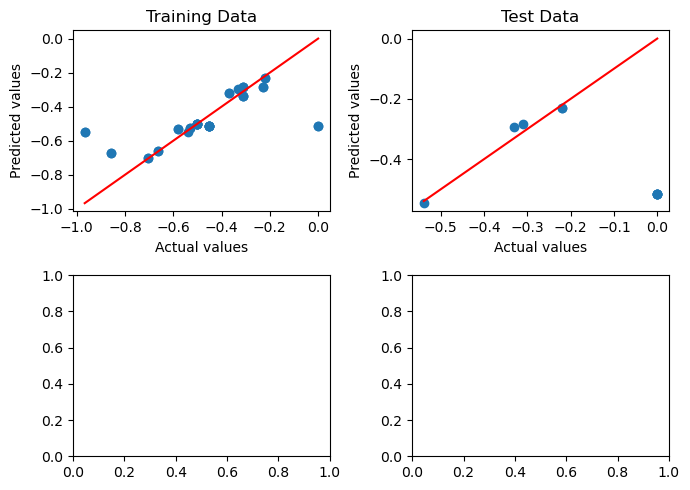

<Figure size 640x480 with 0 Axes>

[c] Epoch [920/2000], Loss: 0.0248
Train R²:  0.47680
Test R² :  -3.02322


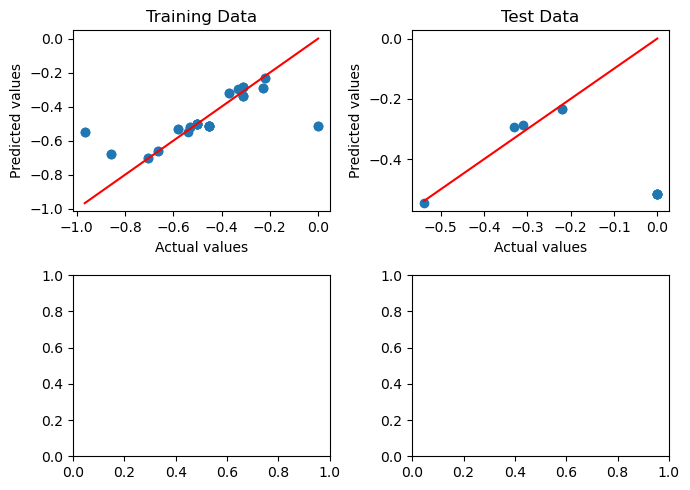

<Figure size 640x480 with 0 Axes>

[c] Epoch [940/2000], Loss: 0.0248
Train R²:  0.47794
Test R² :  -2.99359


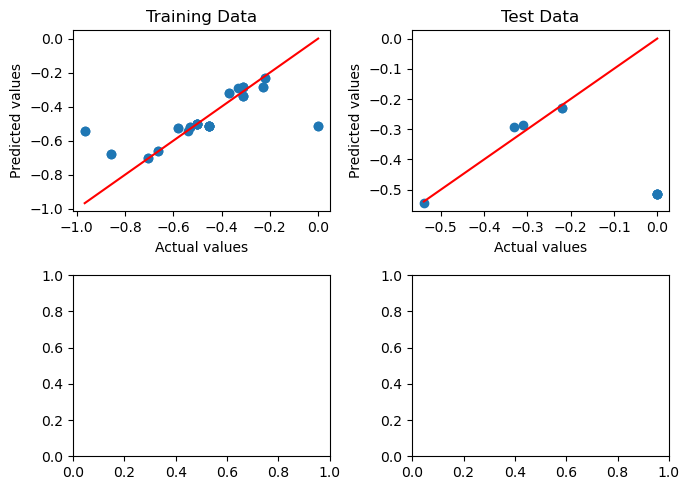

<Figure size 640x480 with 0 Axes>

[c] Epoch [960/2000], Loss: 0.0247
Train R²:  0.47926
Test R² :  -2.99102


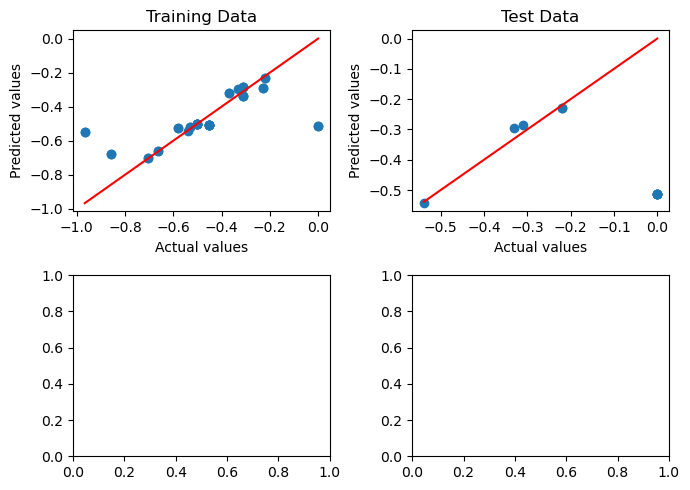

<Figure size 640x480 with 0 Axes>

[c] Epoch [980/2000], Loss: 0.0247
Train R²:  0.47938
Test R² :  -3.02455


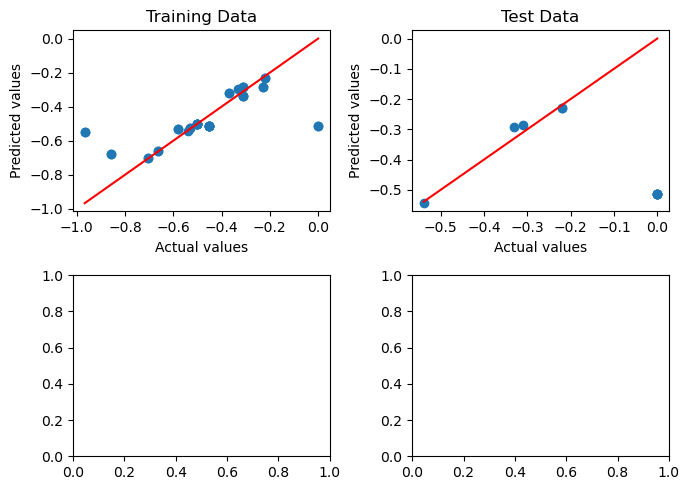

<Figure size 640x480 with 0 Axes>

[c] Epoch [1000/2000], Loss: 0.0246
Train R²:  0.48084
Test R² :  -2.96890


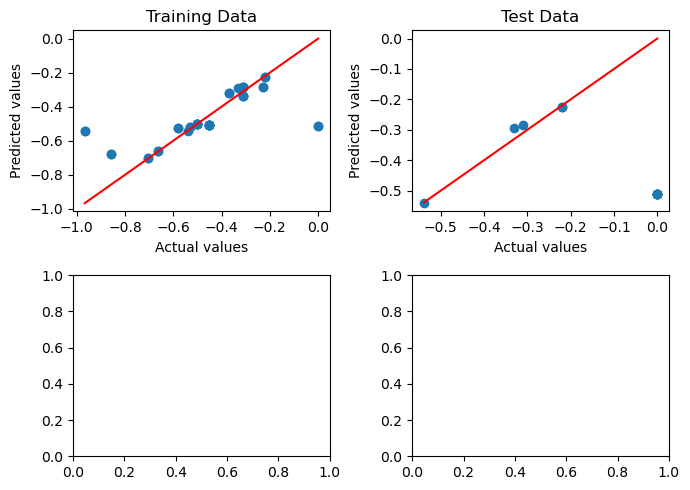

<Figure size 640x480 with 0 Axes>

[c] Epoch [1020/2000], Loss: 0.0246
Train R²:  0.48133
Test R² :  -3.01570


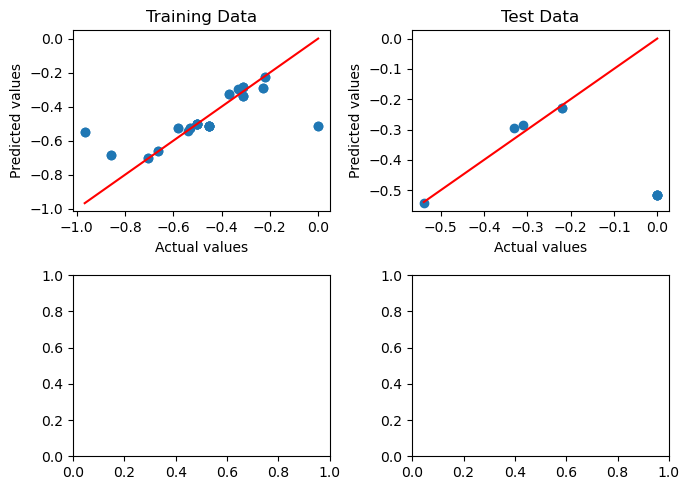

<Figure size 640x480 with 0 Axes>

[c] Epoch [1040/2000], Loss: 0.0245
Train R²:  0.48237
Test R² :  -3.00021


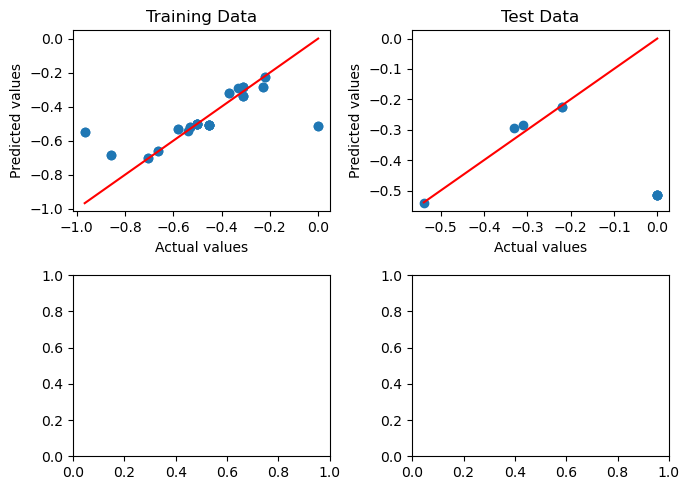

<Figure size 640x480 with 0 Axes>

[c] Epoch [1060/2000], Loss: 0.0244
Train R²:  0.48452
Test R² :  -2.95888


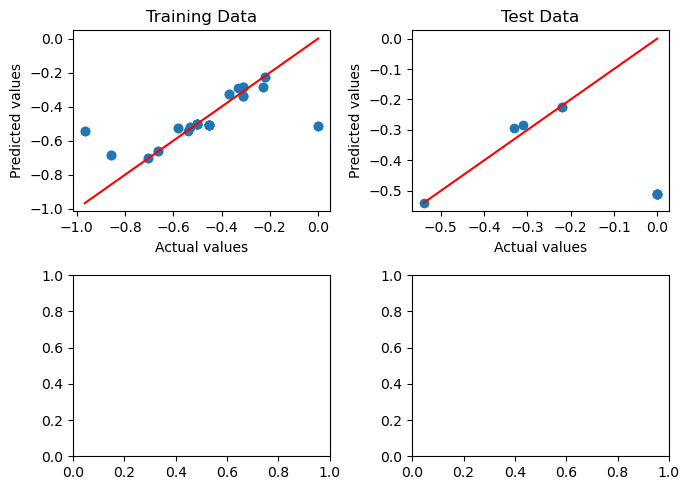

<Figure size 640x480 with 0 Axes>

[c] Epoch [1080/2000], Loss: 0.0245
Train R²:  0.48327
Test R² :  -3.02183


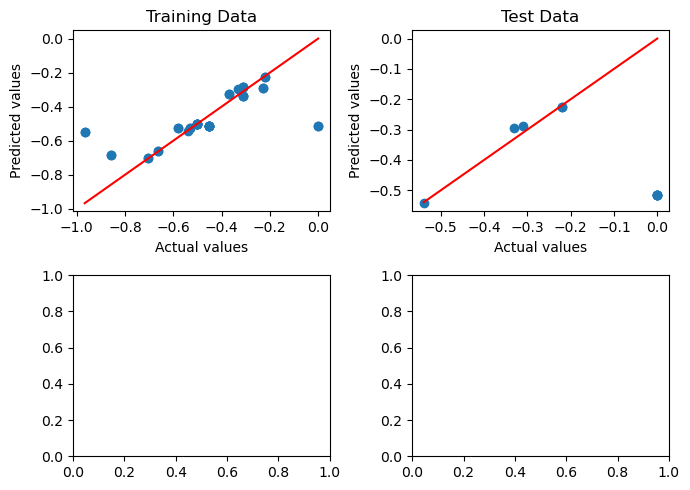

<Figure size 640x480 with 0 Axes>

[c] Epoch [1100/2000], Loss: 0.0244
Train R²:  0.48539
Test R² :  -2.98879


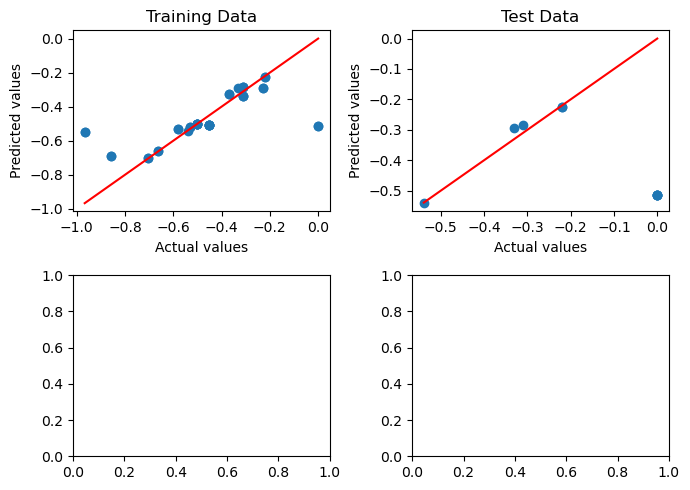

<Figure size 640x480 with 0 Axes>

[c] Epoch [1120/2000], Loss: 0.0244
Train R²:  0.48513
Test R² :  -3.03832


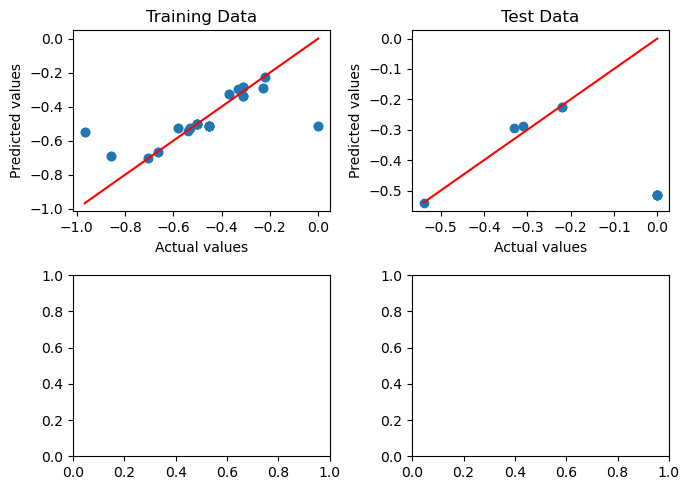

<Figure size 640x480 with 0 Axes>

[c] Epoch [1140/2000], Loss: 0.0244
Train R²:  0.48646
Test R² :  -3.01706


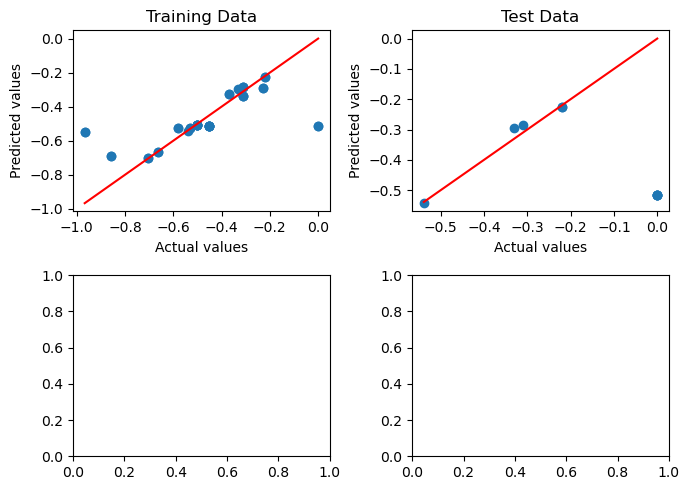

<Figure size 640x480 with 0 Axes>

[c] Epoch [1160/2000], Loss: 0.0243
Train R²:  0.48781
Test R² :  -3.00064


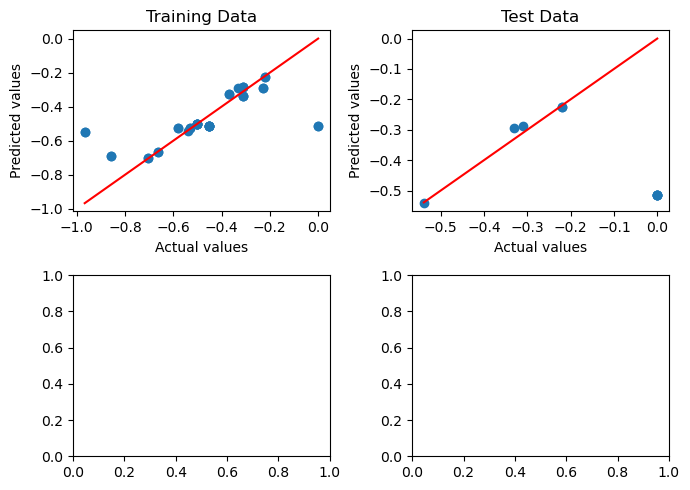

<Figure size 640x480 with 0 Axes>

[c] Epoch [1180/2000], Loss: 0.0242
Train R²:  0.48935
Test R² :  -2.96315


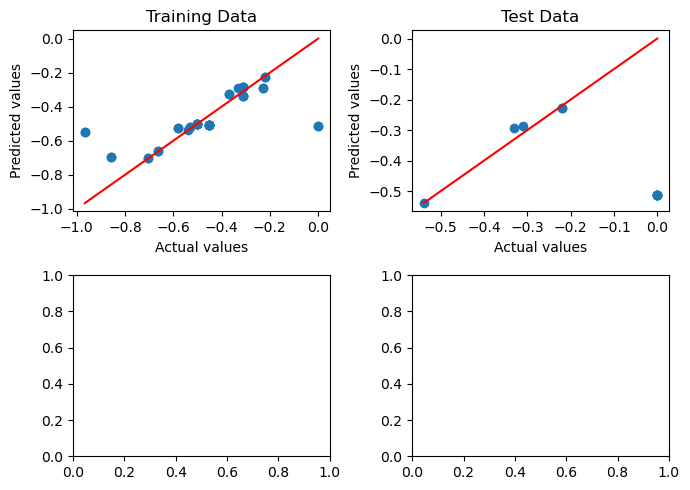

<Figure size 640x480 with 0 Axes>

[c] Epoch [1200/2000], Loss: 0.0242
Train R²:  0.48992
Test R² :  -2.99361


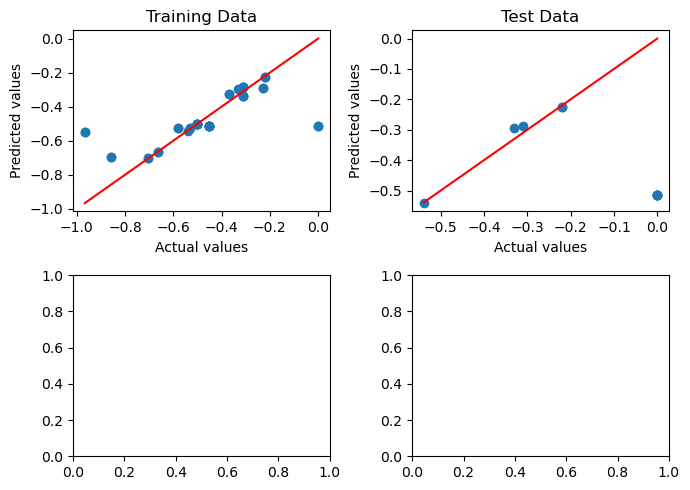

<Figure size 640x480 with 0 Axes>

[c] Epoch [1220/2000], Loss: 0.0242
Train R²:  0.49018
Test R² :  -2.92250


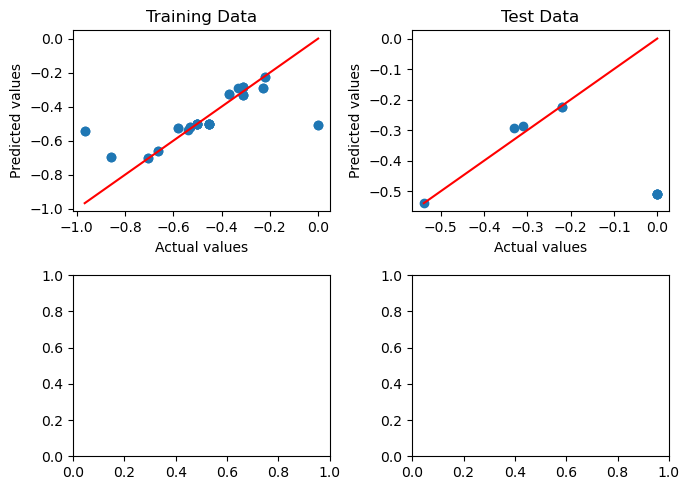

<Figure size 640x480 with 0 Axes>

[c] Epoch [1240/2000], Loss: 0.0241
Train R²:  0.49160
Test R² :  -2.92295


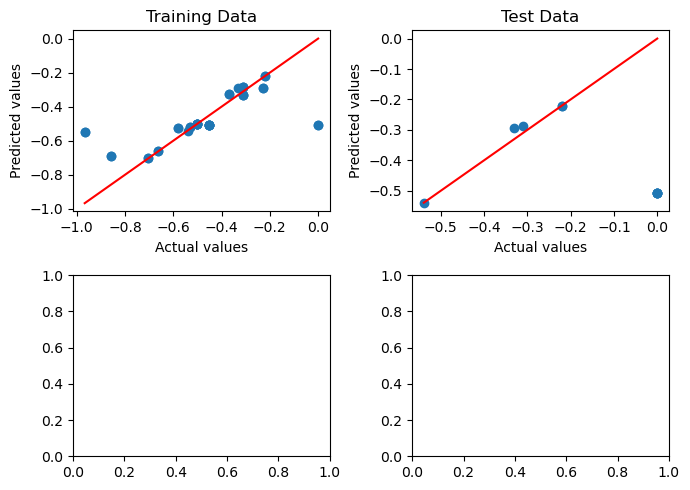

<Figure size 640x480 with 0 Axes>

[c] Epoch [1260/2000], Loss: 0.0240
Train R²:  0.49327
Test R² :  -2.86053


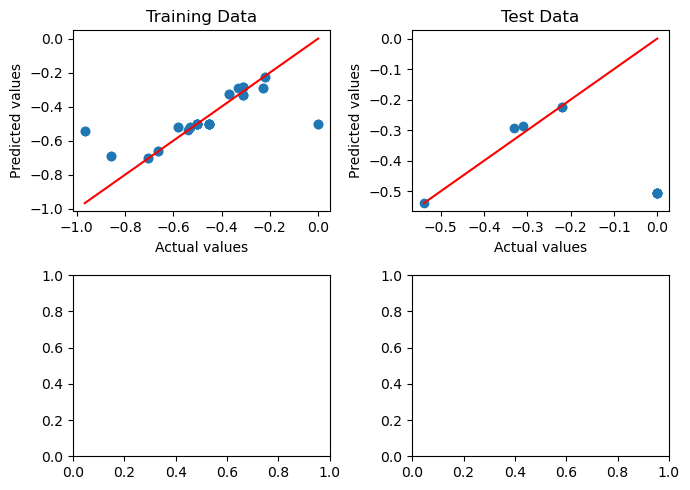

<Figure size 640x480 with 0 Axes>

[c] Epoch [1280/2000], Loss: 0.0239
Train R²:  0.49526
Test R² :  -2.88764


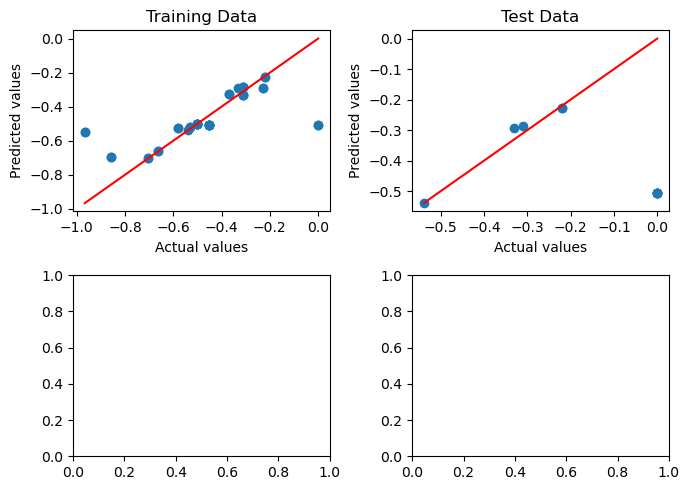

<Figure size 640x480 with 0 Axes>

[c] Epoch [1300/2000], Loss: 0.0240
Train R²:  0.49414
Test R² :  -2.95406


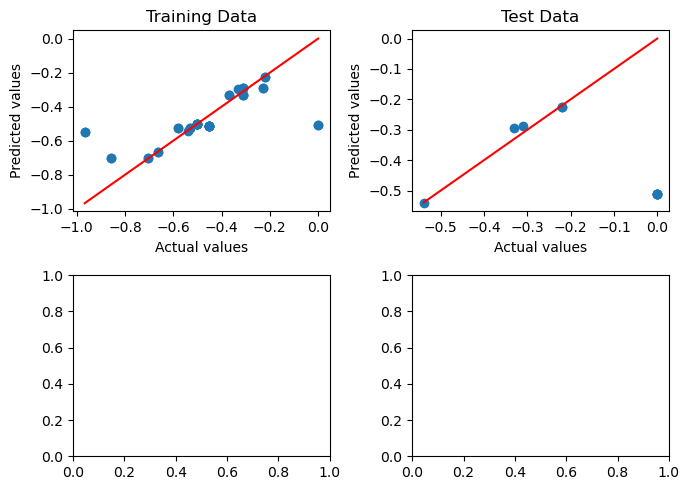

<Figure size 640x480 with 0 Axes>

[c] Epoch [1320/2000], Loss: 0.0238
Train R²:  0.49803
Test R² :  -2.93804


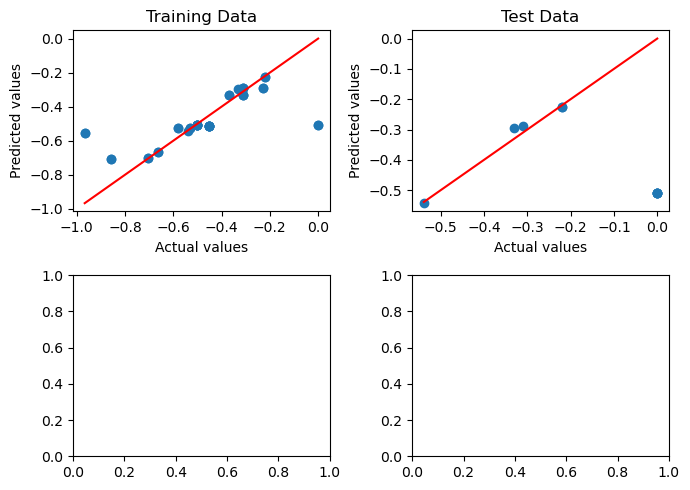

<Figure size 640x480 with 0 Axes>

[c] Epoch [1340/2000], Loss: 0.0238
Train R²:  0.49808
Test R² :  -2.87376


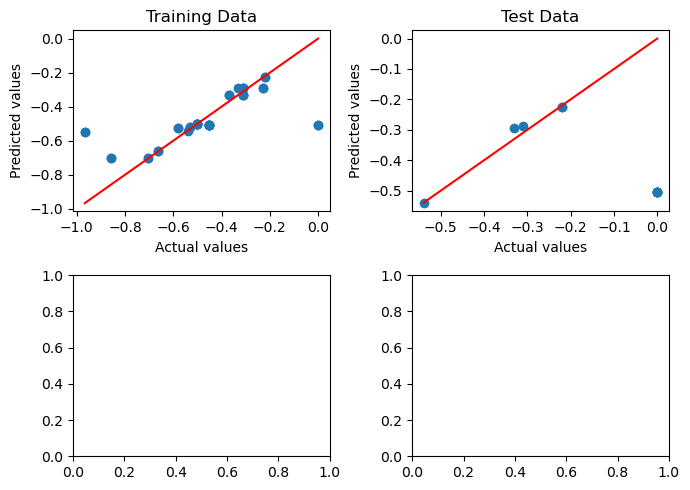

<Figure size 640x480 with 0 Axes>

[c] Epoch [1360/2000], Loss: 0.0238
Train R²:  0.49825
Test R² :  -2.74724


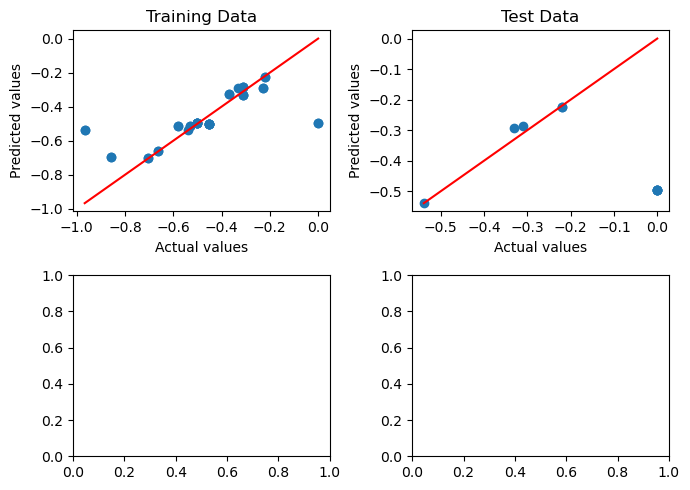

<Figure size 640x480 with 0 Axes>

[c] Epoch [1380/2000], Loss: 0.0237
Train R²:  0.50003
Test R² :  -2.78996


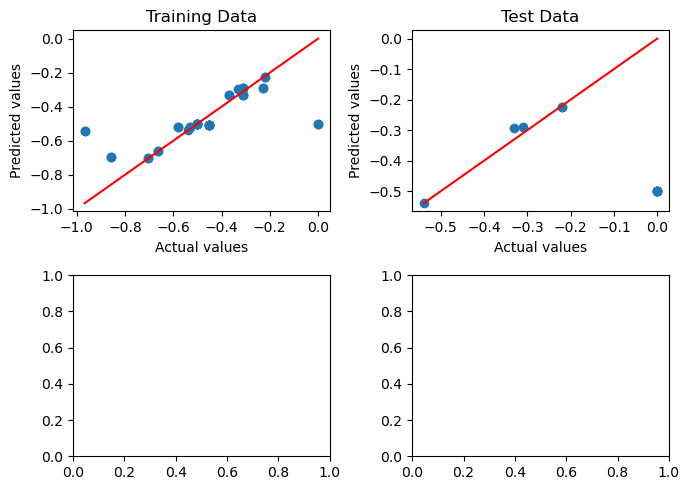

<Figure size 640x480 with 0 Axes>

[c] Epoch [1400/2000], Loss: 0.0237
Train R²:  0.50096
Test R² :  -2.79045


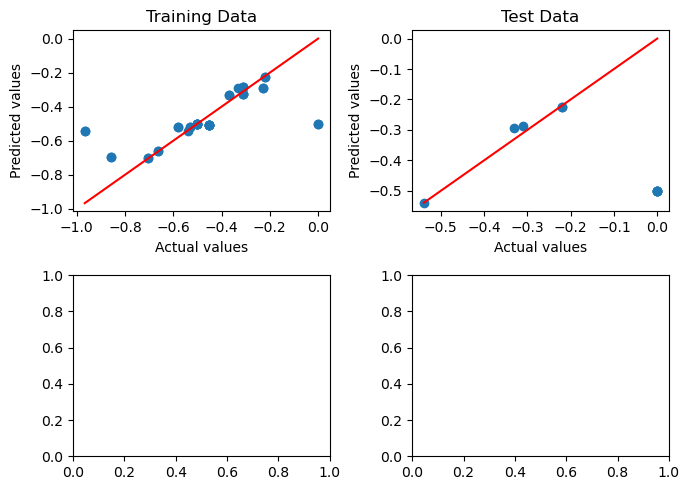

<Figure size 640x480 with 0 Axes>

[c] Epoch [1420/2000], Loss: 0.0236
Train R²:  0.50219
Test R² :  -2.83437


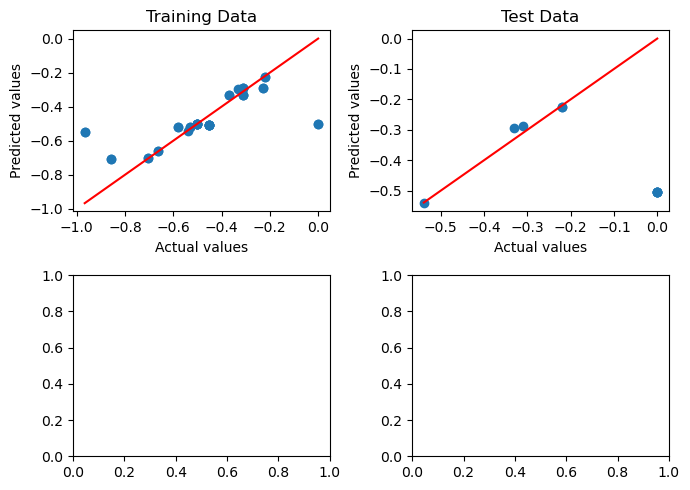

<Figure size 640x480 with 0 Axes>

[c] Epoch [1440/2000], Loss: 0.0235
Train R²:  0.50429
Test R² :  -2.79216


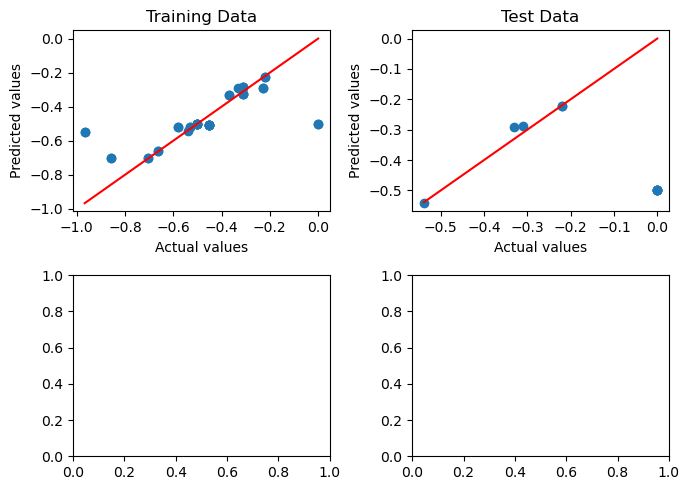

<Figure size 640x480 with 0 Axes>

[c] Epoch [1460/2000], Loss: 0.0236
Train R²:  0.50336
Test R² :  -2.90648


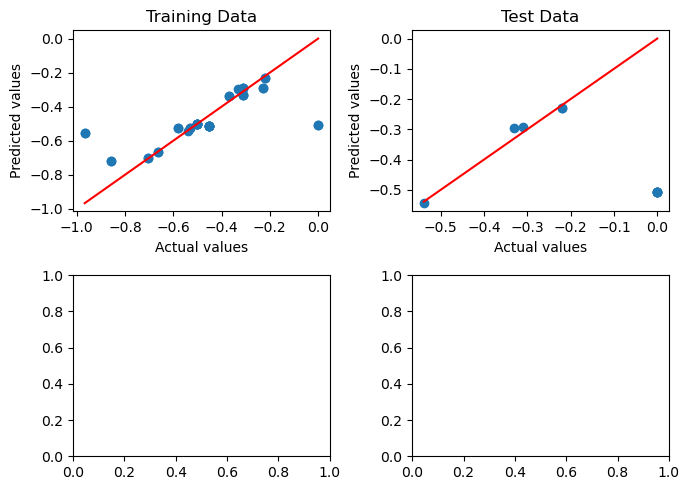

<Figure size 640x480 with 0 Axes>

[c] Epoch [1480/2000], Loss: 0.0234
Train R²:  0.50558
Test R² :  -2.87076


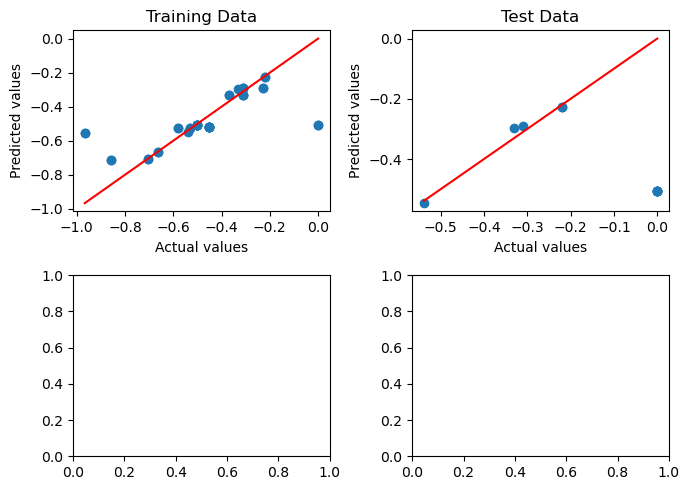

<Figure size 640x480 with 0 Axes>

[c] Epoch [1500/2000], Loss: 0.0234
Train R²:  0.50626
Test R² :  -2.70451


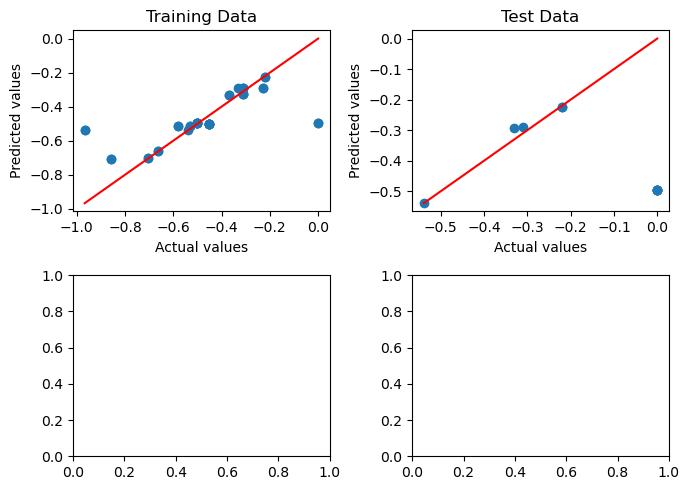

<Figure size 640x480 with 0 Axes>

[c] Epoch [1520/2000], Loss: 0.0235
Train R²:  0.50427
Test R² :  -2.62396


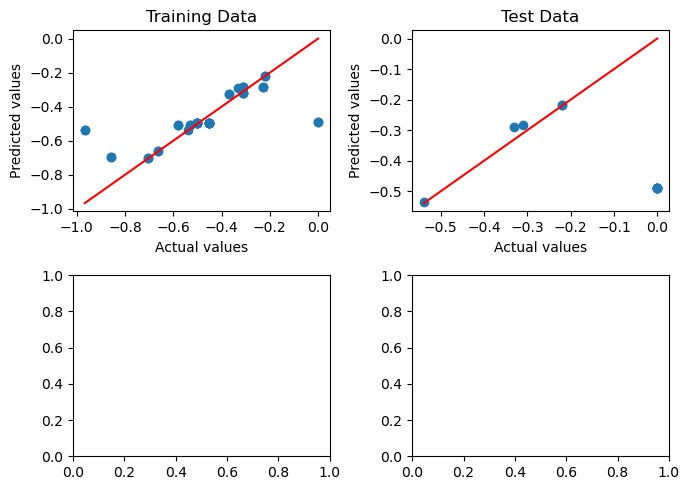

<Figure size 640x480 with 0 Axes>

[c] Epoch [1540/2000], Loss: 0.0233
Train R²:  0.50953
Test R² :  -2.75238


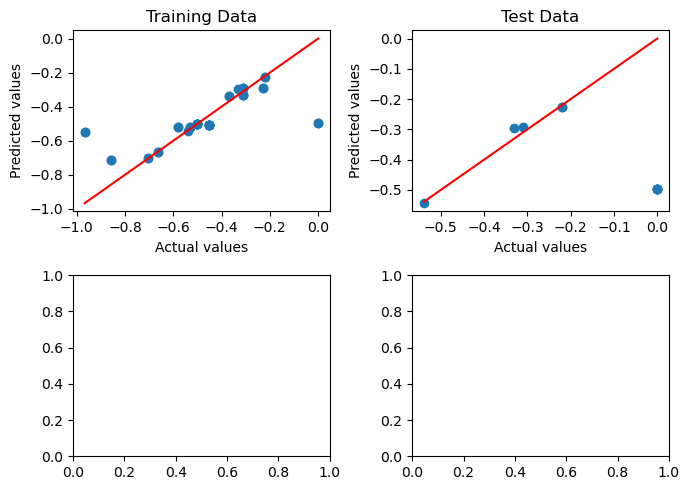

<Figure size 640x480 with 0 Axes>

[c] Epoch [1560/2000], Loss: 0.0232
Train R²:  0.51068
Test R² :  -2.74172


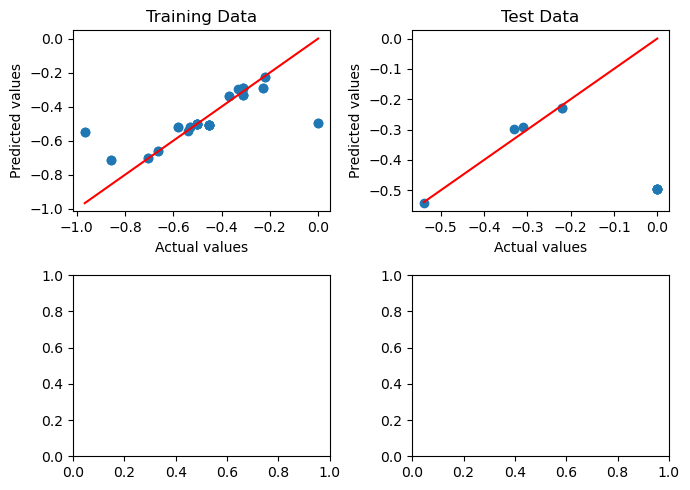

<Figure size 640x480 with 0 Axes>

[c] Epoch [1580/2000], Loss: 0.0231
Train R²:  0.51235
Test R² :  -2.61428


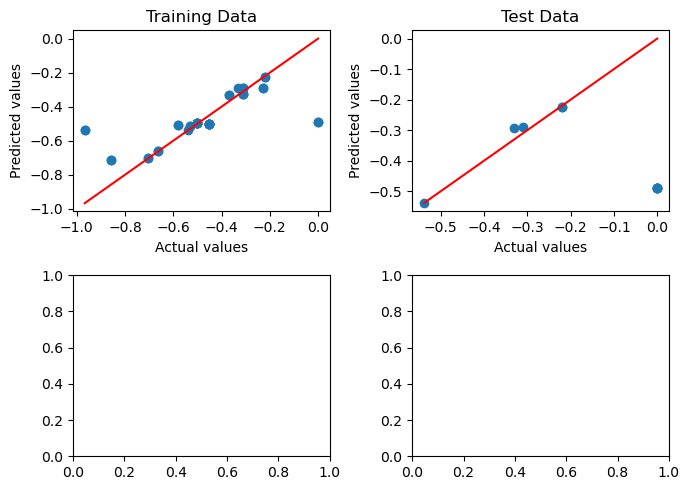

<Figure size 640x480 with 0 Axes>

[c] Epoch [1600/2000], Loss: 0.0230
Train R²:  0.51409
Test R² :  -2.73868


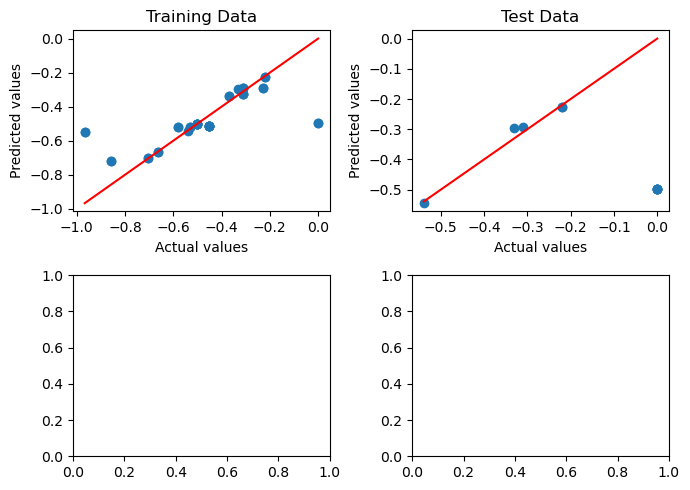

<Figure size 640x480 with 0 Axes>

[c] Epoch [1620/2000], Loss: 0.0230
Train R²:  0.51518
Test R² :  -2.69557


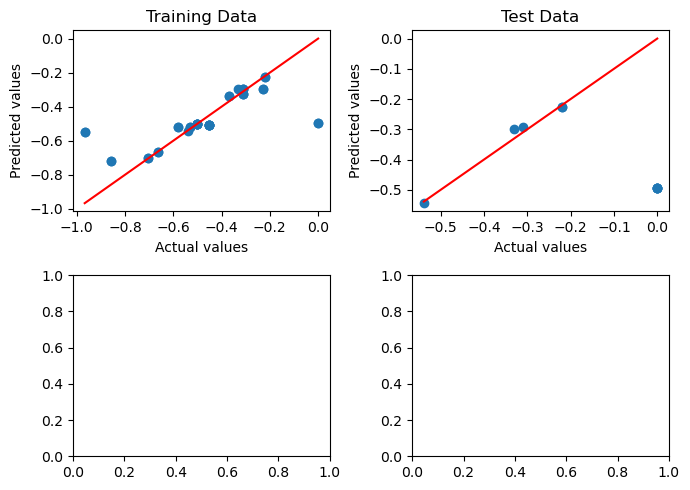

<Figure size 640x480 with 0 Axes>

[c] Epoch [1640/2000], Loss: 0.0229
Train R²:  0.51783
Test R² :  -2.71292


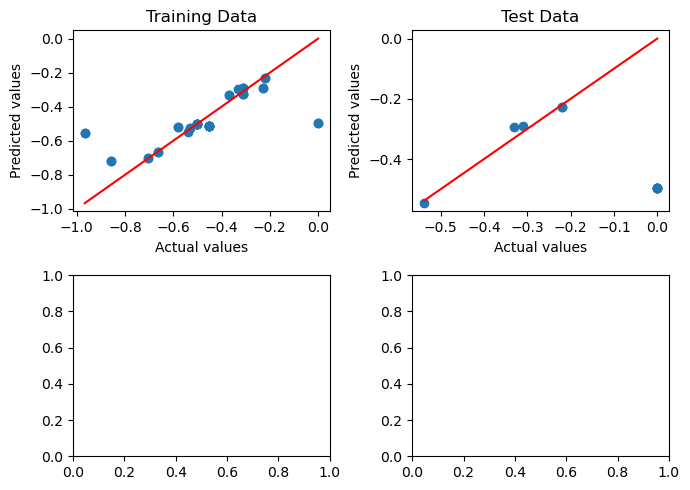

<Figure size 640x480 with 0 Axes>

[c] Epoch [1660/2000], Loss: 0.0228
Train R²:  0.52002
Test R² :  -2.58131


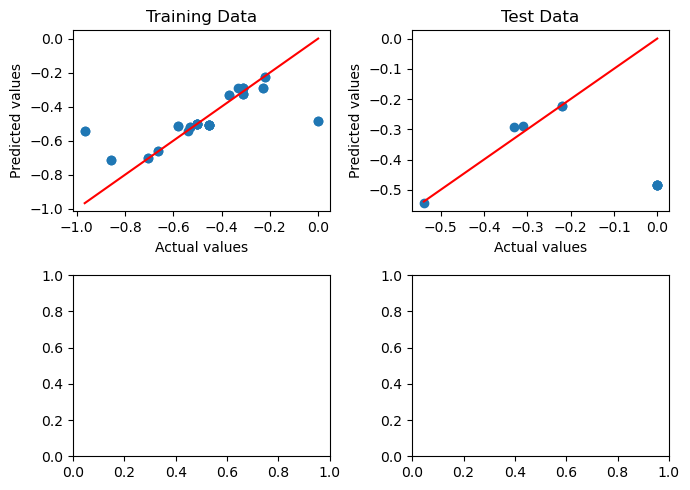

<Figure size 640x480 with 0 Axes>

[c] Epoch [1680/2000], Loss: 0.0228
Train R²:  0.51974
Test R² :  -2.60421


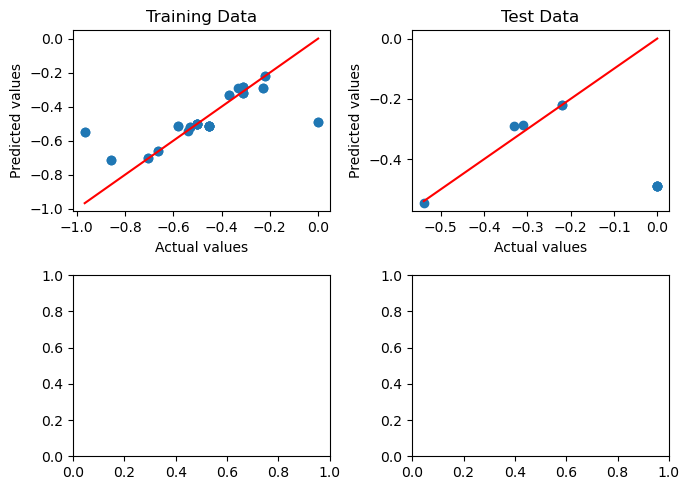

<Figure size 640x480 with 0 Axes>

[c] Epoch [1700/2000], Loss: 0.0227
Train R²:  0.52115
Test R² :  -2.51588


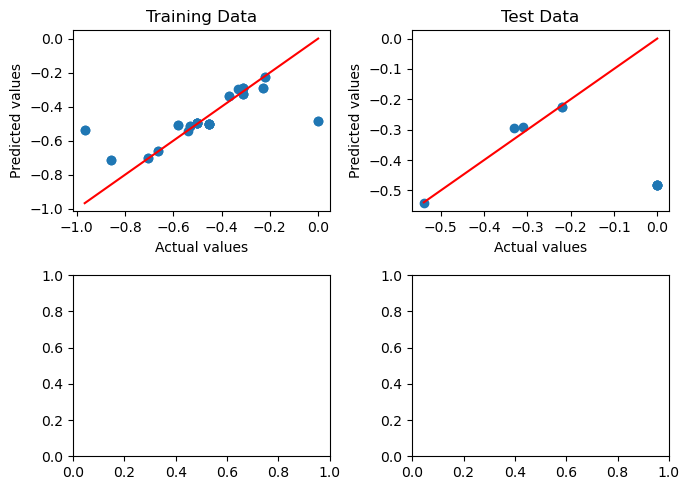

<Figure size 640x480 with 0 Axes>

[c] Epoch [1720/2000], Loss: 0.0226
Train R²:  0.52246
Test R² :  -2.59333


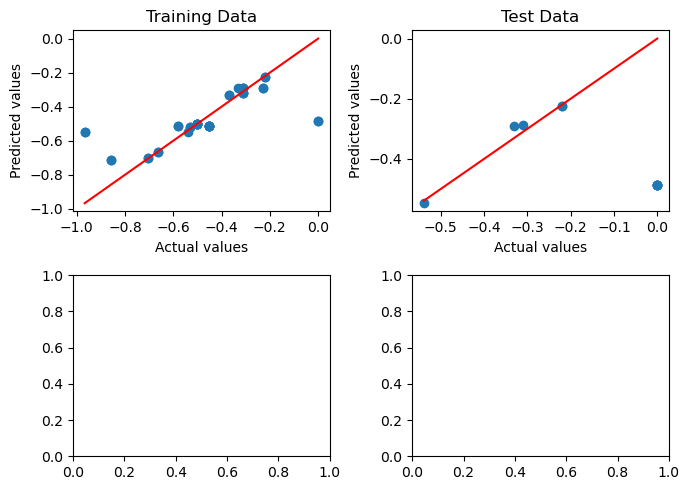

<Figure size 640x480 with 0 Axes>

[c] Epoch [1740/2000], Loss: 0.0226
Train R²:  0.52370
Test R² :  -2.63413


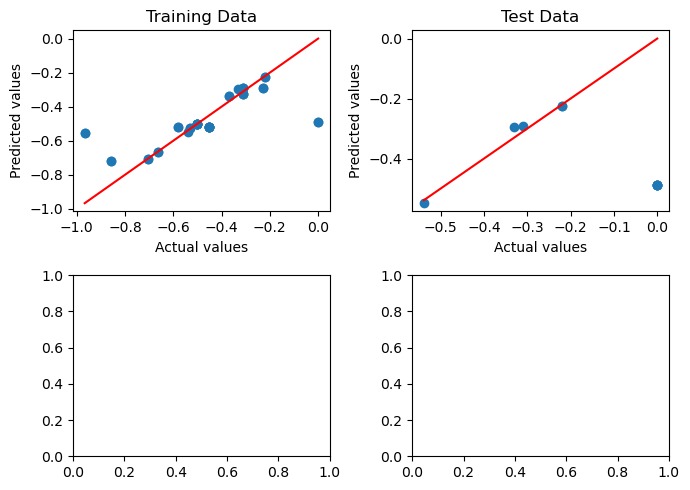

<Figure size 640x480 with 0 Axes>

[c] Epoch [1760/2000], Loss: 0.0226
Train R²:  0.52441
Test R² :  -2.57642


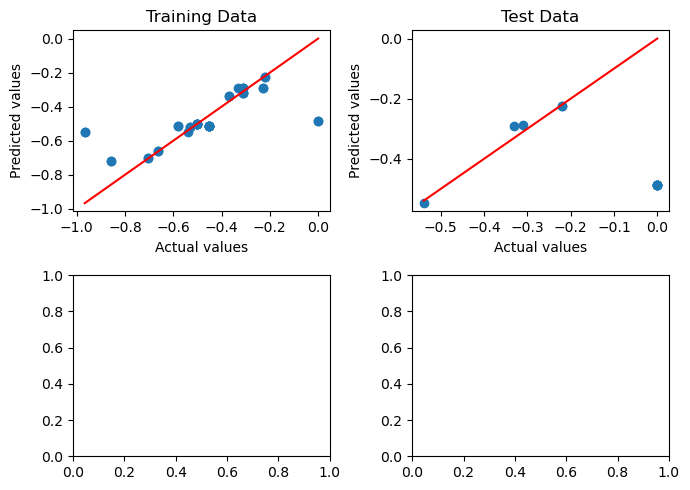

<Figure size 640x480 with 0 Axes>

[c] Epoch [1780/2000], Loss: 0.0223
Train R²:  0.52877
Test R² :  -2.42977


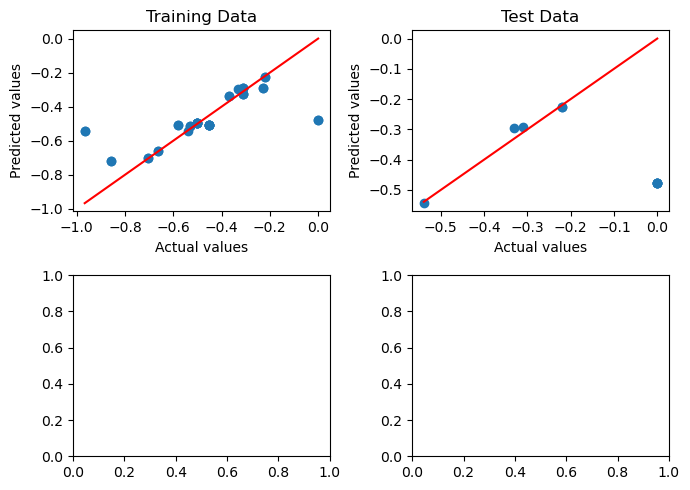

<Figure size 640x480 with 0 Axes>

[c] Epoch [1800/2000], Loss: 0.0223
Train R²:  0.53053
Test R² :  -2.35100


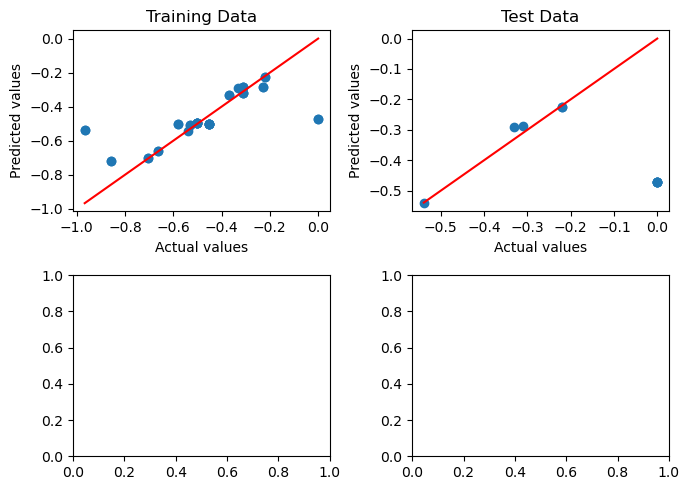

<Figure size 640x480 with 0 Axes>

[c] Epoch [1820/2000], Loss: 0.0222
Train R²:  0.53160
Test R² :  -2.54333


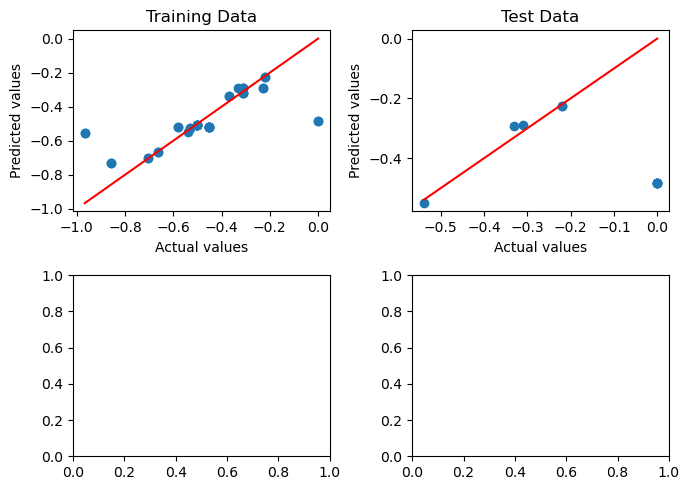

<Figure size 640x480 with 0 Axes>

[c] Epoch [1840/2000], Loss: 0.0222
Train R²:  0.53174
Test R² :  -2.50069


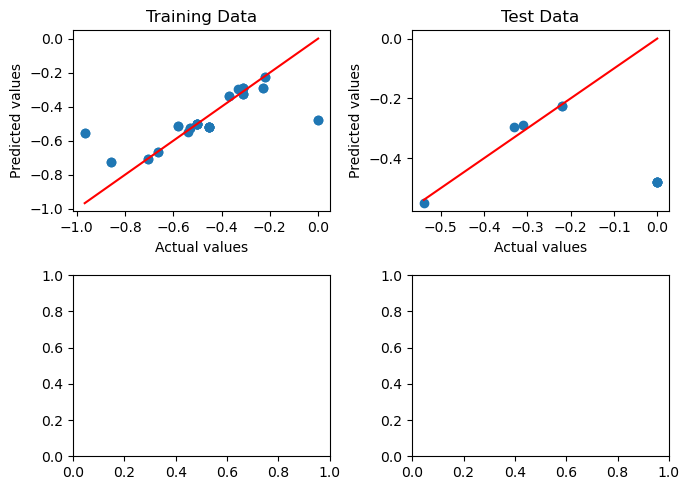

<Figure size 640x480 with 0 Axes>

[c] Epoch [1860/2000], Loss: 0.0222
Train R²:  0.53206
Test R² :  -2.60427


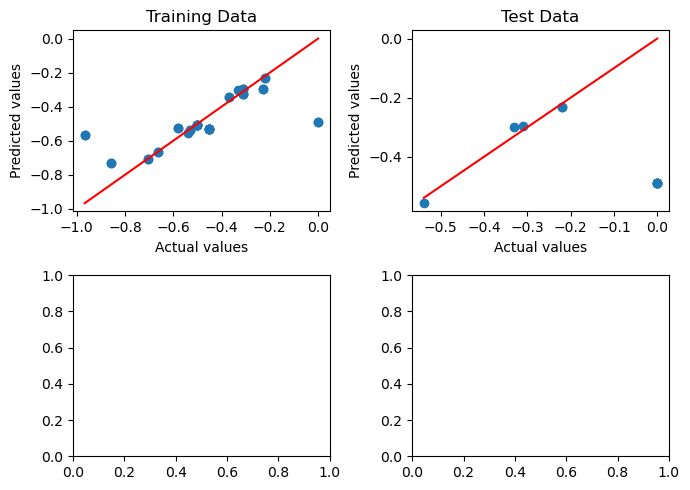

<Figure size 640x480 with 0 Axes>

[c] Epoch [1880/2000], Loss: 0.0220
Train R²:  0.53646
Test R² :  -2.32806


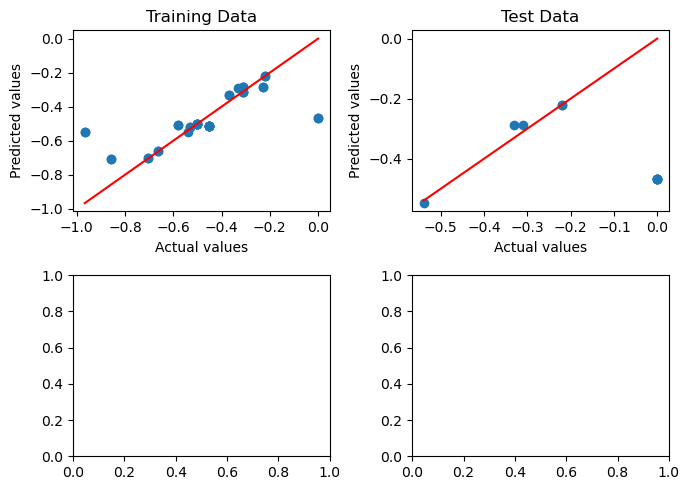

<Figure size 640x480 with 0 Axes>

[c] Epoch [1900/2000], Loss: 0.0216
Train R²:  0.54492
Test R² :  -2.22893


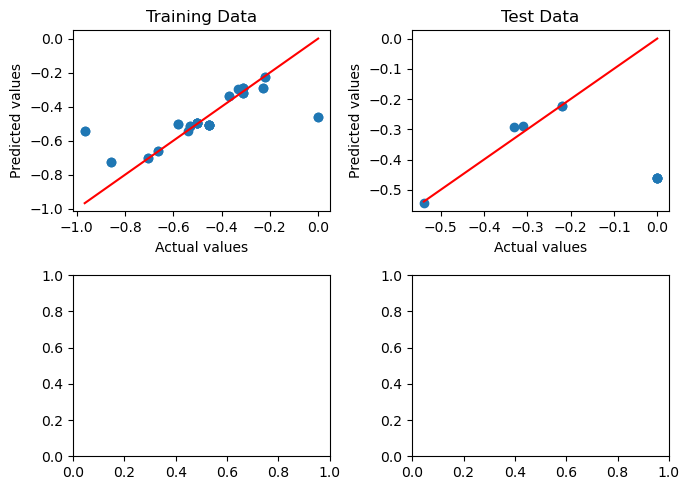

<Figure size 640x480 with 0 Axes>

[c] Epoch [1920/2000], Loss: 0.0214
Train R²:  0.54913
Test R² :  -2.16958


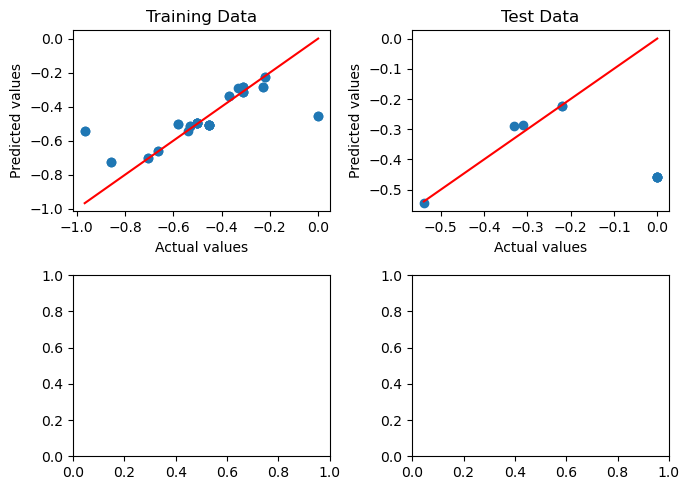

<Figure size 640x480 with 0 Axes>

[c] Epoch [1940/2000], Loss: 0.0212
Train R²:  0.55268
Test R² :  -2.20565


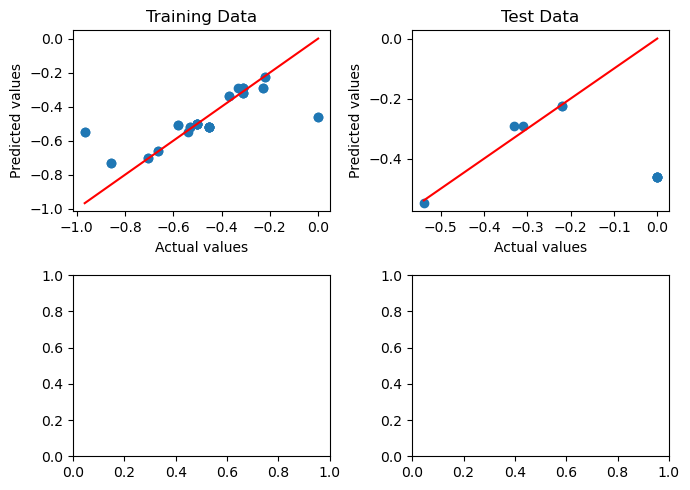

<Figure size 640x480 with 0 Axes>

[c] Epoch [1960/2000], Loss: 0.0211
Train R²:  0.55427
Test R² :  -2.12510


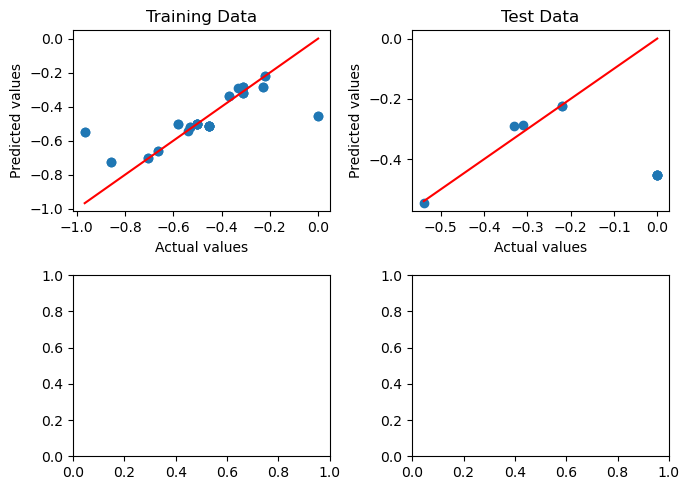

<Figure size 640x480 with 0 Axes>

[c] Epoch [1980/2000], Loss: 0.0212
Train R²:  0.55399
Test R² :  -2.22225


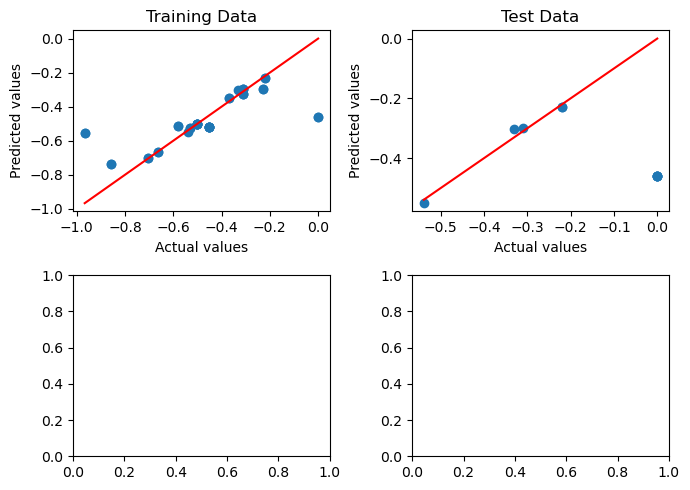

<Figure size 640x480 with 0 Axes>

[c] Epoch [2000/2000], Loss: 0.0214
Train R²:  0.54849
Test R² :  -1.95520


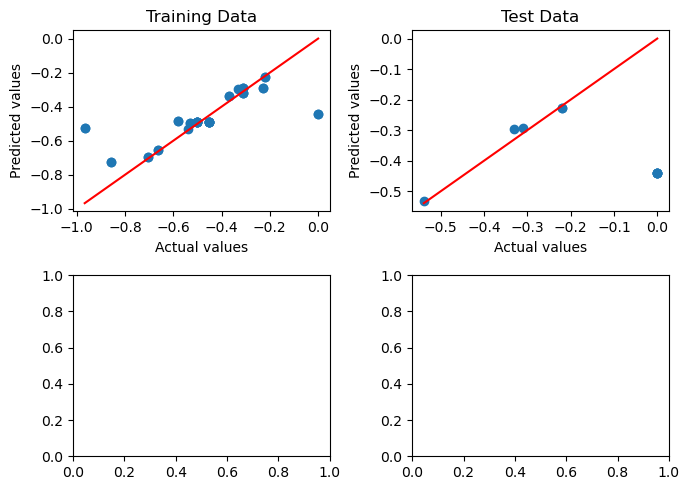

<Figure size 640x480 with 0 Axes>

In [11]:
GBR_NN(7)

---

# Pure DNN Model

### Auto Function

In [5]:
def DNN(variable):
    name_list = ["Sigmaf", "b", "Epsilonf", "c"]
    
    # 1. Prepare the data
    df_x = pd.read_excel(root,usecols=[0,1,2,3])
    df_y = pd.read_excel(root,usecols=[variable])
    
    X_train, X_test, y_train, y_test = train_test_split(df_x, df_y, test_size = 0.2, random_state = 42)
    
    y_train = np.array(y_train,dtype = np.float32).ravel()
    y_test = np.array(y_test,dtype = np.float32).ravel()
    
    X_train = np.array(X_train)
    X_test = np.array(X_test)
    
    # Convert data to PyTorch tensors
    X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
    y_train_tensor = torch.tensor(y_train, dtype=torch.float32).unsqueeze(1)
    X_test_tensor = torch.tensor(X_test, dtype=torch.float32)
    y_test_tensor = torch.tensor(y_test, dtype=torch.float32).unsqueeze(1)
    
    class RegressionNN(nn.Module):
        def __init__(self, input_size):
            super(RegressionNN, self).__init__()
            self.fc1 = nn.Linear(input_size, 64)
            self.fc2 = nn.Linear(64, 128)
            self.fc3 = nn.Linear(128, 256)
            self.fc4 = nn.Linear(256, 128)
            self.fc5 = nn.Linear(128, 64)
            self.fc6 = nn.Linear(64, 1)
       
        def forward(self, x):
            x = torch.relu(self.fc1(x))
            x = torch.relu(self.fc2(x))
            x = torch.relu(self.fc3(x))
            x = torch.relu(self.fc4(x))
            x = torch.relu(self.fc5(x))
            x = self.fc6(x)
            return x
    
    # Create the neural network
    input_size = X_train.shape[1]
    model = RegressionNN(input_size)
    
    # 4. Define loss function and optimizer
    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=0.0001)

    # Regularization parameters
    lambda_l1 = 0   # L1 penalty strength
    lambda_l2 = 0   # L2 penalty strength

    # L2 can also be directly included in the optimizer as weight_decay
    optimizer = optim.Adam(model.parameters(), lr=0.0001, weight_decay=lambda_l2)
    
    plt.ion()
    
    # 5. Train the Neural Network
    n_epochs = 2000 # Default 1000
    for epoch in range(n_epochs):
        model.train()
       
        # Forward pass
        y_train_pred = model(X_train_tensor)
        y_test_pred  = model(X_test_tensor)
        loss = criterion(y_train_pred, y_train_tensor)

        # Add L1 Regularization
        l1_norm = sum(param.abs().sum() for param in model.parameters())
        loss += lambda_l1 * l1_norm
       
        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        r2_train = r2_score(y_train_tensor.data.numpy(), y_train_pred.detach().numpy())
        r2_test  = r2_score(y_test_tensor.data.numpy(), y_test_pred.detach().numpy())

        if (epoch+1) % 20 == 0:
            print(f'[{name_list[variable-4]}] Epoch [{epoch+1}/{n_epochs}], Loss: {loss.item():.4f}')
            print("Train R²: ", "%.5f" % round(r2_train, 5))
            print("Test R² : ", "%.5f" % round(r2_test, 5))

            fig, axes = plt.subplots(2, 2, figsize = (7,5))
            axes[0, 0].scatter(y_train_tensor, y_train_pred.detach().numpy())
            axes[0, 0].plot([min(y_train_tensor.data.numpy()), max(y_train_tensor.data.numpy())],[min(y_train_tensor.data.numpy()), max(y_train_tensor.data.numpy())], color = 'r')
            axes[0, 0].set_title("Training Data")
            axes[0, 0].set_xlabel("Actual values")
            axes[0, 0].set_ylabel("Predicted values")
    
            axes[0, 1].scatter(y_test_tensor, y_test_pred.detach().numpy())
            axes[0, 1].plot([min(y_test_tensor.data.numpy()), max(y_test_tensor.data.numpy())],[min(y_test_tensor.data.numpy()), max(y_test_tensor.data.numpy())], color = 'r')
            axes[0, 1].set_title("Test Data")
            axes[0, 1].set_xlabel("Actual values")
            axes[0, 1].set_ylabel("Predicted values")
    
            # axes[1, 0].plot(y_train_tensor.data.numpy().squeeze()*10,'tab:orange', label = 'real')
            # axes[1, 0].plot(y_train_pred.detach().numpy()*10,'tab:green',label = 'pred')
            # axes[1, 0].set_xlabel("Sample Number")
            # axes[1, 0].set_ylabel("Fatigue Constant Value")
            # axes[1, 0].legend()
    
            # axes[1, 1].plot(y_test_tensor.data.numpy().squeeze()*10, 'tab:orange',label = 'real')
            # axes[1, 1].plot(y_test_pred.detach().numpy()*10,'tab:green',label = 'pred')
            # axes[1, 1].set_xlabel("Sample Number")
            # axes[1, 1].set_ylabel("Fatigue Constant Value")
            # axes[1, 1].legend()

            plt.tight_layout()
    
            plt.draw();plt.pause(0.05)
    
    plt.ioff()
    plt.show()

In [ ]:
def DNN(variable, test_s, rand_s):
    # 1. Prepare the data
    df_x = pd.read_excel(root,usecols=[0,1,2,3])
    df_y = pd.read_excel(root,usecols=[variable])
    
    X_train, X_test, y_train, y_test = train_test_split(df_x, df_y, test_size = test_s, random_state = rand_s)
    
    y_train = np.array(y_train,dtype = np.float32).ravel()
    y_test = np.array(y_test,dtype = np.float32).ravel()
    
    X_train = np.array(X_train)
    X_test = np.array(X_test)
    
    # Convert data to PyTorch tensors
    X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
    y_train_tensor = torch.tensor(y_train, dtype=torch.float32).unsqueeze(1)
    X_test_tensor = torch.tensor(X_test, dtype=torch.float32)
    y_test_tensor = torch.tensor(y_test, dtype=torch.float32).unsqueeze(1)
    
    class RegressionNN(nn.Module):
        def __init__(self, input_size):
            super(RegressionNN, self).__init__()
            self.fc1 = nn.Linear(input_size, 64)
            self.fc2 = nn.Linear(64, 128)
            self.fc3 = nn.Linear(128, 256)
            self.fc4 = nn.Linear(256, 128)
            self.fc5 = nn.Linear(128, 64)
            self.fc6 = nn.Linear(64, 1)
       
        def forward(self, x):
            x = torch.relu(self.fc1(x))
            x = torch.relu(self.fc2(x))
            x = torch.relu(self.fc3(x))
            x = torch.relu(self.fc4(x))
            x = torch.relu(self.fc5(x))
            x = self.fc6(x)
            return x
    
    # Create the neural network
    input_size = X_train.shape[1]
    model = RegressionNN(input_size)
    
    # 4. Define loss function and optimizer
    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=0.0001)
    
    plt.ion()
    
    # 5. Train the Neural Network
    n_epochs = 2000 # Default 1000
    for epoch in range(n_epochs):
        model.train()
       
        # Forward pass
        y_train_pred = model(X_train_tensor)
        y_test_pred  = model(X_test_tensor)
        loss = criterion(y_train_pred, y_train_tensor)
       
        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        var_train = r2_score(y_train_tensor.data.numpy(), y_train_pred.detach().numpy())
        var_test  = r2_score(y_test_tensor.data.numpy(), y_test_pred.detach().numpy())
       
        if (epoch+1) % 20 == 0: # Default 10
            print(f'Epoch [{epoch+1}/{n_epochs}], Loss: {loss.item():.4f}')
            print("Train R^2: ", var_train)
            print("Test  R^2: ", var_test)
    
            fig, axes = plt.subplots(2, 2, figsize = (7, 7))
            axes[0, 0].scatter(y_train_tensor, y_train_pred.detach().numpy())
            axes[0, 0].plot([min(y_train_tensor.data.numpy()), max(y_train_tensor.data.numpy())],[min(y_train_tensor.data.numpy()), max(y_train_tensor.data.numpy())], color = 'r')
            axes[0, 0].set_title("Training Data")
            axes[0, 0].set_xlabel("Actual values")
            axes[0, 0].set_ylabel("Predicted values")
    
            axes[0, 1].scatter(y_test_tensor, y_test_pred.detach().numpy())
            axes[0, 1].plot([min(y_test_tensor.data.numpy()), max(y_test_tensor.data.numpy())],[min(y_test_tensor.data.numpy()), max(y_test_tensor.data.numpy())], color = 'r')
            axes[0, 1].set_title("Test Data")
            axes[0, 1].set_xlabel("Actual values")
            axes[0, 1].set_ylabel("Predicted values")
    
            axes[1, 0].plot(y_train_tensor.data.numpy().squeeze()*10,'tab:orange', label = 'real')
            axes[1, 0].plot(y_train_pred.detach().numpy()*10,'tab:green',label = 'pred')
    
            axes[1, 1].plot(y_test_tensor.data.numpy().squeeze()*10, 'tab:orange',label = 'real')
            axes[1, 1].plot(y_test_pred.detach().numpy()*10,'tab:green',label = 'pred')
    
            plt.draw();plt.pause(0.05)
    
    plt.ioff()
    plt.show()
    
    # 6. Evaluate the model on the test data
    model.eval()
    with torch.no_grad():
        test_predictions = model(X_test_tensor)
        test_loss = mean_squared_error(y_test_tensor.numpy(), test_predictions.numpy())
        print(f'Test MSE: {test_loss:.4f}')

## Variable Testing

[Sigmaf] Epoch [20/2000], Loss: 2061961.7500
Train R²:  -0.74572
Test R² :  -1.16573


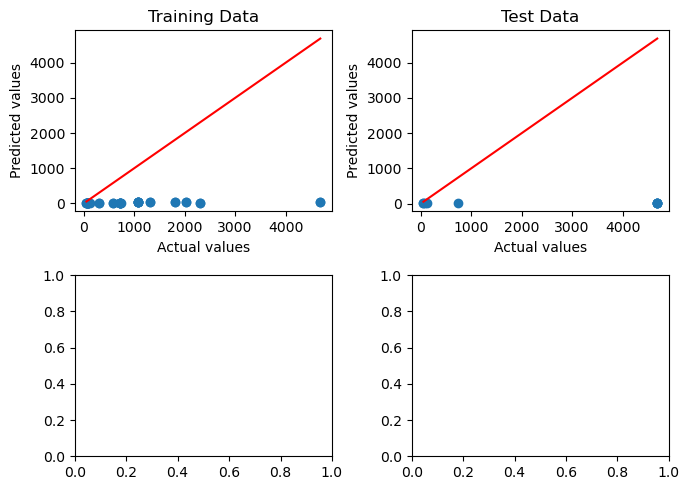

[Sigmaf] Epoch [40/2000], Loss: 1995365.6250
Train R²:  -0.68934
Test R² :  -1.12915


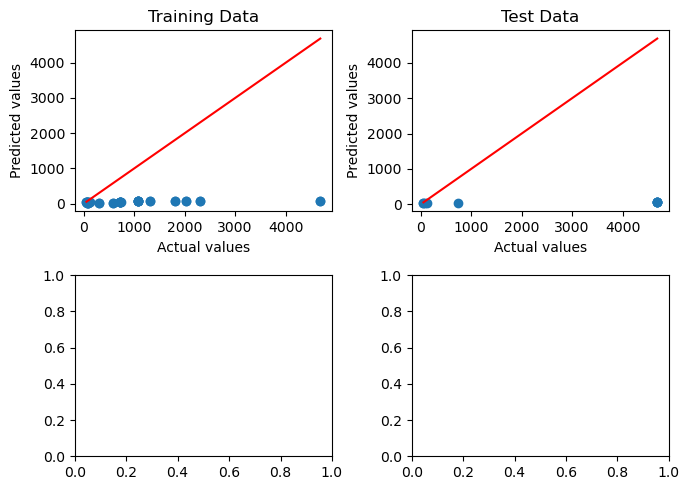

[Sigmaf] Epoch [60/2000], Loss: 1842255.0000
Train R²:  -0.55971
Test R² :  -1.04274


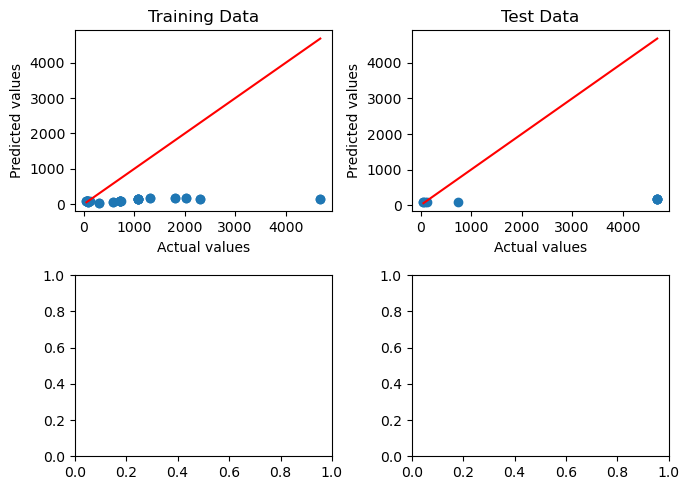

[Sigmaf] Epoch [80/2000], Loss: 1516811.7500
Train R²:  -0.28418
Test R² :  -0.84497


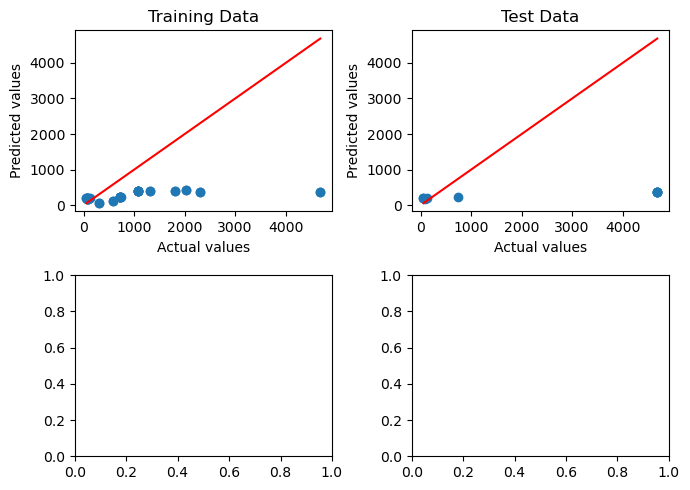

[Sigmaf] Epoch [100/2000], Loss: 1014834.8125
Train R²:  0.14081
Test R² :  -0.46775


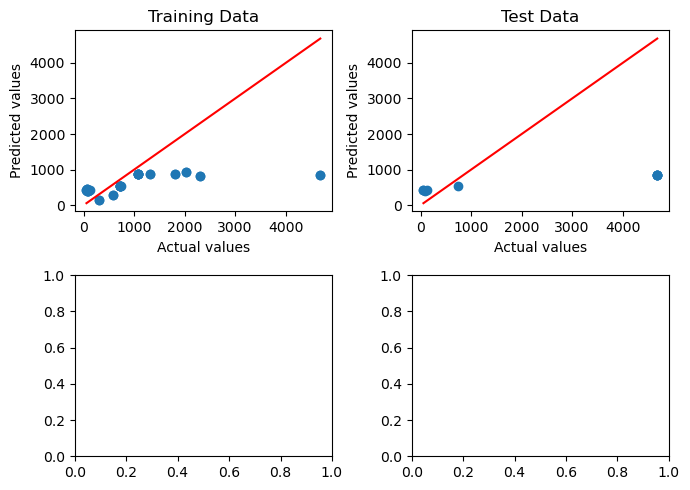

[Sigmaf] Epoch [120/2000], Loss: 733118.5000
Train R²:  0.37932
Test R² :  -0.02847


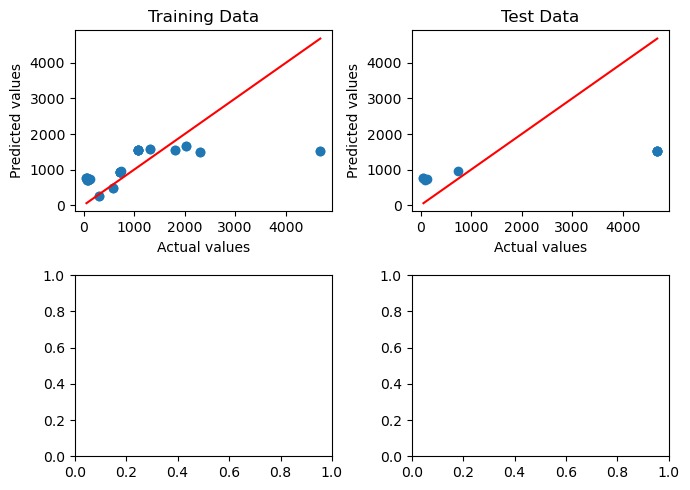

[Sigmaf] Epoch [140/2000], Loss: 723804.8125
Train R²:  0.38720
Test R² :  0.03617


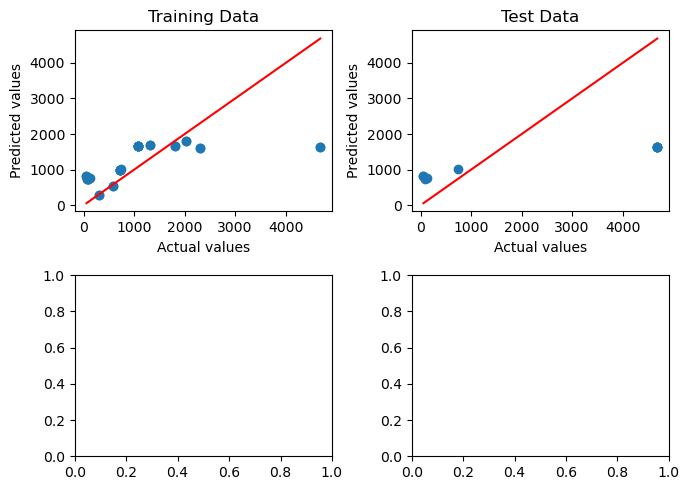

[Sigmaf] Epoch [160/2000], Loss: 709852.6250
Train R²:  0.39902
Test R² :  -0.00999


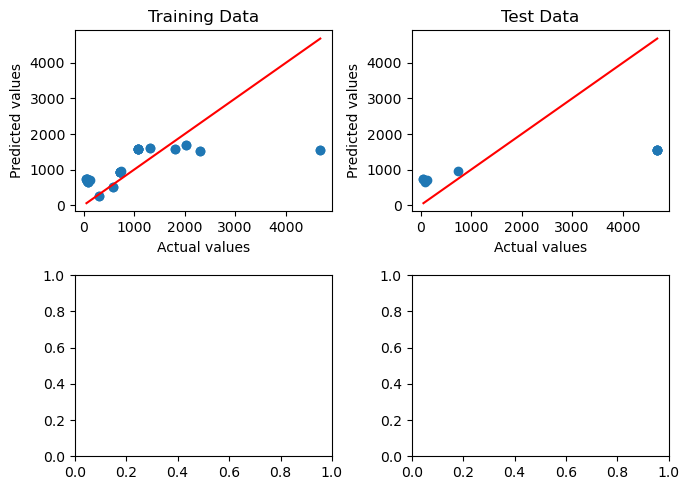

[Sigmaf] Epoch [180/2000], Loss: 697407.8125
Train R²:  0.40955
Test R² :  0.01757


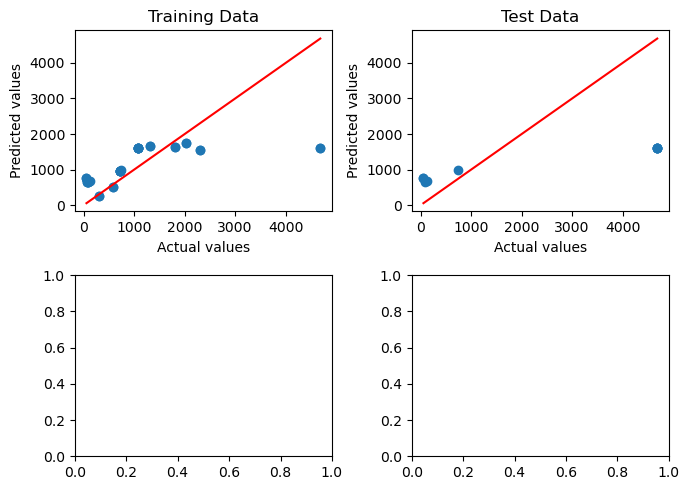

[Sigmaf] Epoch [200/2000], Loss: 685088.5000
Train R²:  0.41998
Test R² :  0.02674


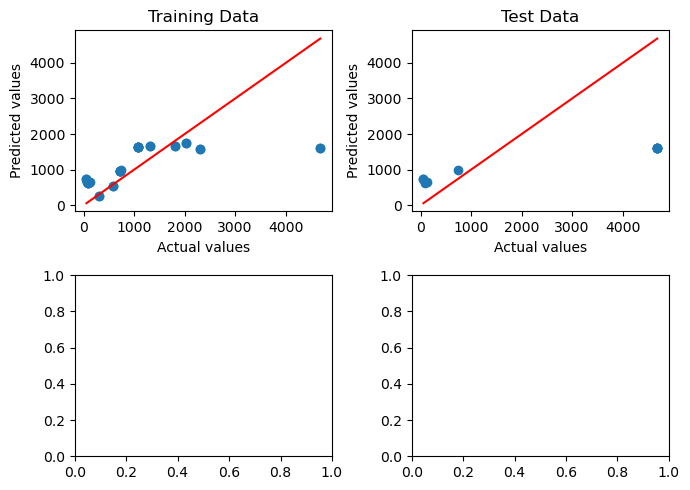

[Sigmaf] Epoch [220/2000], Loss: 672476.5000
Train R²:  0.43066
Test R² :  0.03629


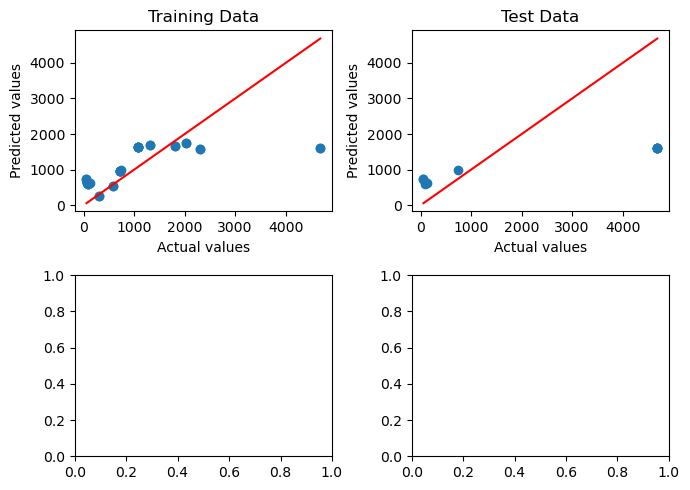

[Sigmaf] Epoch [240/2000], Loss: 659527.0000
Train R²:  0.44162
Test R² :  0.04821


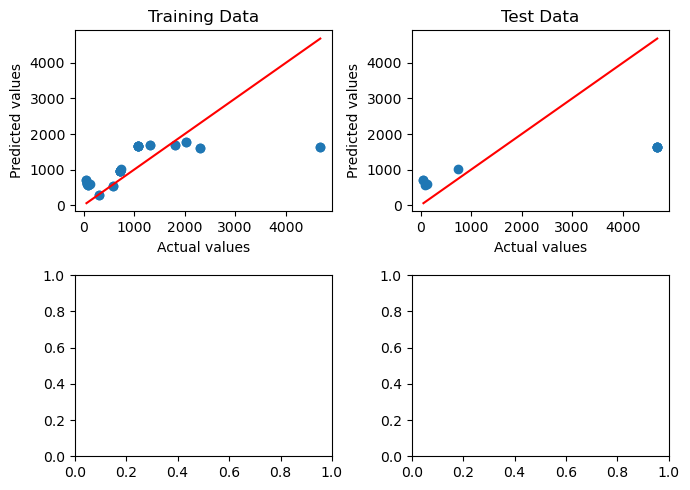

[Sigmaf] Epoch [260/2000], Loss: 646311.3750
Train R²:  0.45281
Test R² :  0.05928


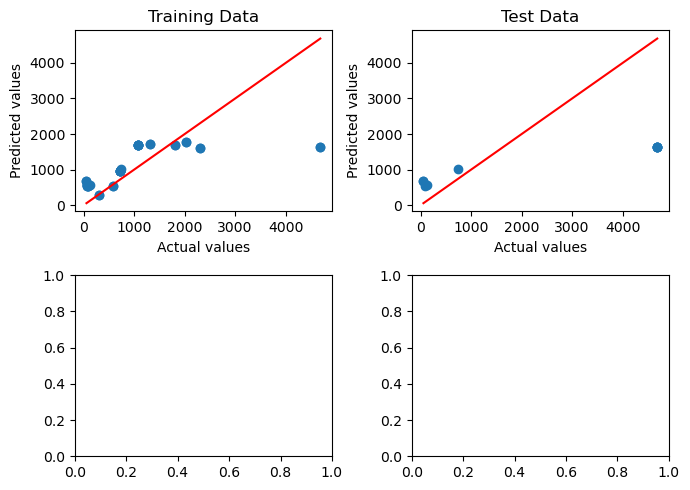

[Sigmaf] Epoch [280/2000], Loss: 632918.3750
Train R²:  0.46415
Test R² :  0.07117


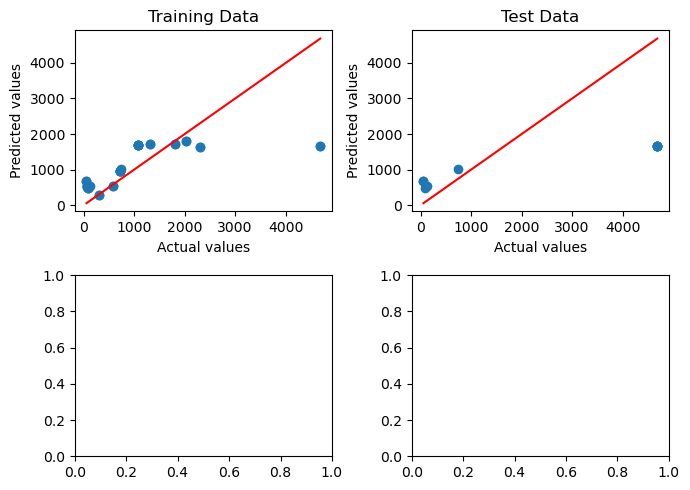

[Sigmaf] Epoch [300/2000], Loss: 619512.5625
Train R²:  0.47550
Test R² :  0.08284


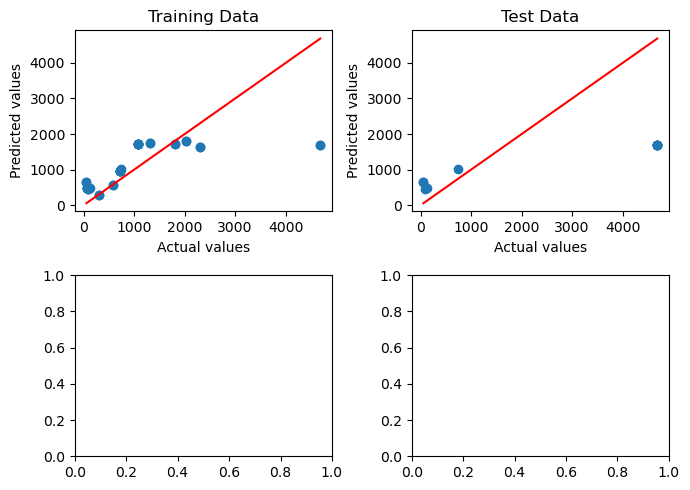

[Sigmaf] Epoch [320/2000], Loss: 606440.6250
Train R²:  0.48657
Test R² :  0.09546


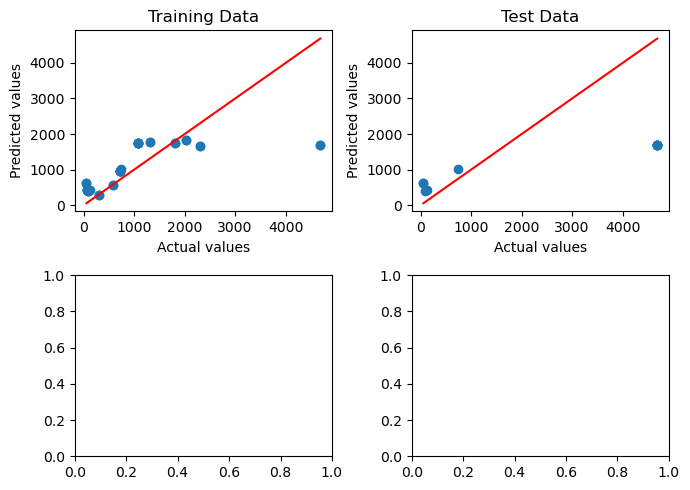

[Sigmaf] Epoch [340/2000], Loss: 594116.3750
Train R²:  0.49700
Test R² :  0.10760


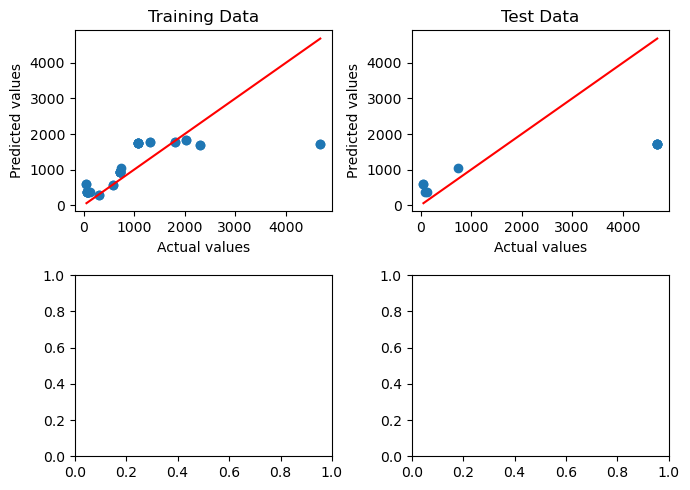

[Sigmaf] Epoch [360/2000], Loss: 582531.7500
Train R²:  0.50681
Test R² :  0.11990


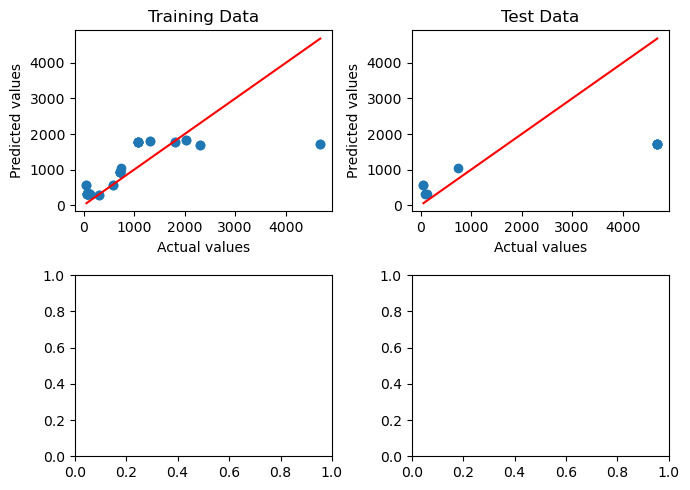

[Sigmaf] Epoch [380/2000], Loss: 572158.6875
Train R²:  0.51559
Test R² :  0.13280


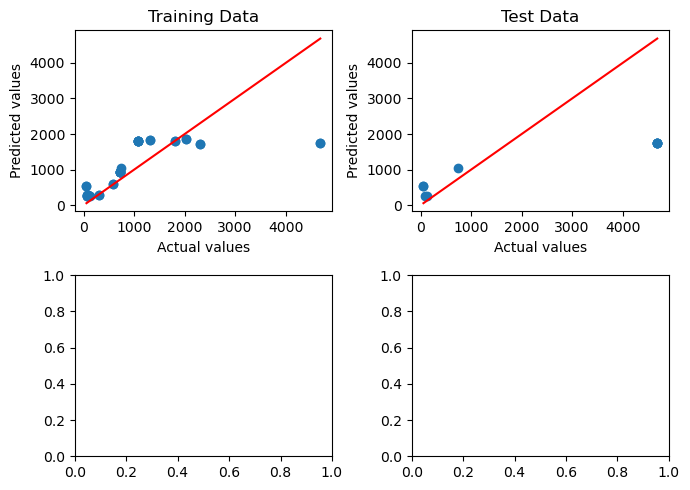

[Sigmaf] Epoch [400/2000], Loss: 563555.6250
Train R²:  0.52288
Test R² :  0.14479


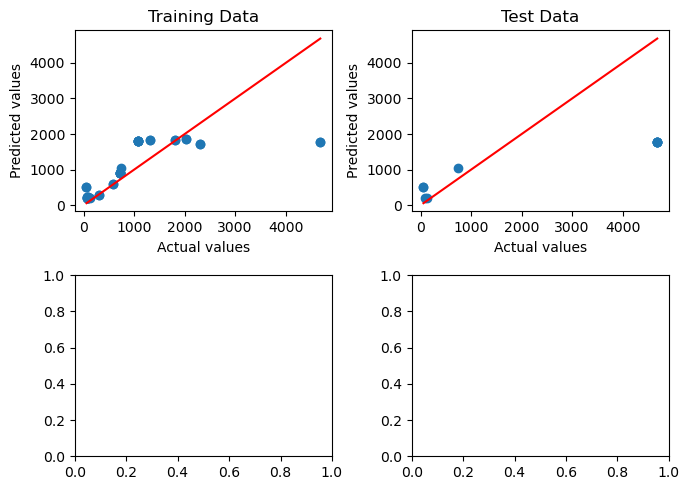

[Sigmaf] Epoch [420/2000], Loss: 556897.5000
Train R²:  0.52851
Test R² :  0.15312


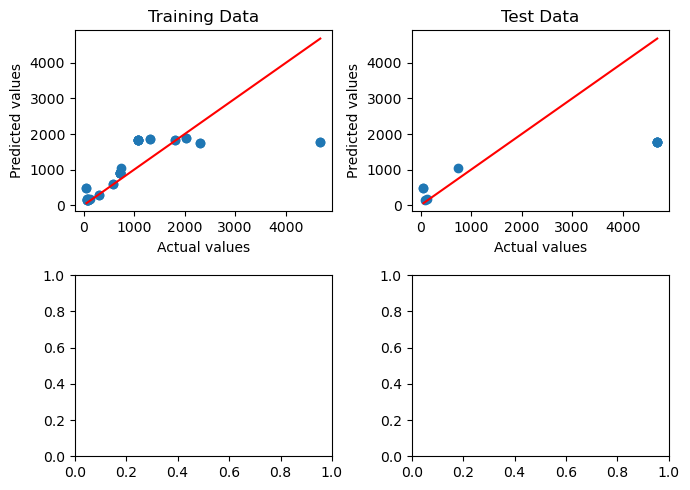

[Sigmaf] Epoch [440/2000], Loss: 551755.6875
Train R²:  0.53287
Test R² :  0.16555


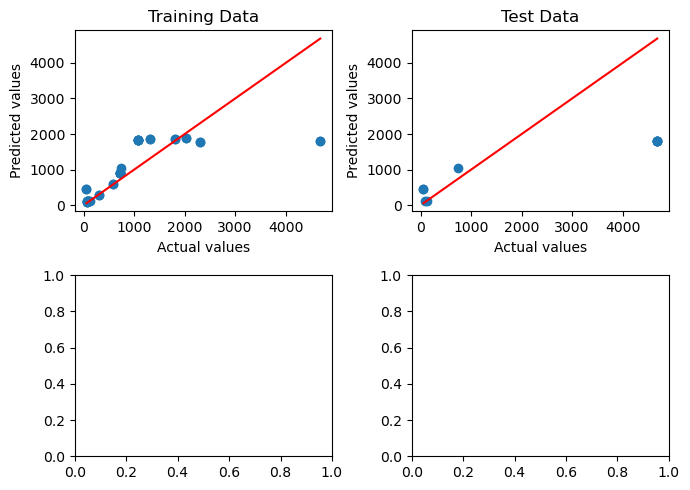

[Sigmaf] Epoch [460/2000], Loss: 547851.6250
Train R²:  0.53617
Test R² :  0.17276


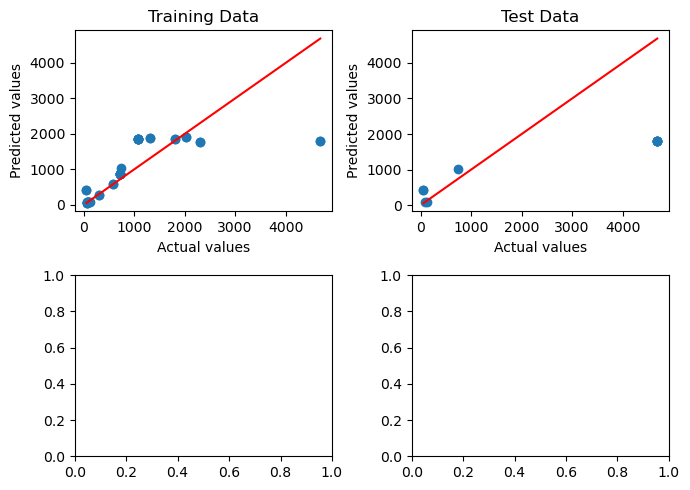

[Sigmaf] Epoch [480/2000], Loss: 544552.6875
Train R²:  0.53897
Test R² :  0.17905


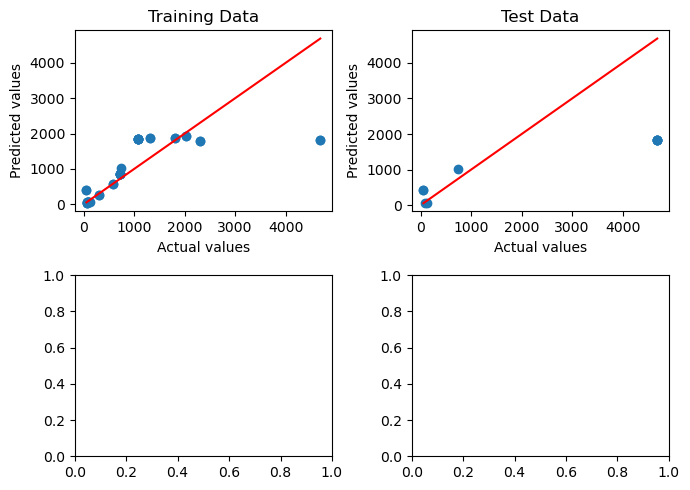

[Sigmaf] Epoch [500/2000], Loss: 541083.8750
Train R²:  0.54190
Test R² :  0.18578


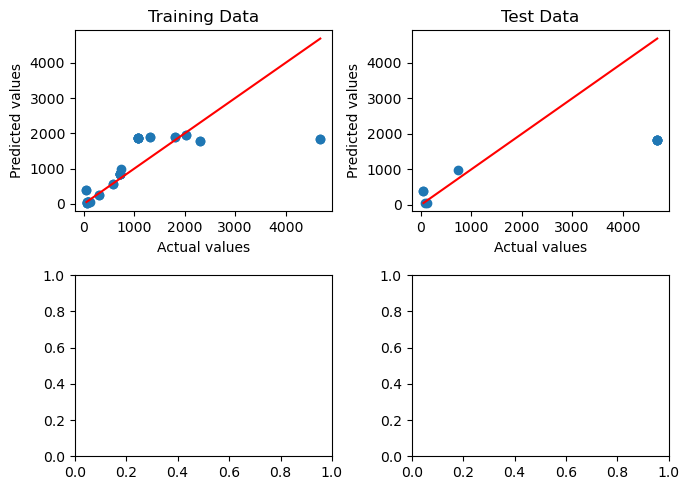

[Sigmaf] Epoch [520/2000], Loss: 537345.4375
Train R²:  0.54507
Test R² :  0.19042


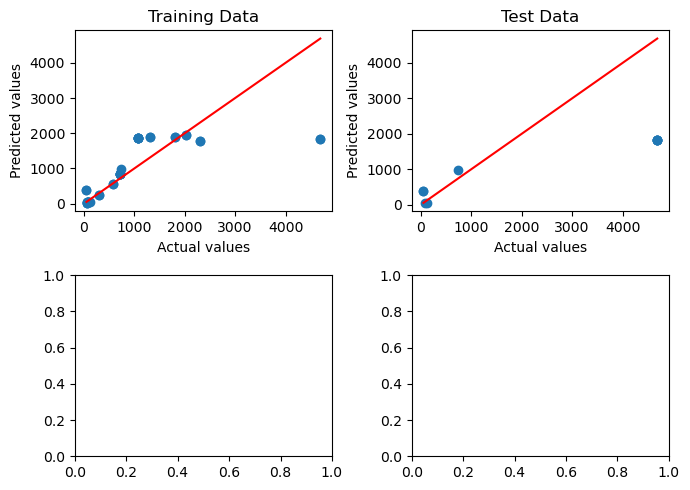

[Sigmaf] Epoch [540/2000], Loss: 533331.3750
Train R²:  0.54847
Test R² :  0.19907


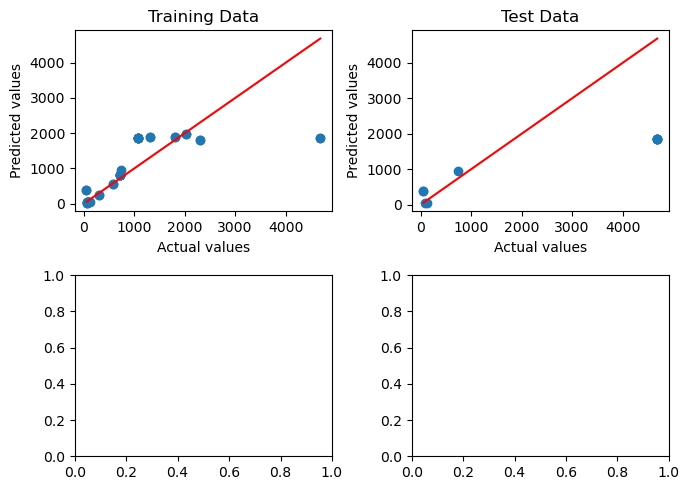

[Sigmaf] Epoch [560/2000], Loss: 528847.5625
Train R²:  0.55226
Test R² :  0.20625


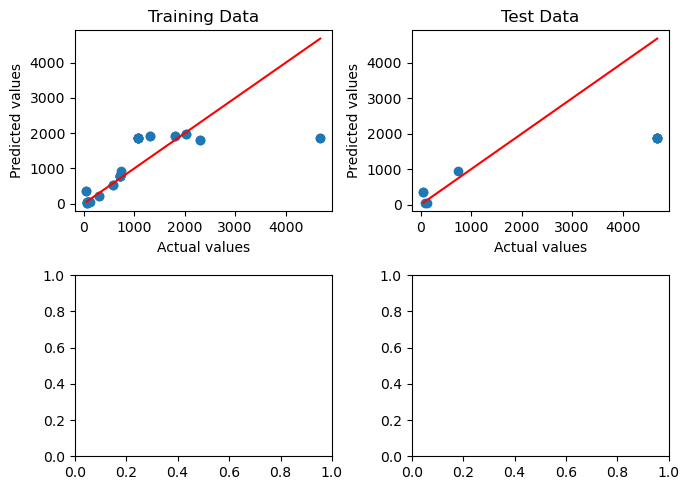

[Sigmaf] Epoch [580/2000], Loss: 523343.8438
Train R²:  0.55692
Test R² :  0.21449


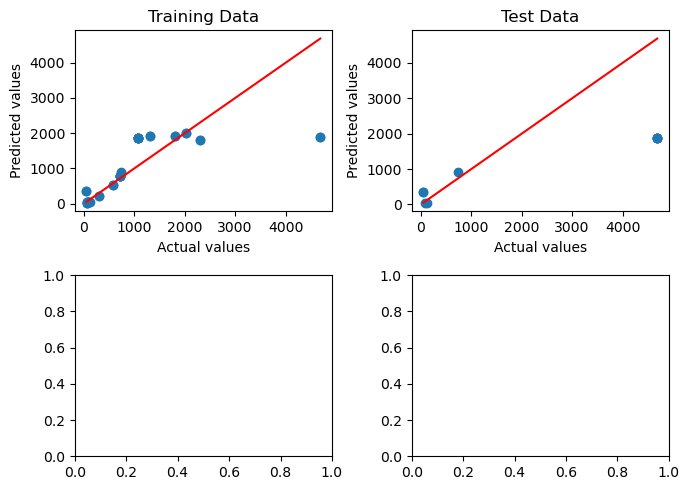

[Sigmaf] Epoch [600/2000], Loss: 516444.6562
Train R²:  0.56276
Test R² :  0.22693


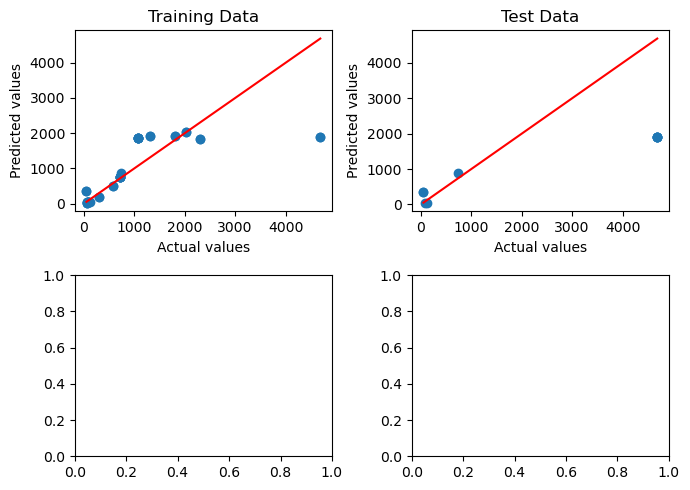

[Sigmaf] Epoch [620/2000], Loss: 509565.0625
Train R²:  0.56859
Test R² :  0.23830


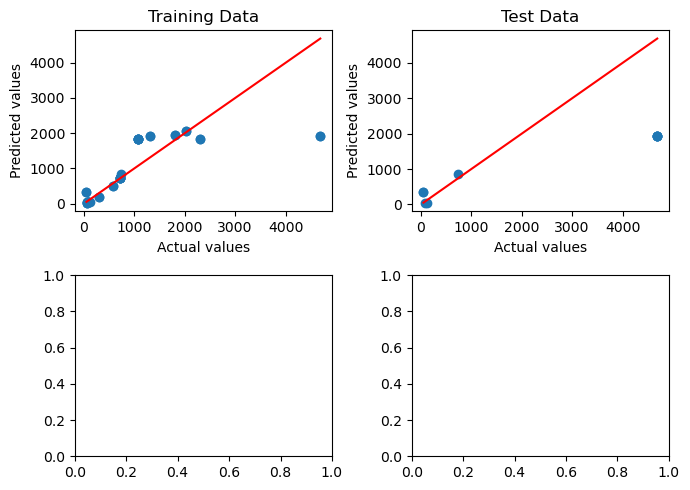

[Sigmaf] Epoch [640/2000], Loss: 501681.1562
Train R²:  0.57526
Test R² :  0.25202


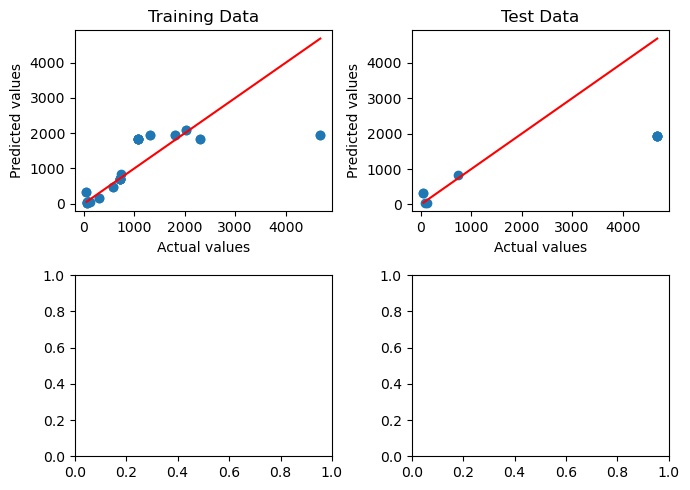

[Sigmaf] Epoch [660/2000], Loss: 492510.8438
Train R²:  0.58303
Test R² :  0.26658


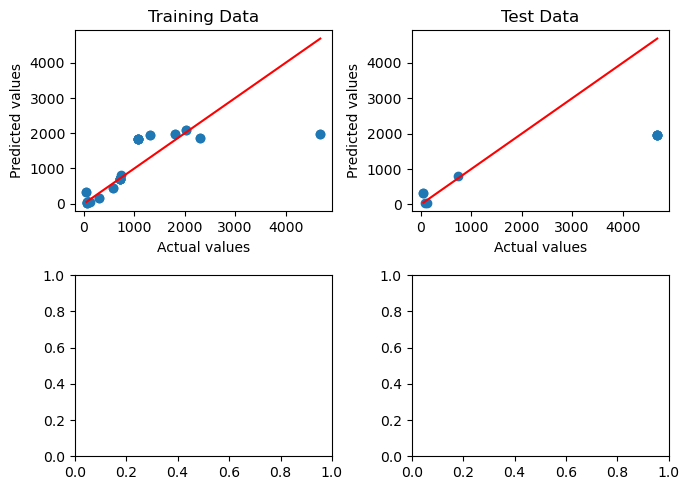

[Sigmaf] Epoch [680/2000], Loss: 481422.1562
Train R²:  0.59241
Test R² :  0.27850


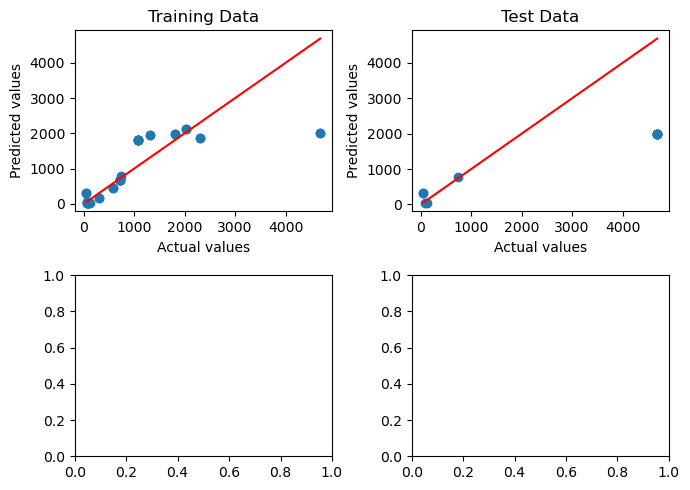

[Sigmaf] Epoch [700/2000], Loss: 468376.8125
Train R²:  0.60346
Test R² :  0.29889


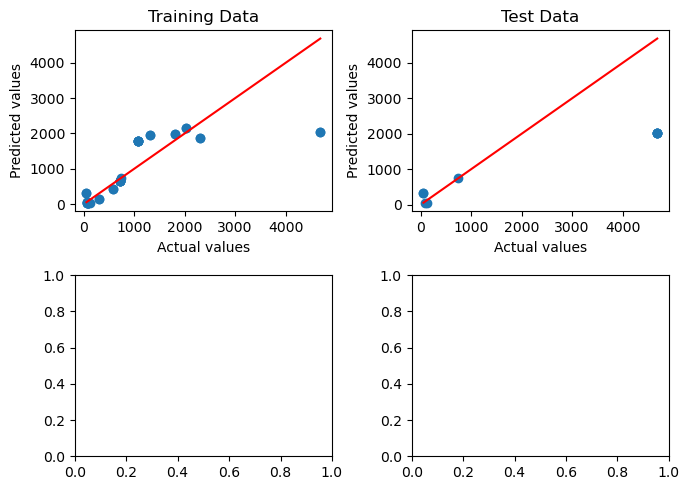

[Sigmaf] Epoch [720/2000], Loss: 452327.6562
Train R²:  0.61705
Test R² :  0.32444


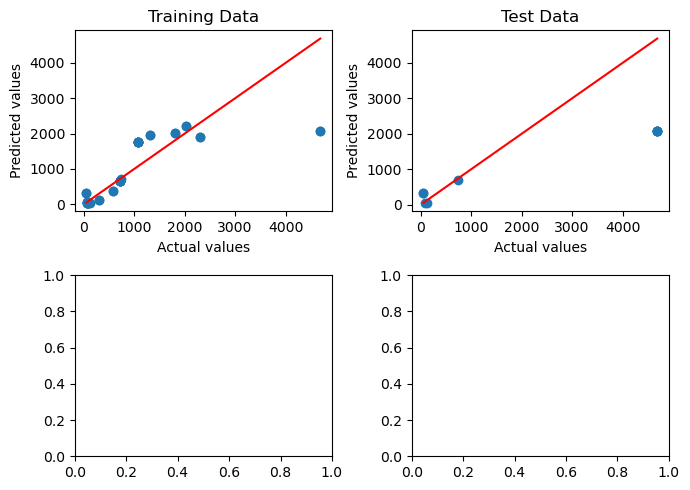

[Sigmaf] Epoch [740/2000], Loss: 433755.4062
Train R²:  0.63277
Test R² :  0.34624


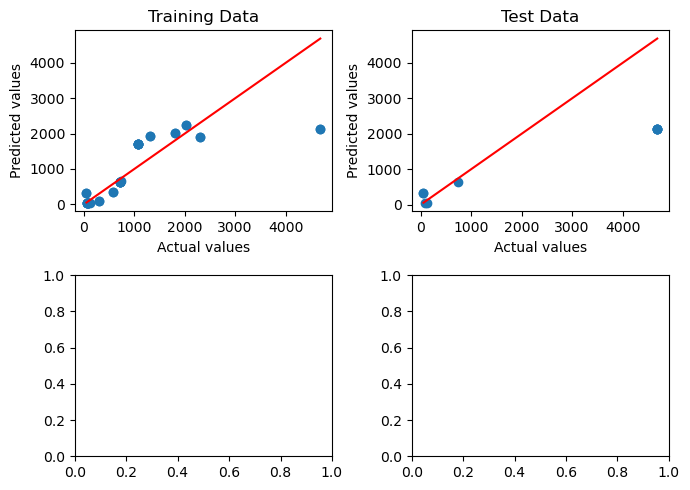

[Sigmaf] Epoch [760/2000], Loss: 411406.1562
Train R²:  0.65169
Test R² :  0.38061


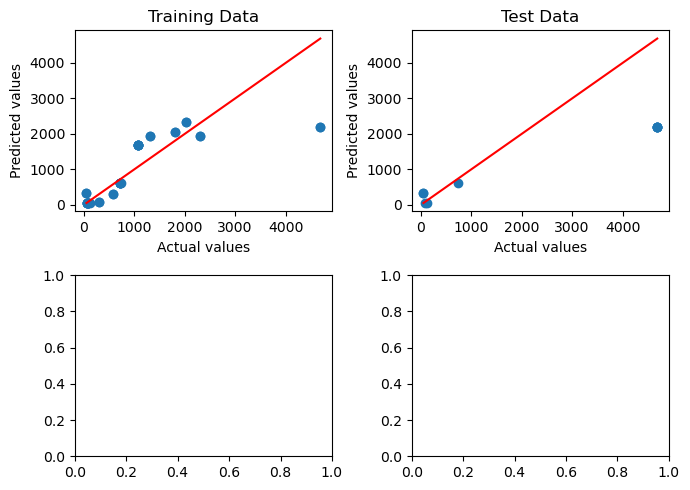

[Sigmaf] Epoch [780/2000], Loss: 384513.6875
Train R²:  0.67446
Test R² :  0.41511


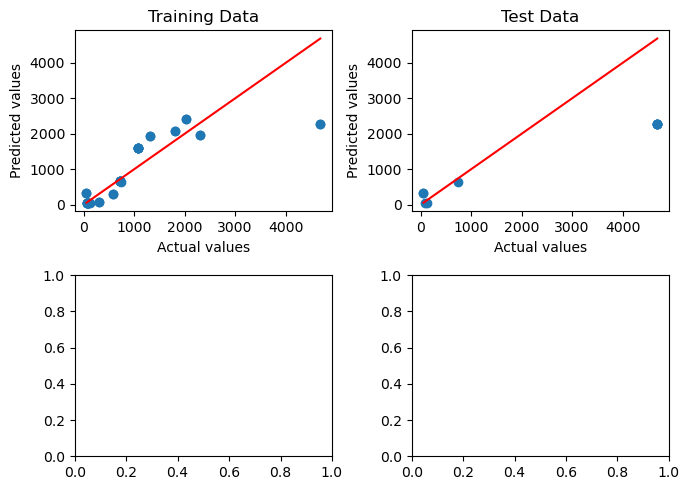

[Sigmaf] Epoch [800/2000], Loss: 356929.3125
Train R²:  0.69781
Test R² :  0.45304


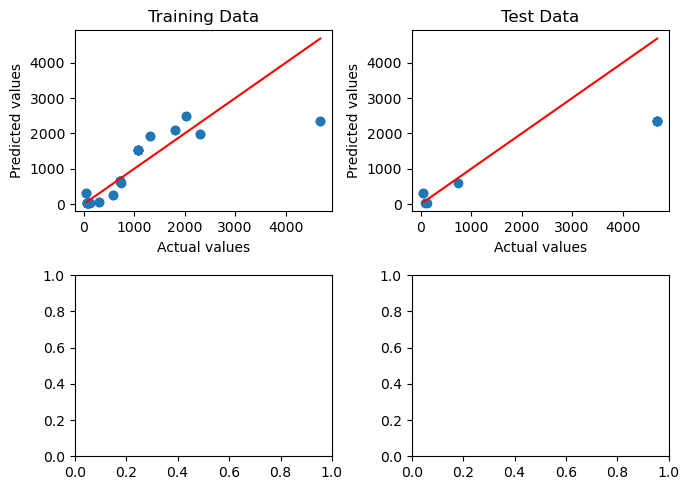

[Sigmaf] Epoch [820/2000], Loss: 328937.4375
Train R²:  0.72151
Test R² :  0.49428


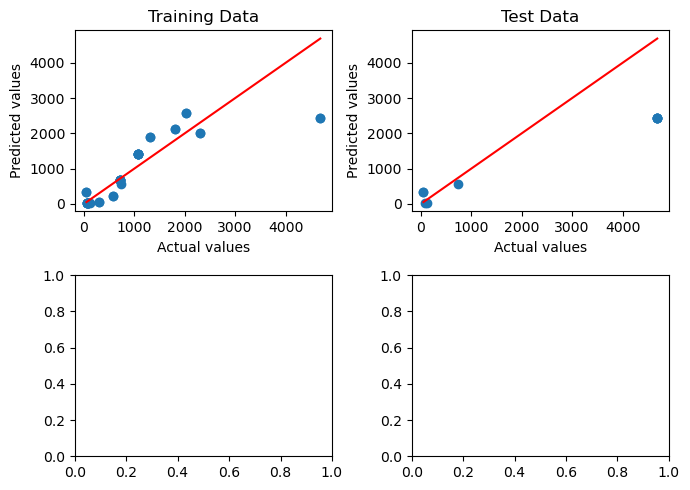

[Sigmaf] Epoch [840/2000], Loss: 303619.7188
Train R²:  0.74295
Test R² :  0.54884


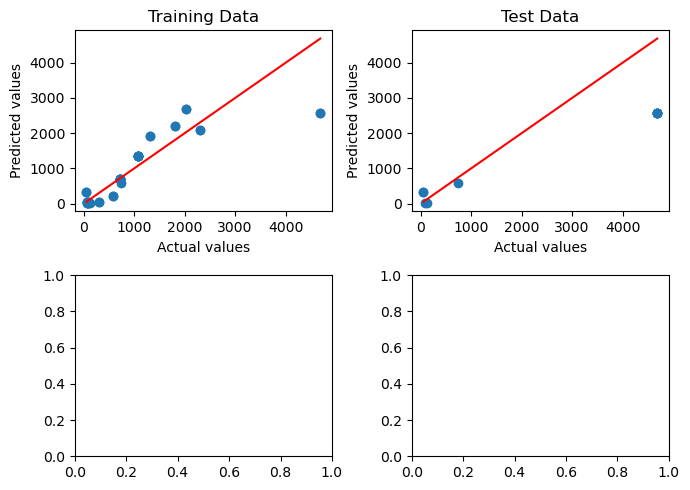

[Sigmaf] Epoch [860/2000], Loss: 281824.7500
Train R²:  0.76140
Test R² :  0.59193


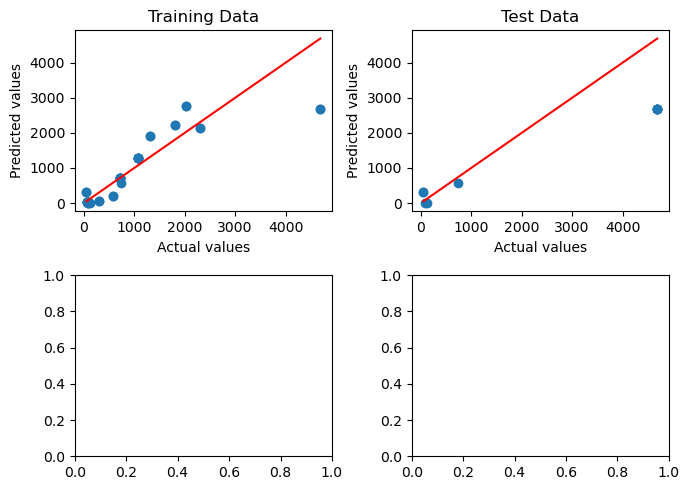

[Sigmaf] Epoch [880/2000], Loss: 264104.4375
Train R²:  0.77640
Test R² :  0.63186


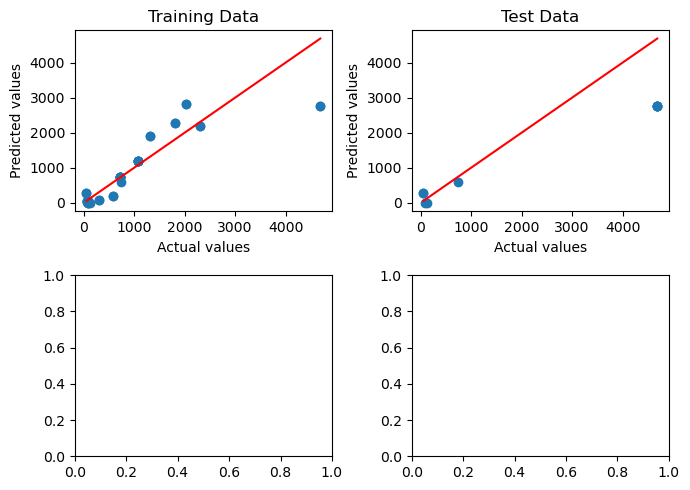

[Sigmaf] Epoch [900/2000], Loss: 250658.4062
Train R²:  0.78778
Test R² :  0.66496


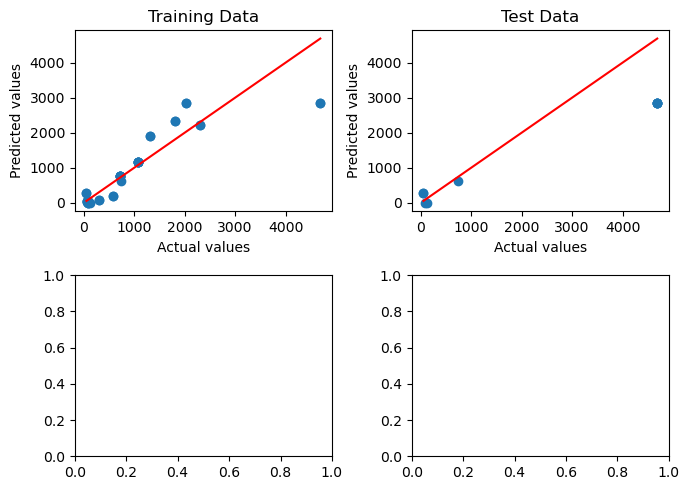

[Sigmaf] Epoch [920/2000], Loss: 235238.5938
Train R²:  0.80084
Test R² :  0.66911


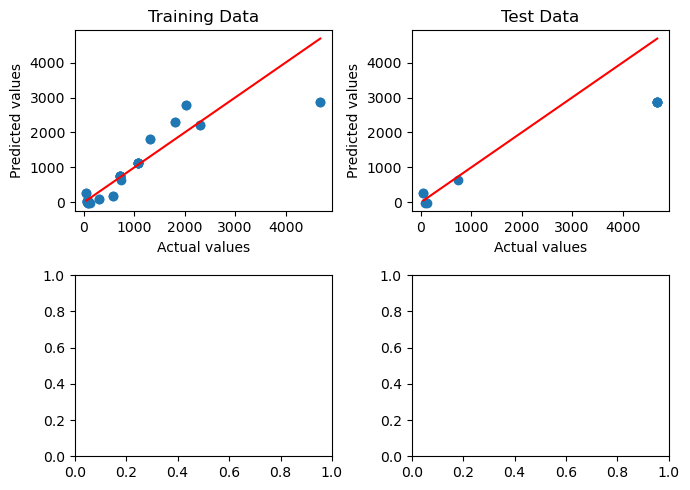

[Sigmaf] Epoch [940/2000], Loss: 219938.3438
Train R²:  0.81379
Test R² :  0.68495


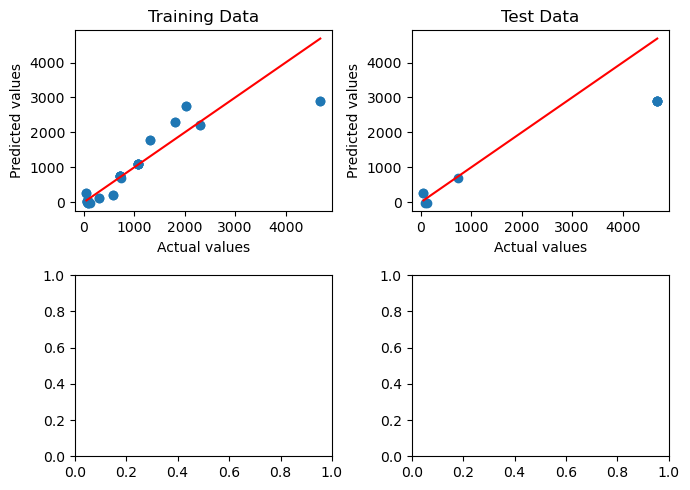

[Sigmaf] Epoch [960/2000], Loss: 202625.5156
Train R²:  0.82845
Test R² :  0.70922


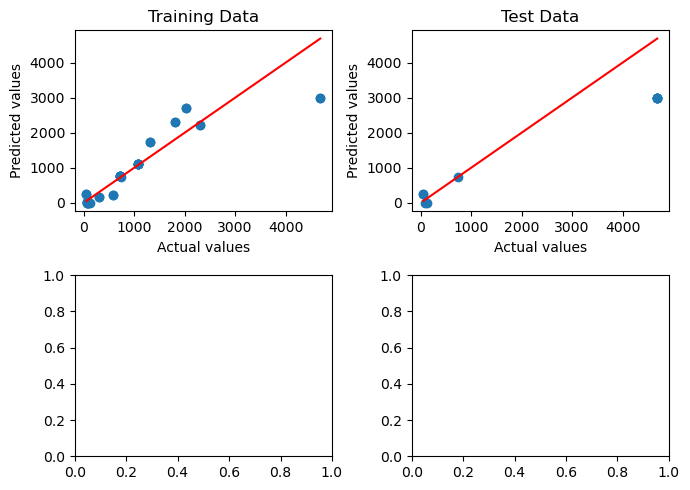

[Sigmaf] Epoch [980/2000], Loss: 181946.7812
Train R²:  0.84596
Test R² :  0.74819


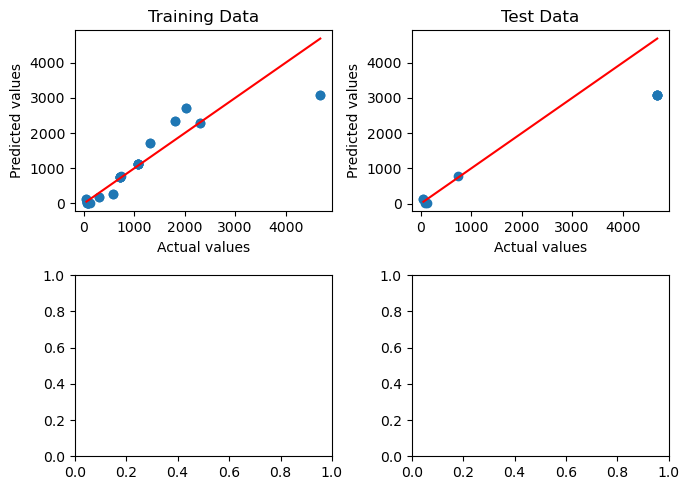

[Sigmaf] Epoch [1000/2000], Loss: 161751.0938
Train R²:  0.86306
Test R² :  0.76070


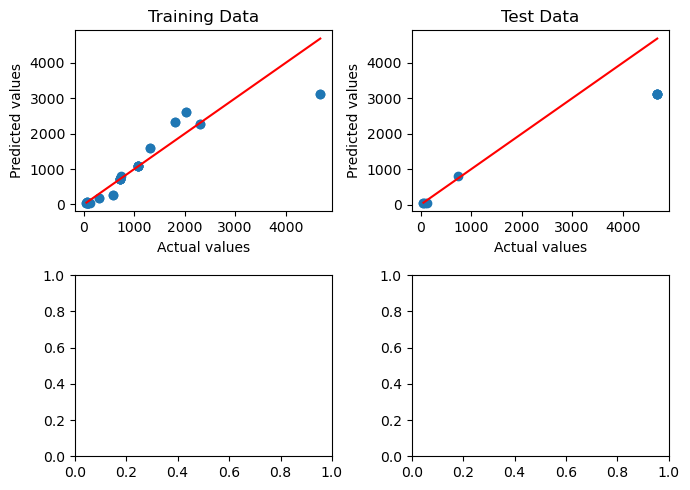

[Sigmaf] Epoch [1020/2000], Loss: 141991.2812
Train R²:  0.87979
Test R² :  0.78985


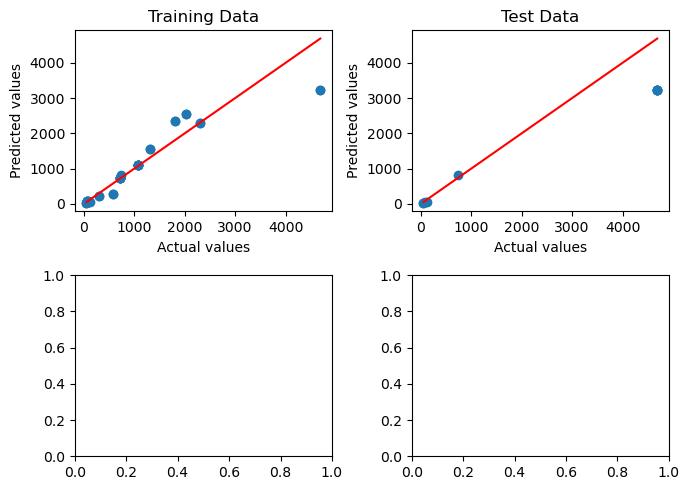

[Sigmaf] Epoch [1040/2000], Loss: 123982.2891
Train R²:  0.89503
Test R² :  0.82184


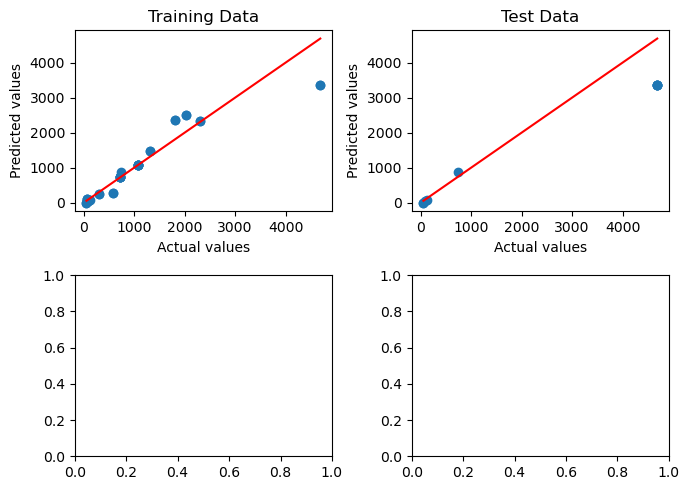

[Sigmaf] Epoch [1060/2000], Loss: 106296.1094
Train R²:  0.91001
Test R² :  0.85370


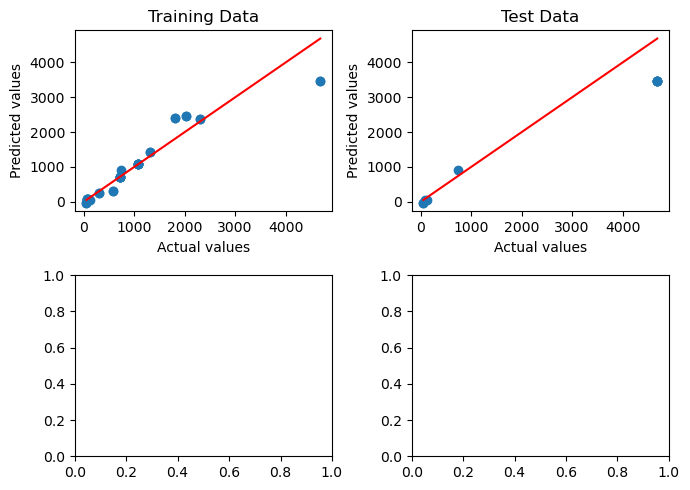

[Sigmaf] Epoch [1080/2000], Loss: 92177.8984
Train R²:  0.92196
Test R² :  0.86745


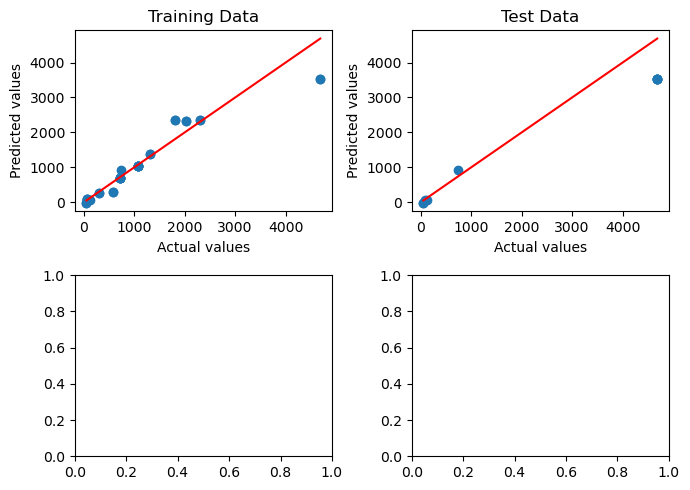

[Sigmaf] Epoch [1100/2000], Loss: 79014.3281
Train R²:  0.93310
Test R² :  0.88759


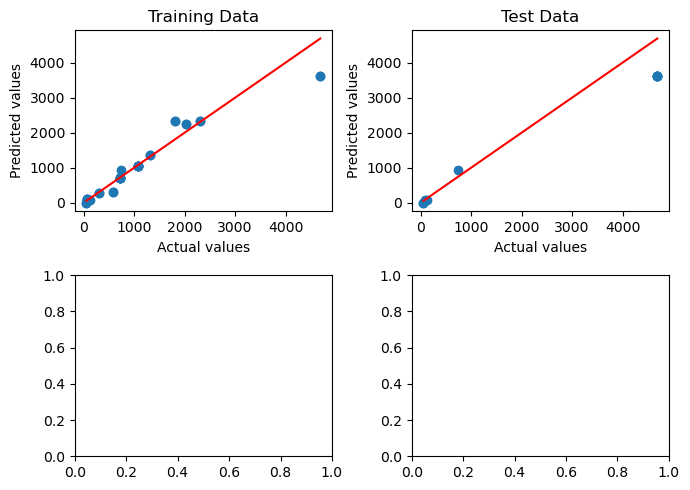

[Sigmaf] Epoch [1120/2000], Loss: 66957.4609
Train R²:  0.94331
Test R² :  0.91283


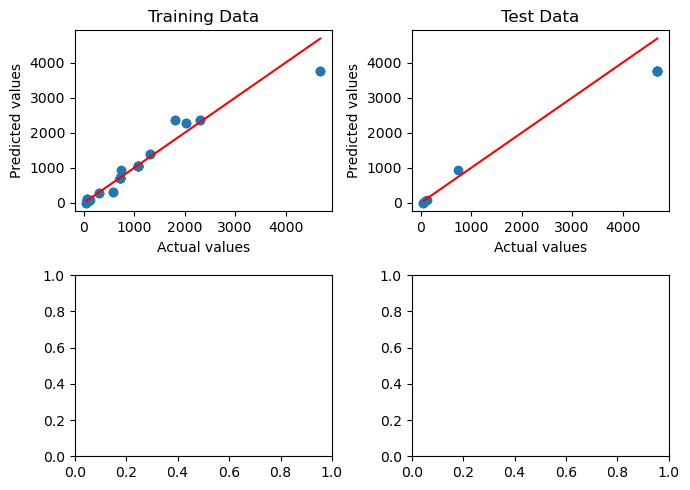

[Sigmaf] Epoch [1140/2000], Loss: 55496.8516
Train R²:  0.95301
Test R² :  0.92666


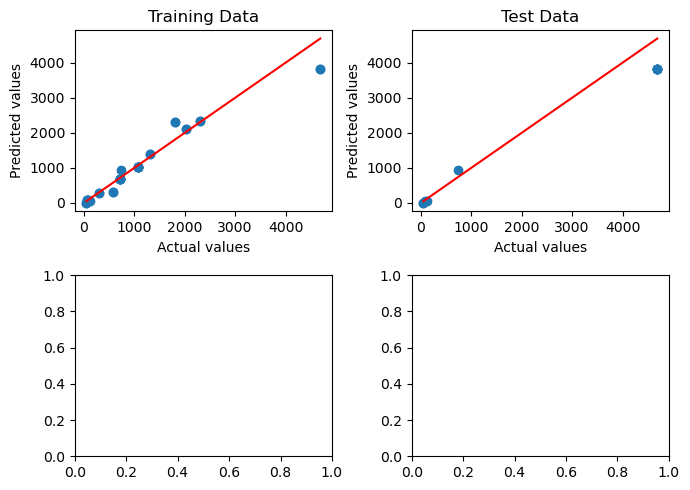

[Sigmaf] Epoch [1160/2000], Loss: 45702.2148
Train R²:  0.96131
Test R² :  0.94808


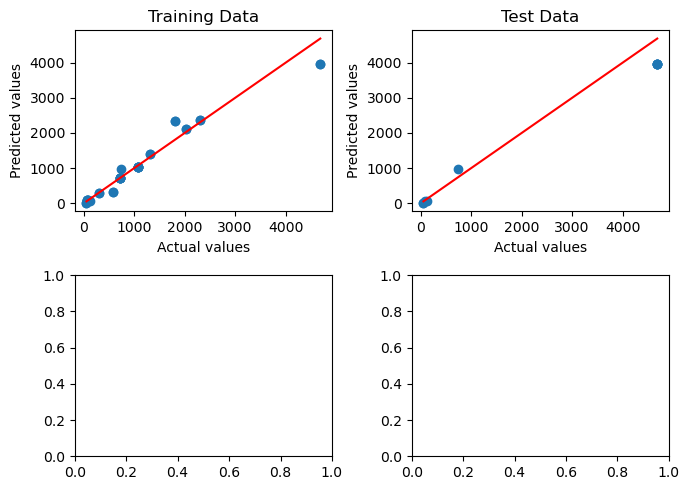

[Sigmaf] Epoch [1180/2000], Loss: 37759.3984
Train R²:  0.96803
Test R² :  0.96348


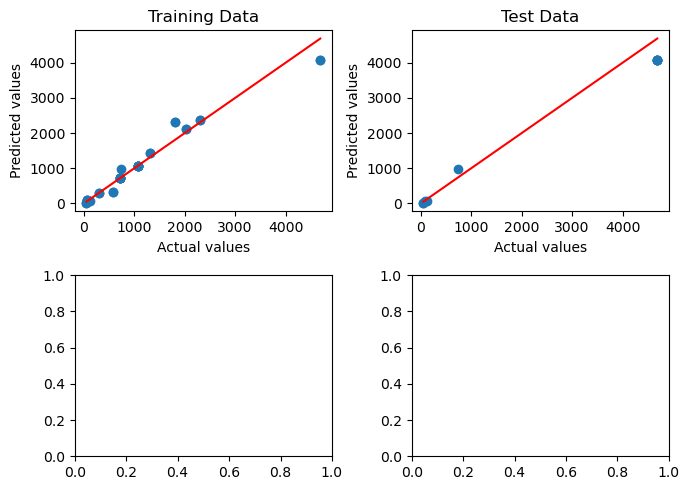

[Sigmaf] Epoch [1200/2000], Loss: 31111.9492
Train R²:  0.97366
Test R² :  0.96921


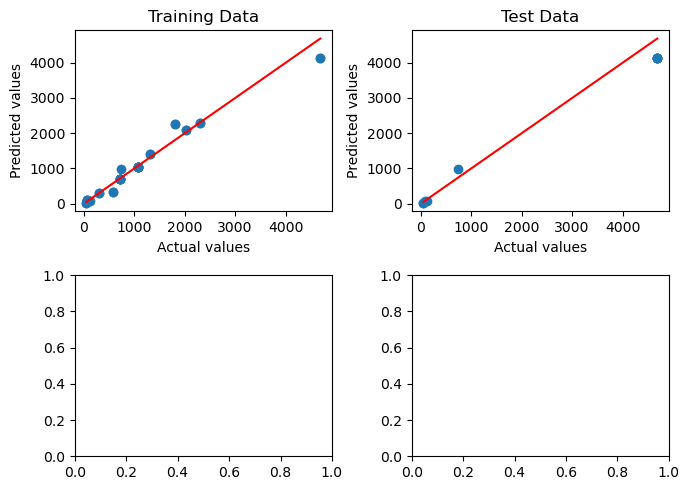

[Sigmaf] Epoch [1220/2000], Loss: 25656.2383
Train R²:  0.97828
Test R² :  0.97662


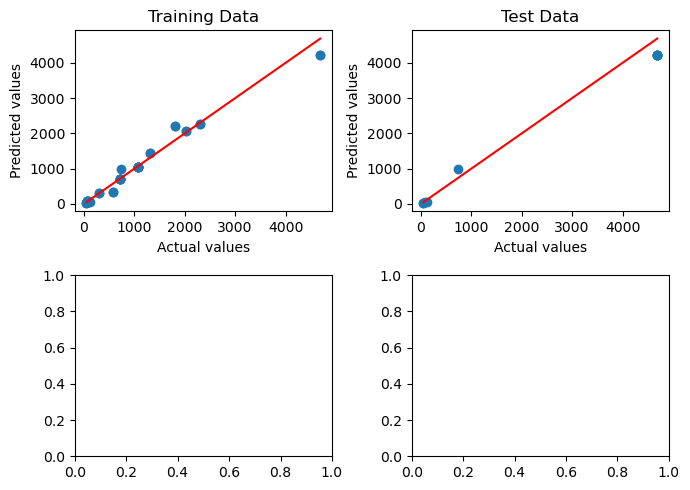

[Sigmaf] Epoch [1240/2000], Loss: 21522.7188
Train R²:  0.98178
Test R² :  0.98219


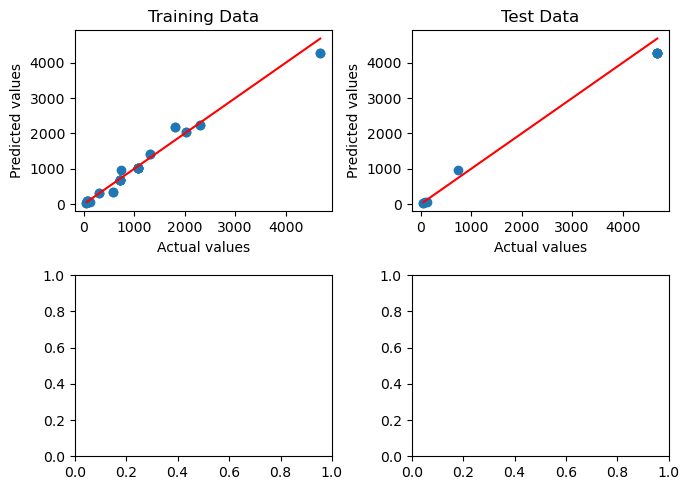

[Sigmaf] Epoch [1260/2000], Loss: 17818.6523
Train R²:  0.98491
Test R² :  0.98721


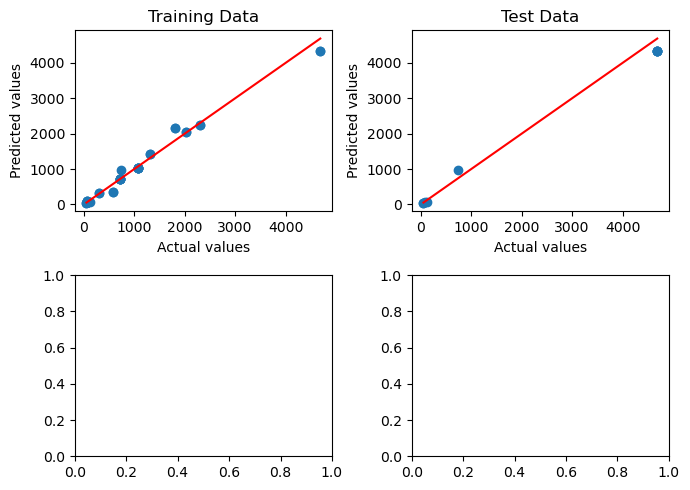

[Sigmaf] Epoch [1280/2000], Loss: 15045.0391
Train R²:  0.98726
Test R² :  0.99179


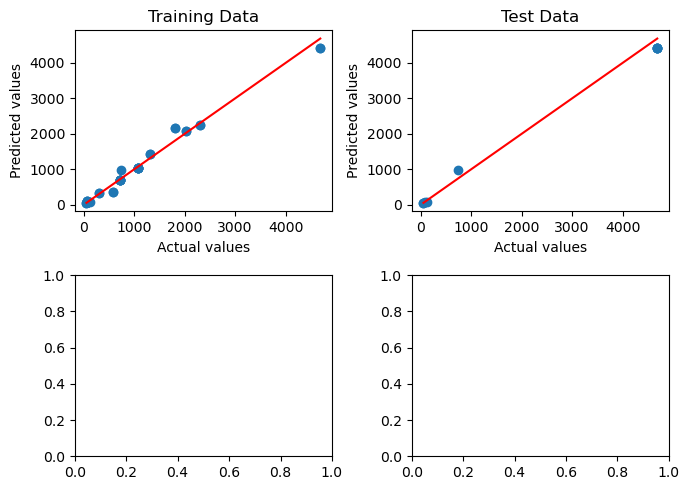

[Sigmaf] Epoch [1300/2000], Loss: 12867.4482
Train R²:  0.98911
Test R² :  0.99351


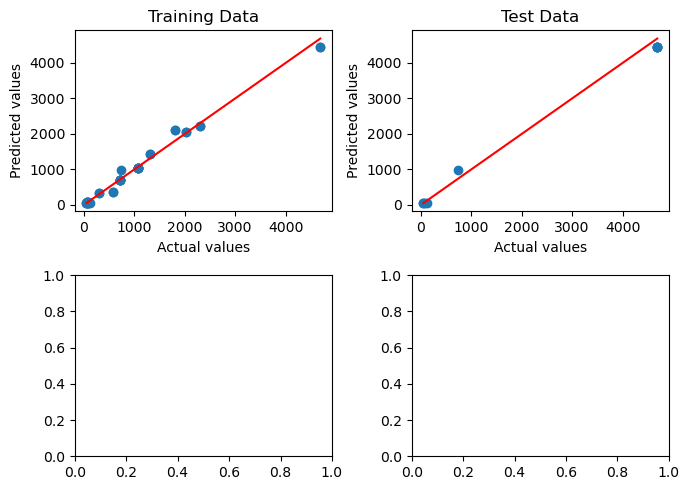

[Sigmaf] Epoch [1320/2000], Loss: 11249.2451
Train R²:  0.99048
Test R² :  0.99498


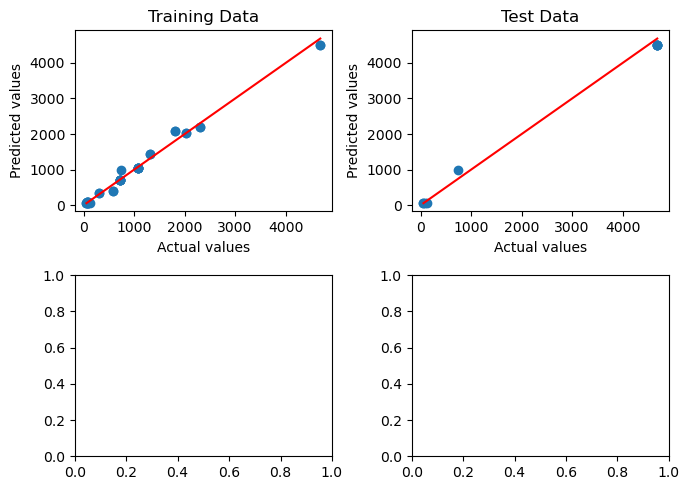

[Sigmaf] Epoch [1340/2000], Loss: 10328.3262
Train R²:  0.99126
Test R² :  0.99497


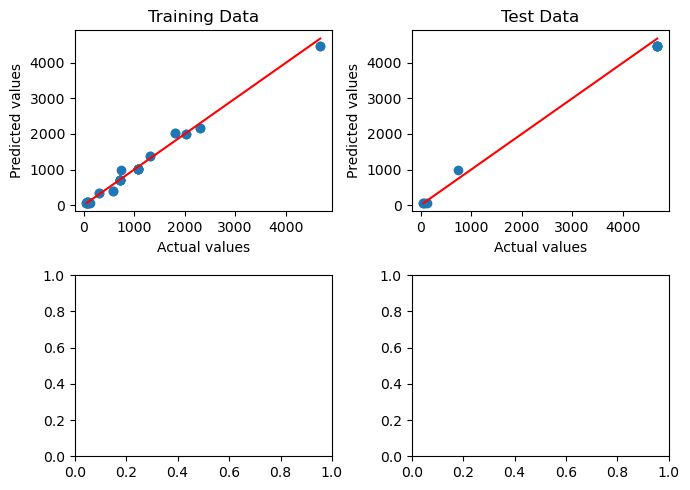

[Sigmaf] Epoch [1360/2000], Loss: 9239.7295
Train R²:  0.99218
Test R² :  0.99783


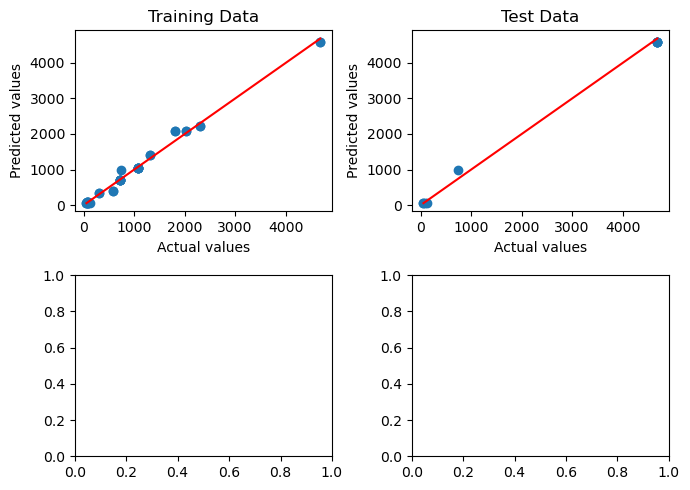

[Sigmaf] Epoch [1380/2000], Loss: 8205.2598
Train R²:  0.99305
Test R² :  0.99788


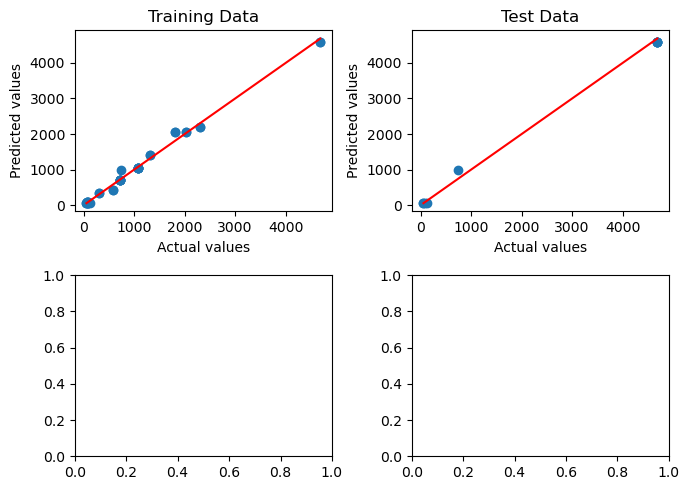

[Sigmaf] Epoch [1400/2000], Loss: 7354.7642
Train R²:  0.99377
Test R² :  0.99825


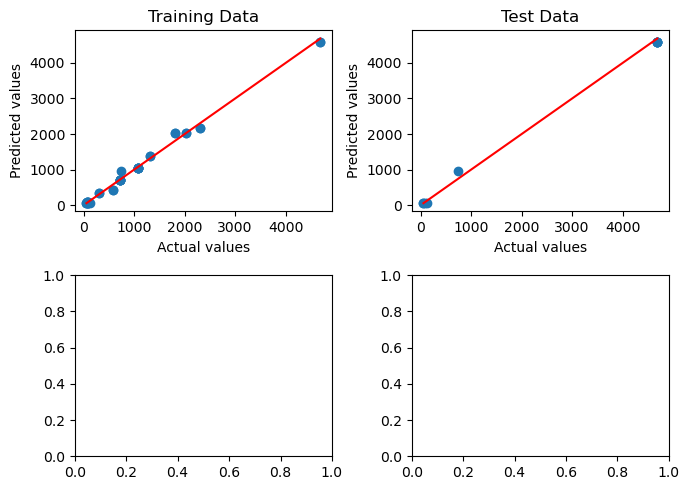

[Sigmaf] Epoch [1420/2000], Loss: 6776.9390
Train R²:  0.99426
Test R² :  0.99855


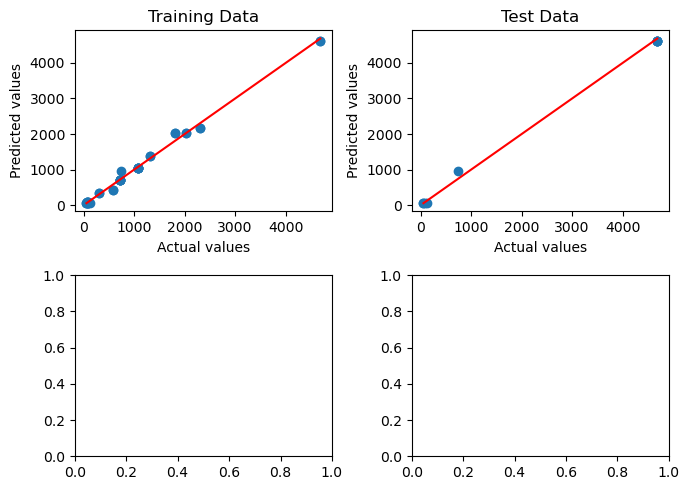

[Sigmaf] Epoch [1440/2000], Loss: 6312.3105
Train R²:  0.99466
Test R² :  0.99880


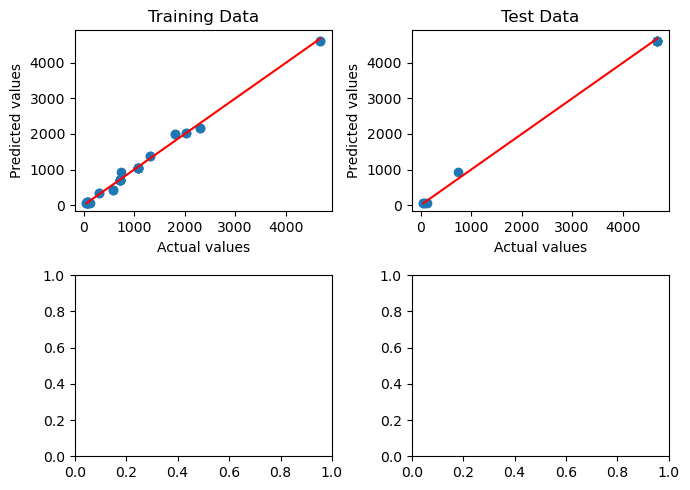

[Sigmaf] Epoch [1460/2000], Loss: 5890.6343
Train R²:  0.99501
Test R² :  0.99906


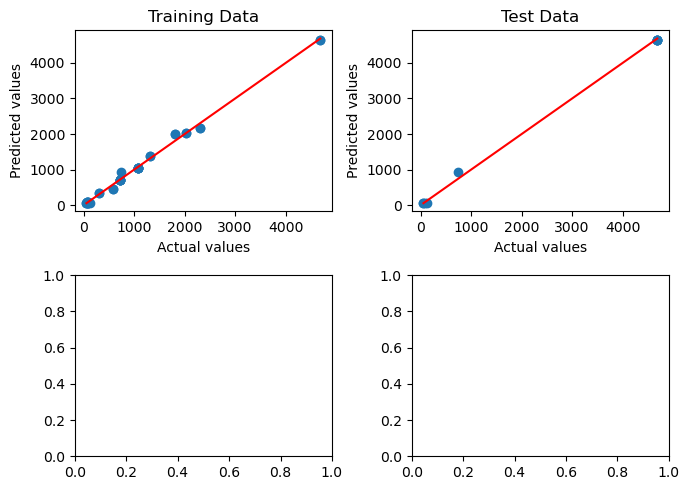

[Sigmaf] Epoch [1480/2000], Loss: 5533.8975
Train R²:  0.99531
Test R² :  0.99914


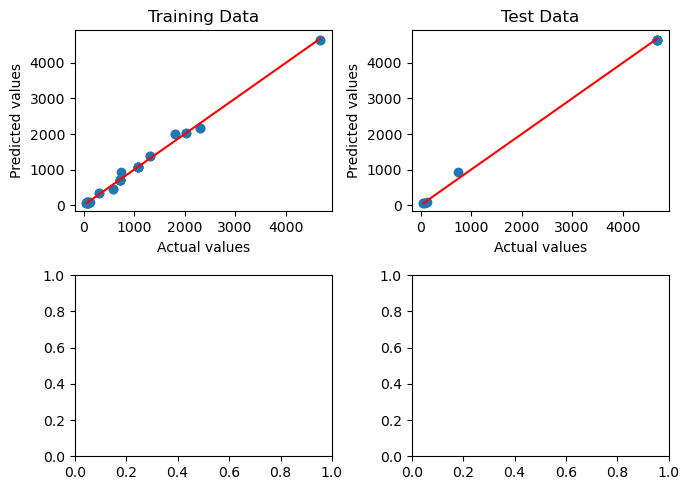

[Sigmaf] Epoch [1500/2000], Loss: 5247.3242
Train R²:  0.99556
Test R² :  0.99923


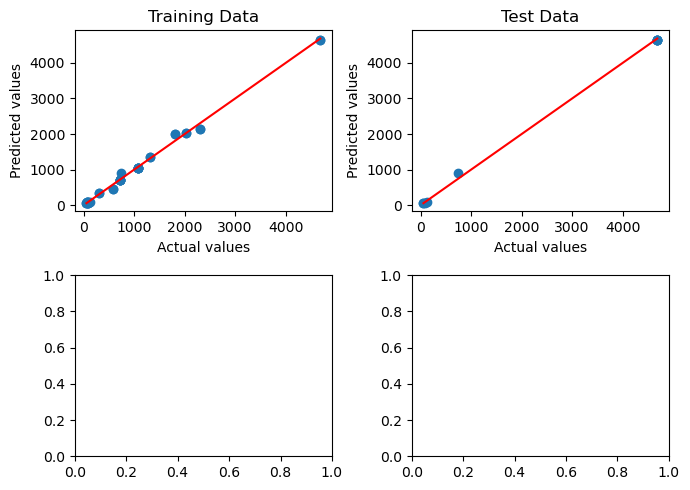

[Sigmaf] Epoch [1520/2000], Loss: 4984.3779
Train R²:  0.99578
Test R² :  0.99920


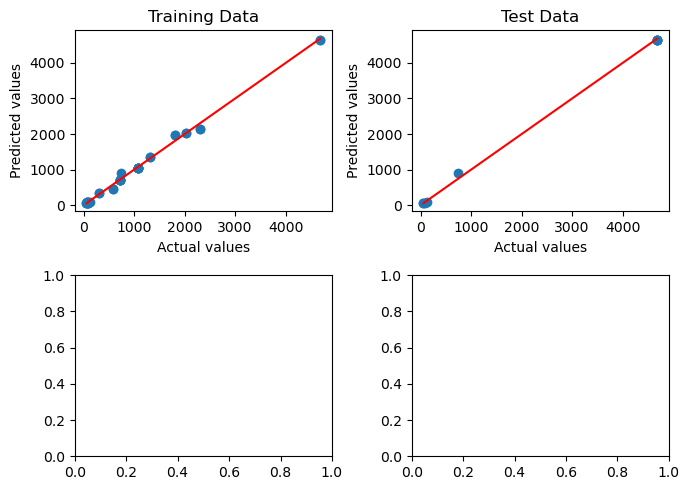

[Sigmaf] Epoch [1540/2000], Loss: 4666.5381
Train R²:  0.99605
Test R² :  0.99943


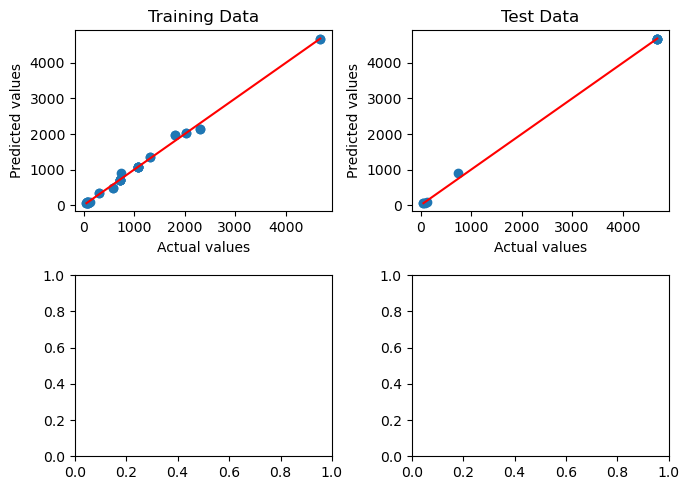

[Sigmaf] Epoch [1560/2000], Loss: 4430.9937
Train R²:  0.99625
Test R² :  0.99954


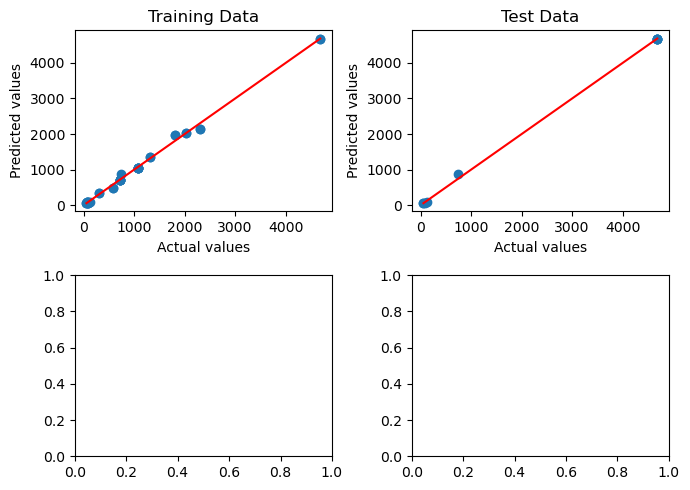

[Sigmaf] Epoch [1580/2000], Loss: 4252.9819
Train R²:  0.99640
Test R² :  0.99954


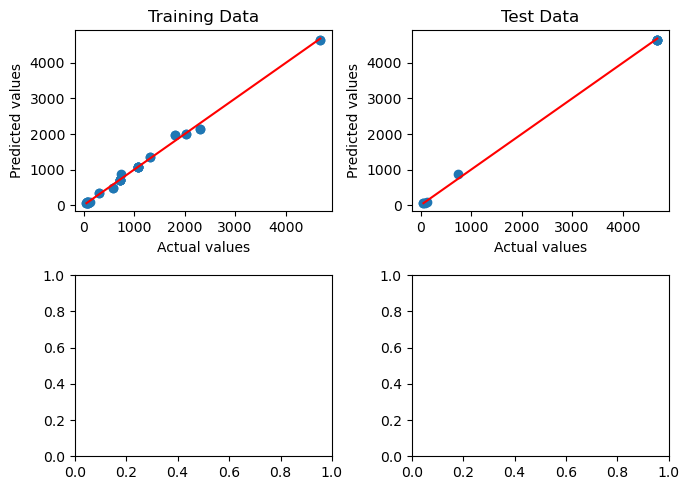

[Sigmaf] Epoch [1600/2000], Loss: 4084.9688
Train R²:  0.99654
Test R² :  0.99965


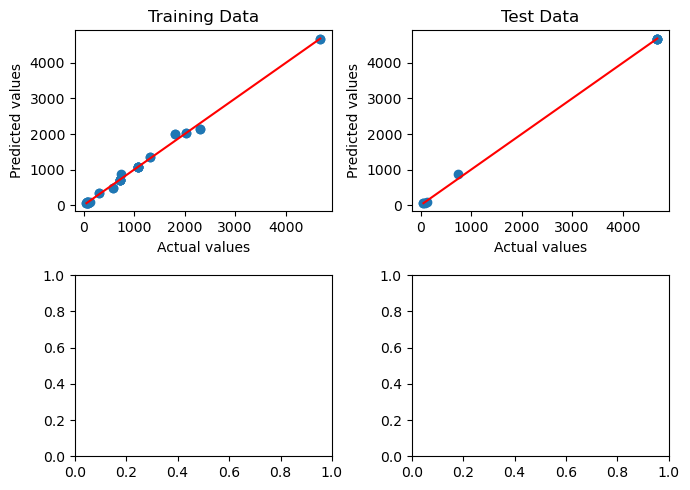

[Sigmaf] Epoch [1620/2000], Loss: 3910.5586
Train R²:  0.99669
Test R² :  0.99969


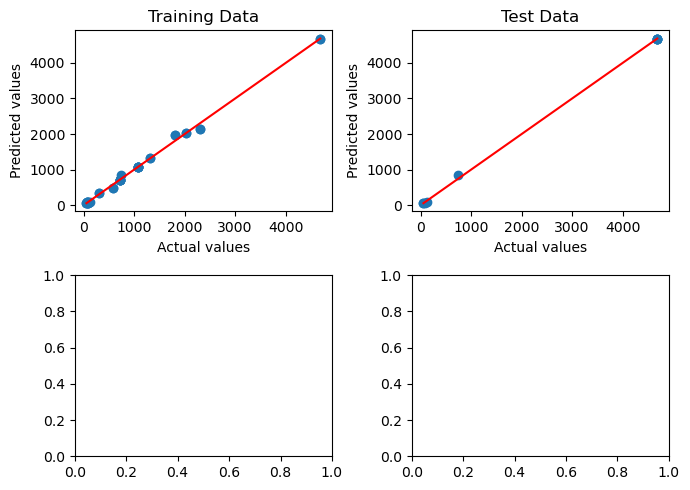

[Sigmaf] Epoch [1640/2000], Loss: 3755.3098
Train R²:  0.99682
Test R² :  0.99972


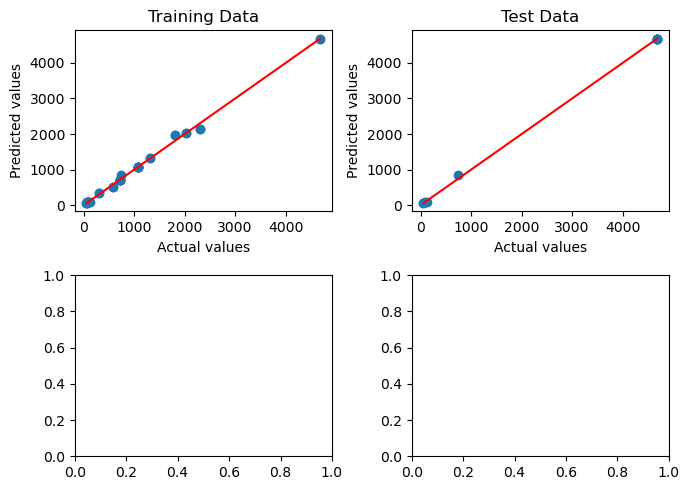

[Sigmaf] Epoch [1660/2000], Loss: 3629.4871
Train R²:  0.99693
Test R² :  0.99976


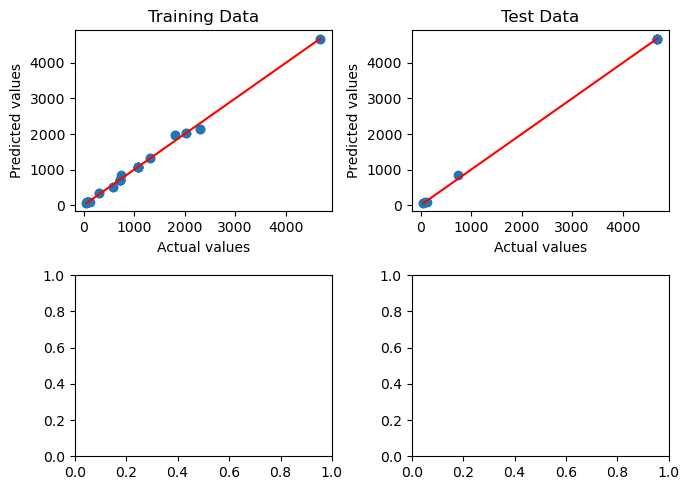

[Sigmaf] Epoch [1680/2000], Loss: 3511.9663
Train R²:  0.99703
Test R² :  0.99977


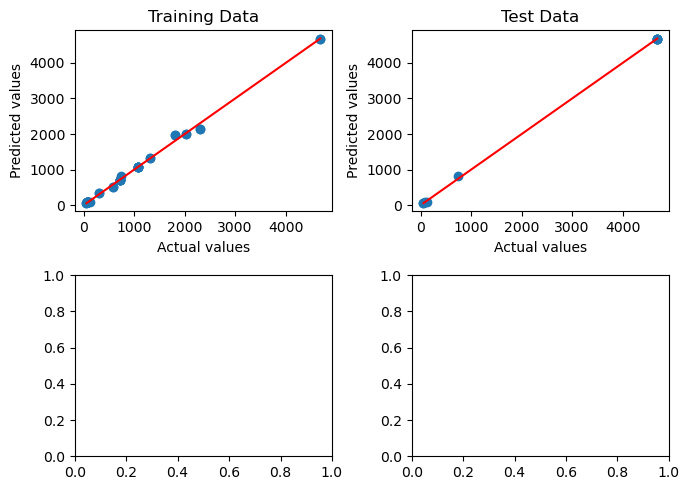

[Sigmaf] Epoch [1700/2000], Loss: 3381.8633
Train R²:  0.99714
Test R² :  0.99982


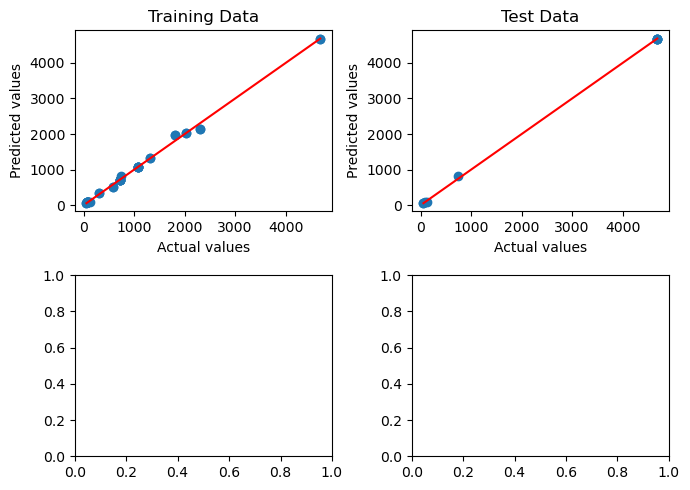

[Sigmaf] Epoch [1720/2000], Loss: 3271.1526
Train R²:  0.99723
Test R² :  0.99982


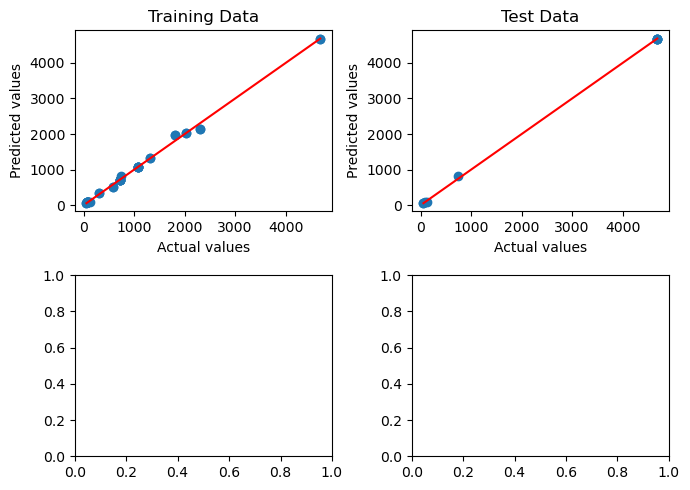

[Sigmaf] Epoch [1740/2000], Loss: 3174.4790
Train R²:  0.99731
Test R² :  0.99982


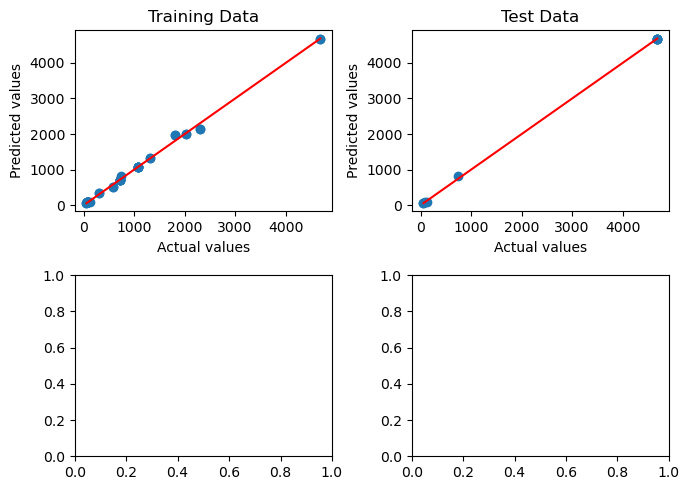

[Sigmaf] Epoch [1760/2000], Loss: 3100.3345
Train R²:  0.99738
Test R² :  0.99984


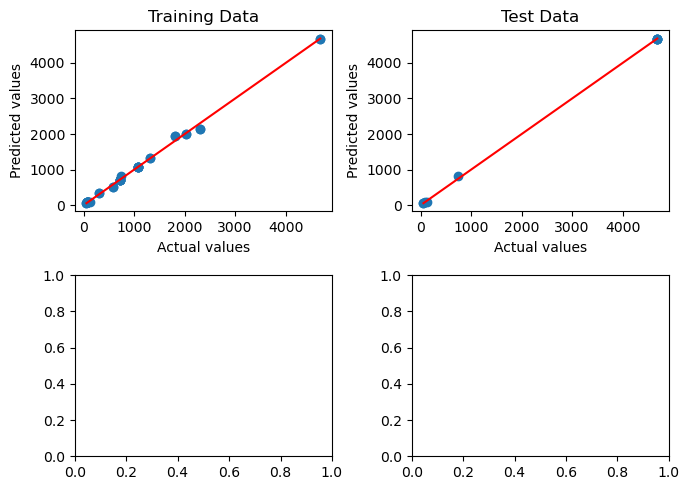

[Sigmaf] Epoch [1780/2000], Loss: 2978.4270
Train R²:  0.99748
Test R² :  0.99988


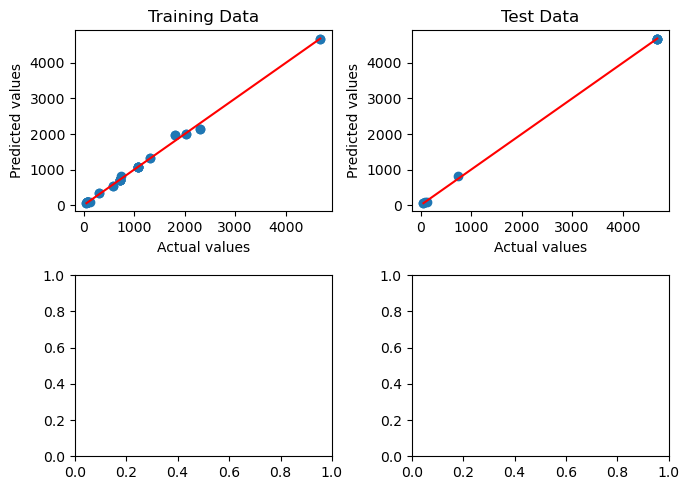

[Sigmaf] Epoch [1800/2000], Loss: 2897.0283
Train R²:  0.99755
Test R² :  0.99990


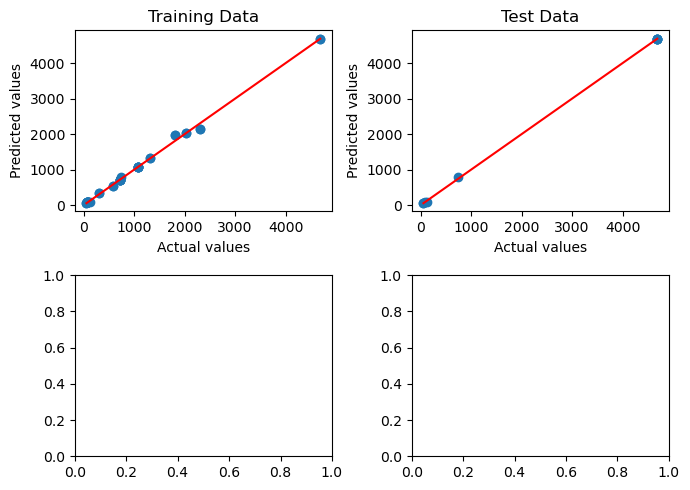

[Sigmaf] Epoch [1820/2000], Loss: 2817.9995
Train R²:  0.99761
Test R² :  0.99991


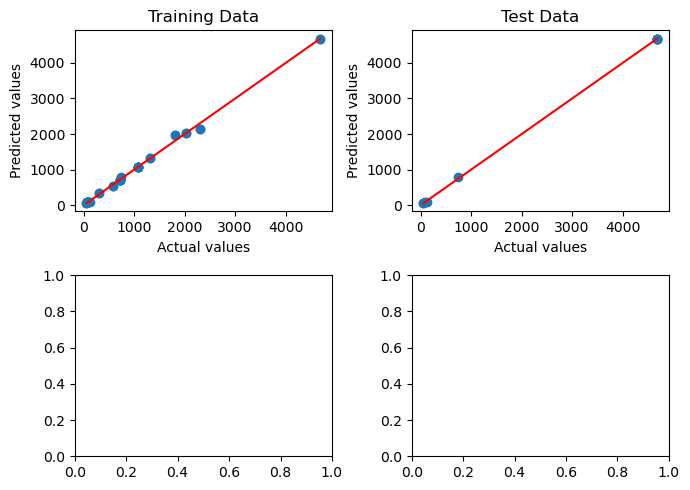

[Sigmaf] Epoch [1840/2000], Loss: 2763.7585
Train R²:  0.99766
Test R² :  0.99991


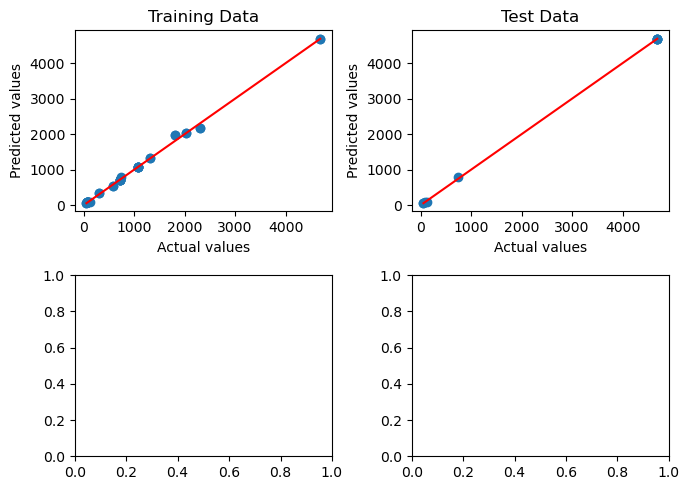

[Sigmaf] Epoch [1860/2000], Loss: 2689.3586
Train R²:  0.99772
Test R² :  0.99991


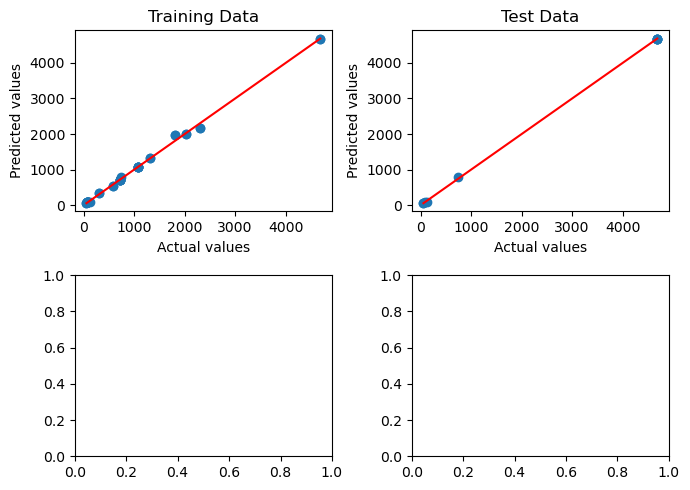

[Sigmaf] Epoch [1880/2000], Loss: 2623.4055
Train R²:  0.99778
Test R² :  0.99993


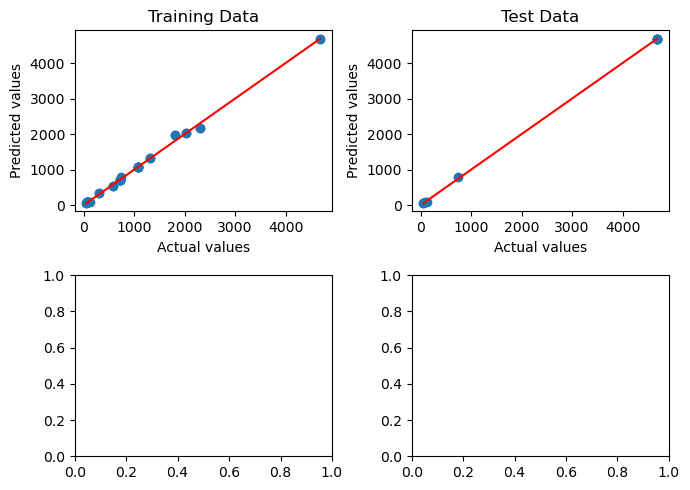

[Sigmaf] Epoch [1900/2000], Loss: 2604.1567
Train R²:  0.99780
Test R² :  0.99990


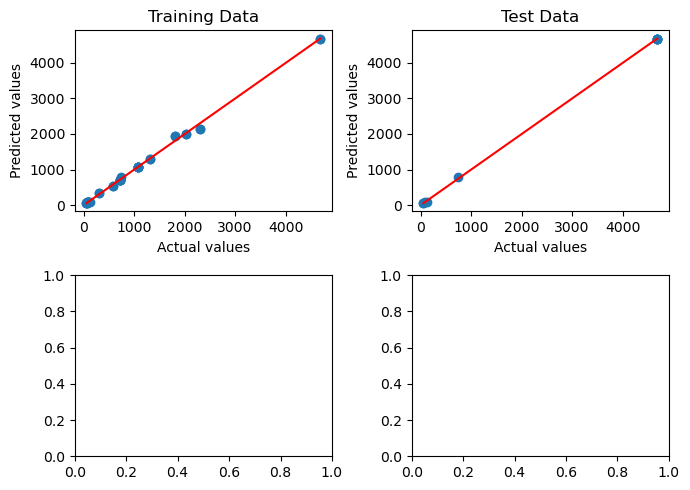

[Sigmaf] Epoch [1920/2000], Loss: 2498.6868
Train R²:  0.99788
Test R² :  0.99995


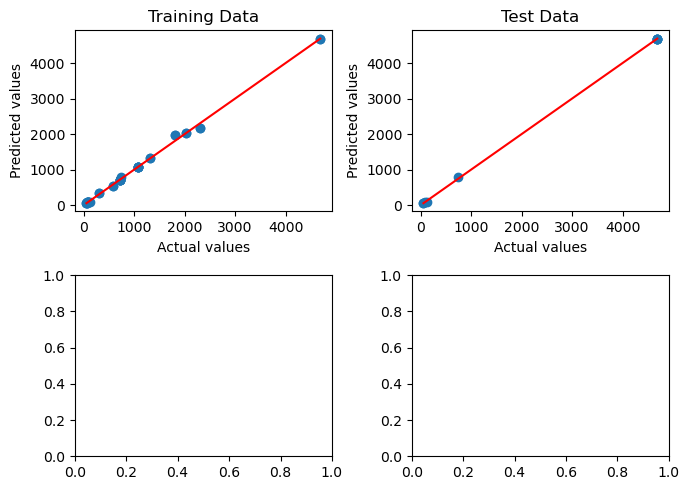

[Sigmaf] Epoch [1940/2000], Loss: 2421.0669
Train R²:  0.99795
Test R² :  0.99995


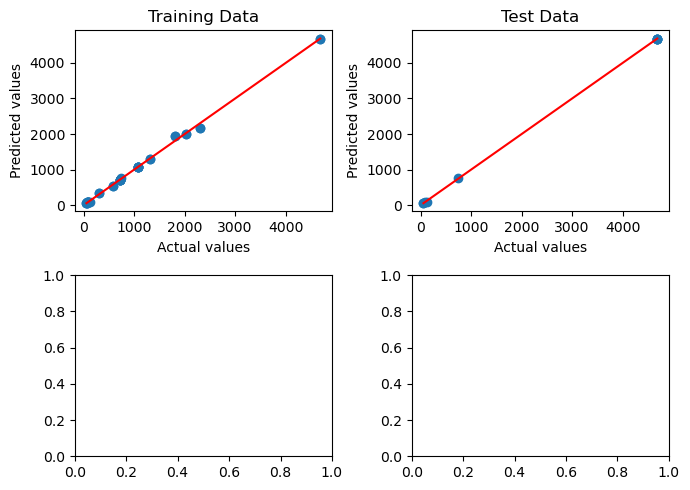

[Sigmaf] Epoch [1960/2000], Loss: 2352.0522
Train R²:  0.99801
Test R² :  0.99996


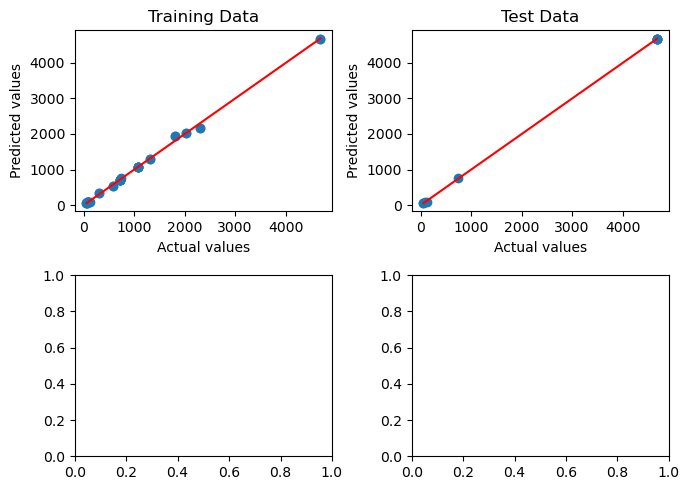

[Sigmaf] Epoch [1980/2000], Loss: 2314.8335
Train R²:  0.99804
Test R² :  0.99996


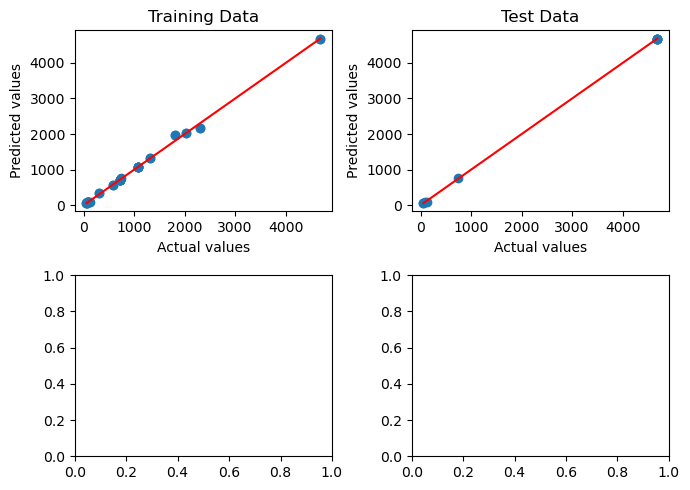

[Sigmaf] Epoch [2000/2000], Loss: 2276.8608
Train R²:  0.99807
Test R² :  0.99996


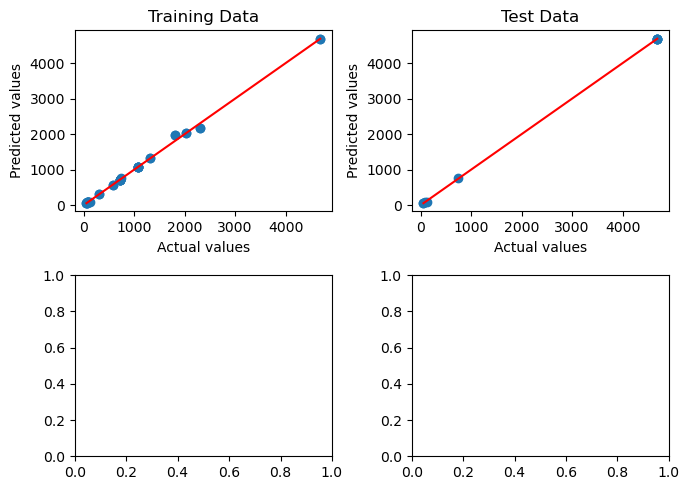

In [7]:
DNN(4)

[b] Epoch [20/2000], Loss: 0.0047
Train R²:  -1.67856
Test R² :  -3.01449


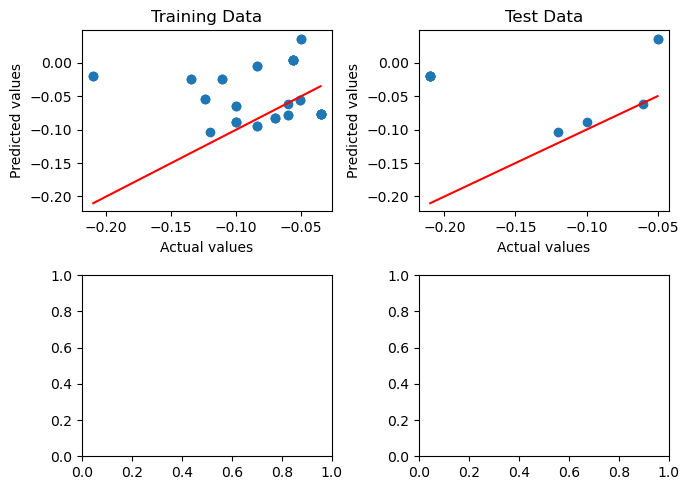

[b] Epoch [40/2000], Loss: 0.0094
Train R²:  -4.37364
Test R² :  0.70690


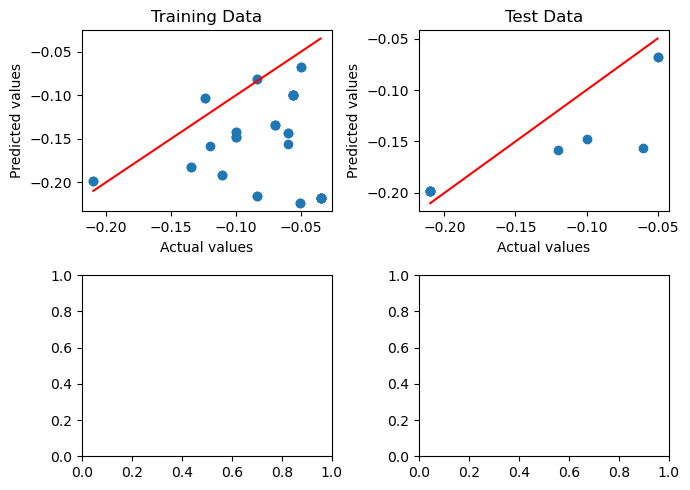

[b] Epoch [60/2000], Loss: 0.0028
Train R²:  -0.61873
Test R² :  0.12529


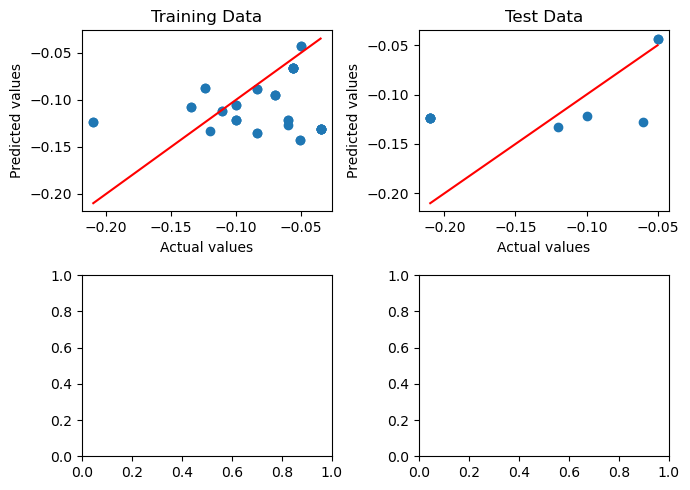

[b] Epoch [80/2000], Loss: 0.0019
Train R²:  -0.08335
Test R² :  -0.69627


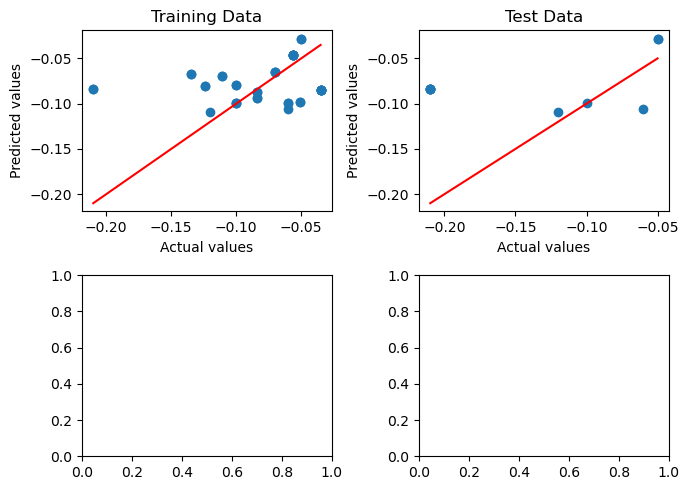

[b] Epoch [100/2000], Loss: 0.0017
Train R²:  -0.00165
Test R² :  -0.59496


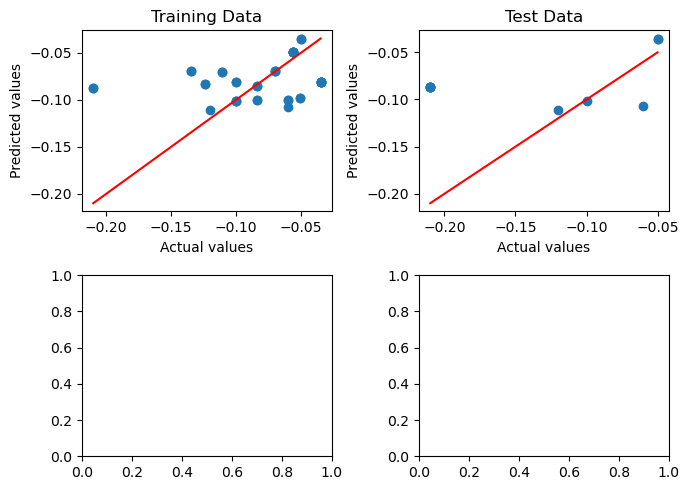

[b] Epoch [120/2000], Loss: 0.0016
Train R²:  0.07380
Test R² :  -0.41044


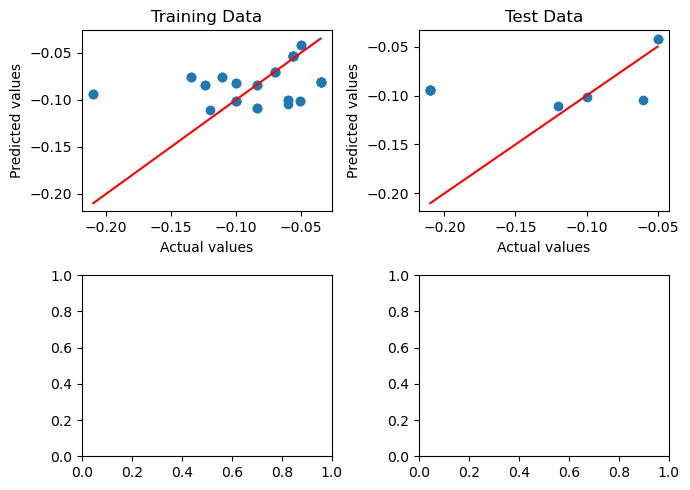

[b] Epoch [140/2000], Loss: 0.0015
Train R²:  0.13825
Test R² :  -0.33112


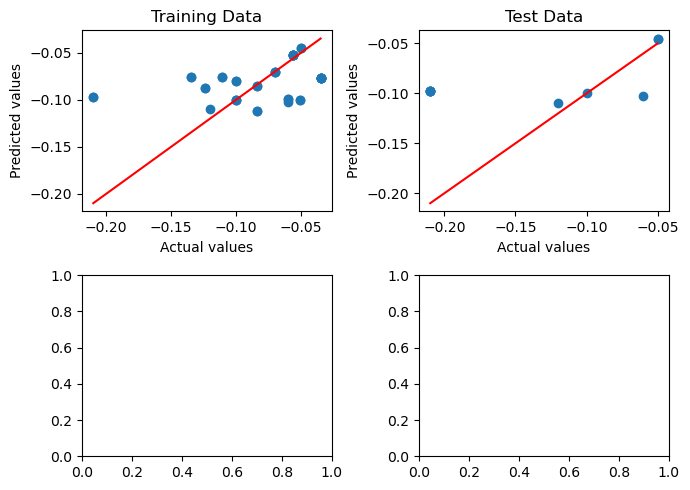

[b] Epoch [160/2000], Loss: 0.0014
Train R²:  0.19624
Test R² :  -0.24176


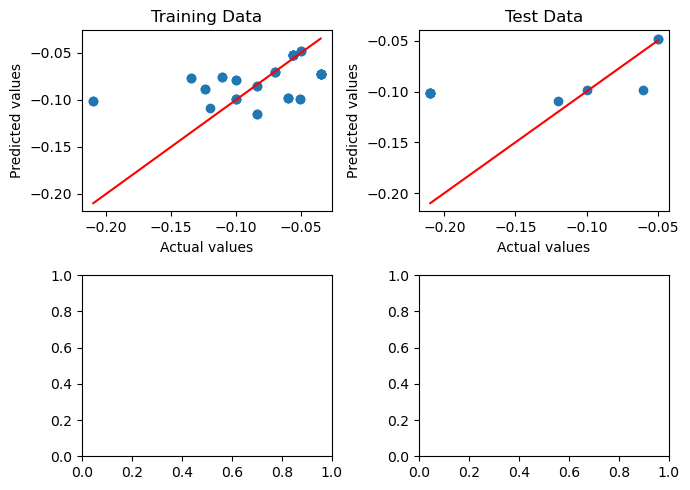

[b] Epoch [180/2000], Loss: 0.0013
Train R²:  0.24861
Test R² :  -0.14961


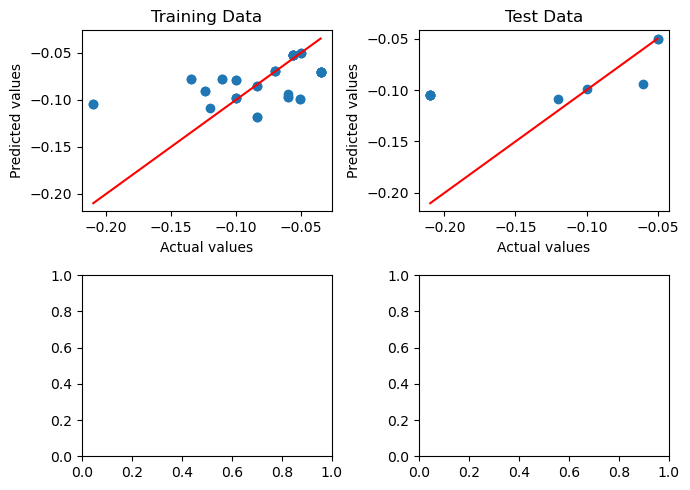

[b] Epoch [200/2000], Loss: 0.0012
Train R²:  0.29251
Test R² :  -0.07676


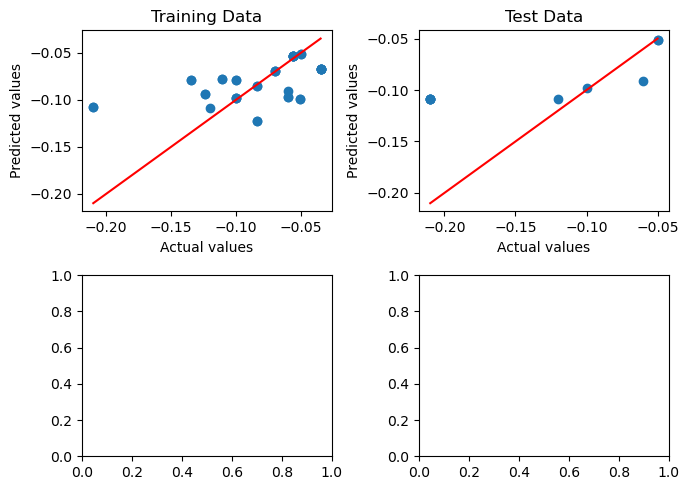

[b] Epoch [220/2000], Loss: 0.0012
Train R²:  0.32967
Test R² :  -0.02132


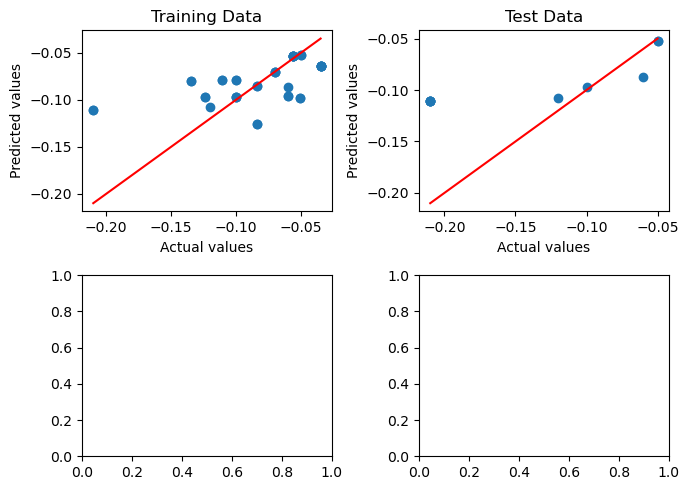

[b] Epoch [240/2000], Loss: 0.0011
Train R²:  0.36228
Test R² :  0.03783


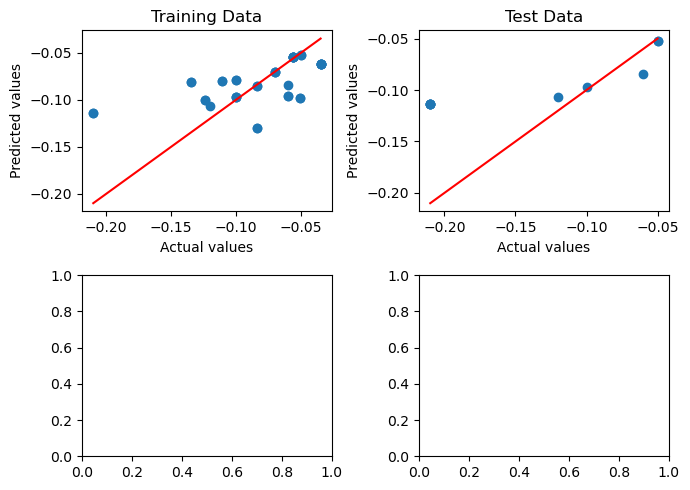

[b] Epoch [260/2000], Loss: 0.0011
Train R²:  0.39067
Test R² :  0.08584


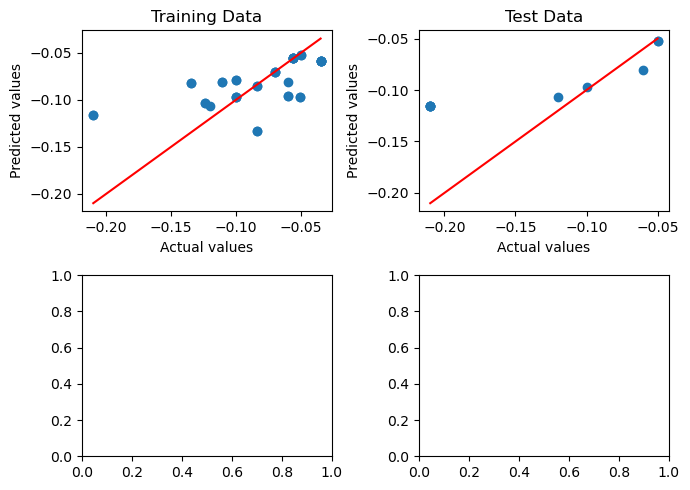

[b] Epoch [280/2000], Loss: 0.0010
Train R²:  0.42276
Test R² :  0.12526


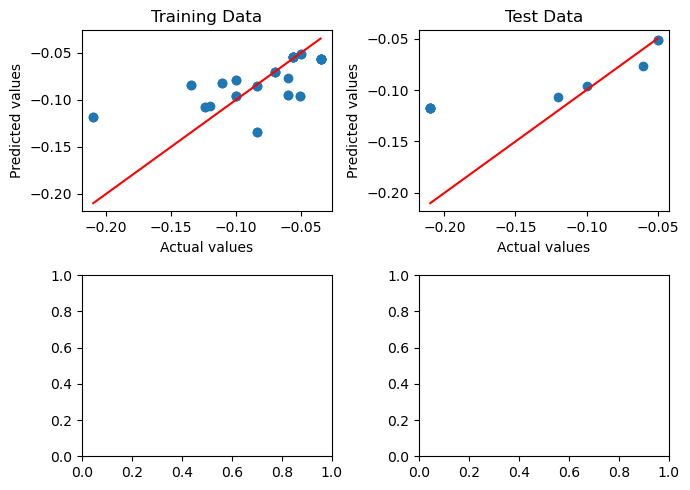

[b] Epoch [300/2000], Loss: 0.0009
Train R²:  0.45679
Test R² :  0.17673


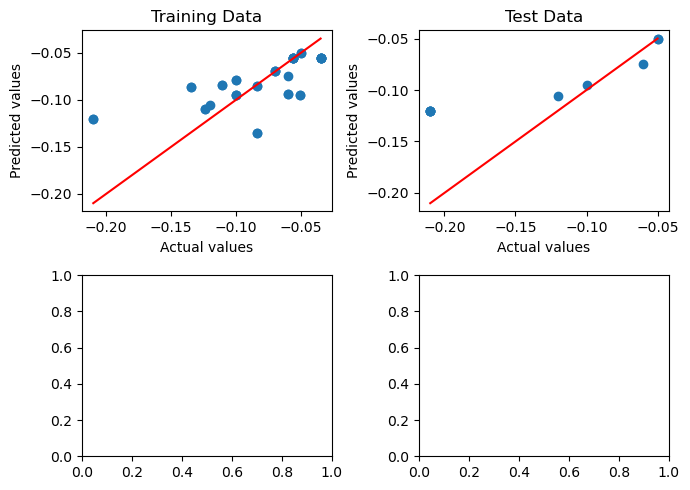

[b] Epoch [320/2000], Loss: 0.0009
Train R²:  0.49781
Test R² :  0.23363


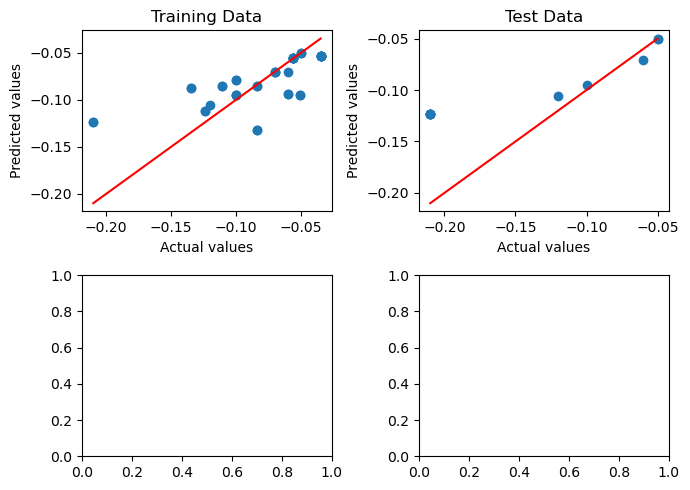

[b] Epoch [340/2000], Loss: 0.0008
Train R²:  0.51856
Test R² :  0.28580


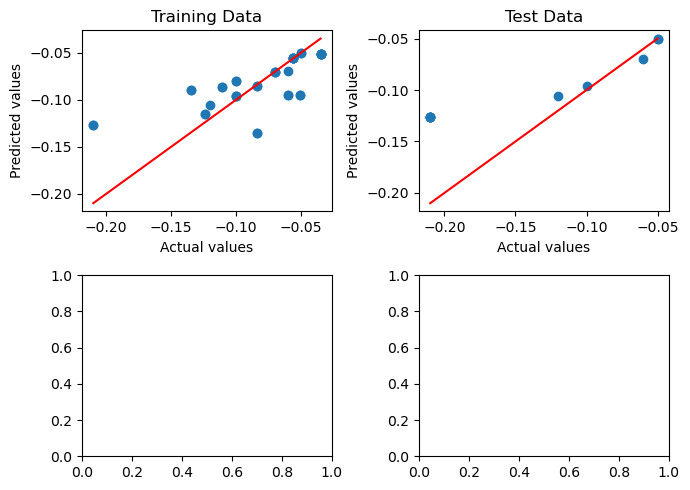

[b] Epoch [360/2000], Loss: 0.0008
Train R²:  0.53650
Test R² :  0.32407


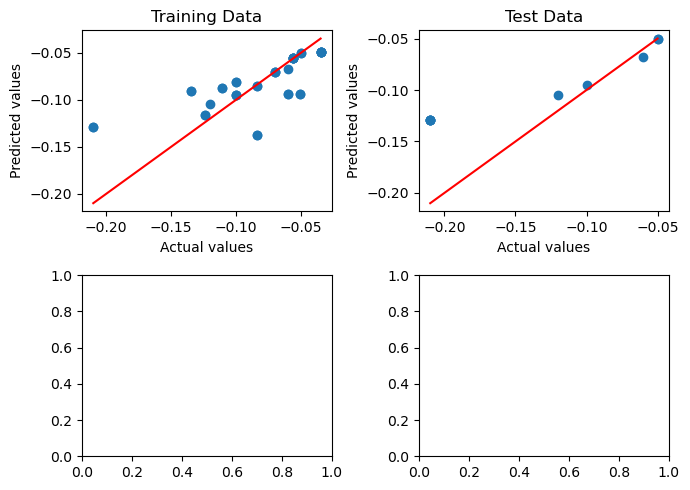

[b] Epoch [380/2000], Loss: 0.0008
Train R²:  0.55191
Test R² :  0.35592


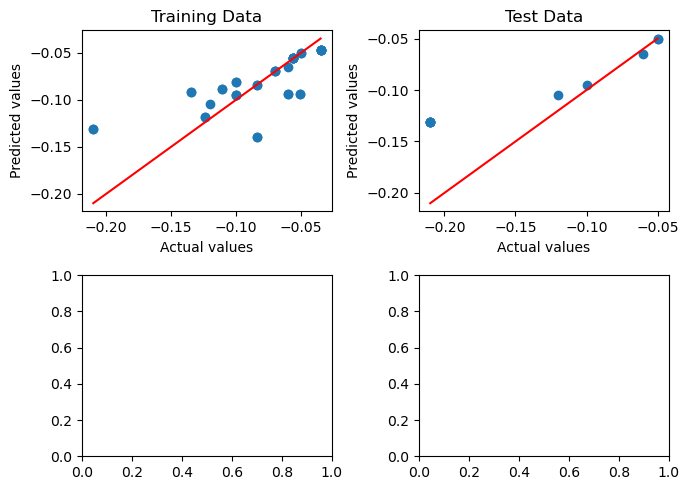

[b] Epoch [400/2000], Loss: 0.0008
Train R²:  0.56558
Test R² :  0.38598


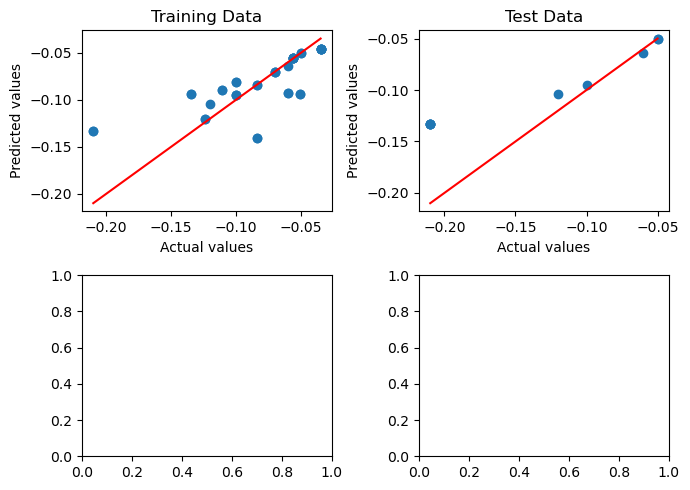

[b] Epoch [420/2000], Loss: 0.0007
Train R²:  0.57870
Test R² :  0.41061


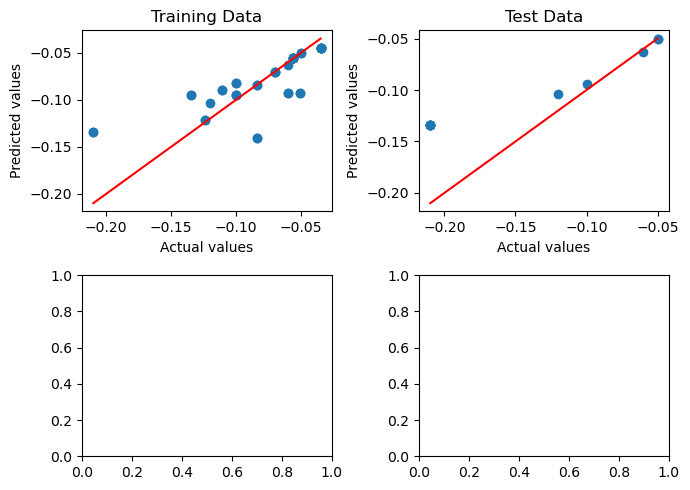

[b] Epoch [440/2000], Loss: 0.0007
Train R²:  0.59125
Test R² :  0.43219


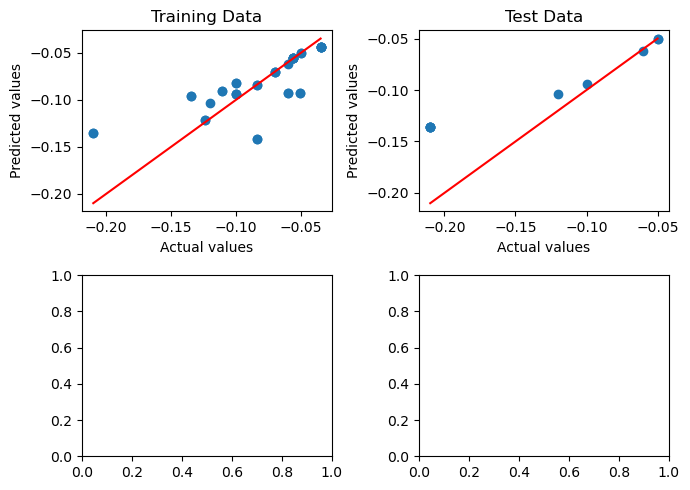

[b] Epoch [460/2000], Loss: 0.0007
Train R²:  0.60334
Test R² :  0.45177


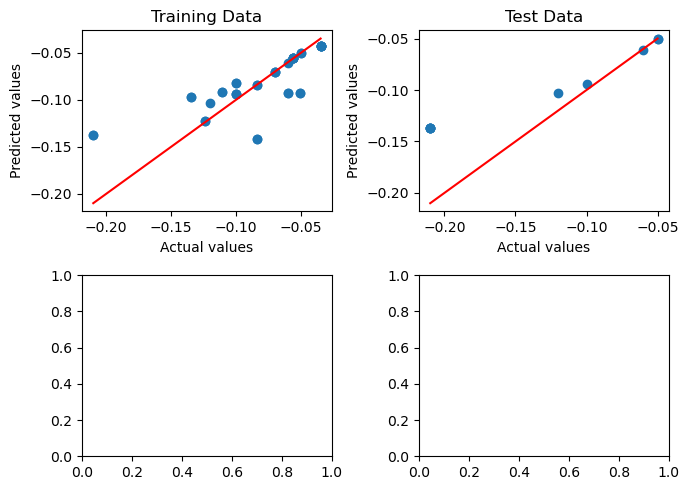

[b] Epoch [480/2000], Loss: 0.0007
Train R²:  0.61537
Test R² :  0.46593


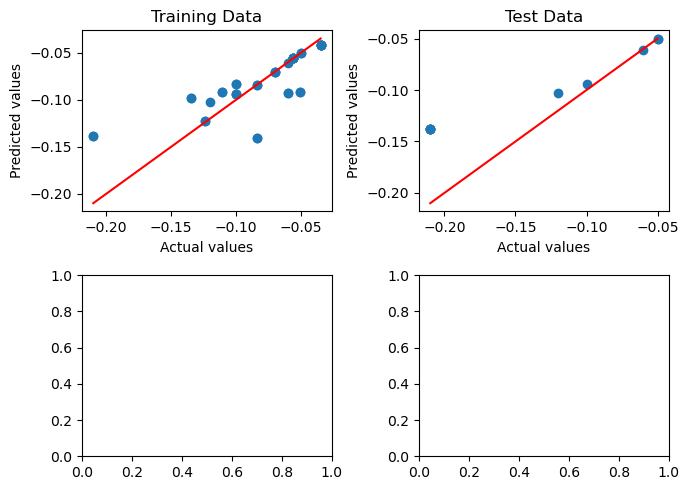

[b] Epoch [500/2000], Loss: 0.0006
Train R²:  0.62744
Test R² :  0.48721


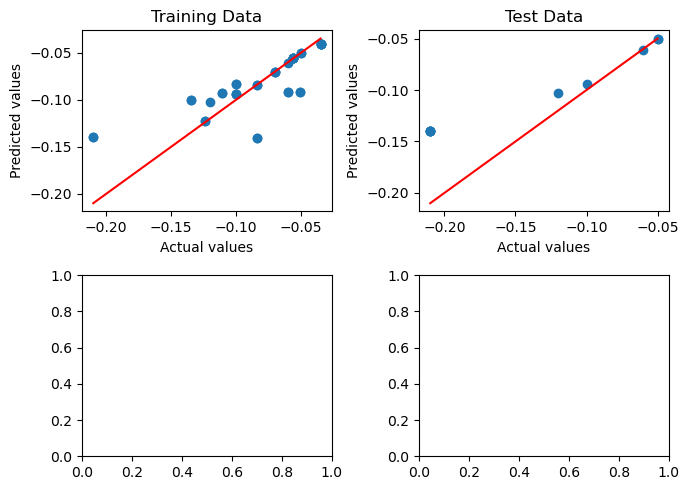

[b] Epoch [520/2000], Loss: 0.0006
Train R²:  0.63963
Test R² :  0.50142


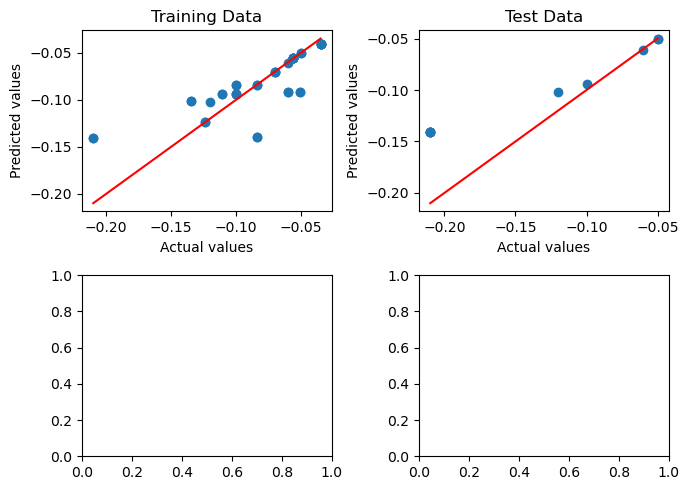

[b] Epoch [540/2000], Loss: 0.0006
Train R²:  0.65162
Test R² :  0.50937


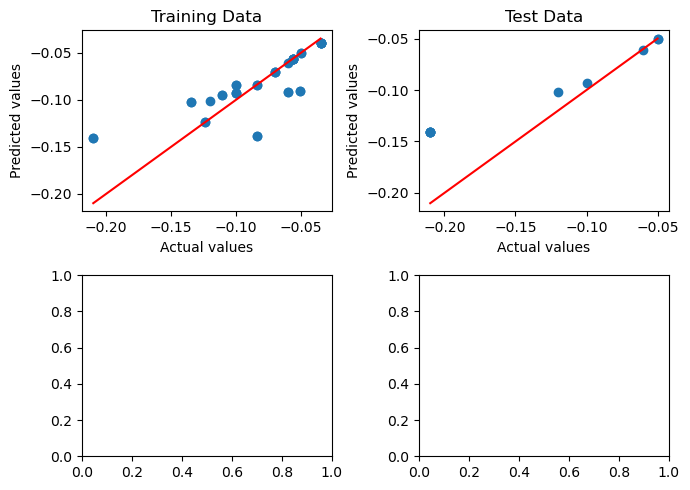

[b] Epoch [560/2000], Loss: 0.0006
Train R²:  0.66372
Test R² :  0.52824


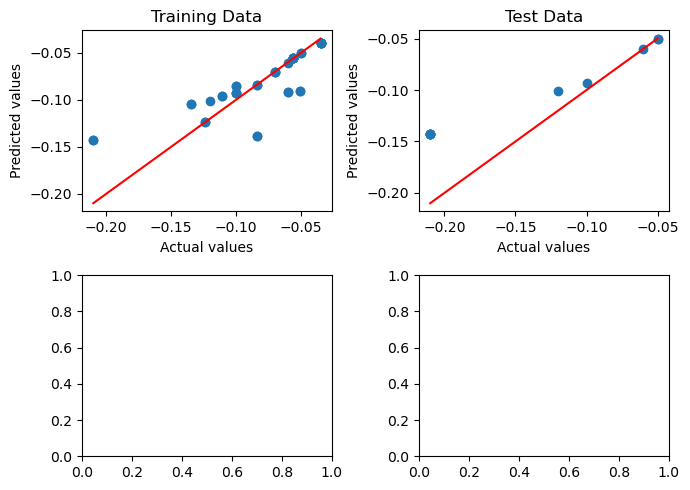

[b] Epoch [580/2000], Loss: 0.0006
Train R²:  0.67558
Test R² :  0.53392


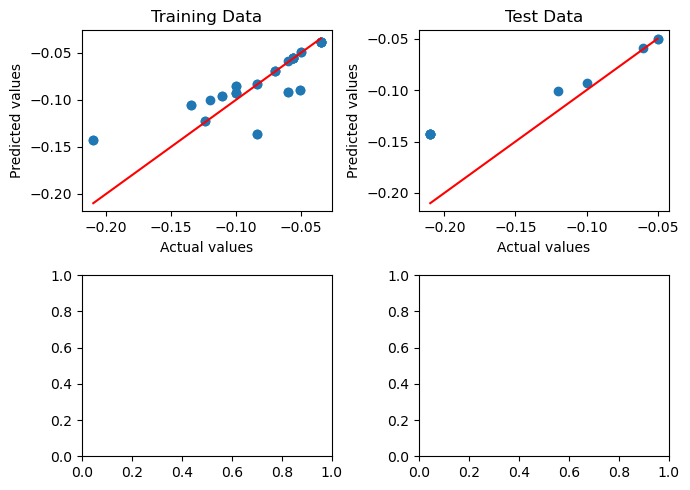

[b] Epoch [600/2000], Loss: 0.0005
Train R²:  0.68759
Test R² :  0.54953


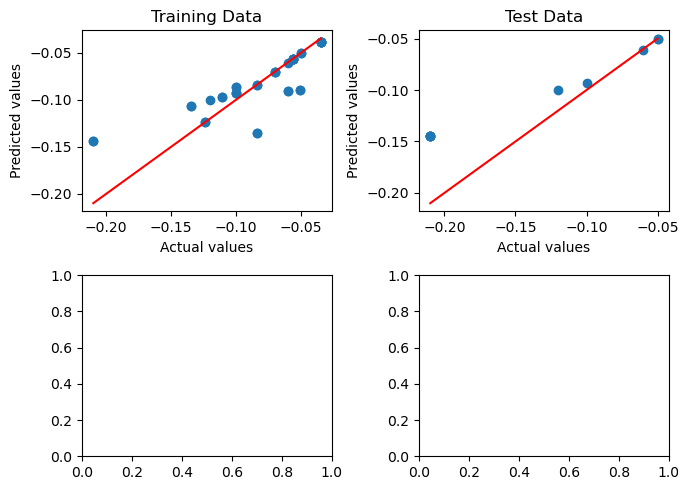

[b] Epoch [620/2000], Loss: 0.0005
Train R²:  0.69917
Test R² :  0.55316


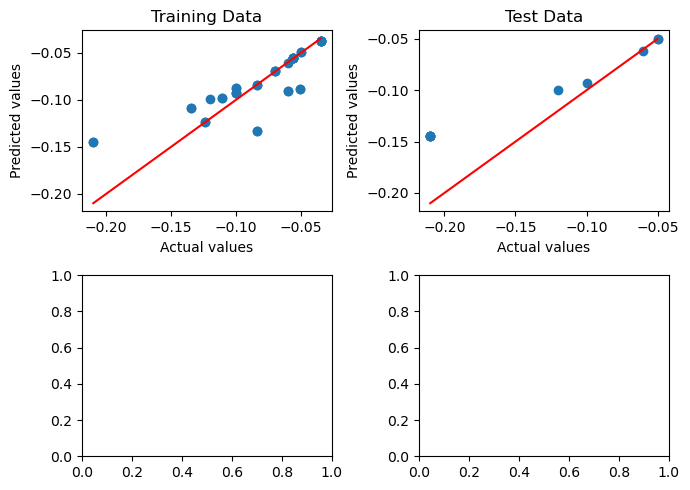

[b] Epoch [640/2000], Loss: 0.0005
Train R²:  0.71145
Test R² :  0.57864


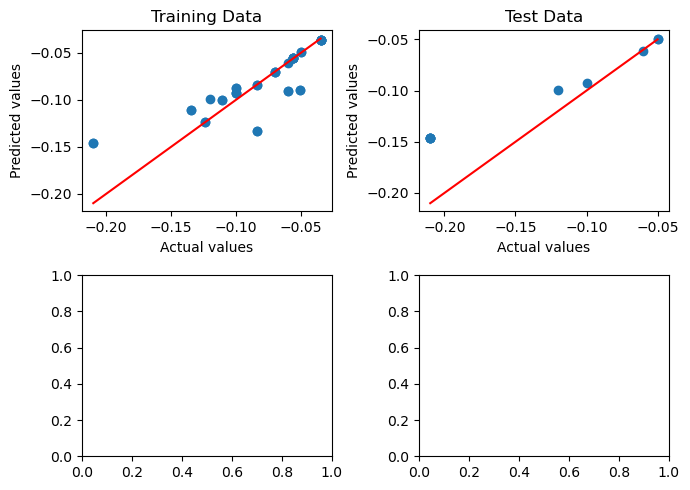

[b] Epoch [660/2000], Loss: 0.0005
Train R²:  0.72088
Test R² :  0.56678


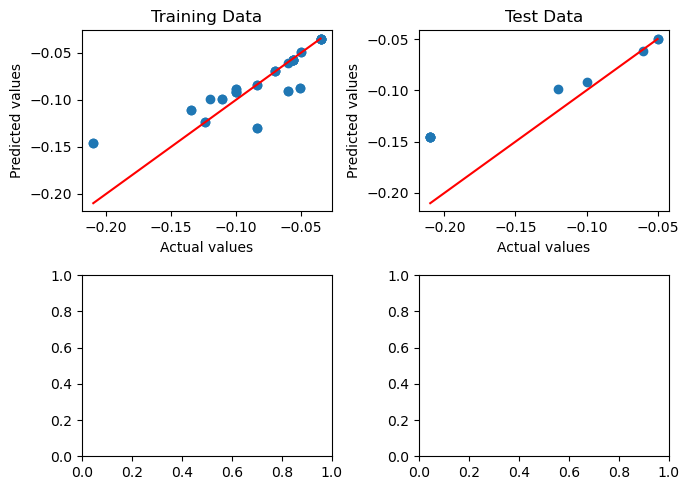

[b] Epoch [680/2000], Loss: 0.0005
Train R²:  0.72907
Test R² :  0.54952


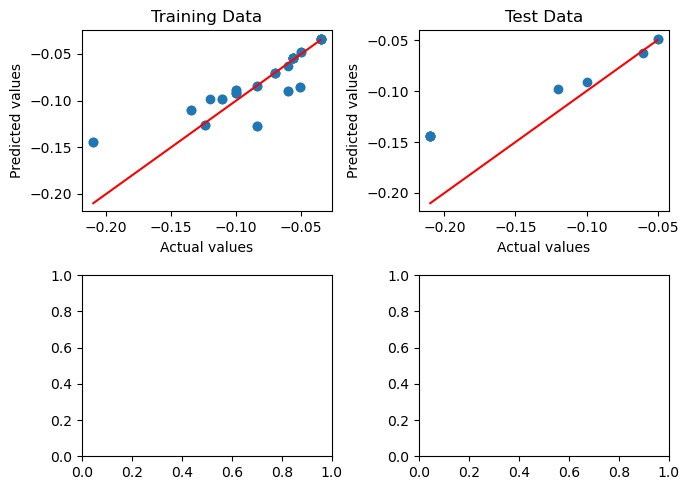

[b] Epoch [700/2000], Loss: 0.0005
Train R²:  0.74154
Test R² :  0.62156


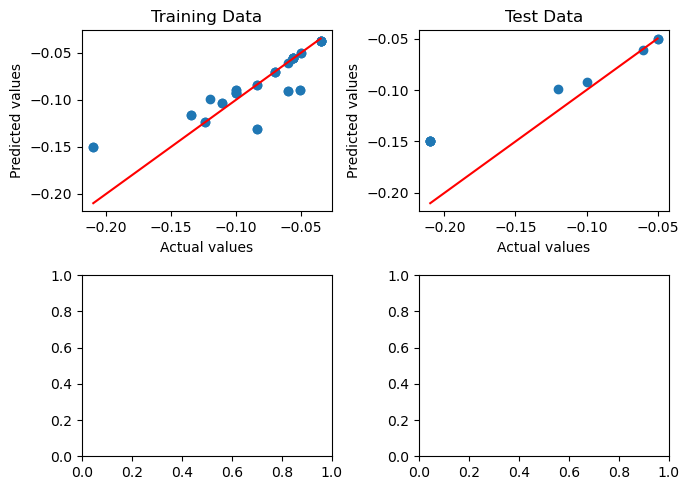

[b] Epoch [720/2000], Loss: 0.0004
Train R²:  0.75128
Test R² :  0.59828


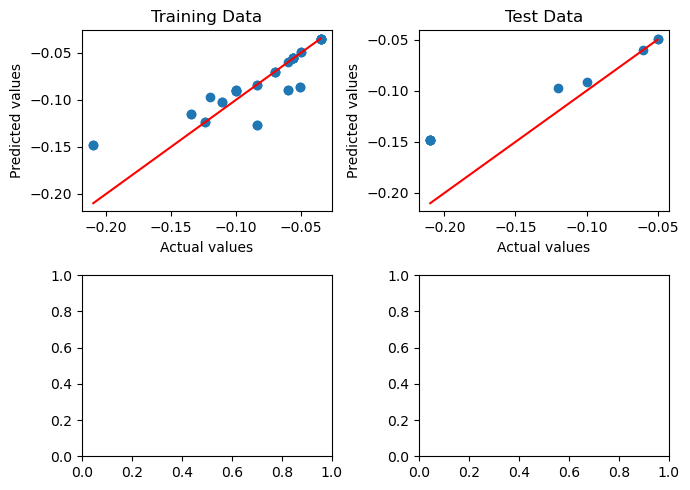

[b] Epoch [740/2000], Loss: 0.0004
Train R²:  0.76122
Test R² :  0.62264


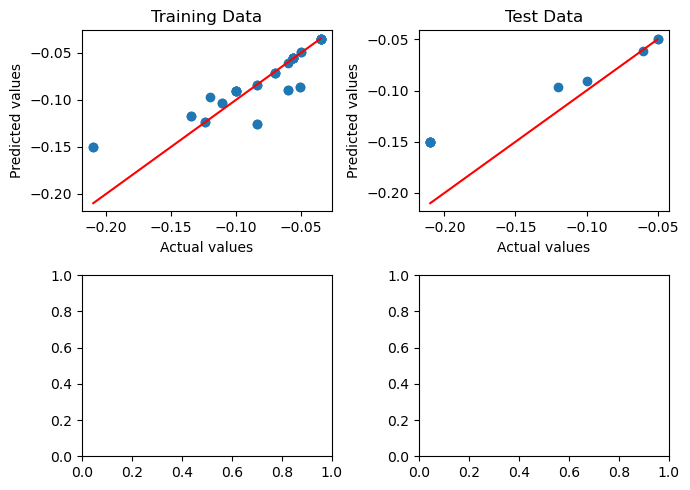

[b] Epoch [760/2000], Loss: 0.0004
Train R²:  0.77082
Test R² :  0.63733


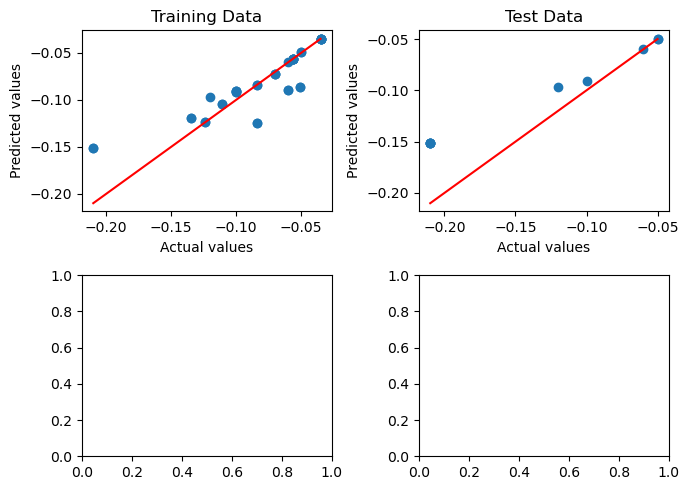

[b] Epoch [780/2000], Loss: 0.0004
Train R²:  0.77892
Test R² :  0.65036


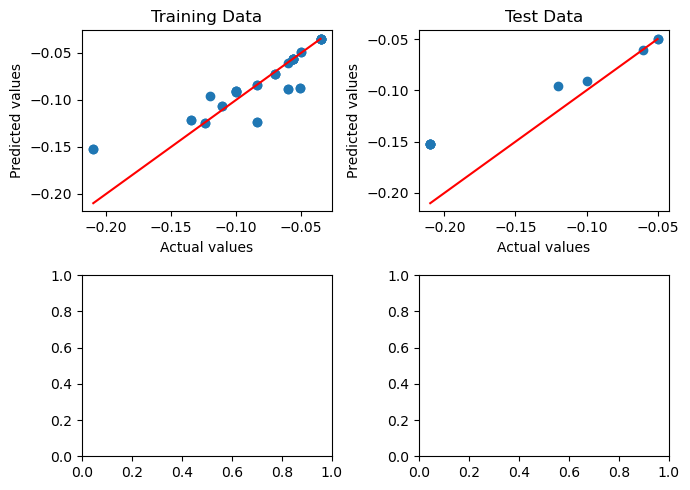

[b] Epoch [800/2000], Loss: 0.0004
Train R²:  0.78723
Test R² :  0.65317


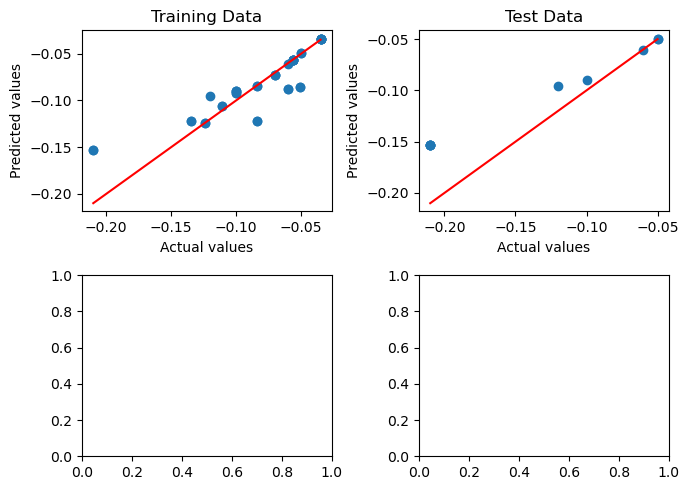

[b] Epoch [820/2000], Loss: 0.0004
Train R²:  0.79496
Test R² :  0.65518


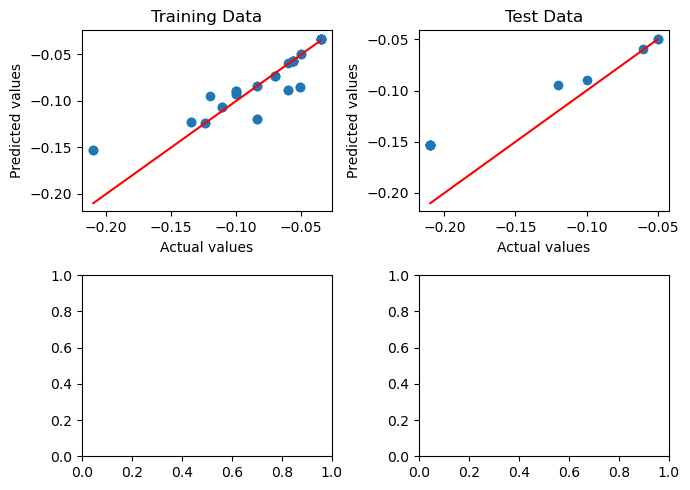

[b] Epoch [840/2000], Loss: 0.0003
Train R²:  0.80271
Test R² :  0.66643


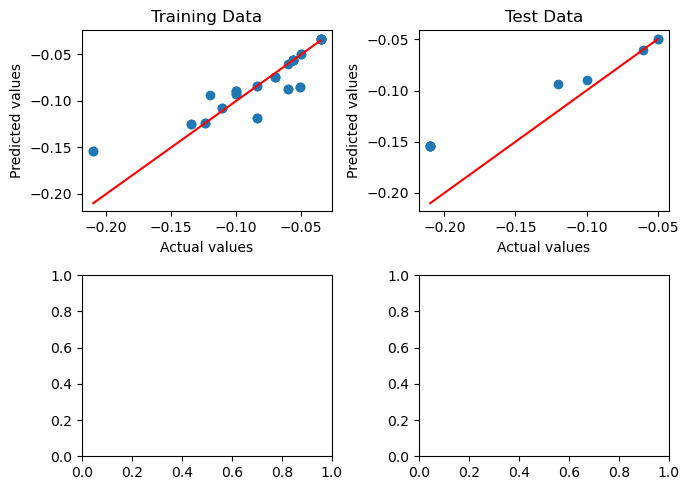

[b] Epoch [860/2000], Loss: 0.0003
Train R²:  0.80941
Test R² :  0.68466


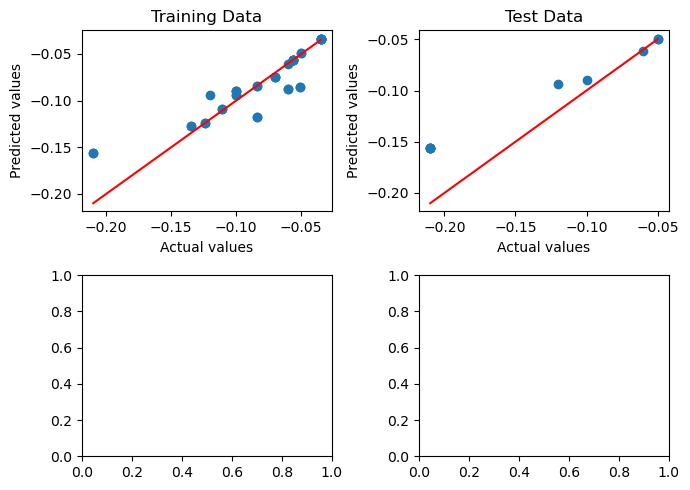

[b] Epoch [880/2000], Loss: 0.0003
Train R²:  0.81580
Test R² :  0.68835


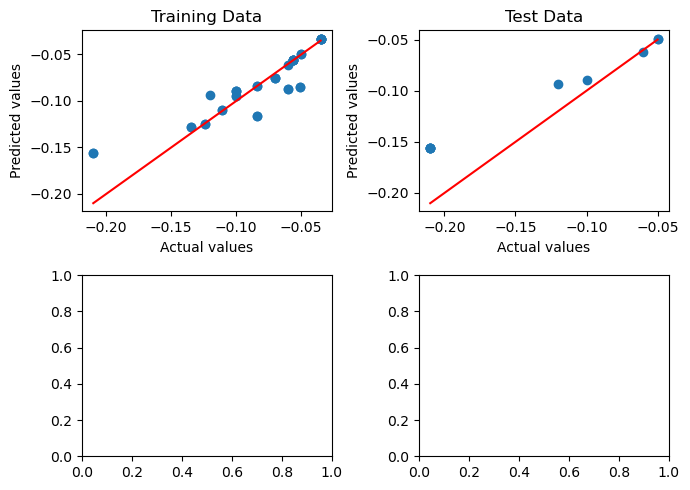

[b] Epoch [900/2000], Loss: 0.0003
Train R²:  0.82250
Test R² :  0.69992


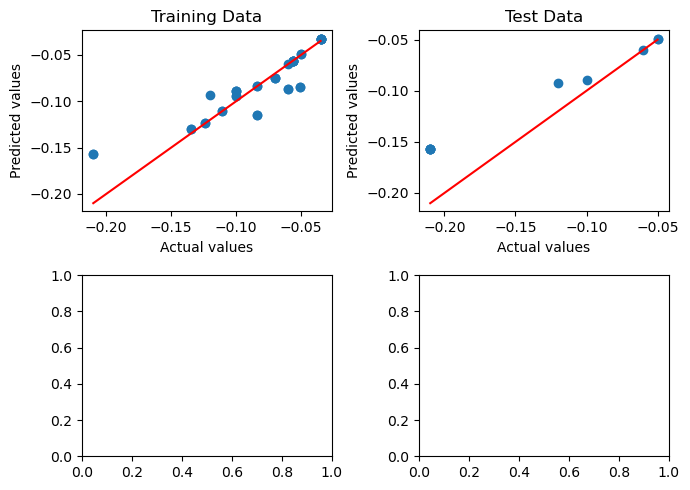

[b] Epoch [920/2000], Loss: 0.0003
Train R²:  0.82806
Test R² :  0.70296


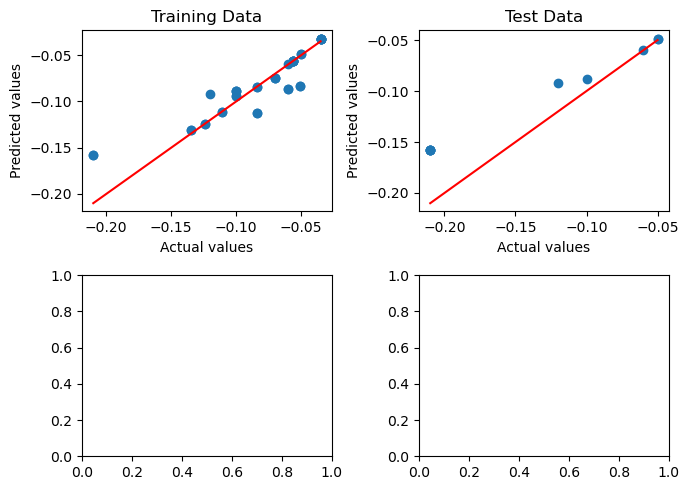

[b] Epoch [940/2000], Loss: 0.0003
Train R²:  0.83327
Test R² :  0.71353


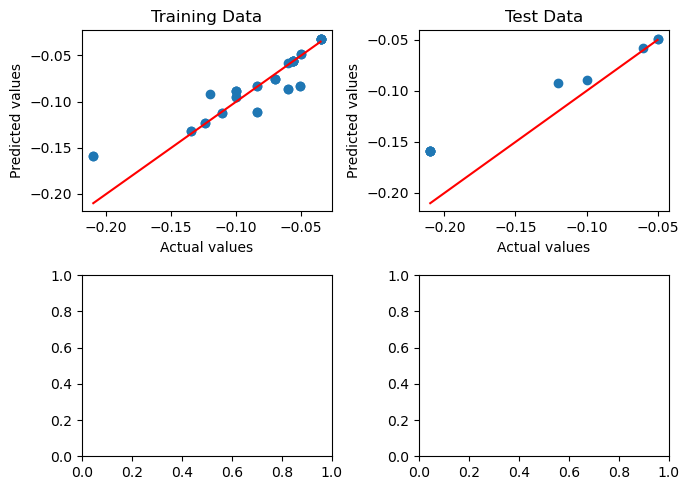

[b] Epoch [960/2000], Loss: 0.0003
Train R²:  0.83861
Test R² :  0.73041


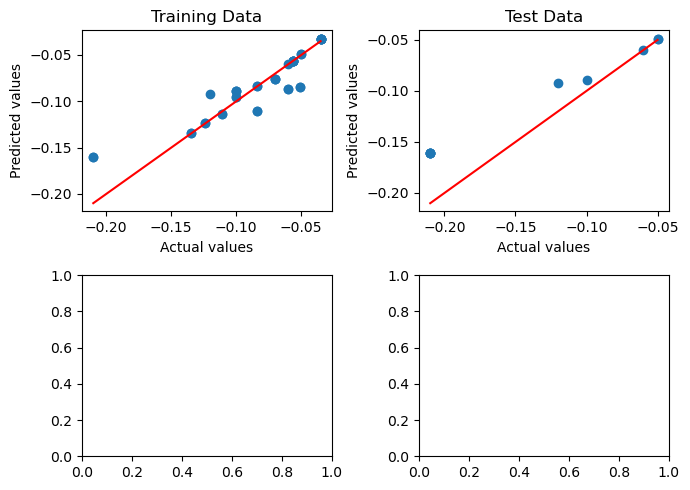

[b] Epoch [980/2000], Loss: 0.0003
Train R²:  0.84296
Test R² :  0.71194


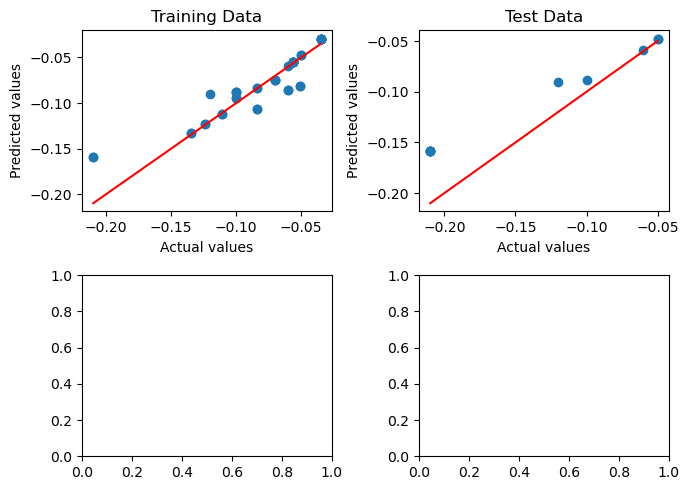

[b] Epoch [1000/2000], Loss: 0.0003
Train R²:  0.84769
Test R² :  0.74767


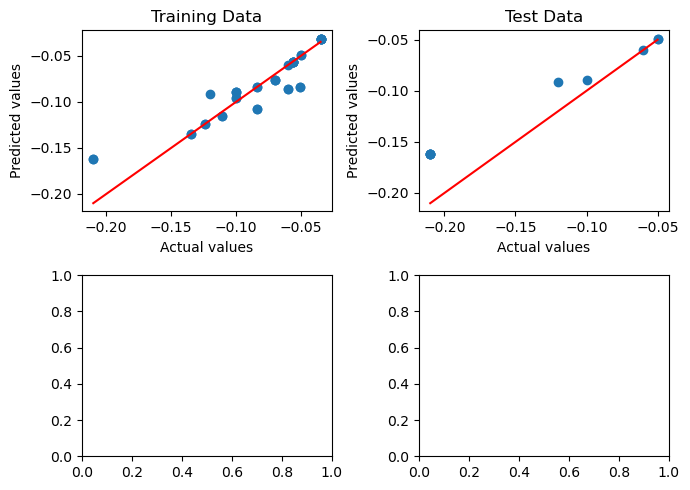

[b] Epoch [1020/2000], Loss: 0.0003
Train R²:  0.85212
Test R² :  0.74650


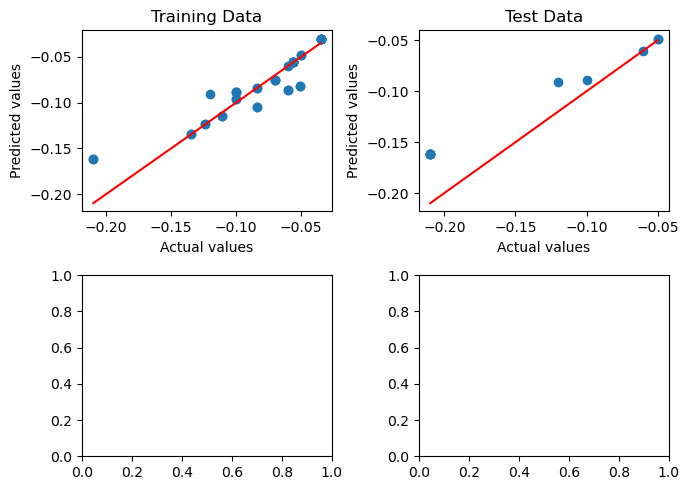

[b] Epoch [1040/2000], Loss: 0.0003
Train R²:  0.84599
Test R² :  0.78149


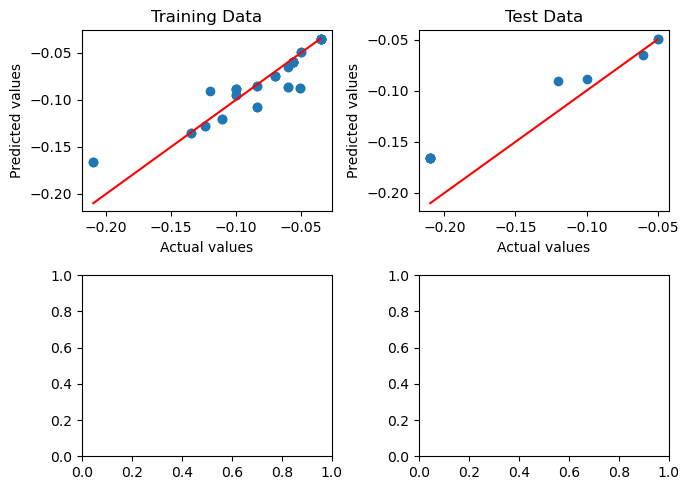

[b] Epoch [1060/2000], Loss: 0.0002
Train R²:  0.86451
Test R² :  0.80835


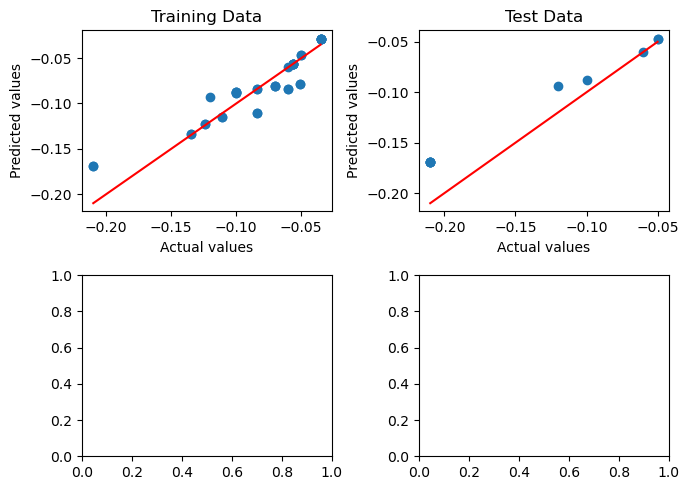

[b] Epoch [1080/2000], Loss: 0.0002
Train R²:  0.87173
Test R² :  0.83760


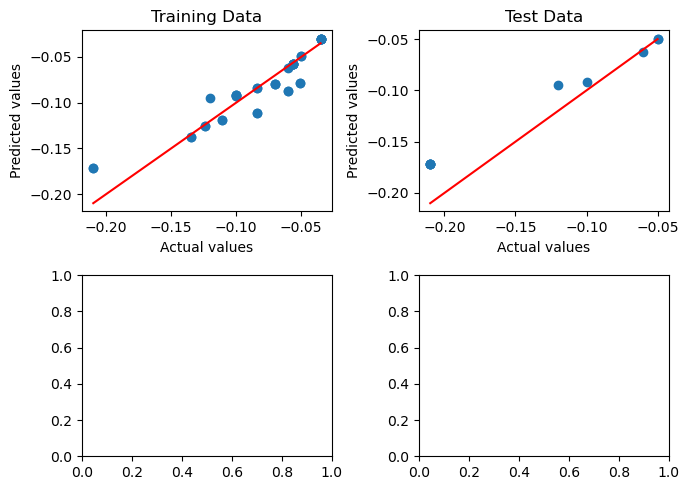

[b] Epoch [1100/2000], Loss: 0.0002
Train R²:  0.87563
Test R² :  0.78628


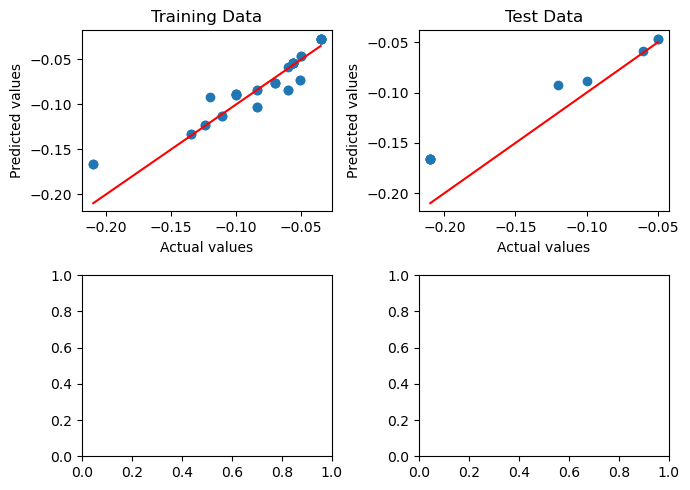

[b] Epoch [1120/2000], Loss: 0.0002
Train R²:  0.88238
Test R² :  0.81290


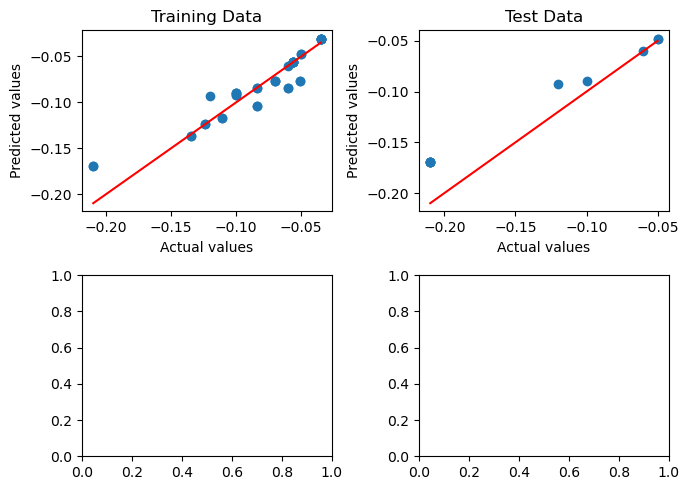

[b] Epoch [1140/2000], Loss: 0.0002
Train R²:  0.88524
Test R² :  0.80455


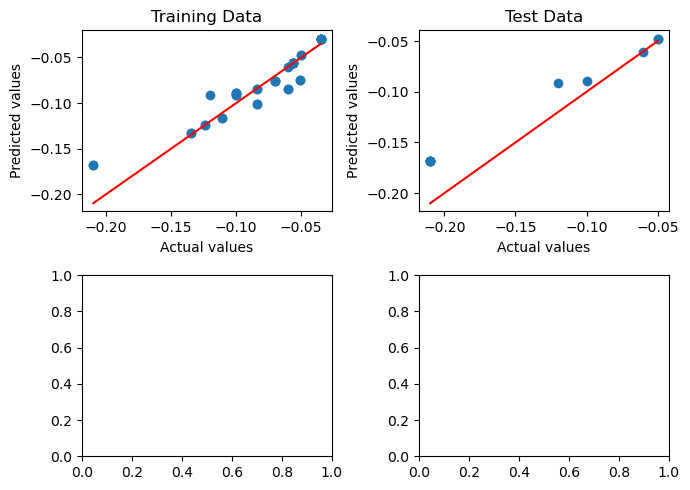

[b] Epoch [1160/2000], Loss: 0.0002
Train R²:  0.88678
Test R² :  0.84279


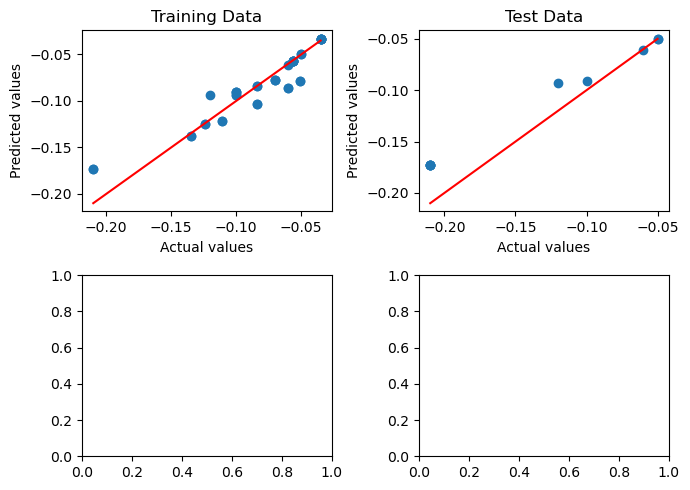

[b] Epoch [1180/2000], Loss: 0.0002
Train R²:  0.89138
Test R² :  0.84031


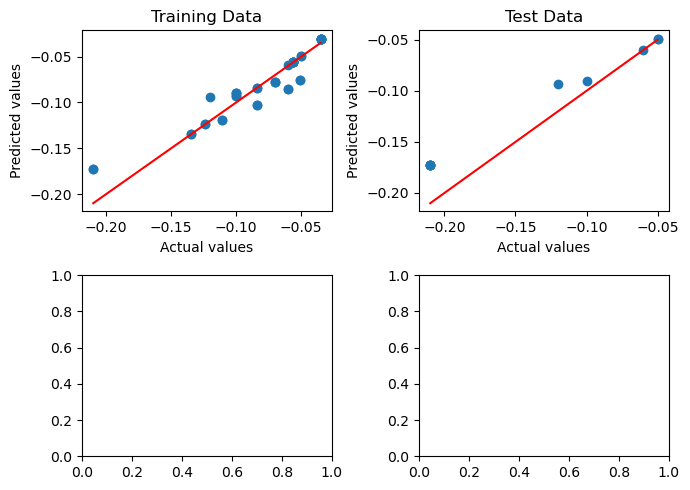

[b] Epoch [1200/2000], Loss: 0.0002
Train R²:  0.89067
Test R² :  0.81459


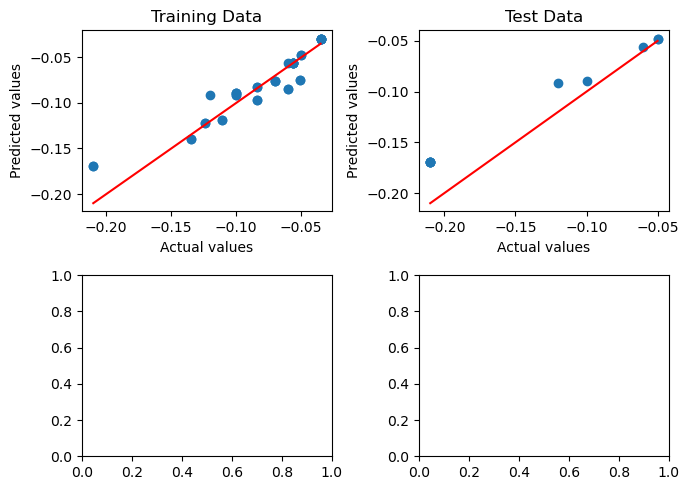

[b] Epoch [1220/2000], Loss: 0.0002
Train R²:  0.89113
Test R² :  0.81671


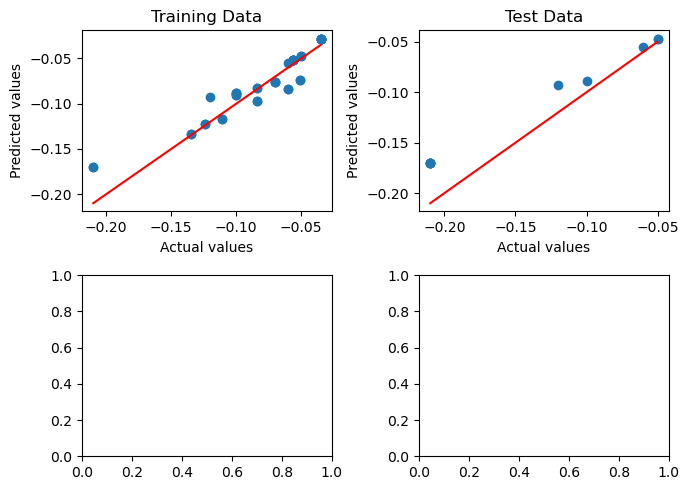

[b] Epoch [1240/2000], Loss: 0.0002
Train R²:  0.89071
Test R² :  0.87528


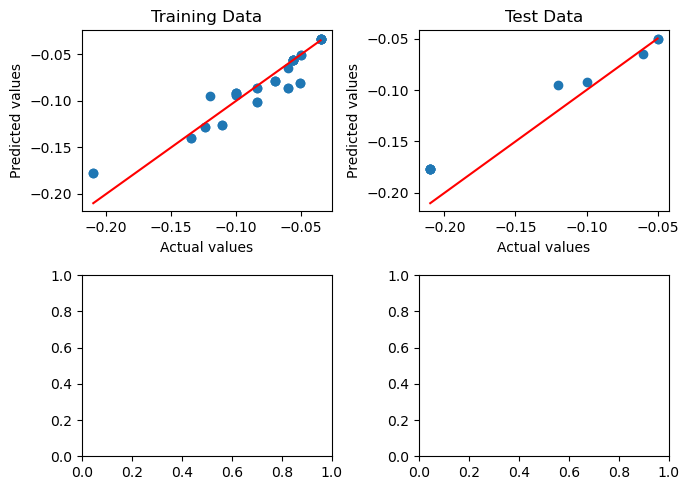

[b] Epoch [1260/2000], Loss: 0.0002
Train R²:  0.89978
Test R² :  0.86729


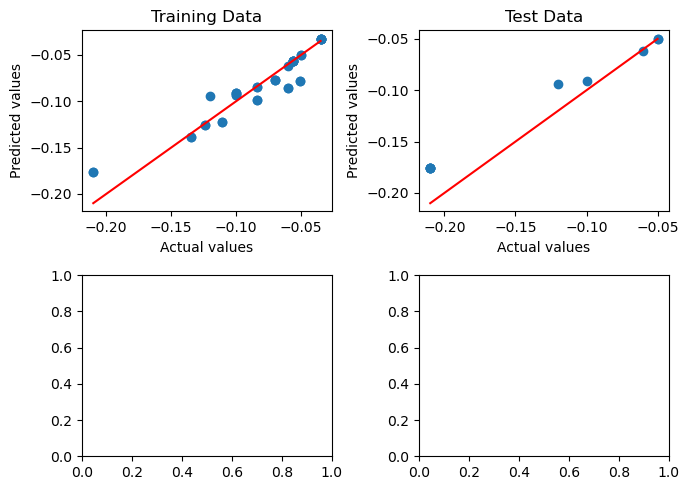

[b] Epoch [1280/2000], Loss: 0.0002
Train R²:  0.90211
Test R² :  0.85746


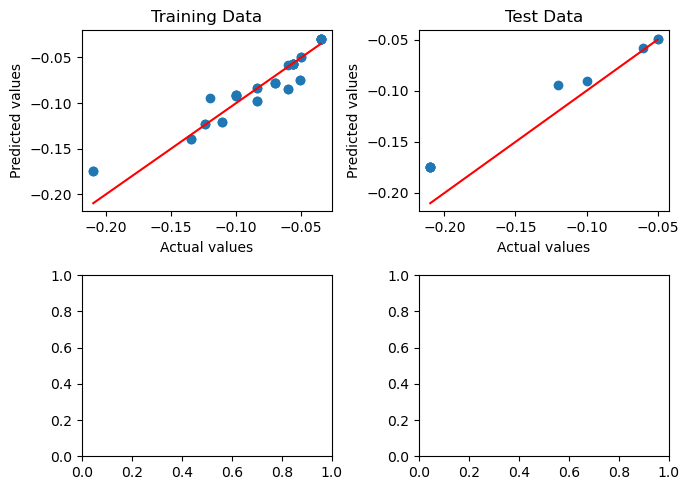

[b] Epoch [1300/2000], Loss: 0.0003
Train R²:  0.83493
Test R² :  0.70415


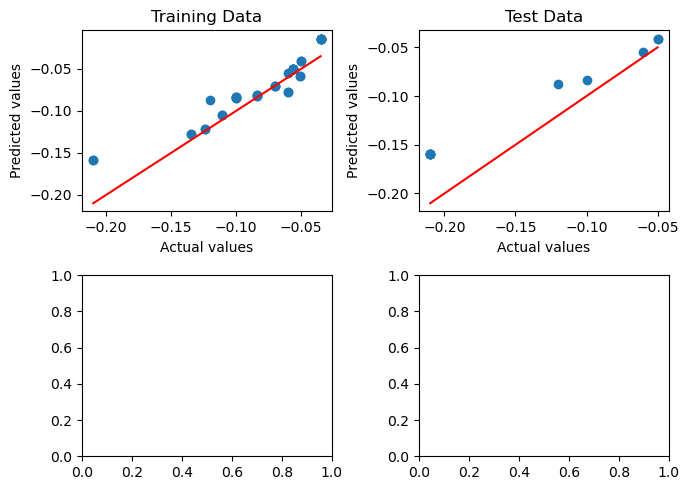

[b] Epoch [1320/2000], Loss: 0.0002
Train R²:  0.89744
Test R² :  0.81225


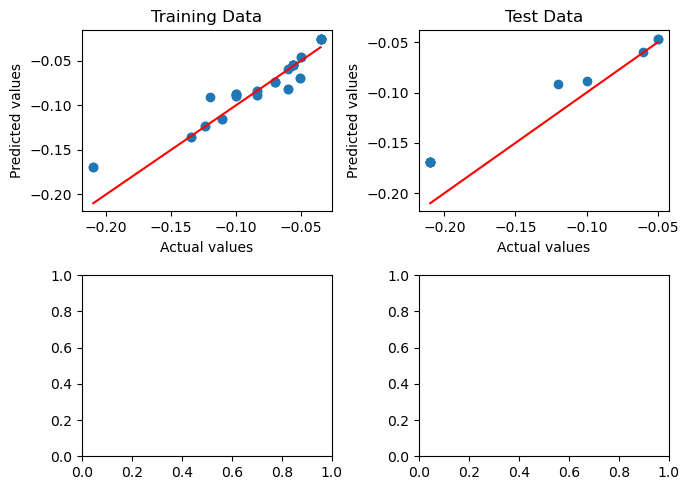

[b] Epoch [1340/2000], Loss: 0.0002
Train R²:  0.90042
Test R² :  0.89682


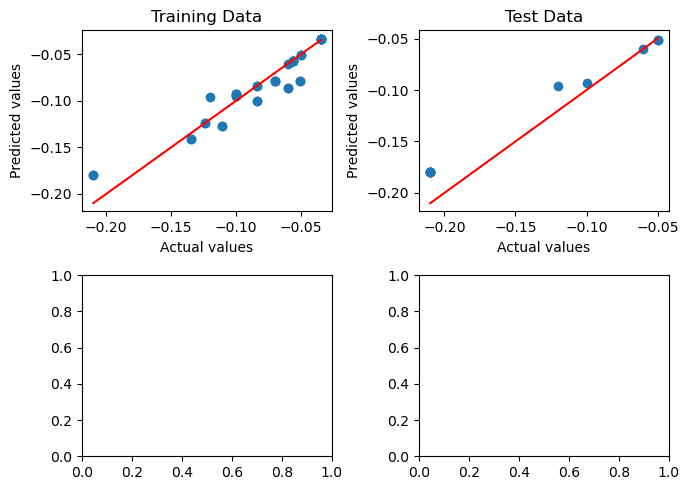

[b] Epoch [1360/2000], Loss: 0.0002
Train R²:  0.88553
Test R² :  0.91733


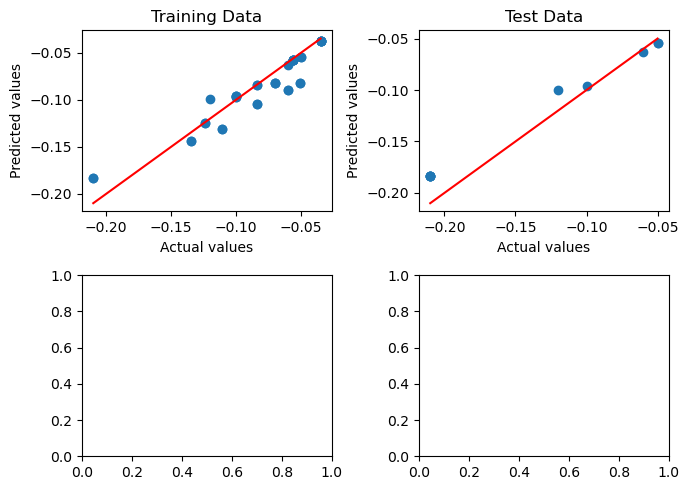

[b] Epoch [1380/2000], Loss: 0.0002
Train R²:  0.89455
Test R² :  0.91393


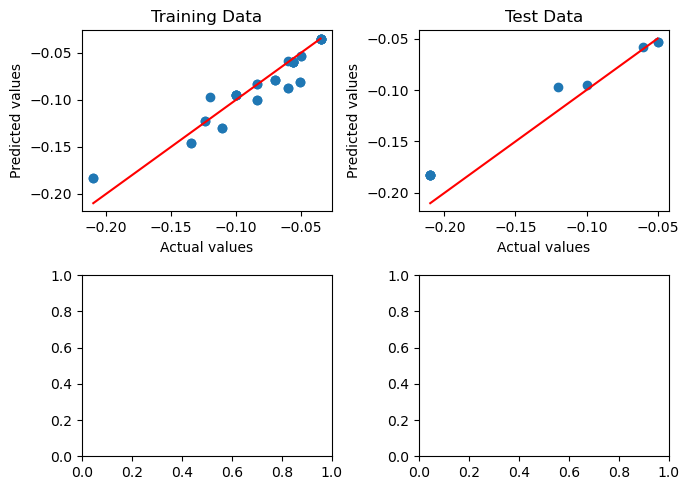

[b] Epoch [1400/2000], Loss: 0.0002
Train R²:  0.90377
Test R² :  0.83710


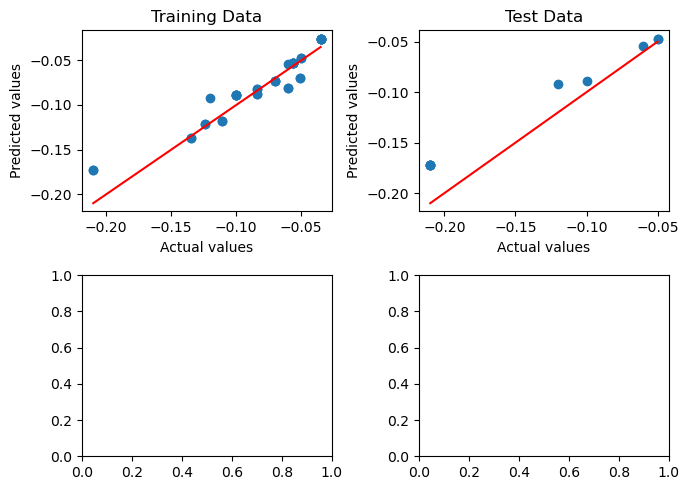

[b] Epoch [1420/2000], Loss: 0.0002
Train R²:  0.89320
Test R² :  0.80496


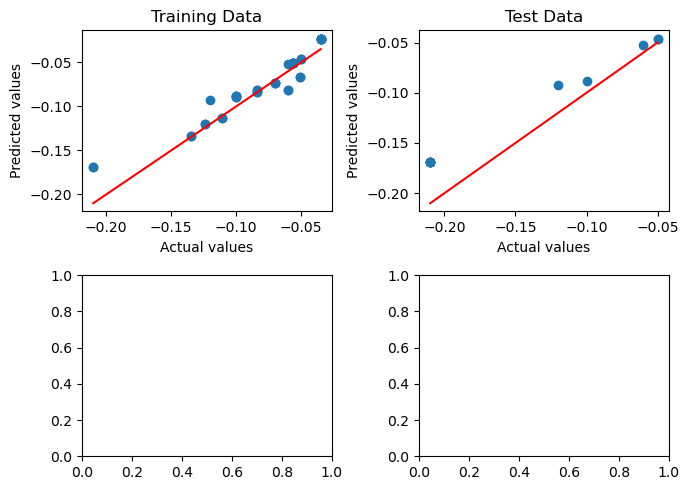

[b] Epoch [1440/2000], Loss: 0.0002
Train R²:  0.90655
Test R² :  0.90878


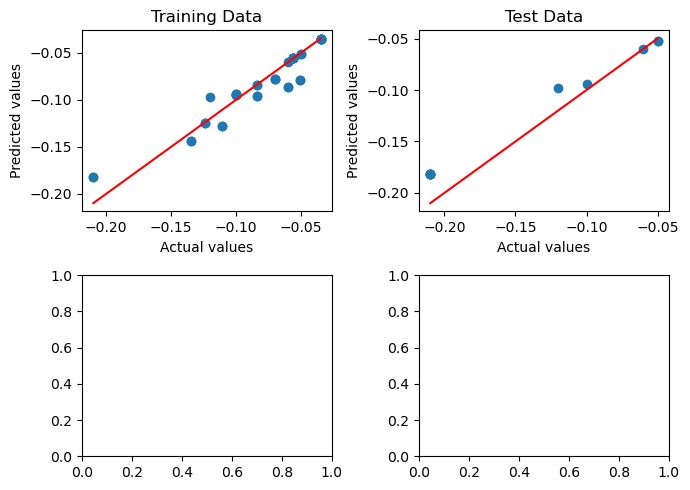

[b] Epoch [1460/2000], Loss: 0.0002
Train R²:  0.86460
Test R² :  0.95152


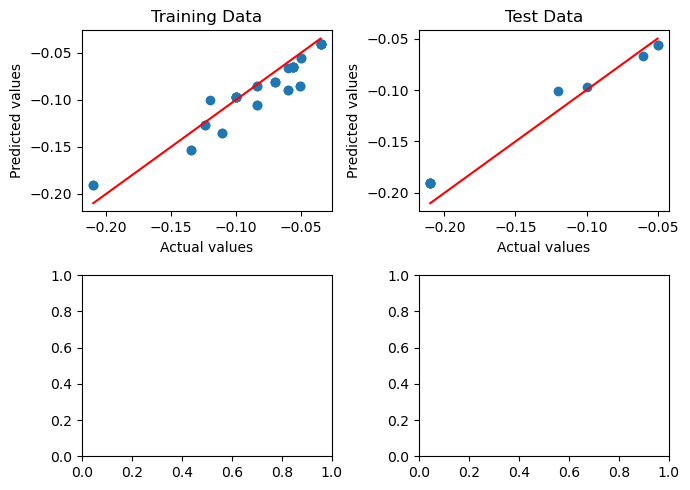

[b] Epoch [1480/2000], Loss: 0.0002
Train R²:  0.91115
Test R² :  0.91035


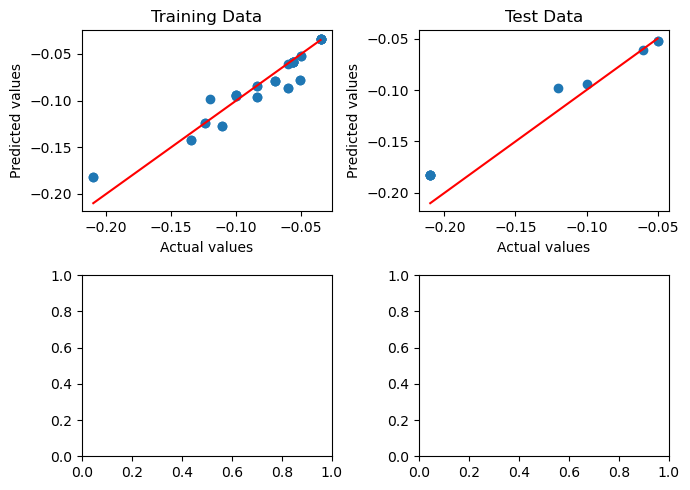

[b] Epoch [1500/2000], Loss: 0.0001
Train R²:  0.91593
Test R² :  0.89428


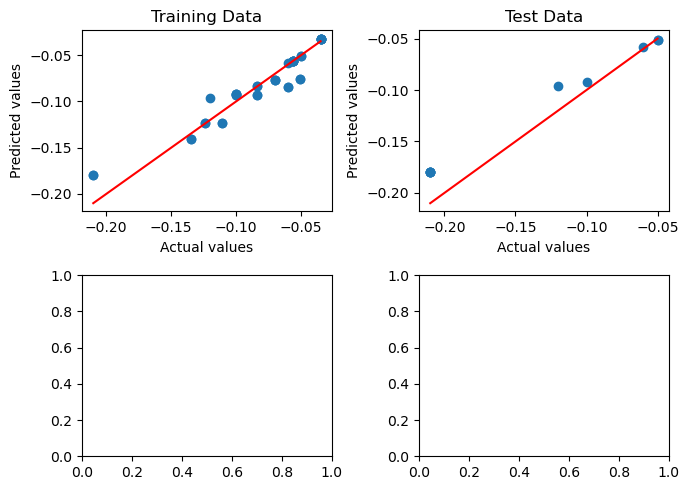

[b] Epoch [1520/2000], Loss: 0.0002
Train R²:  0.91396
Test R² :  0.86405


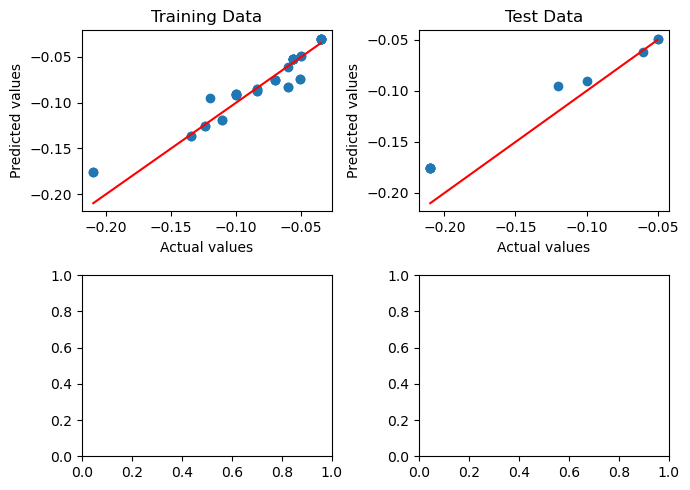

[b] Epoch [1540/2000], Loss: 0.0004
Train R²:  0.79168
Test R² :  0.67987


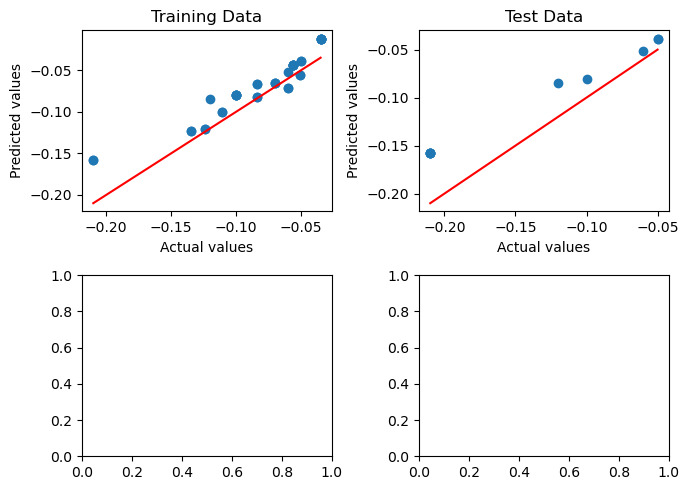

[b] Epoch [1560/2000], Loss: 0.0007
Train R²:  0.58800
Test R² :  0.49309


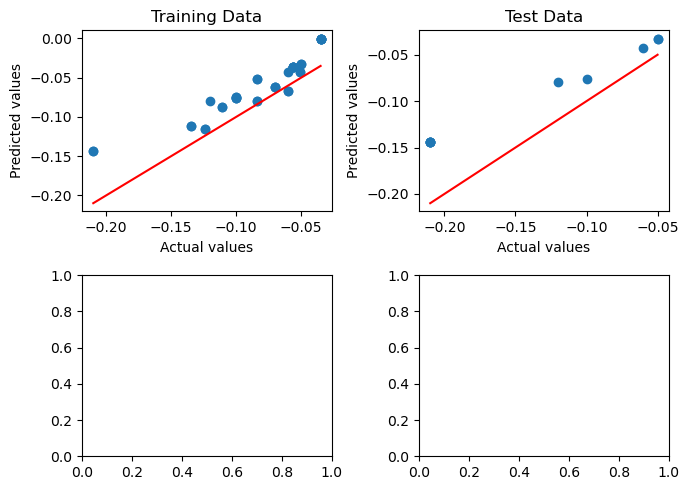

[b] Epoch [1580/2000], Loss: 0.0003
Train R²:  0.85350
Test R² :  0.75208


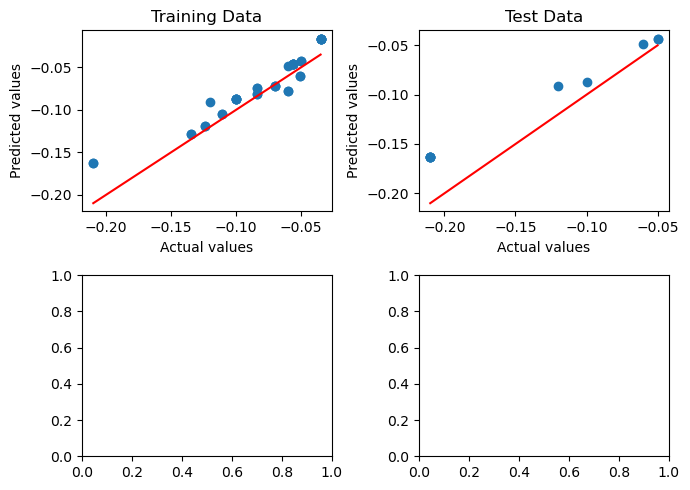

[b] Epoch [1600/2000], Loss: 0.0003
Train R²:  0.85194
Test R² :  0.76451


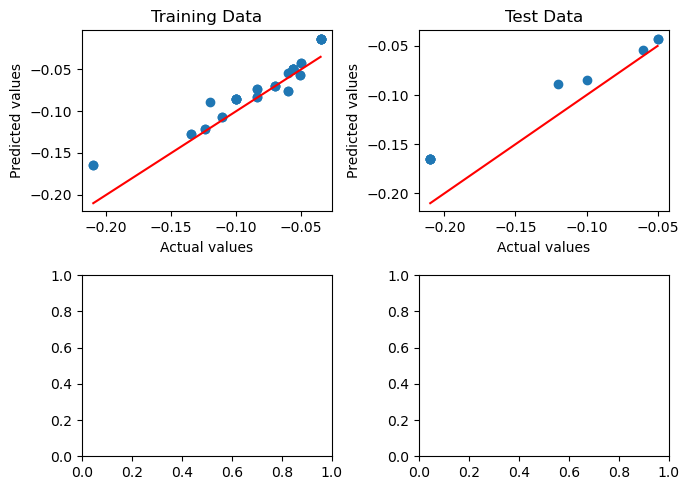

[b] Epoch [1620/2000], Loss: 0.0002
Train R²:  0.89472
Test R² :  0.95392


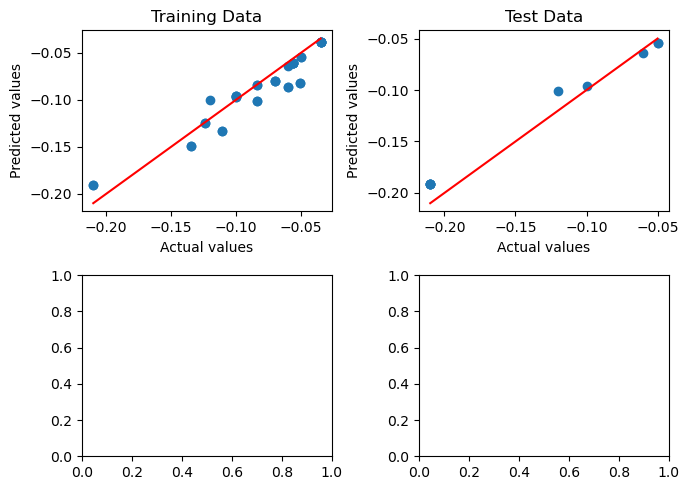

[b] Epoch [1640/2000], Loss: 0.0007
Train R²:  0.60999
Test R² :  0.97968


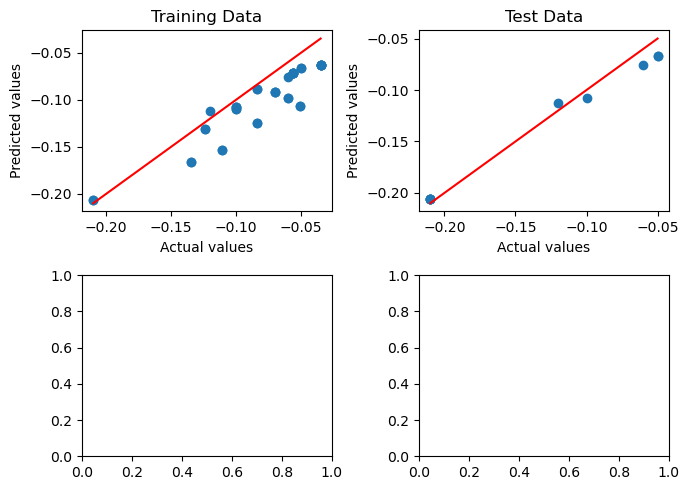

[b] Epoch [1660/2000], Loss: 0.0024
Train R²:  -0.35413
Test R² :  0.83860


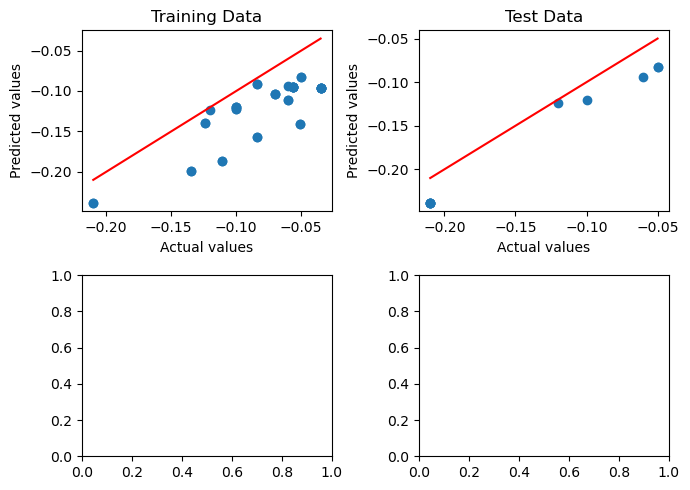

[b] Epoch [1680/2000], Loss: 0.0006
Train R²:  0.67765
Test R² :  0.58747


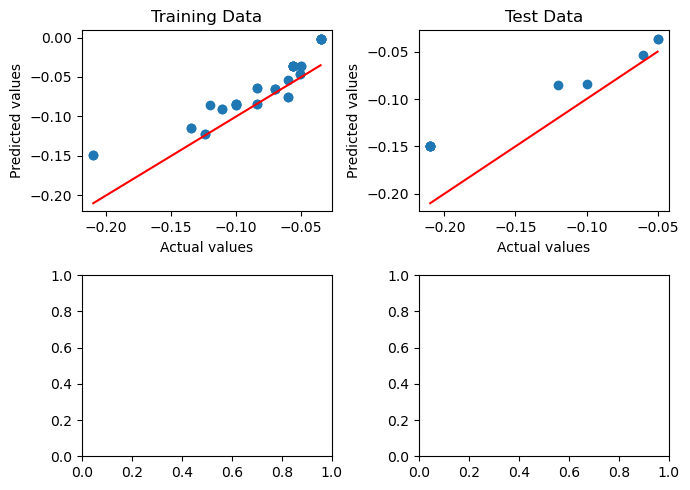

[b] Epoch [1700/2000], Loss: 0.0002
Train R²:  0.89827
Test R² :  0.83185


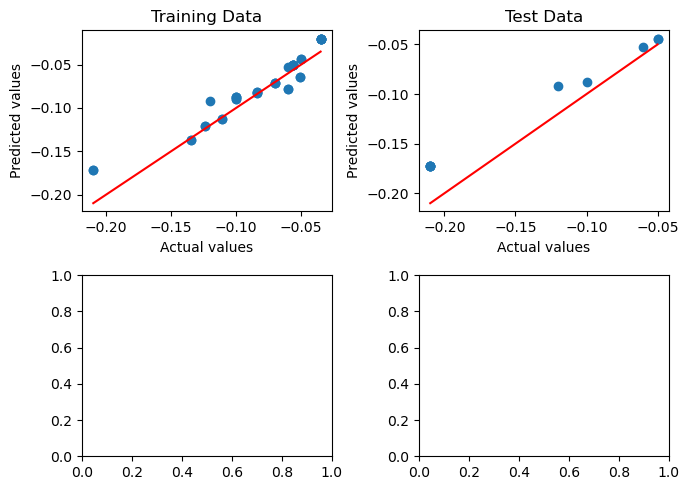

[b] Epoch [1720/2000], Loss: 0.0001
Train R²:  0.92404
Test R² :  0.88923


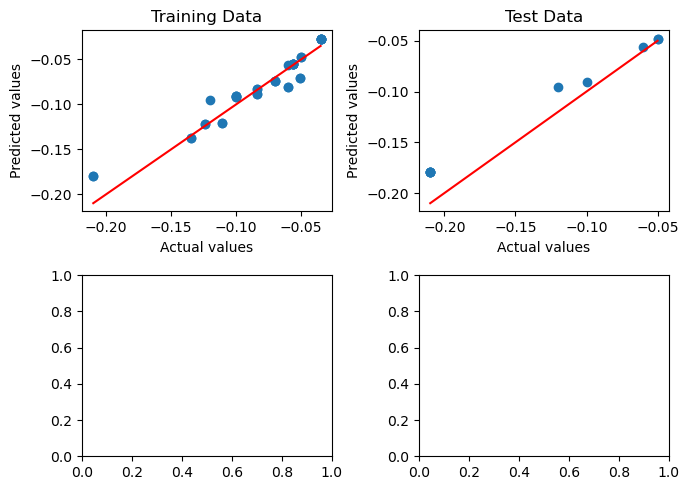

[b] Epoch [1740/2000], Loss: 0.0002
Train R²:  0.90524
Test R² :  0.83879


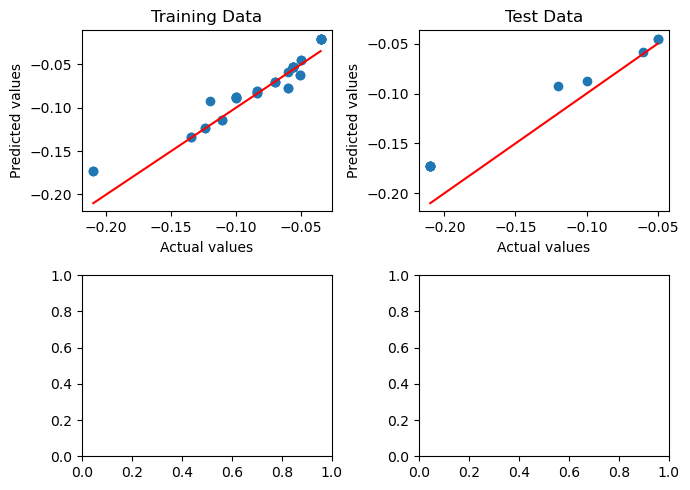

[b] Epoch [1760/2000], Loss: 0.0001
Train R²:  0.91950
Test R² :  0.94070


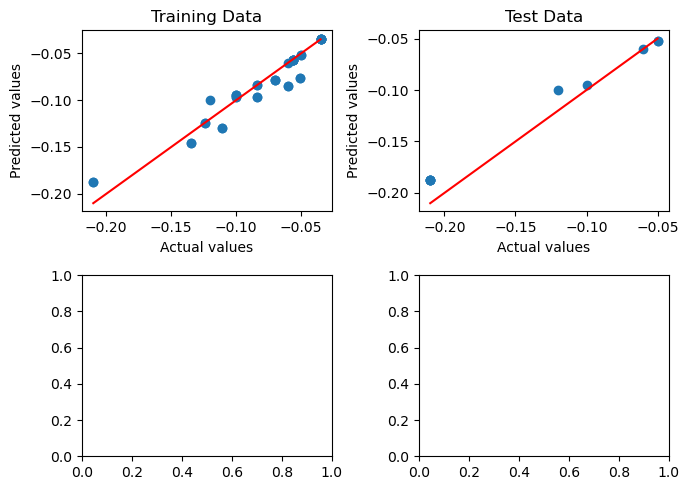

[b] Epoch [1780/2000], Loss: 0.0003
Train R²:  0.83585
Test R² :  0.95767


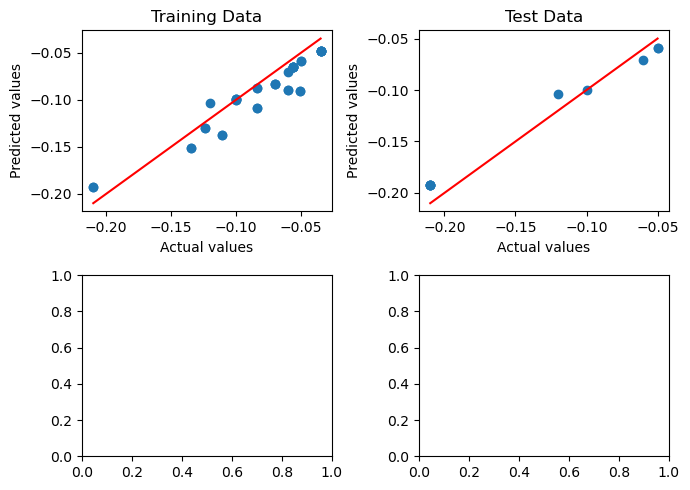

[b] Epoch [1800/2000], Loss: 0.0004
Train R²:  0.77930
Test R² :  0.96886


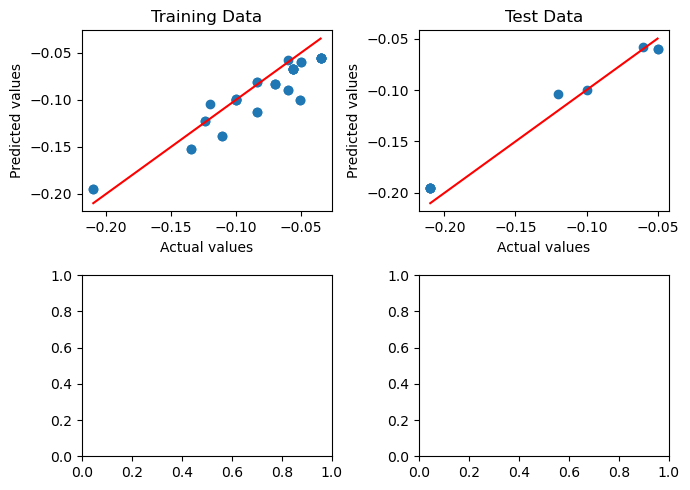

[b] Epoch [1820/2000], Loss: 0.0001
Train R²:  0.92595
Test R² :  0.91881


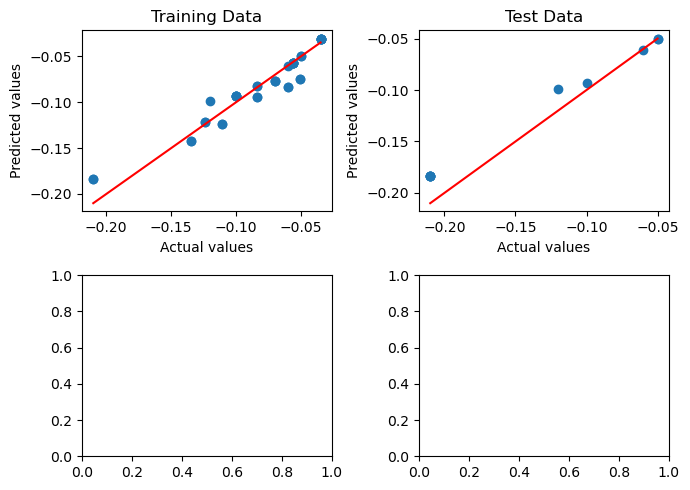

[b] Epoch [1840/2000], Loss: 0.0004
Train R²:  0.78098
Test R² :  0.98501


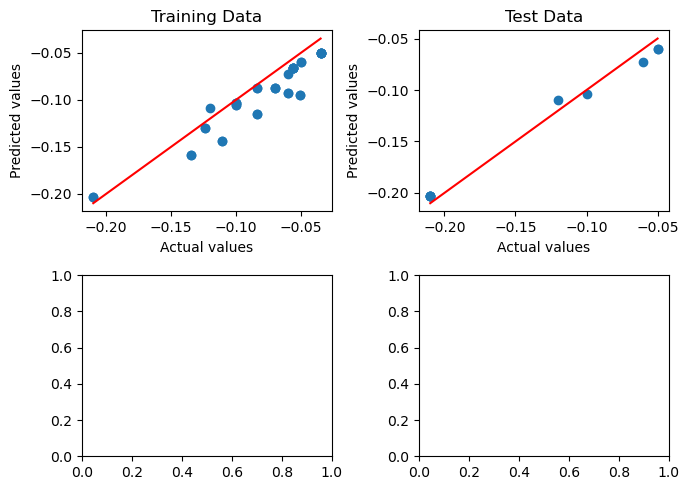

[b] Epoch [1860/2000], Loss: 0.0019
Train R²:  -0.11422
Test R² :  0.05812


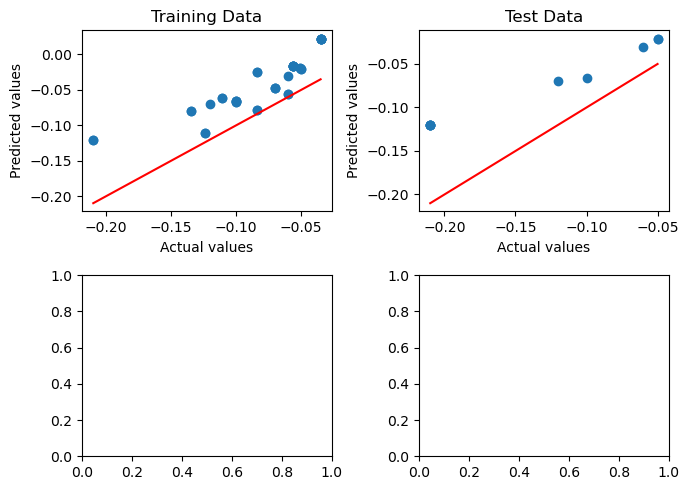

[b] Epoch [1880/2000], Loss: 0.0007
Train R²:  0.57056
Test R² :  0.50750


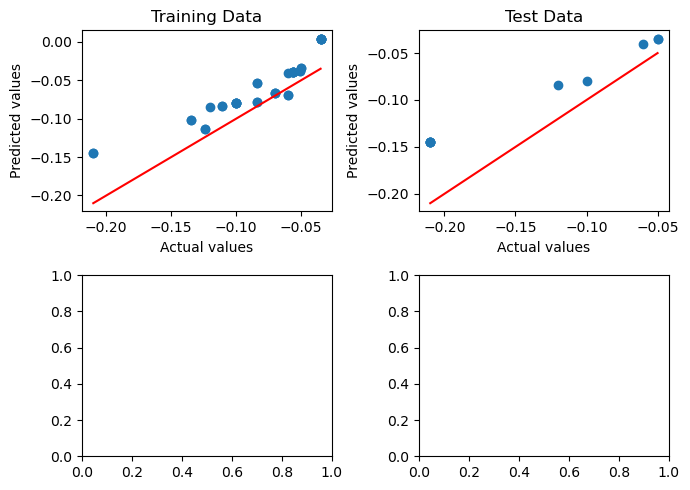

[b] Epoch [1900/2000], Loss: 0.0006
Train R²:  0.67379
Test R² :  0.61230


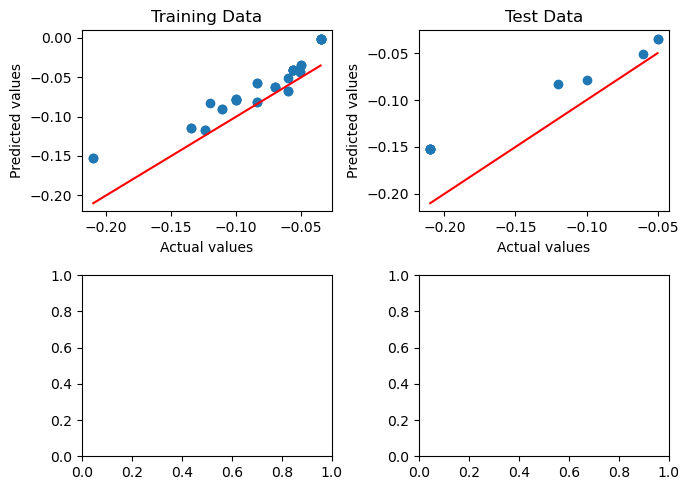

[b] Epoch [1920/2000], Loss: 0.0002
Train R²:  0.89528
Test R² :  0.96216


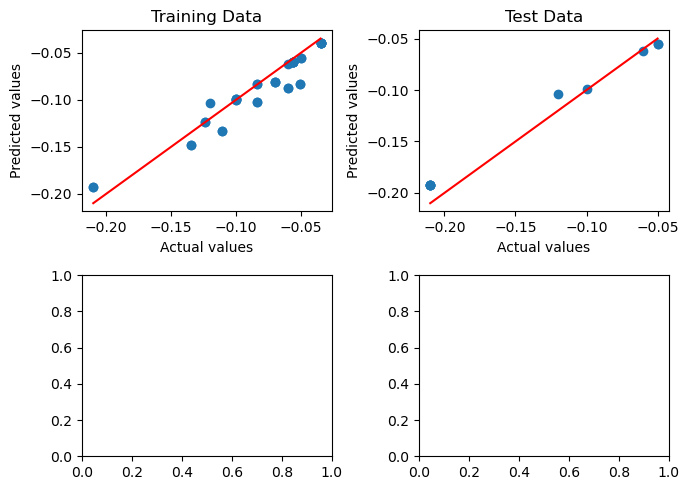

[b] Epoch [1940/2000], Loss: 0.0002
Train R²:  0.86461
Test R² :  0.79325


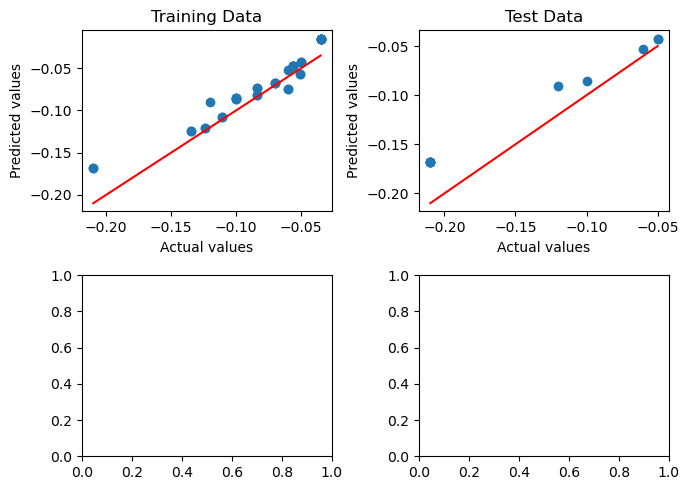

[b] Epoch [1960/2000], Loss: 0.0002
Train R²:  0.88403
Test R² :  0.82189


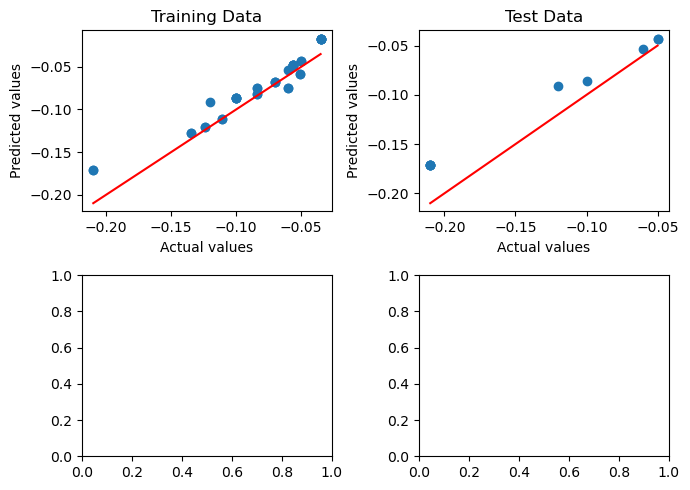

[b] Epoch [1980/2000], Loss: 0.0001
Train R²:  0.92853
Test R² :  0.90659


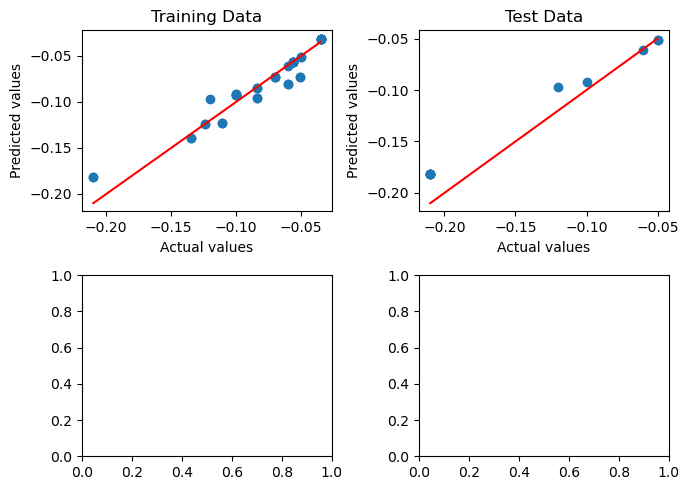

[b] Epoch [2000/2000], Loss: 0.0008
Train R²:  0.53881
Test R² :  0.50178


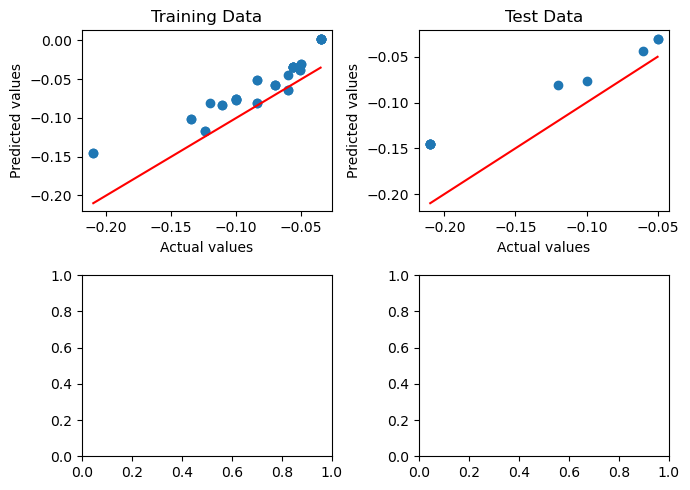

In [8]:
DNN(5)

[Epsilonf] Epoch [20/2000], Loss: 0.2644
Train R²:  0.75490
Test R² :  0.64826


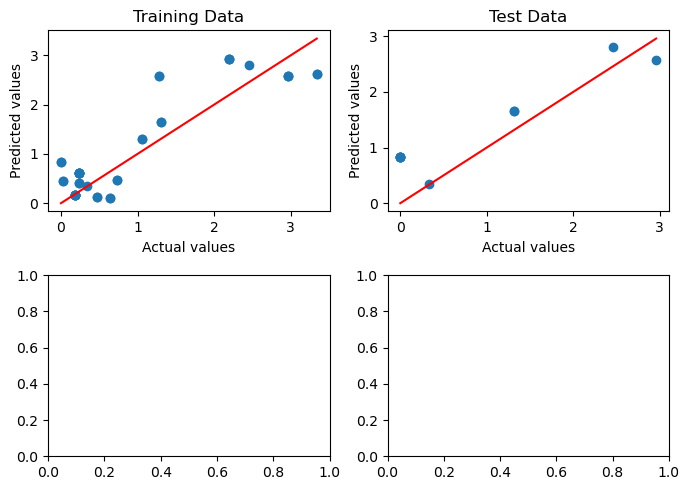

[Epsilonf] Epoch [40/2000], Loss: 0.2024
Train R²:  0.81238
Test R² :  0.88274


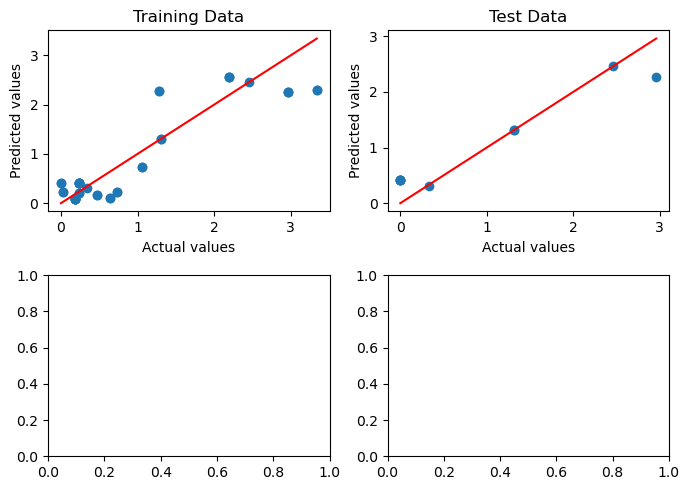

[Epsilonf] Epoch [60/2000], Loss: 0.1873
Train R²:  0.82633
Test R² :  0.87785


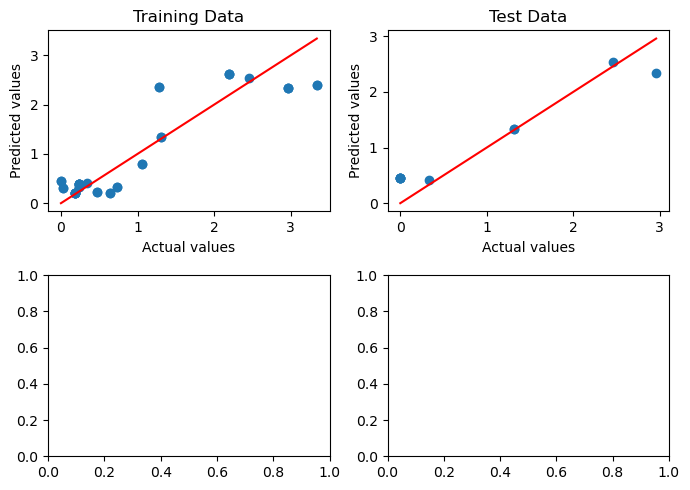

[Epsilonf] Epoch [80/2000], Loss: 0.1800
Train R²:  0.83316
Test R² :  0.89486


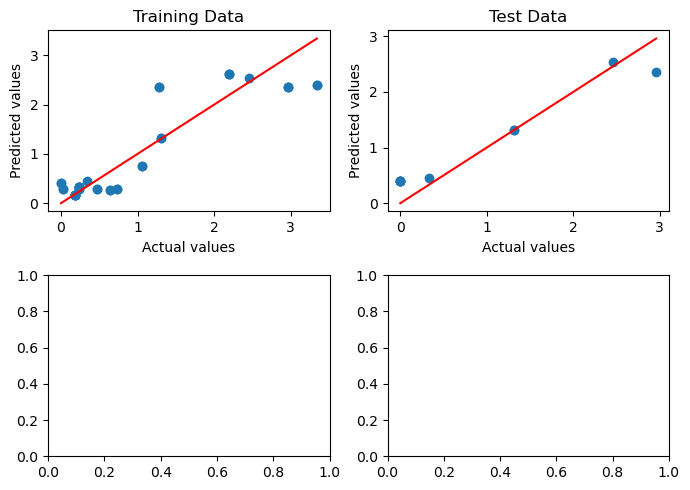

[Epsilonf] Epoch [100/2000], Loss: 0.1745
Train R²:  0.83820
Test R² :  0.89238


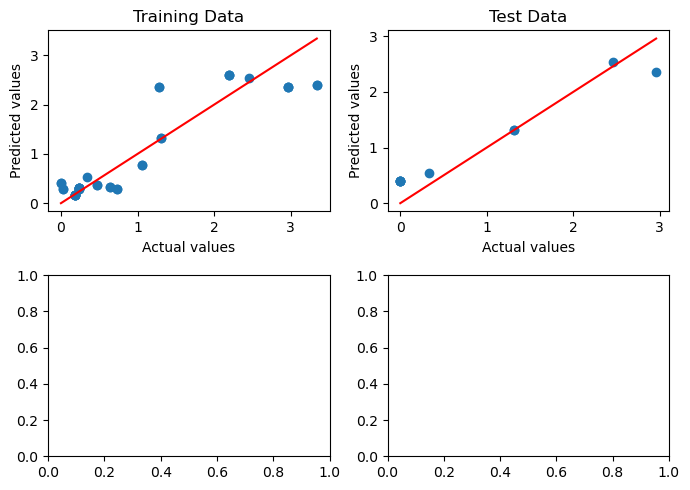

[Epsilonf] Epoch [120/2000], Loss: 0.1718
Train R²:  0.84074
Test R² :  0.89179


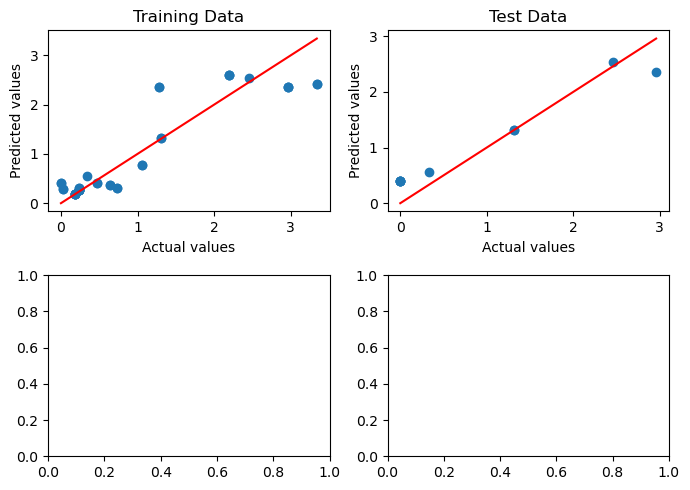

[Epsilonf] Epoch [140/2000], Loss: 0.1698
Train R²:  0.84256
Test R² :  0.89160


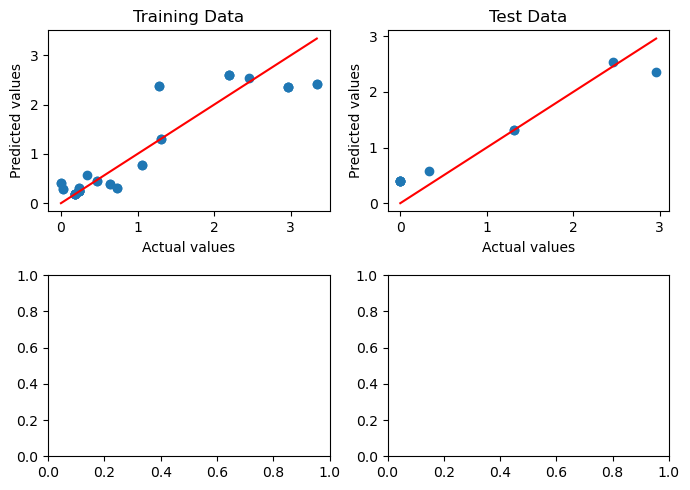

[Epsilonf] Epoch [160/2000], Loss: 0.1683
Train R²:  0.84398
Test R² :  0.89177


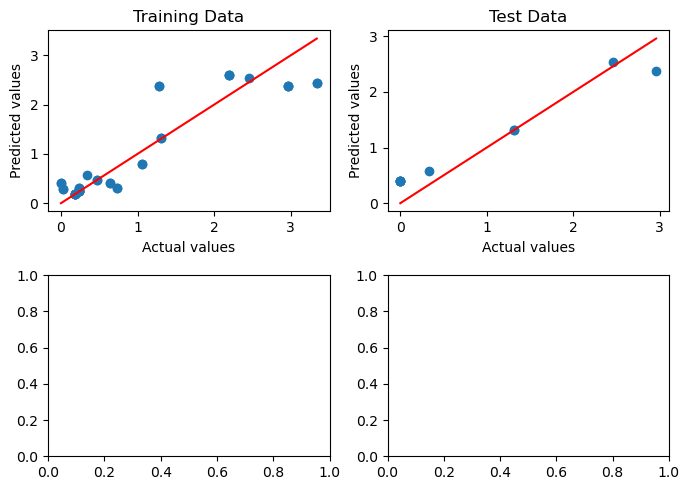

[Epsilonf] Epoch [180/2000], Loss: 0.1667
Train R²:  0.84544
Test R² :  0.89271


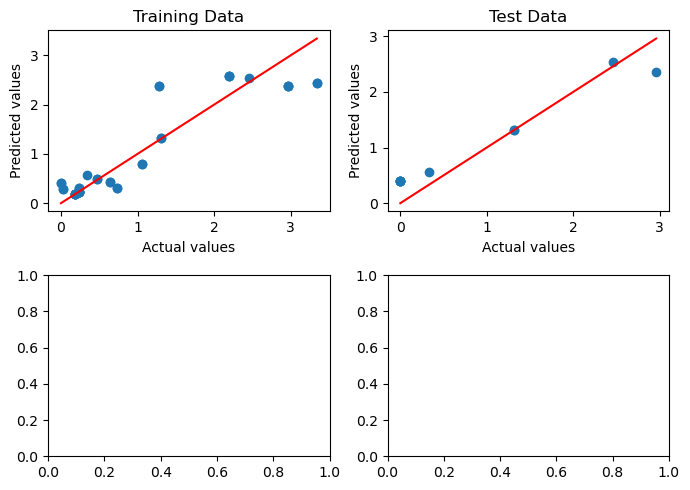

[Epsilonf] Epoch [200/2000], Loss: 0.1652
Train R²:  0.84684
Test R² :  0.89407


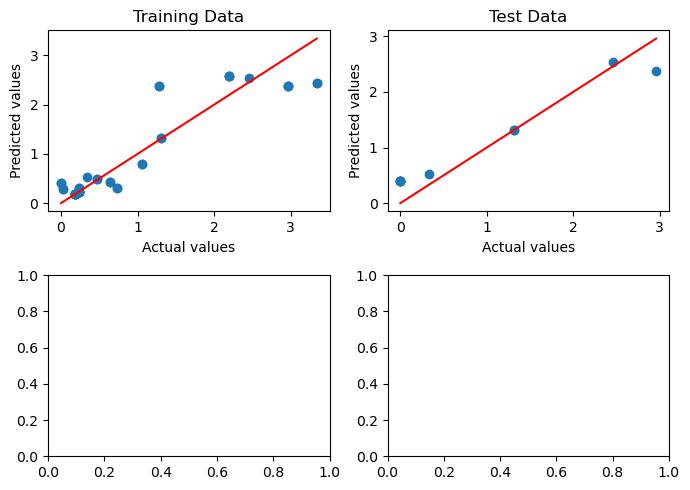

[Epsilonf] Epoch [220/2000], Loss: 0.1638
Train R²:  0.84814
Test R² :  0.89558


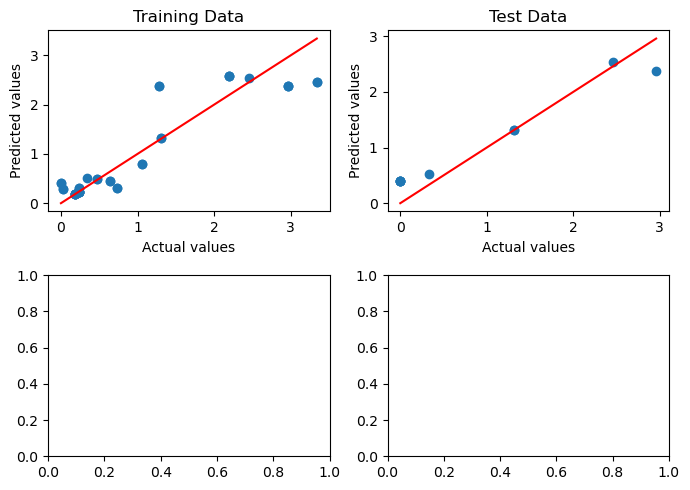

[Epsilonf] Epoch [240/2000], Loss: 0.1624
Train R²:  0.84949
Test R² :  0.89755


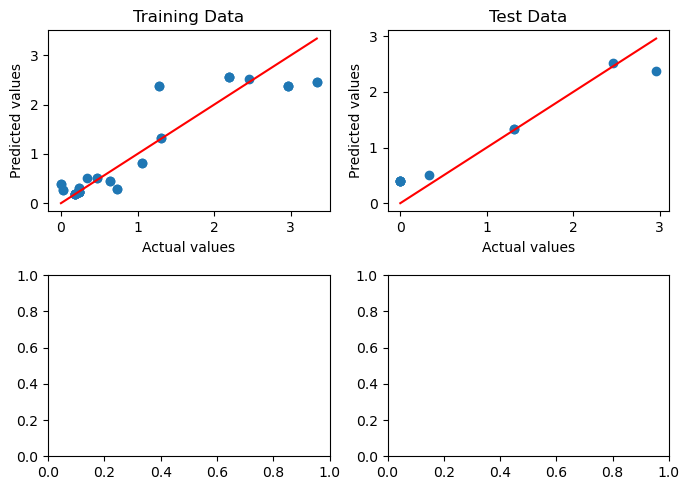

[Epsilonf] Epoch [260/2000], Loss: 0.1610
Train R²:  0.85078
Test R² :  0.89976


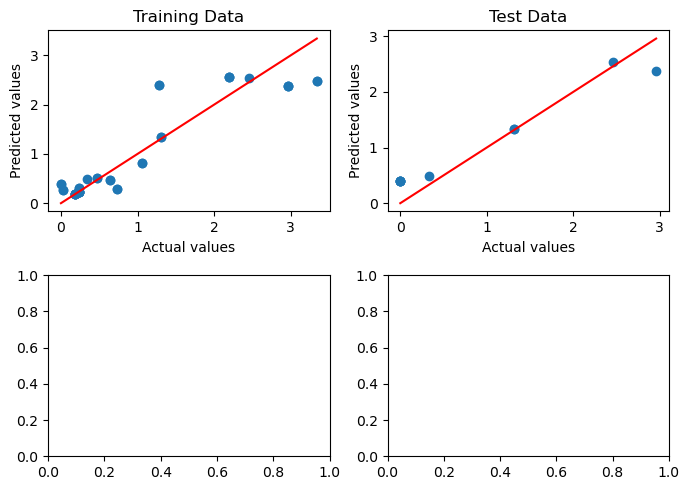

[Epsilonf] Epoch [280/2000], Loss: 0.1594
Train R²:  0.85221
Test R² :  0.89618


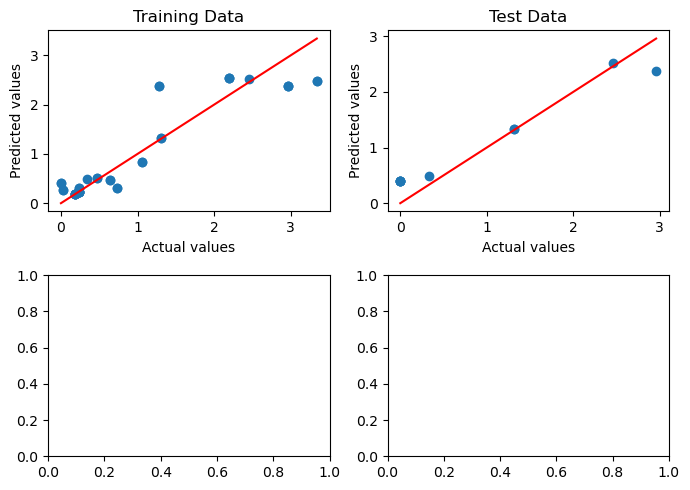

[Epsilonf] Epoch [300/2000], Loss: 0.1579
Train R²:  0.85365
Test R² :  0.90101


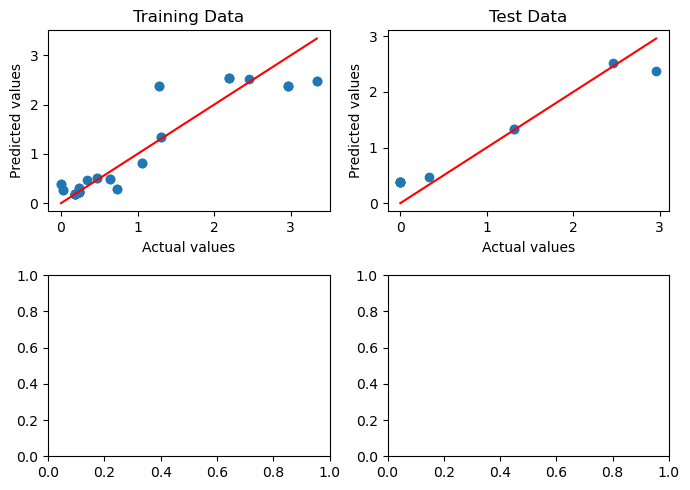

[Epsilonf] Epoch [320/2000], Loss: 0.1561
Train R²:  0.85531
Test R² :  0.90024


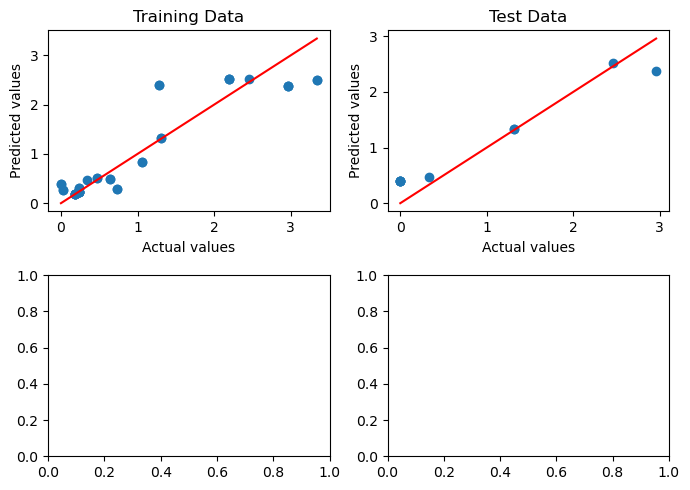

[Epsilonf] Epoch [340/2000], Loss: 0.1545
Train R²:  0.85681
Test R² :  0.90094


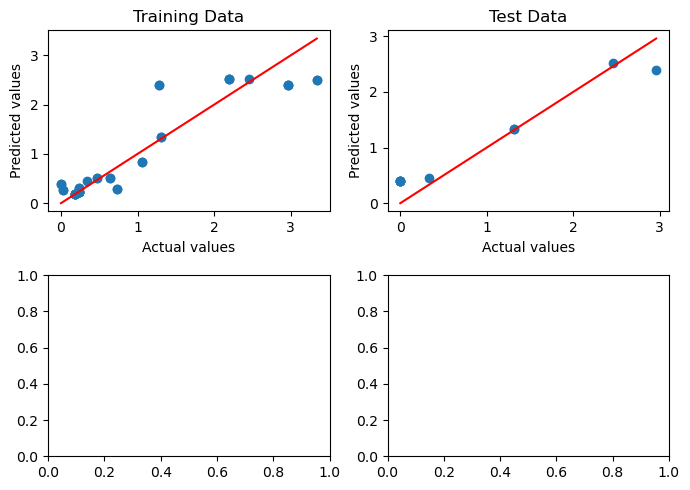

[Epsilonf] Epoch [360/2000], Loss: 0.1526
Train R²:  0.85851
Test R² :  0.90266


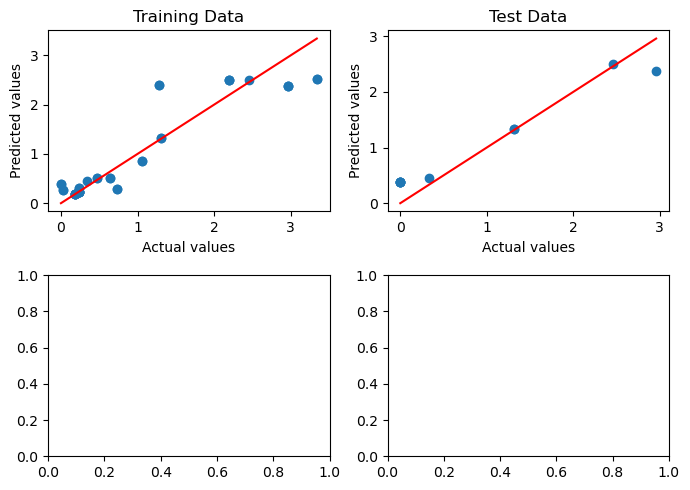

[Epsilonf] Epoch [380/2000], Loss: 0.1509
Train R²:  0.86013
Test R² :  0.90402


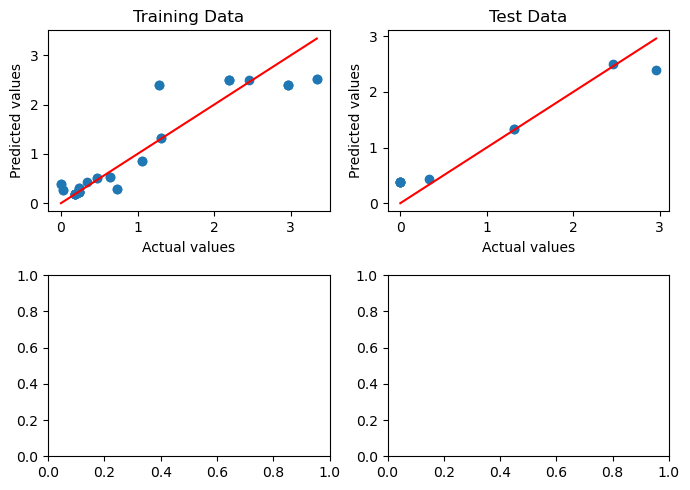

[Epsilonf] Epoch [400/2000], Loss: 0.1487
Train R²:  0.86216
Test R² :  0.90769


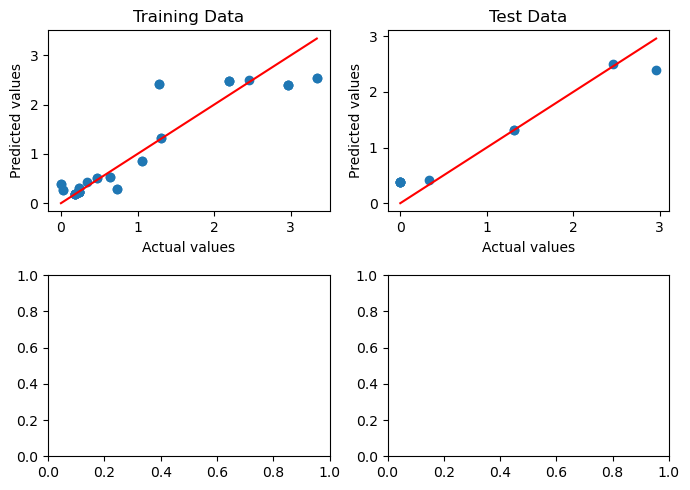

[Epsilonf] Epoch [420/2000], Loss: 0.1467
Train R²:  0.86402
Test R² :  0.91021


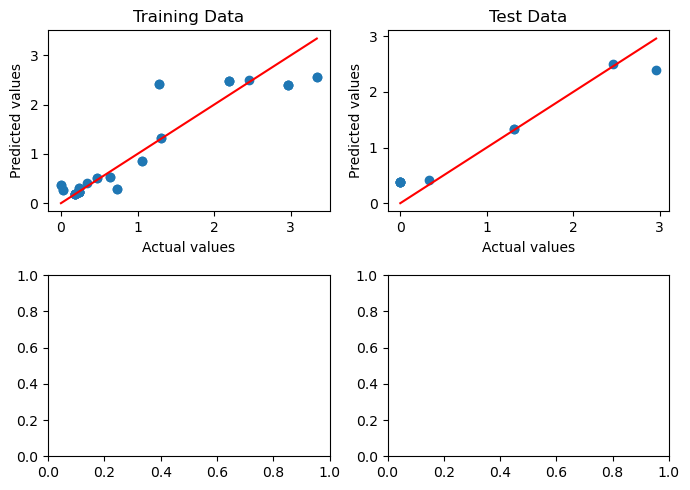

[Epsilonf] Epoch [440/2000], Loss: 0.1445
Train R²:  0.86603
Test R² :  0.91102


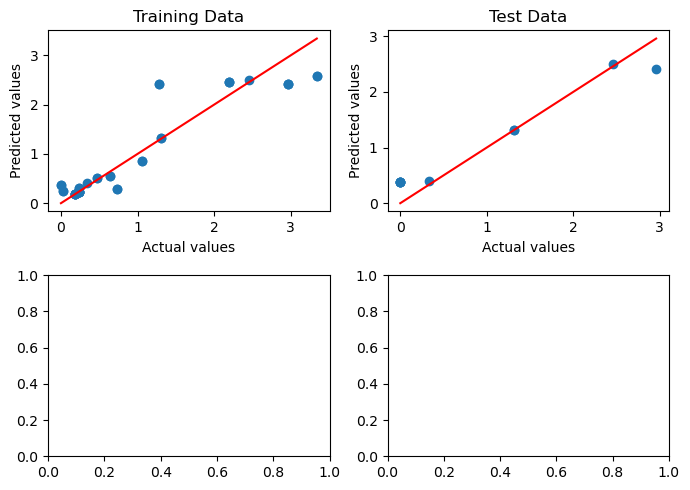

[Epsilonf] Epoch [460/2000], Loss: 0.1422
Train R²:  0.86813
Test R² :  0.91243


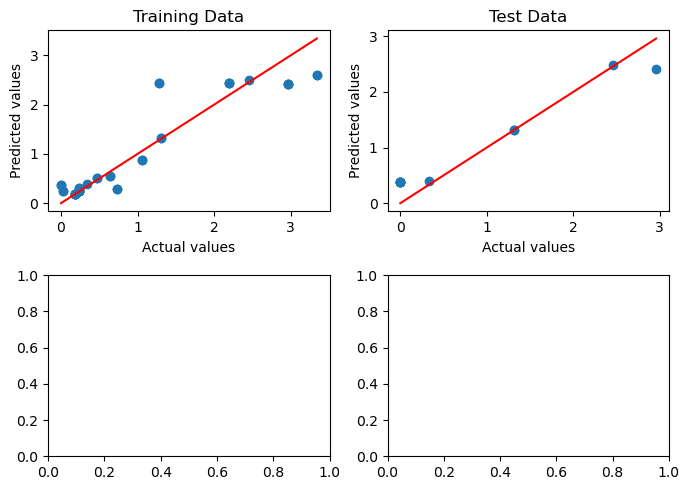

[Epsilonf] Epoch [480/2000], Loss: 0.1398
Train R²:  0.87041
Test R² :  0.91751


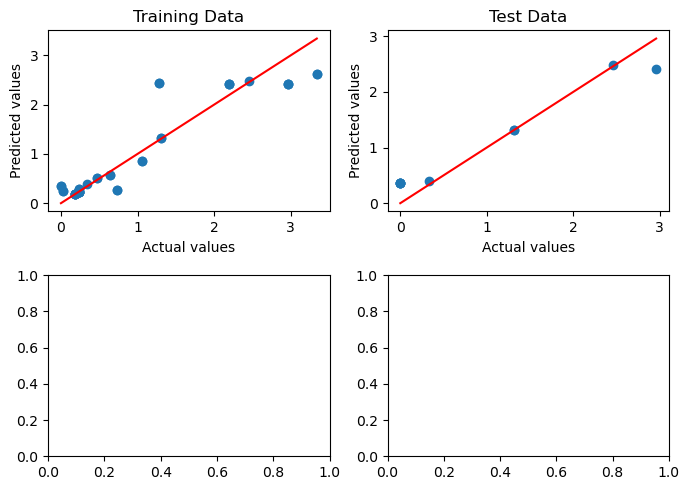

[Epsilonf] Epoch [500/2000], Loss: 0.1375
Train R²:  0.87256
Test R² :  0.91819


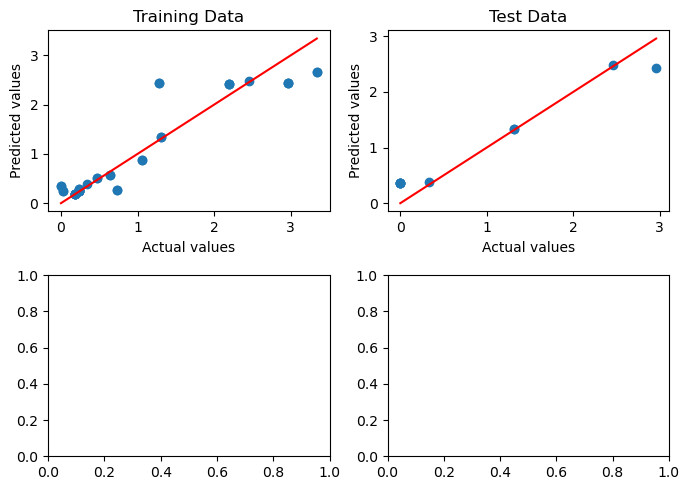

[Epsilonf] Epoch [520/2000], Loss: 0.1352
Train R²:  0.87468
Test R² :  0.92168


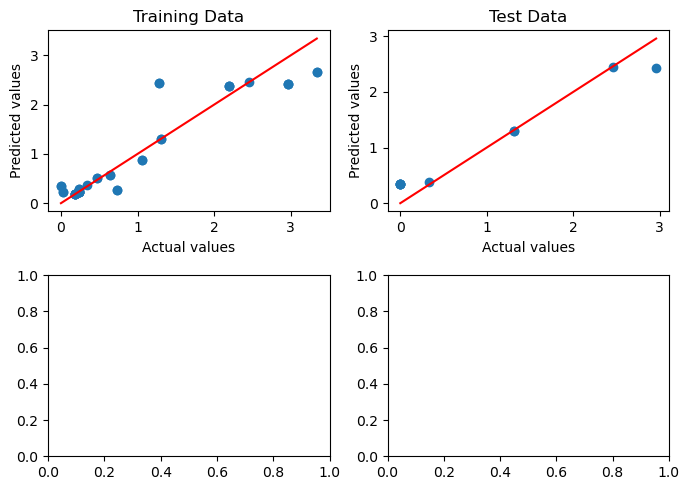

[Epsilonf] Epoch [540/2000], Loss: 0.1330
Train R²:  0.87669
Test R² :  0.91467


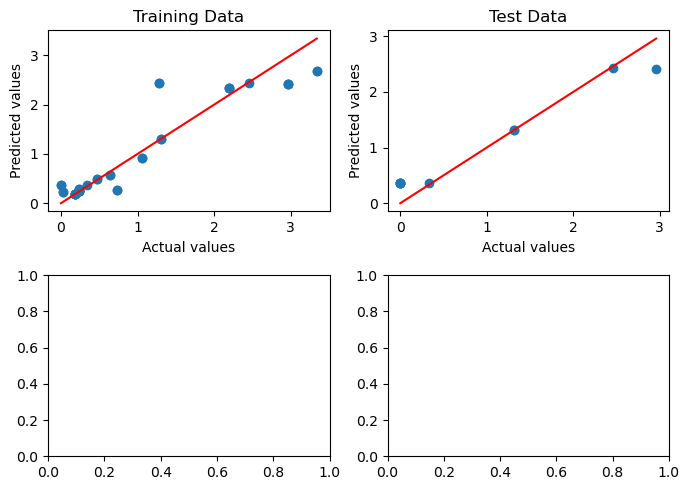

[Epsilonf] Epoch [560/2000], Loss: 0.1303
Train R²:  0.87918
Test R² :  0.91685


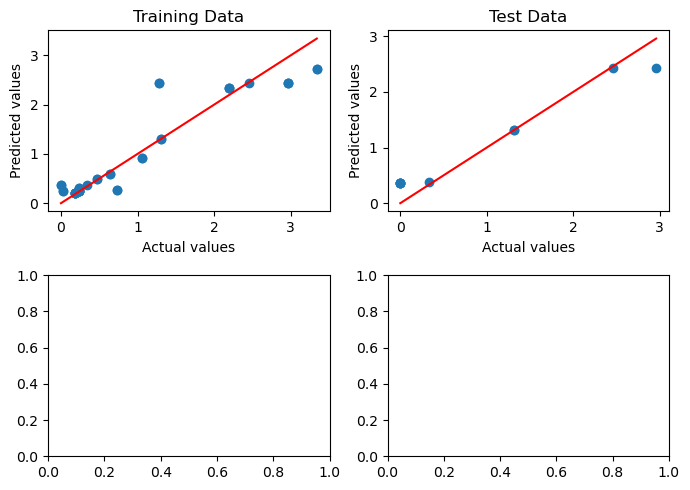

[Epsilonf] Epoch [580/2000], Loss: 0.1278
Train R²:  0.88155
Test R² :  0.91861


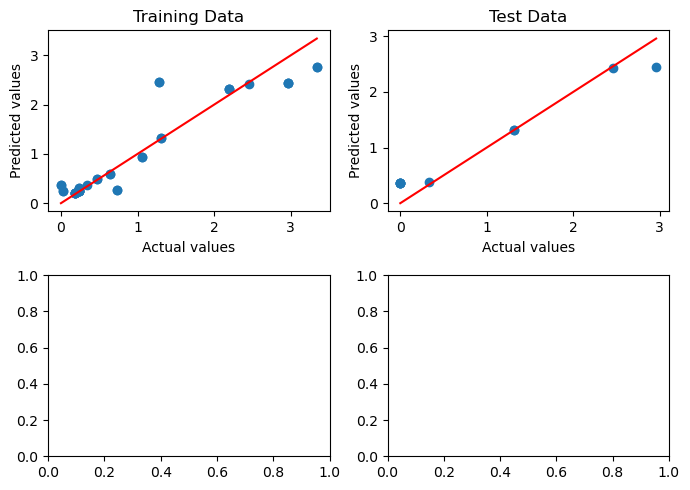

[Epsilonf] Epoch [600/2000], Loss: 0.1252
Train R²:  0.88390
Test R² :  0.92463


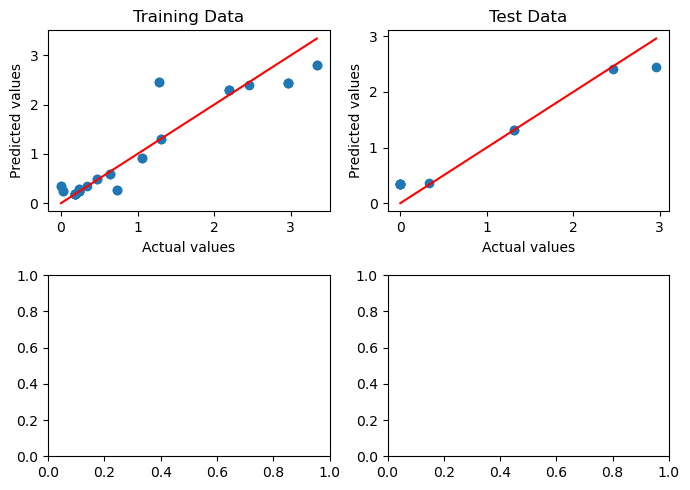

[Epsilonf] Epoch [620/2000], Loss: 0.1229
Train R²:  0.88610
Test R² :  0.92629


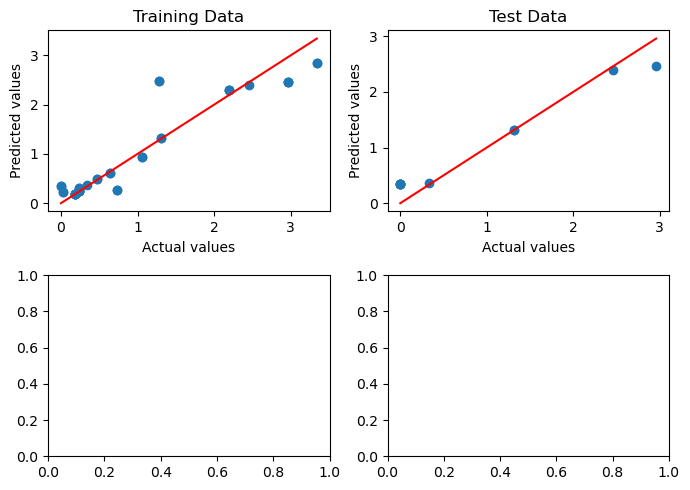

[Epsilonf] Epoch [640/2000], Loss: 0.1210
Train R²:  0.88782
Test R² :  0.93202


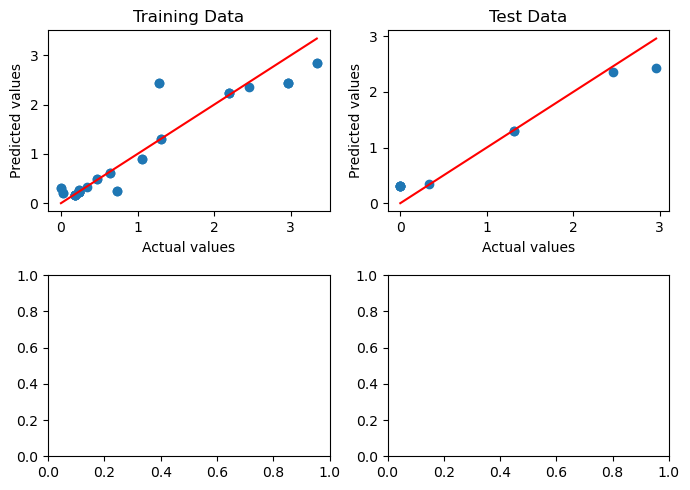

[Epsilonf] Epoch [660/2000], Loss: 0.1191
Train R²:  0.88961
Test R² :  0.91837


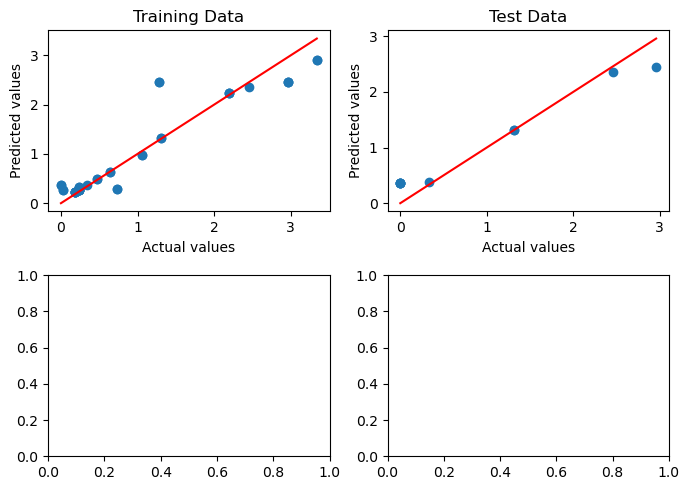

[Epsilonf] Epoch [680/2000], Loss: 0.1165
Train R²:  0.89200
Test R² :  0.93356


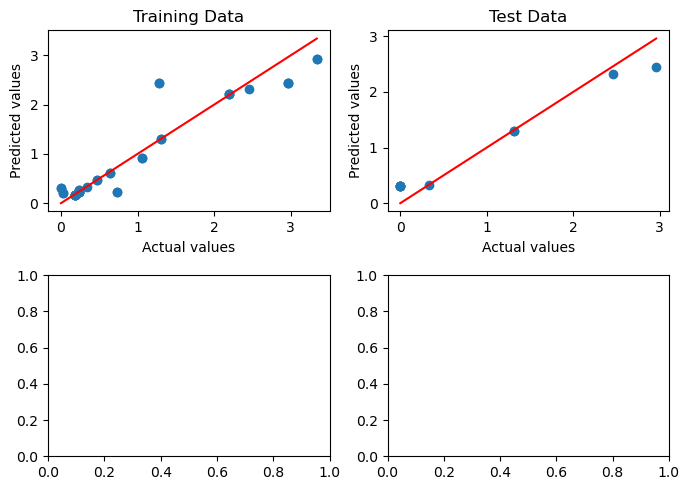

[Epsilonf] Epoch [700/2000], Loss: 0.1142
Train R²:  0.89410
Test R² :  0.92415


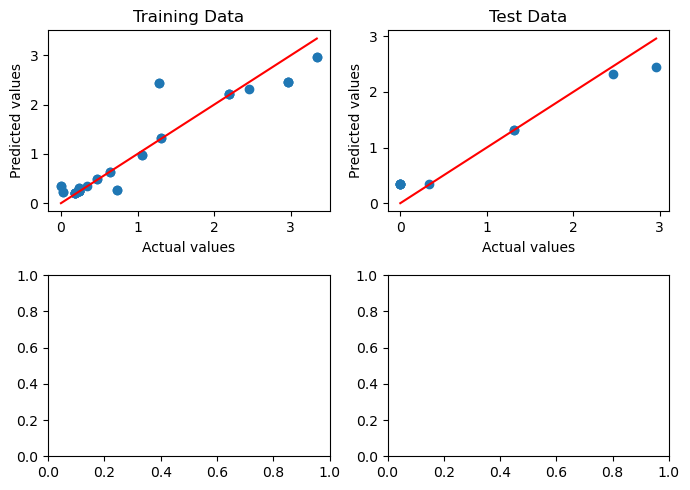

[Epsilonf] Epoch [720/2000], Loss: 0.1121
Train R²:  0.89606
Test R² :  0.92906


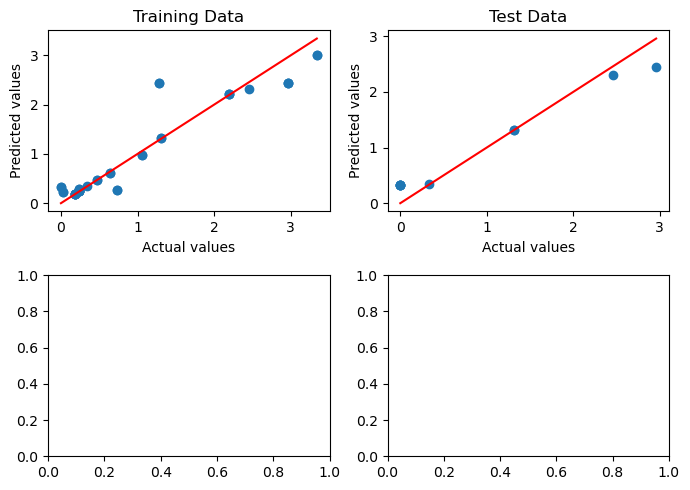

[Epsilonf] Epoch [740/2000], Loss: 0.1111
Train R²:  0.89700
Test R² :  0.92267


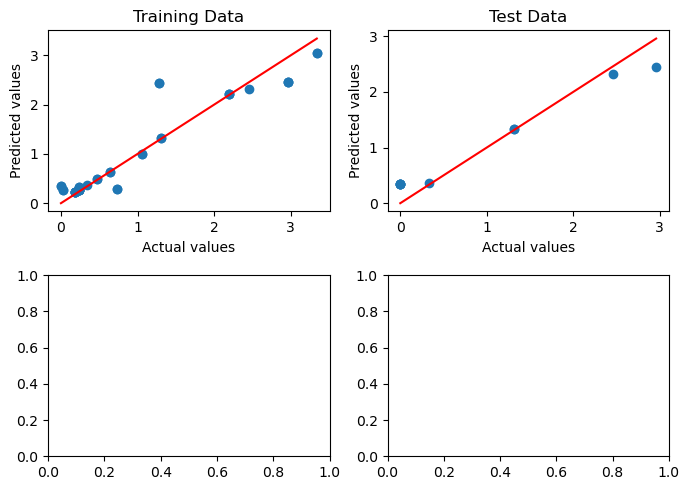

[Epsilonf] Epoch [760/2000], Loss: 0.1090
Train R²:  0.89891
Test R² :  0.93580


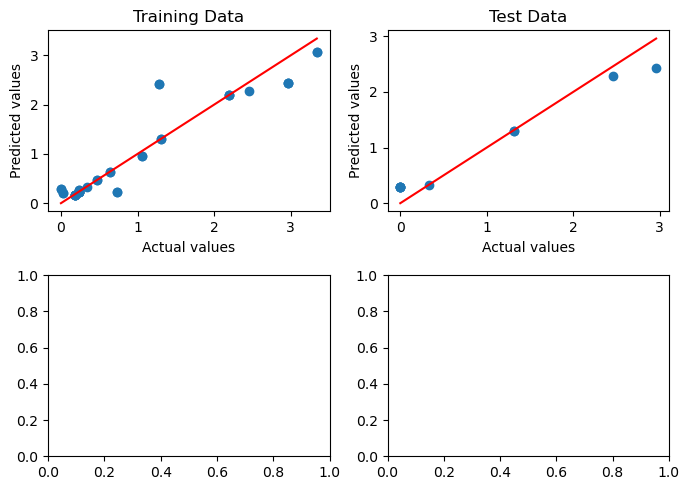

[Epsilonf] Epoch [780/2000], Loss: 0.1087
Train R²:  0.89921
Test R² :  0.93957


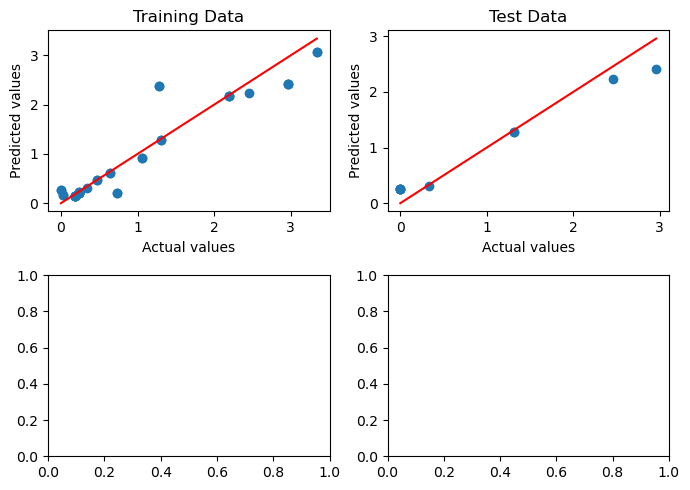

[Epsilonf] Epoch [800/2000], Loss: 0.1059
Train R²:  0.90186
Test R² :  0.93358


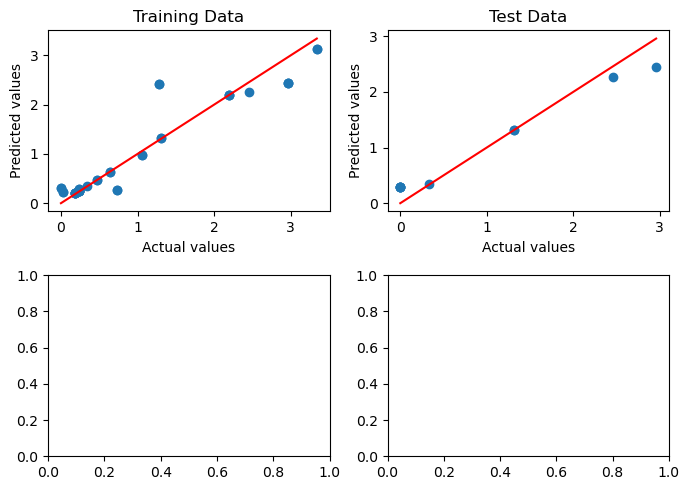

[Epsilonf] Epoch [820/2000], Loss: 0.1064
Train R²:  0.90133
Test R² :  0.92169


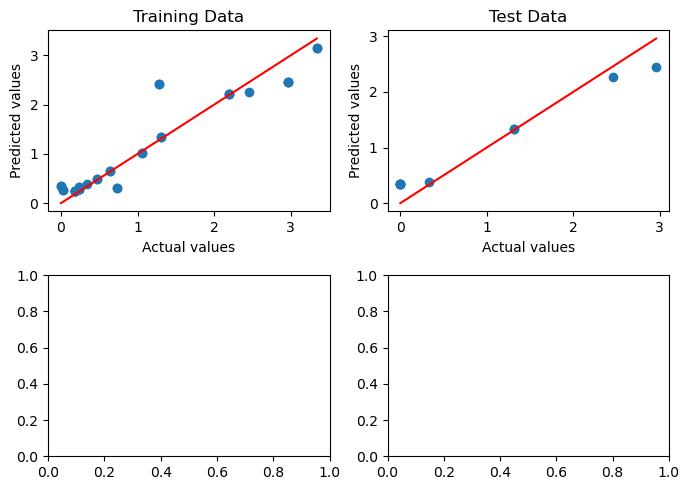

[Epsilonf] Epoch [840/2000], Loss: 0.1039
Train R²:  0.90365
Test R² :  0.94362


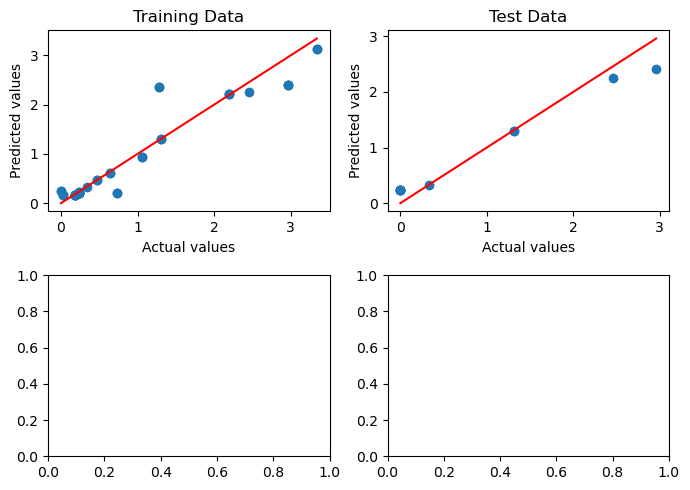

[Epsilonf] Epoch [860/2000], Loss: 0.1021
Train R²:  0.90538
Test R² :  0.93005


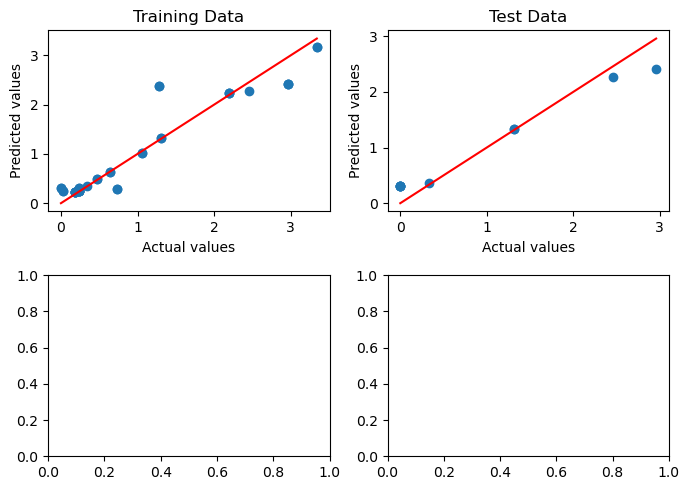

[Epsilonf] Epoch [880/2000], Loss: 0.1019
Train R²:  0.90554
Test R² :  0.93031


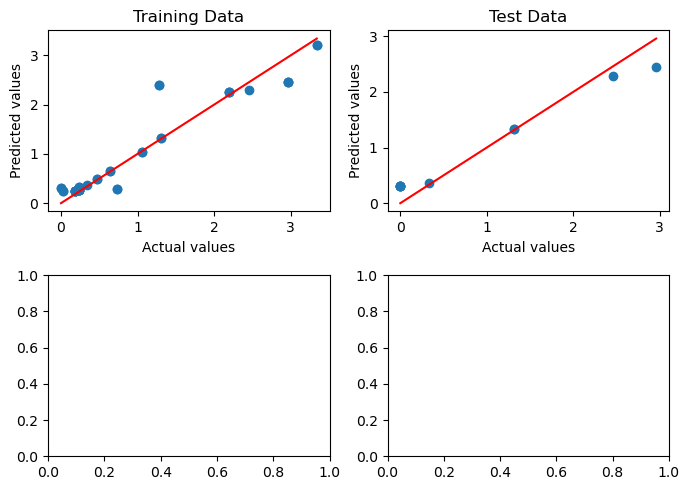

[Epsilonf] Epoch [900/2000], Loss: 0.1001
Train R²:  0.90720
Test R² :  0.94259


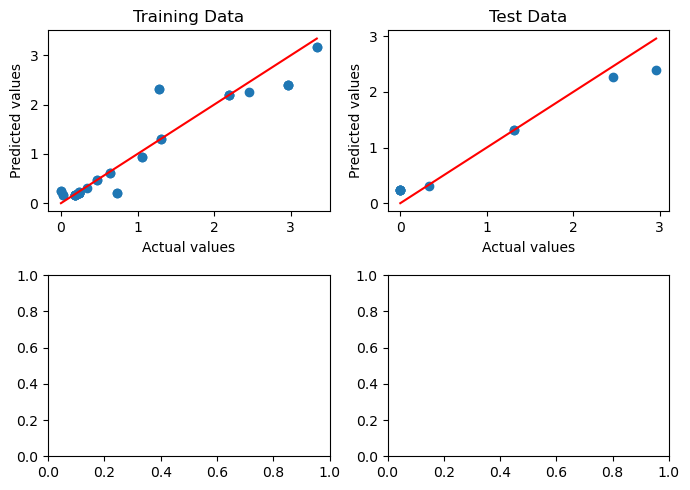

[Epsilonf] Epoch [920/2000], Loss: 0.0982
Train R²:  0.90895
Test R² :  0.93723


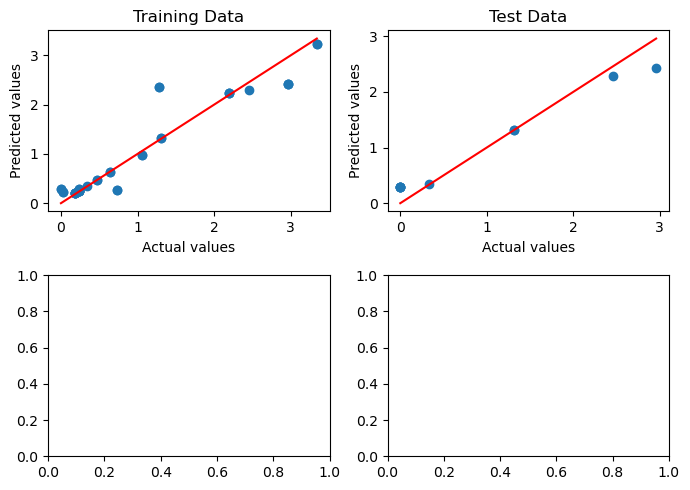

[Epsilonf] Epoch [940/2000], Loss: 0.0994
Train R²:  0.90784
Test R² :  0.92156


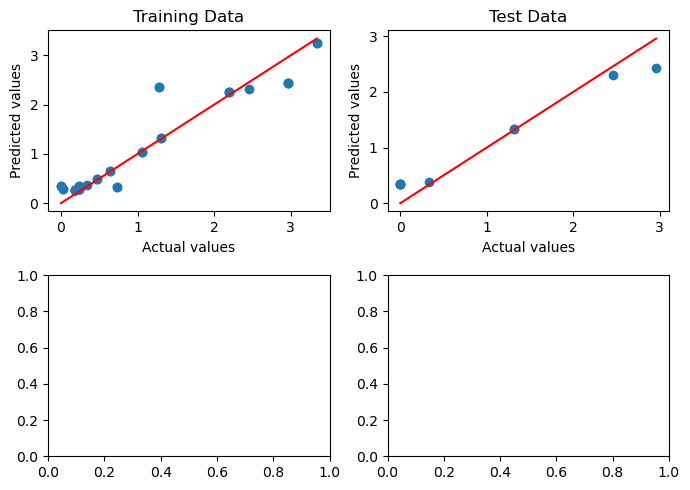

[Epsilonf] Epoch [960/2000], Loss: 0.0955
Train R²:  0.91149
Test R² :  0.94188


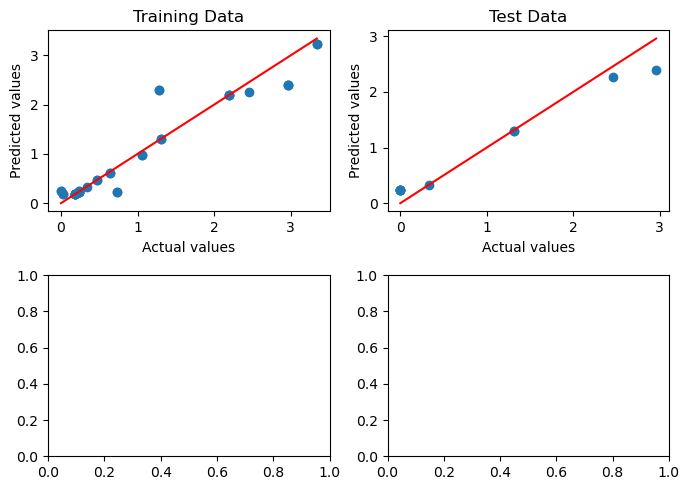

[Epsilonf] Epoch [980/2000], Loss: 0.1008
Train R²:  0.90657
Test R² :  0.91725


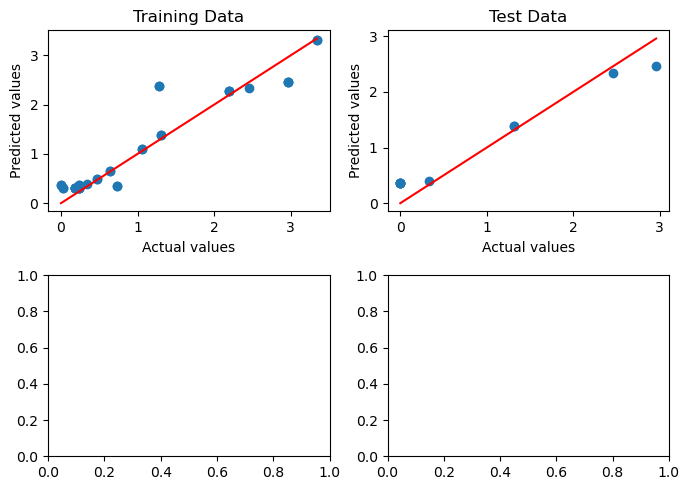

[Epsilonf] Epoch [1000/2000], Loss: 0.0970
Train R²:  0.91006
Test R² :  0.94405


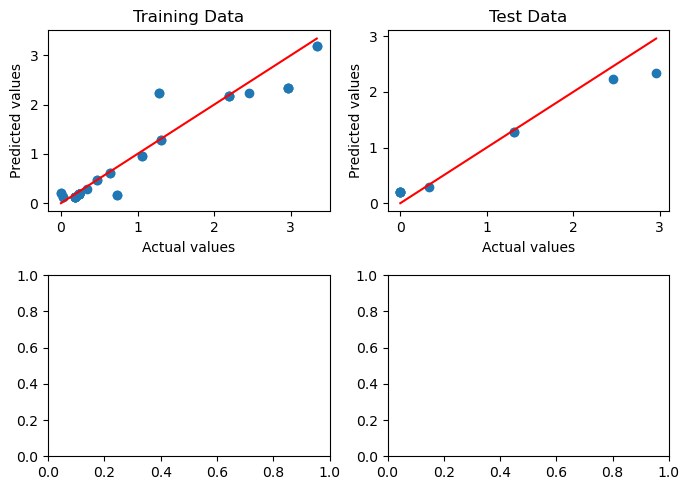

[Epsilonf] Epoch [1020/2000], Loss: 0.0971
Train R²:  0.91000
Test R² :  0.92472


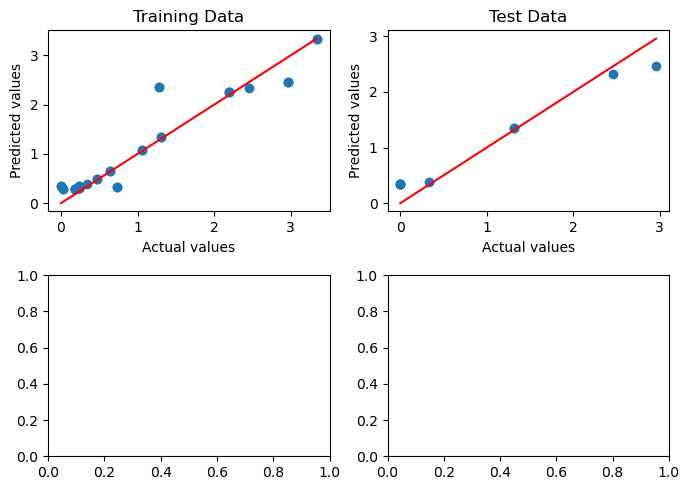

[Epsilonf] Epoch [1040/2000], Loss: 0.0910
Train R²:  0.91561
Test R² :  0.94045


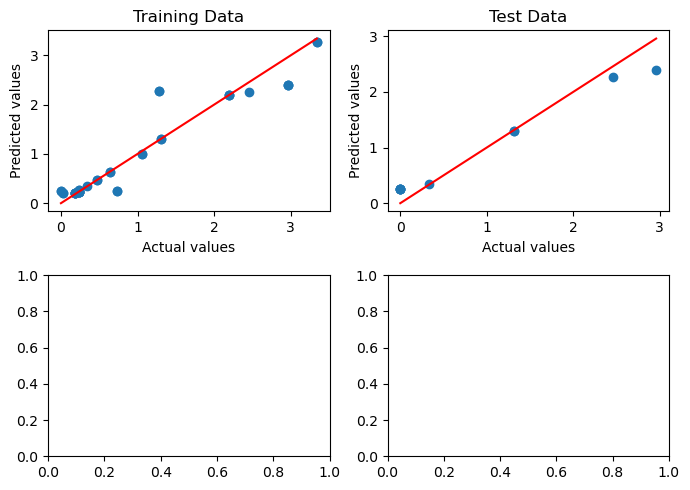

[Epsilonf] Epoch [1060/2000], Loss: 0.0950
Train R²:  0.91195
Test R² :  0.92367


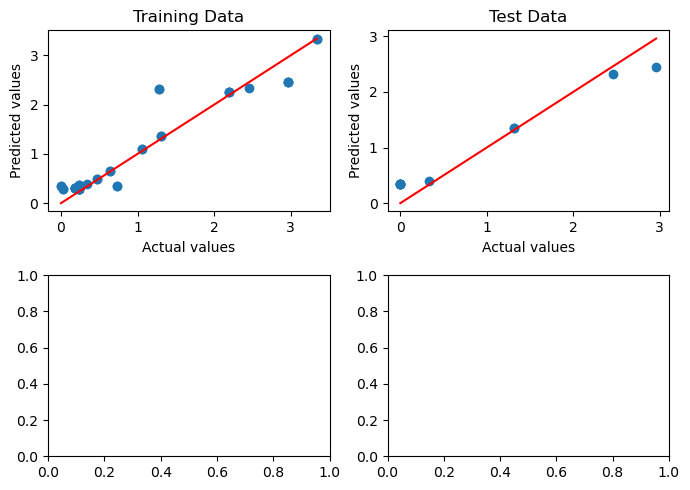

[Epsilonf] Epoch [1080/2000], Loss: 0.1027
Train R²:  0.90477
Test R² :  0.94080


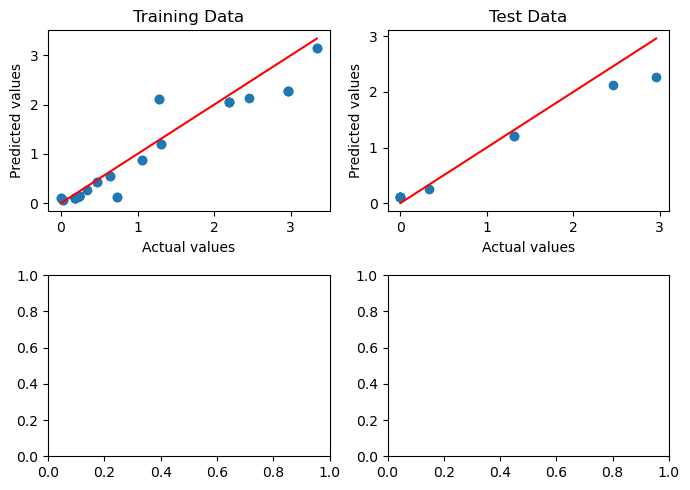

[Epsilonf] Epoch [1100/2000], Loss: 0.0891
Train R²:  0.91737
Test R² :  0.93155


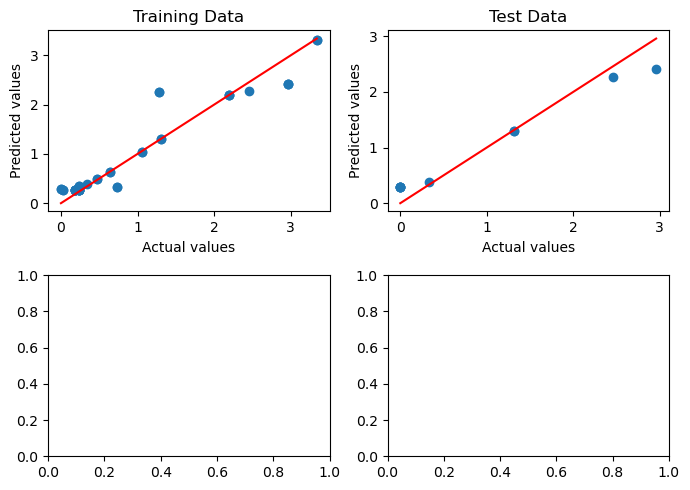

[Epsilonf] Epoch [1120/2000], Loss: 0.0860
Train R²:  0.92027
Test R² :  0.94427


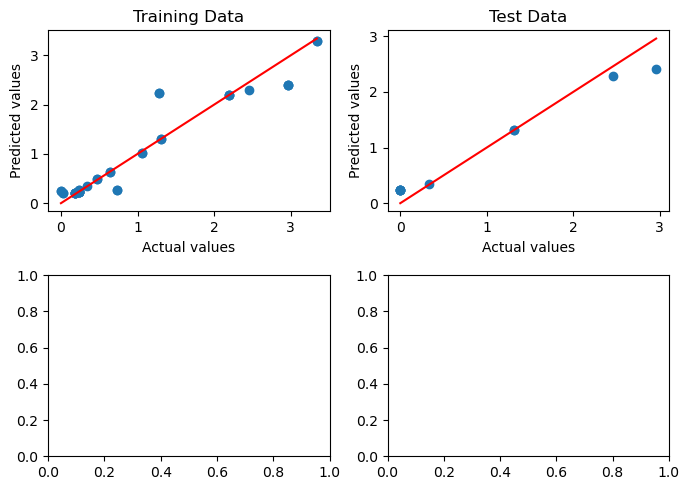

[Epsilonf] Epoch [1140/2000], Loss: 0.0847
Train R²:  0.92143
Test R² :  0.94419


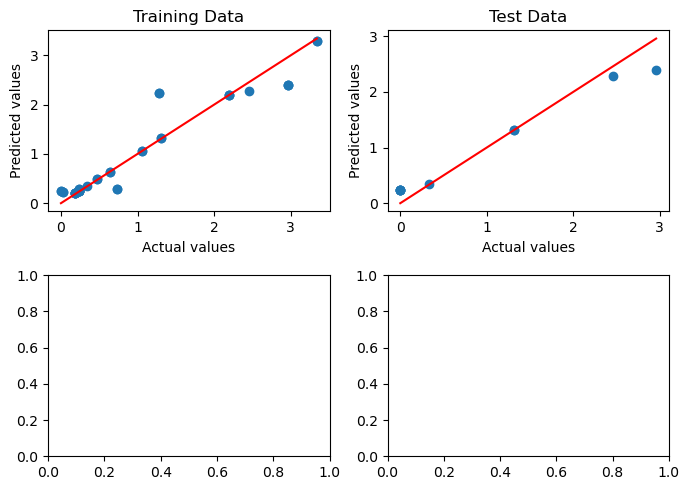

[Epsilonf] Epoch [1160/2000], Loss: 0.0834
Train R²:  0.92266
Test R² :  0.94881


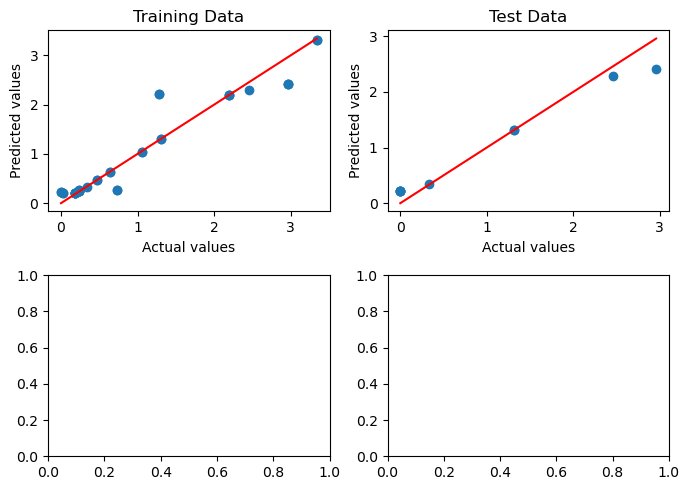

[Epsilonf] Epoch [1180/2000], Loss: 0.0825
Train R²:  0.92351
Test R² :  0.94735


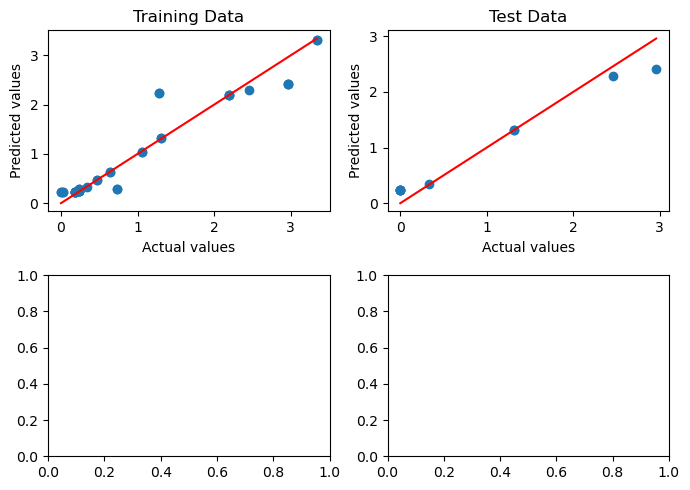

[Epsilonf] Epoch [1200/2000], Loss: 0.0811
Train R²:  0.92480
Test R² :  0.95093


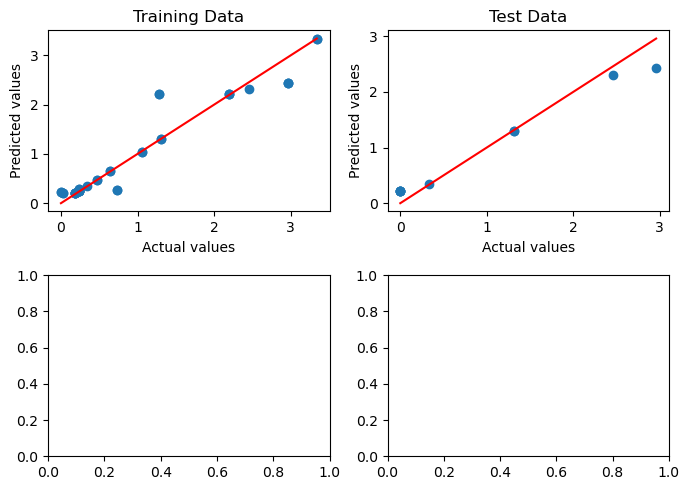

[Epsilonf] Epoch [1220/2000], Loss: 0.0806
Train R²:  0.92528
Test R² :  0.95056


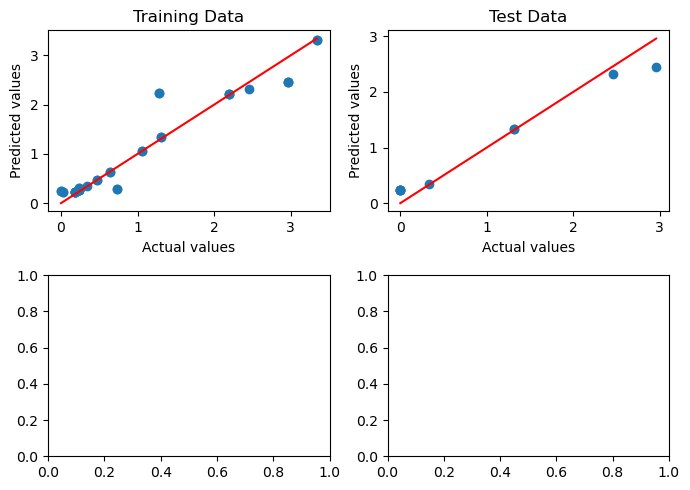

[Epsilonf] Epoch [1240/2000], Loss: 0.0854
Train R²:  0.92083
Test R² :  0.93168


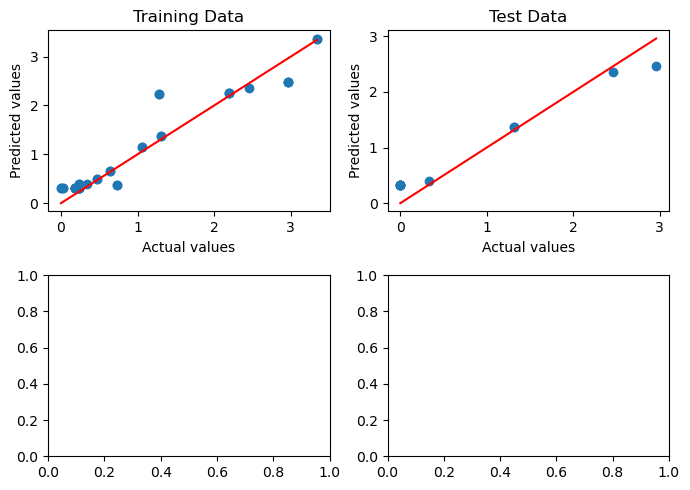

[Epsilonf] Epoch [1260/2000], Loss: 0.0777
Train R²:  0.92798
Test R² :  0.95306


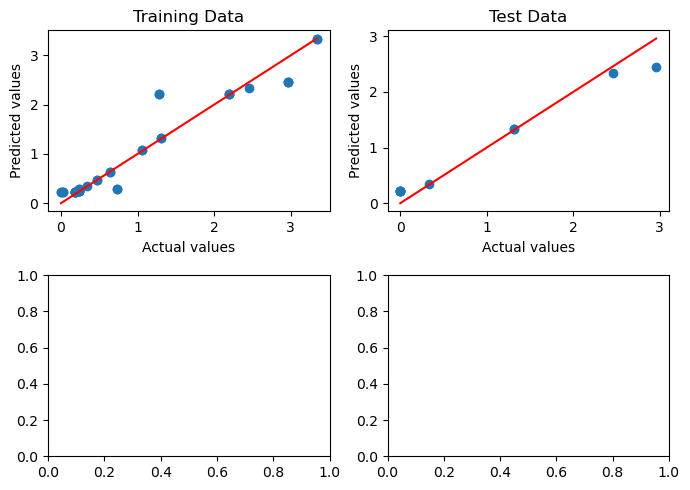

[Epsilonf] Epoch [1280/2000], Loss: 0.0798
Train R²:  0.92604
Test R² :  0.95775


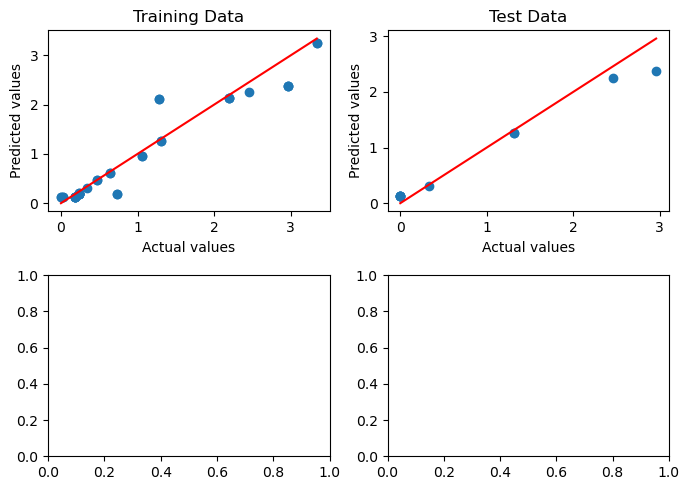

[Epsilonf] Epoch [1300/2000], Loss: 0.0755
Train R²:  0.93005
Test R² :  0.95343


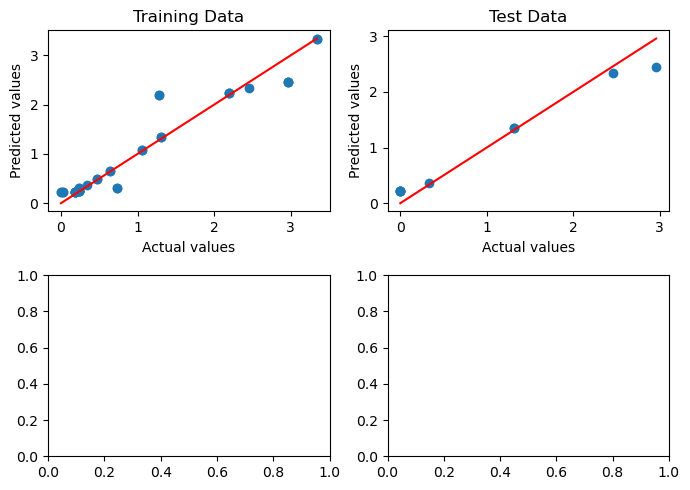

[Epsilonf] Epoch [1320/2000], Loss: 0.0744
Train R²:  0.93102
Test R² :  0.95085


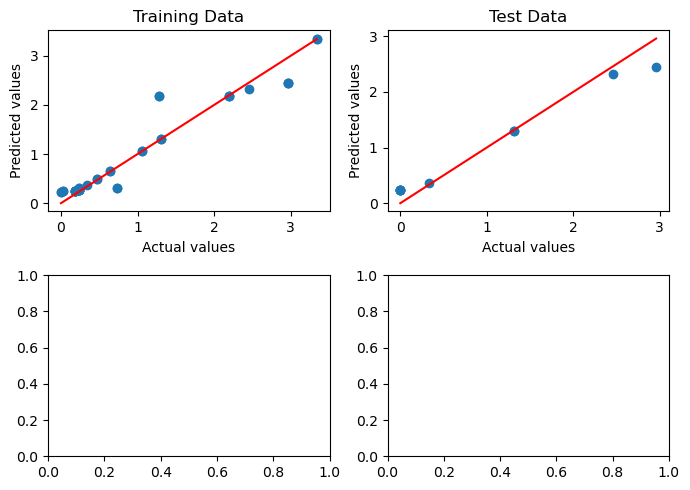

[Epsilonf] Epoch [1340/2000], Loss: 0.0754
Train R²:  0.93010
Test R² :  0.94644


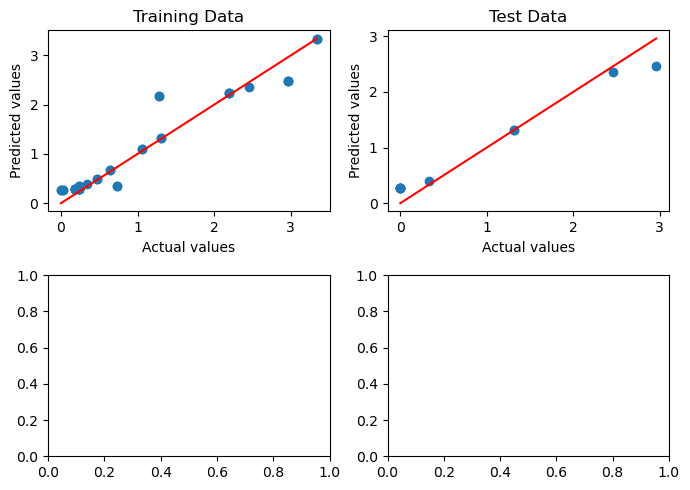

[Epsilonf] Epoch [1360/2000], Loss: 0.0712
Train R²:  0.93397
Test R² :  0.95711


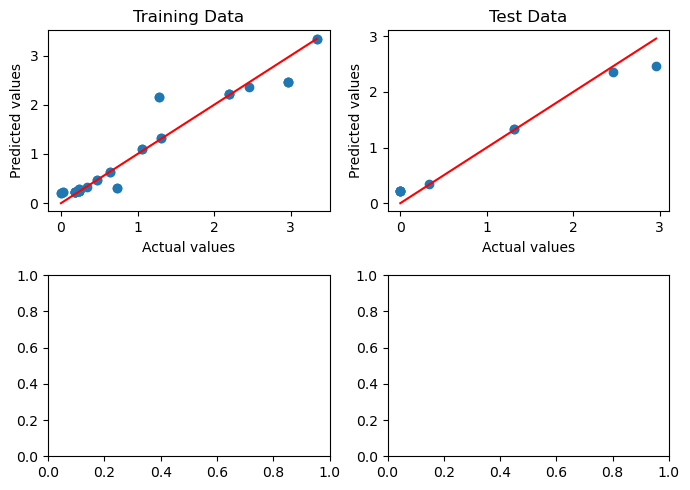

[Epsilonf] Epoch [1380/2000], Loss: 0.0697
Train R²:  0.93539
Test R² :  0.96144


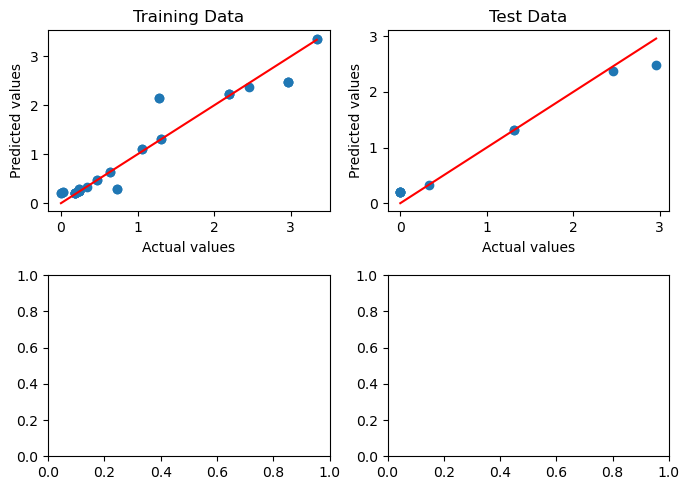

[Epsilonf] Epoch [1400/2000], Loss: 0.0819
Train R²:  0.92410
Test R² :  0.96317


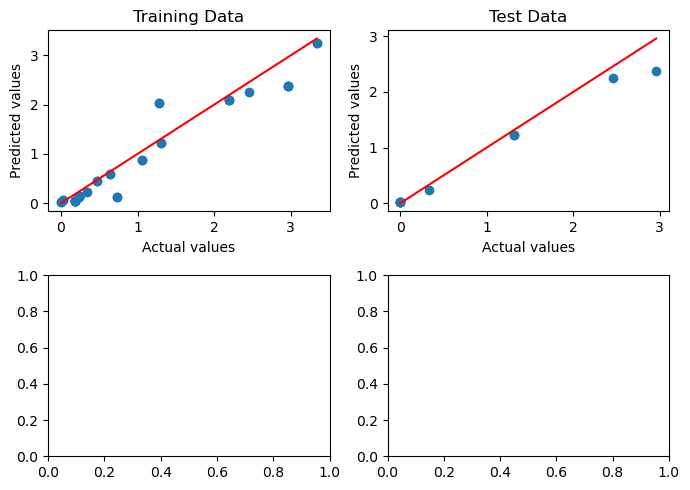

[Epsilonf] Epoch [1420/2000], Loss: 0.0715
Train R²:  0.93371
Test R² :  0.95575


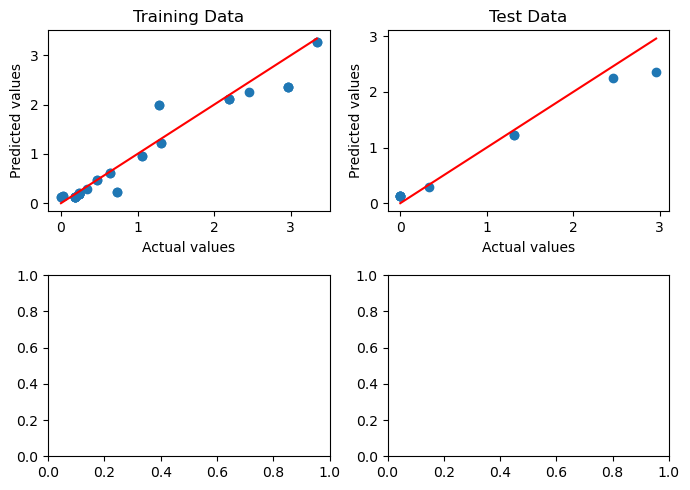

[Epsilonf] Epoch [1440/2000], Loss: 0.0654
Train R²:  0.93935
Test R² :  0.96762


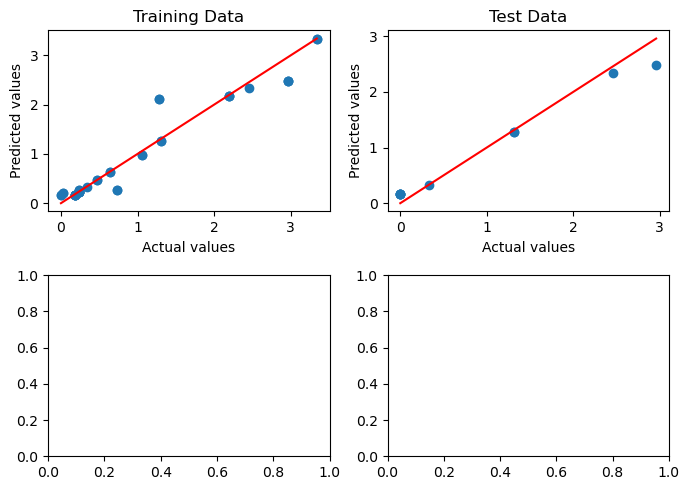

[Epsilonf] Epoch [1460/2000], Loss: 0.0683
Train R²:  0.93668
Test R² :  0.95278


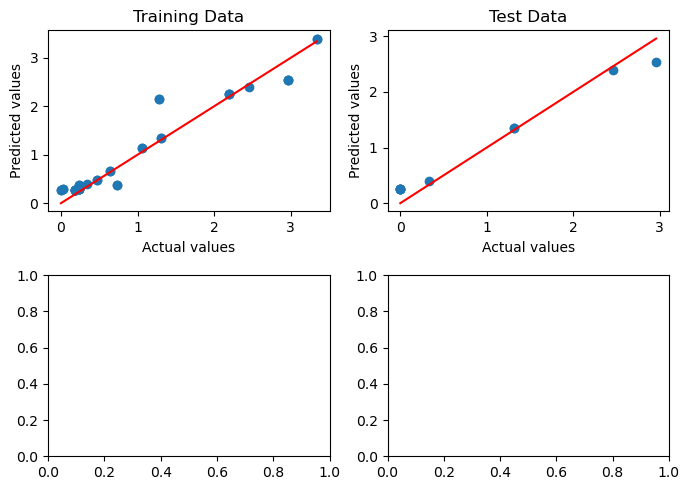

[Epsilonf] Epoch [1480/2000], Loss: 0.0627
Train R²:  0.94186
Test R² :  0.96211


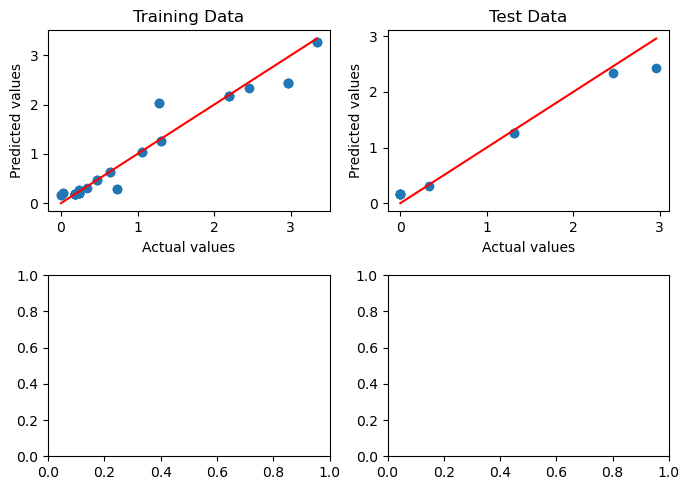

[Epsilonf] Epoch [1500/2000], Loss: 0.0673
Train R²:  0.93761
Test R² :  0.96825


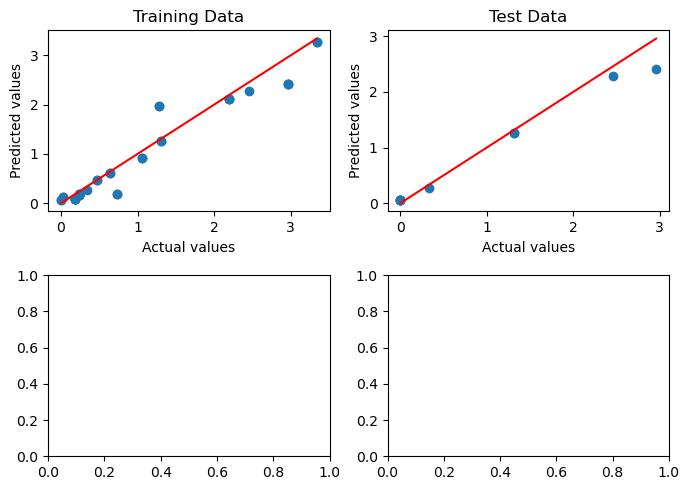

[Epsilonf] Epoch [1520/2000], Loss: 0.0594
Train R²:  0.94491
Test R² :  0.96750


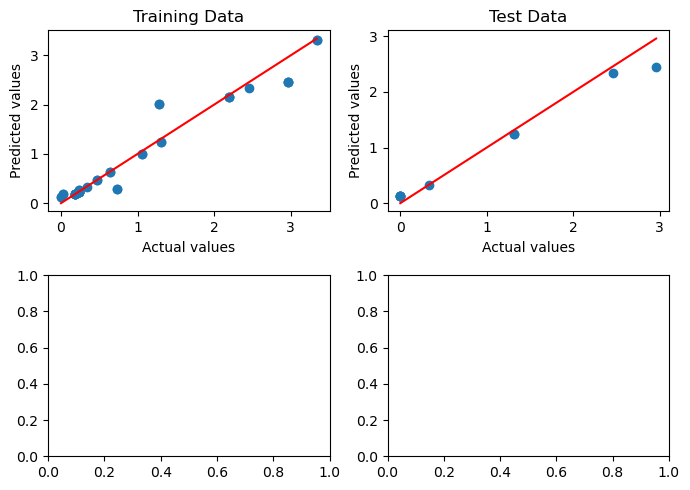

[Epsilonf] Epoch [1540/2000], Loss: 0.0592
Train R²:  0.94509
Test R² :  0.96078


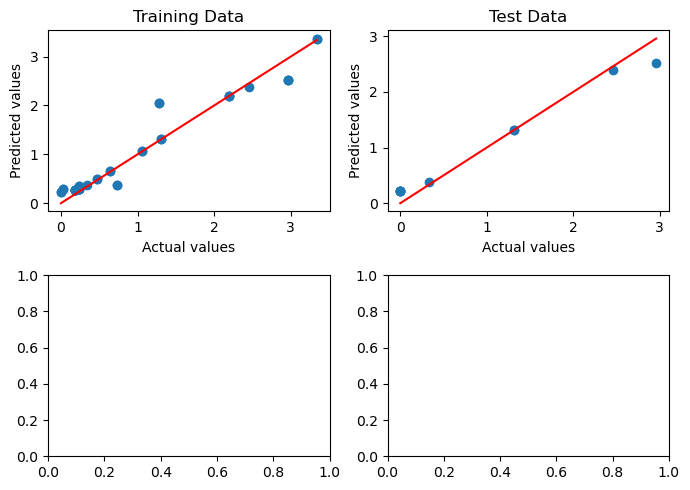

[Epsilonf] Epoch [1560/2000], Loss: 0.0558
Train R²:  0.94829
Test R² :  0.97033


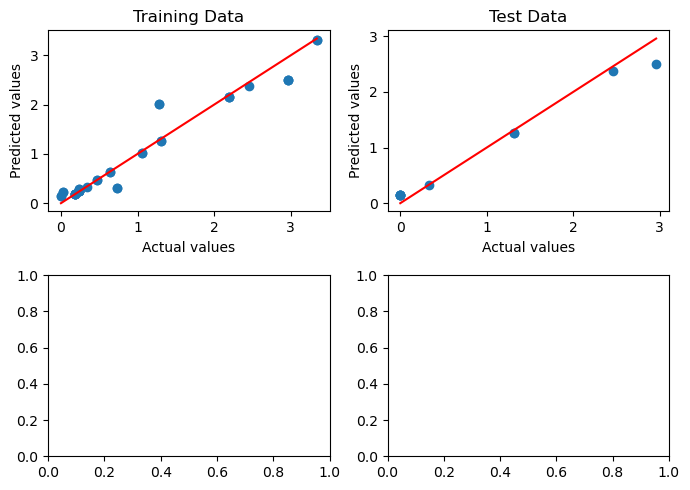

[Epsilonf] Epoch [1580/2000], Loss: 0.0563
Train R²:  0.94778
Test R² :  0.96962


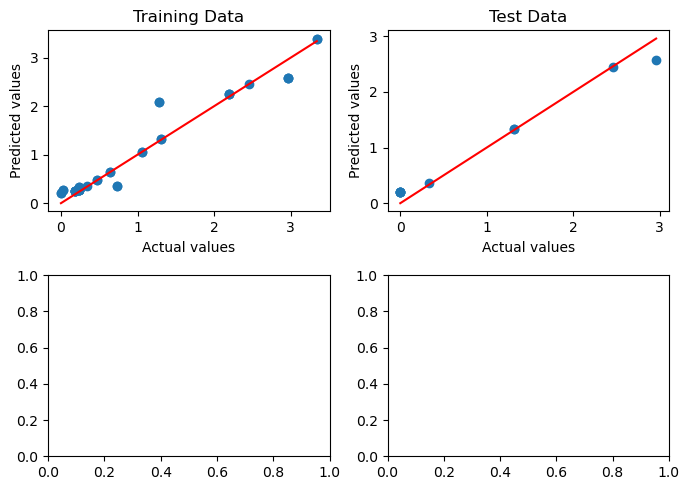

[Epsilonf] Epoch [1600/2000], Loss: 0.0569
Train R²:  0.94729
Test R² :  0.97645


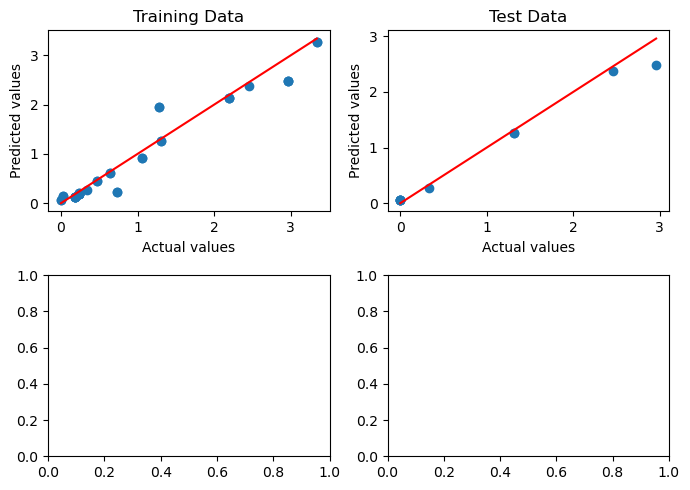

[Epsilonf] Epoch [1620/2000], Loss: 0.0508
Train R²:  0.95295
Test R² :  0.97381


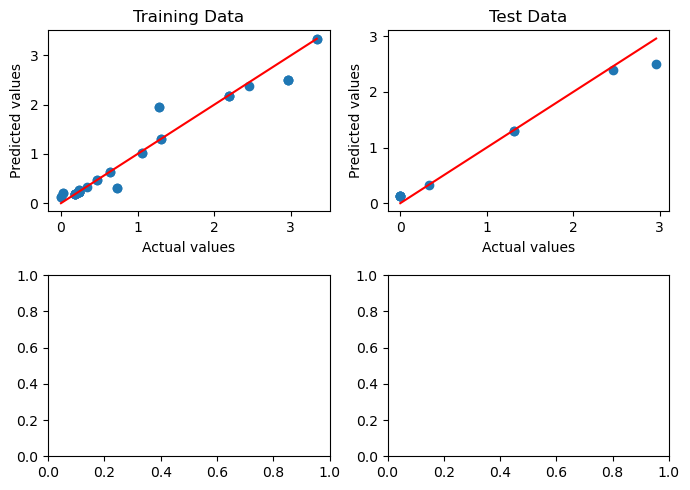

[Epsilonf] Epoch [1640/2000], Loss: 0.0581
Train R²:  0.94614
Test R² :  0.96430


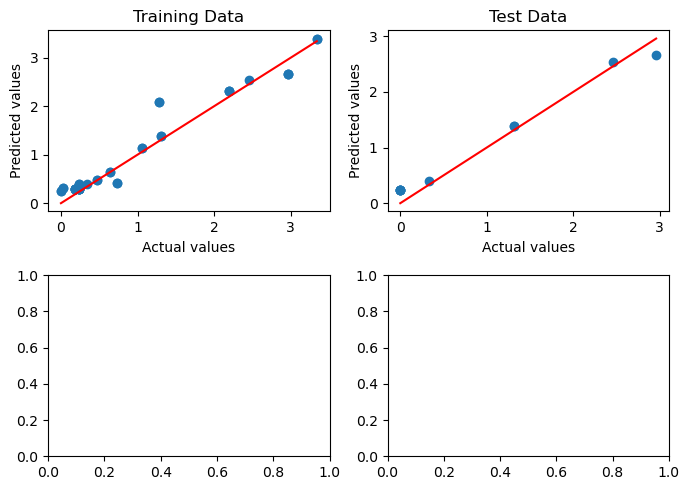

[Epsilonf] Epoch [1660/2000], Loss: 0.0514
Train R²:  0.95232
Test R² :  0.97401


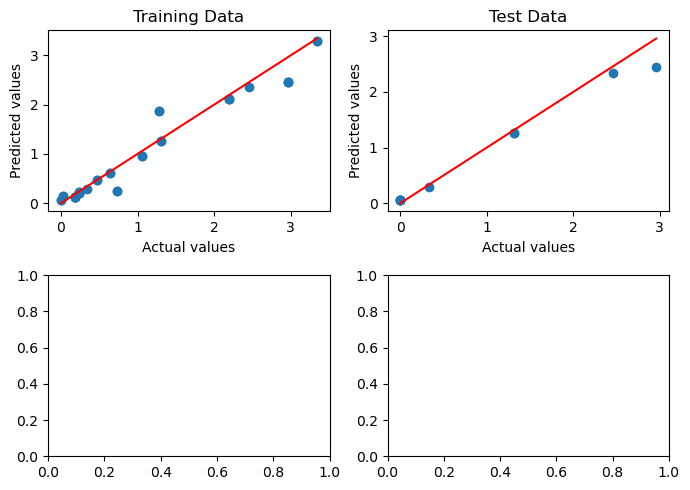

[Epsilonf] Epoch [1680/2000], Loss: 0.0462
Train R²:  0.95717
Test R² :  0.97489


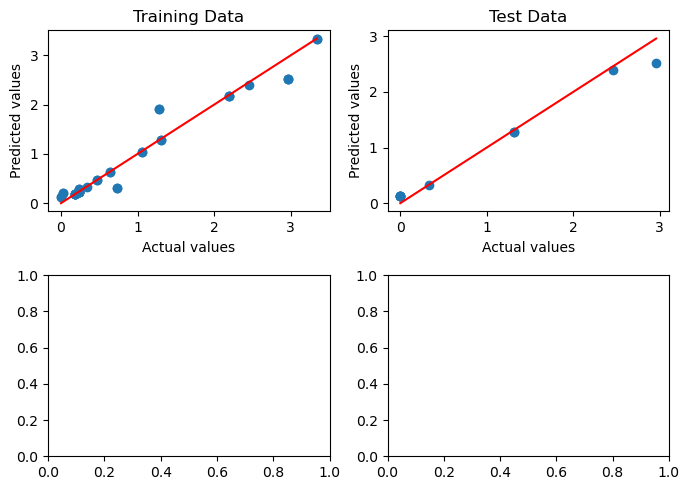

[Epsilonf] Epoch [1700/2000], Loss: 0.0463
Train R²:  0.95706
Test R² :  0.97840


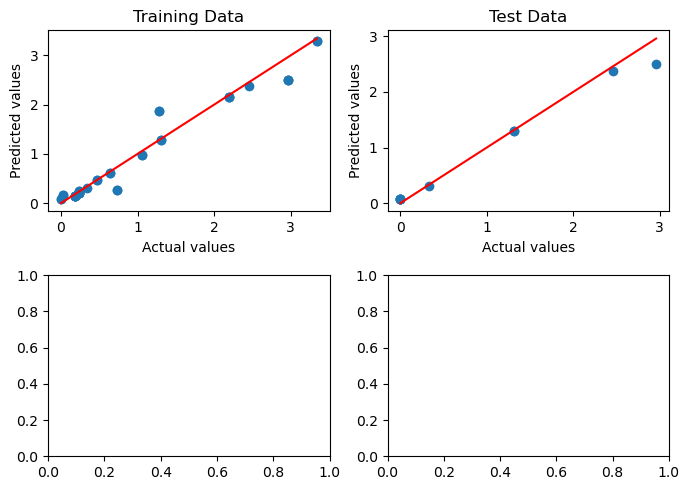

[Epsilonf] Epoch [1720/2000], Loss: 0.0468
Train R²:  0.95658
Test R² :  0.97322


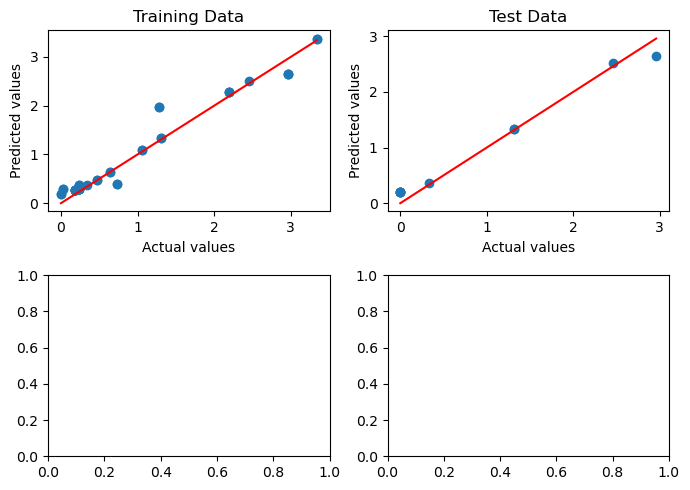

[Epsilonf] Epoch [1740/2000], Loss: 0.0471
Train R²:  0.95631
Test R² :  0.97590


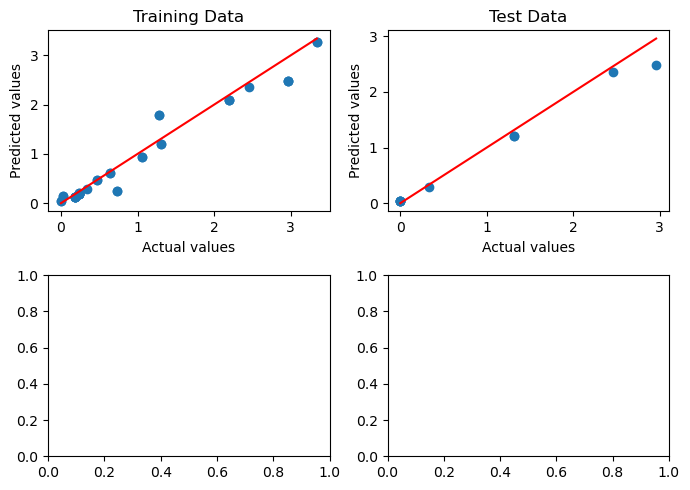

[Epsilonf] Epoch [1760/2000], Loss: 0.0492
Train R²:  0.95440
Test R² :  0.97339


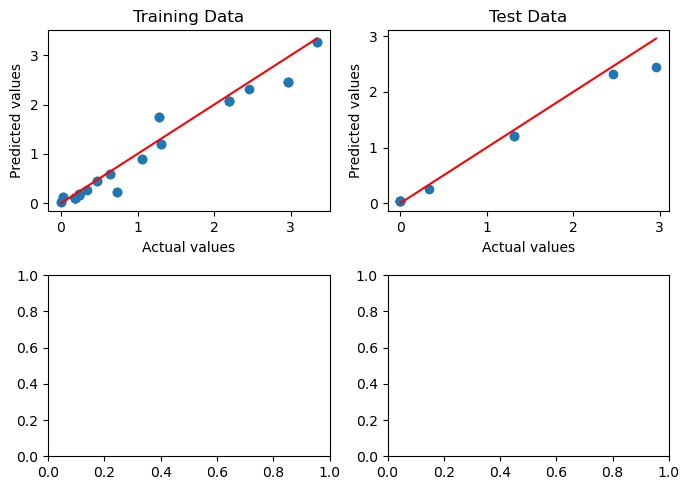

[Epsilonf] Epoch [1780/2000], Loss: 0.0418
Train R²:  0.96122
Test R² :  0.97969


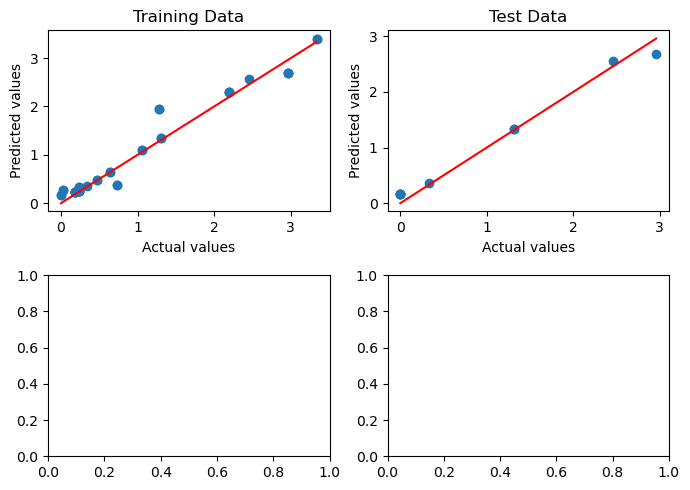

[Epsilonf] Epoch [1800/2000], Loss: 0.0401
Train R²:  0.96286
Test R² :  0.97442


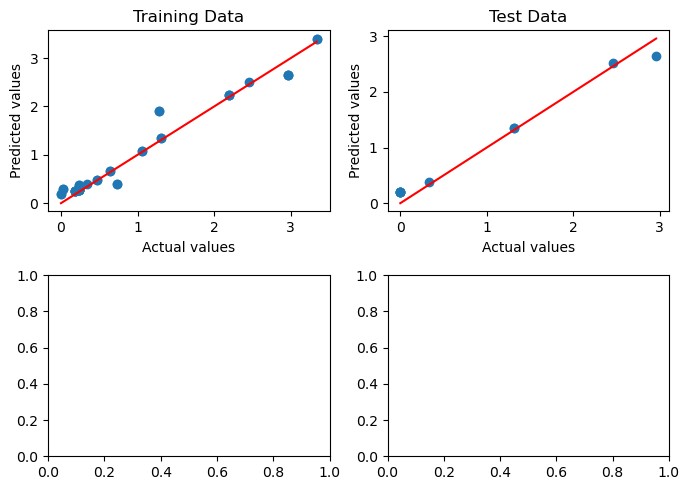

[Epsilonf] Epoch [1820/2000], Loss: 0.0377
Train R²:  0.96509
Test R² :  0.98191


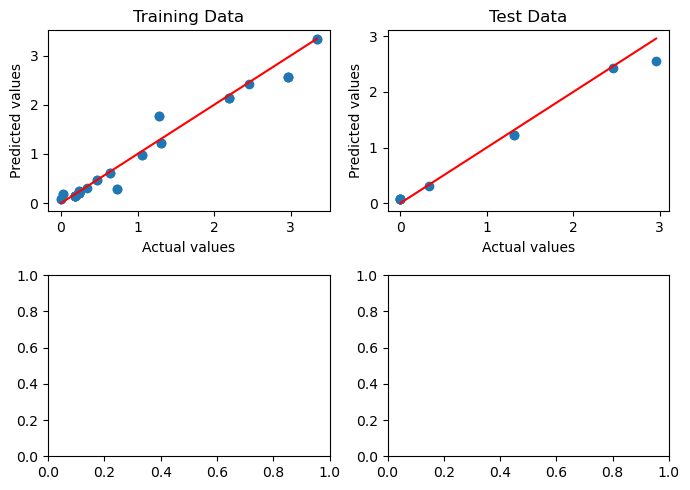

[Epsilonf] Epoch [1840/2000], Loss: 0.0543
Train R²:  0.94964
Test R² :  0.96937


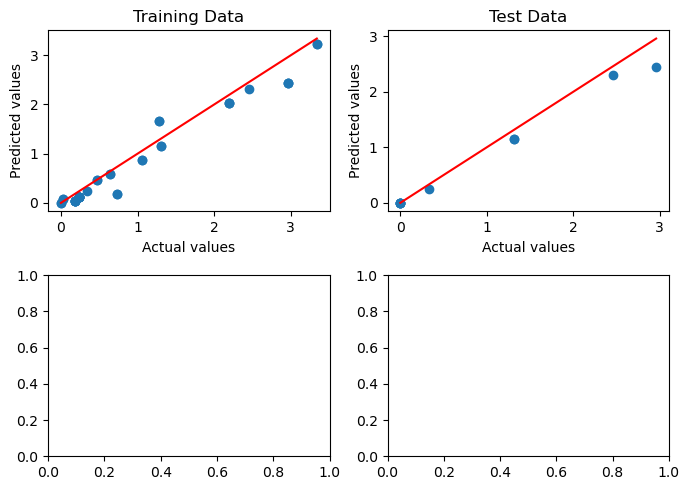

[Epsilonf] Epoch [1860/2000], Loss: 0.0347
Train R²:  0.96787
Test R² :  0.97797


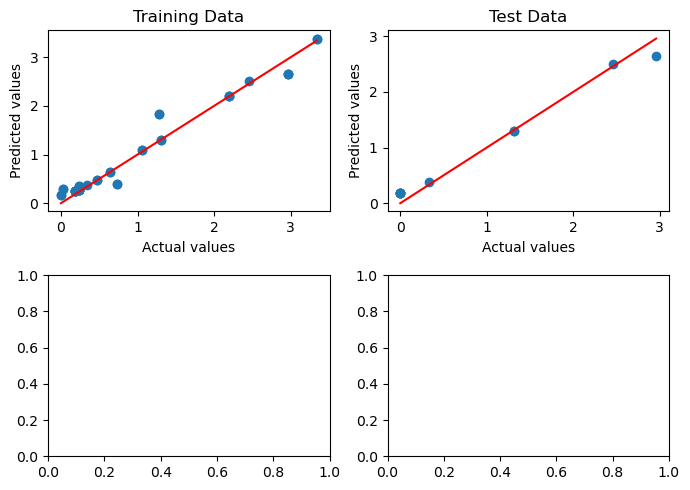

[Epsilonf] Epoch [1880/2000], Loss: 0.0395
Train R²:  0.96342
Test R² :  0.98068


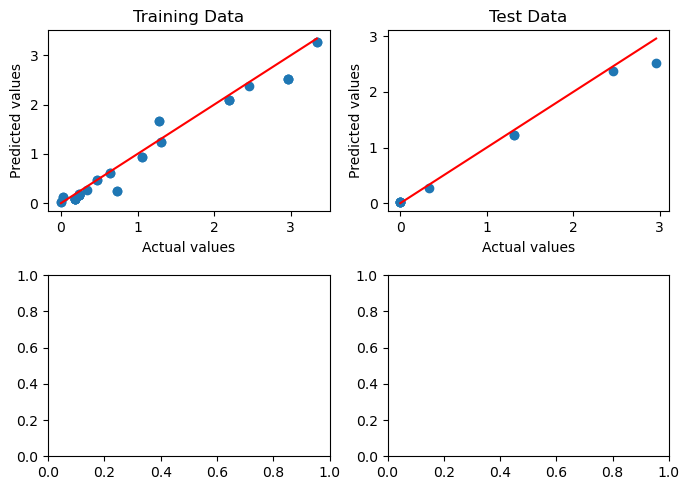

[Epsilonf] Epoch [1900/2000], Loss: 0.0317
Train R²:  0.97065
Test R² :  0.98647


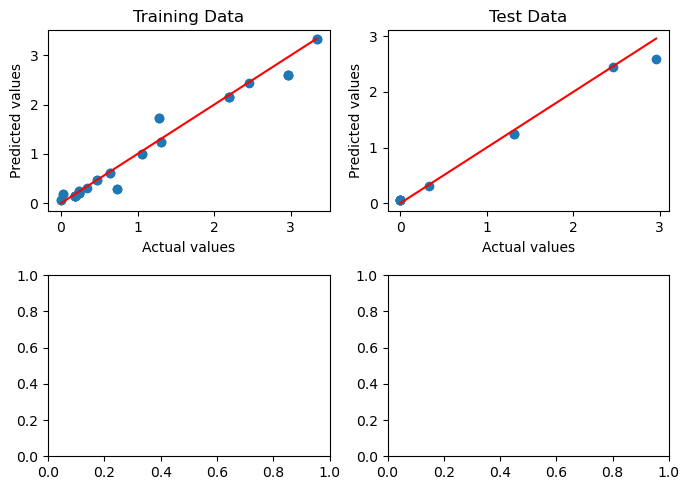

[Epsilonf] Epoch [1920/2000], Loss: 0.0433
Train R²:  0.95988
Test R² :  0.96643


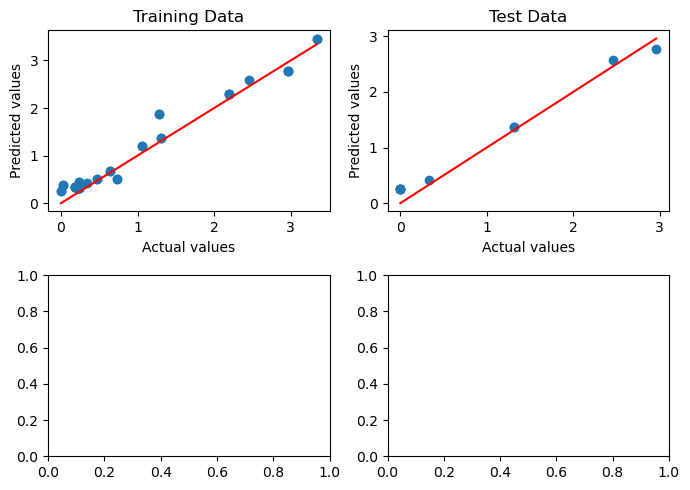

[Epsilonf] Epoch [1940/2000], Loss: 0.0297
Train R²:  0.97243
Test R² :  0.98344


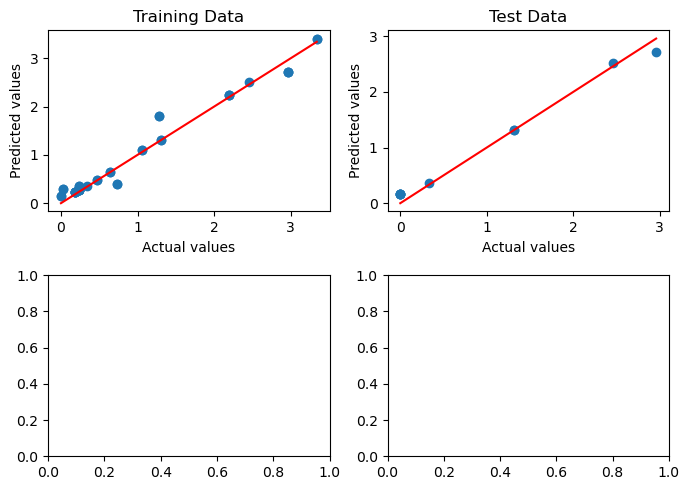

[Epsilonf] Epoch [1960/2000], Loss: 0.0500
Train R²:  0.95366
Test R² :  0.97232


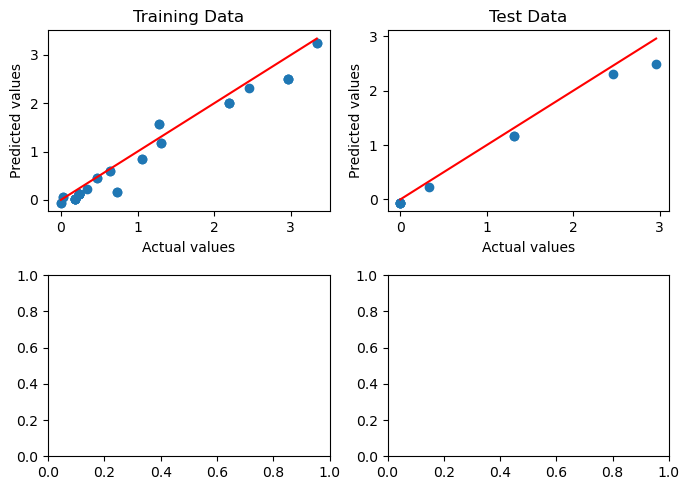

[Epsilonf] Epoch [1980/2000], Loss: 0.0258
Train R²:  0.97607
Test R² :  0.98768


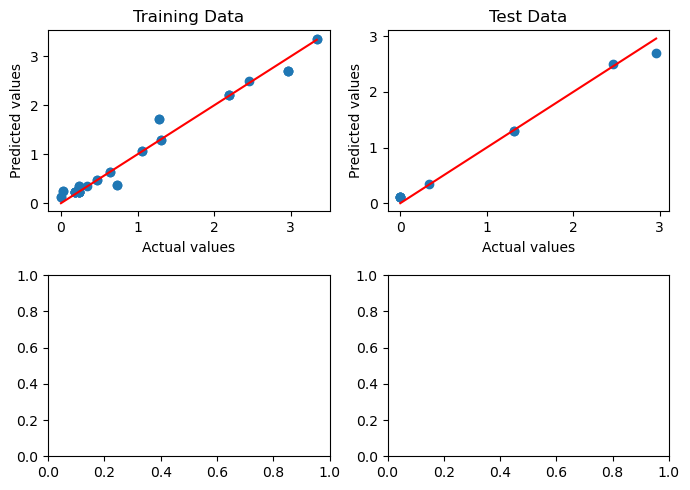

[Epsilonf] Epoch [2000/2000], Loss: 0.0261
Train R²:  0.97577
Test R² :  0.98899


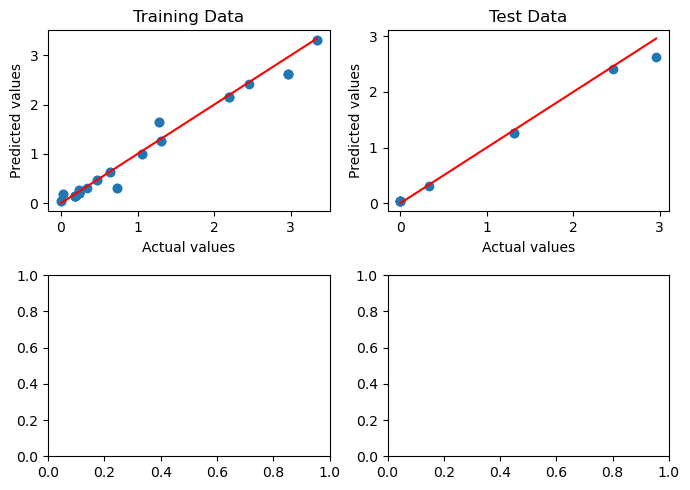

In [9]:
DNN(6)

[c] Epoch [20/2000], Loss: 0.4018
Train R²:  -7.47275
Test R² :  -26.37023


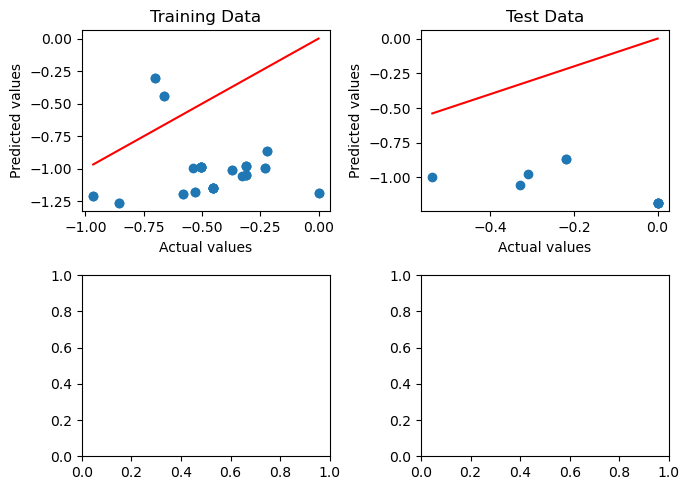

[c] Epoch [40/2000], Loss: 0.2666
Train R²:  -4.62150
Test R² :  -20.96650


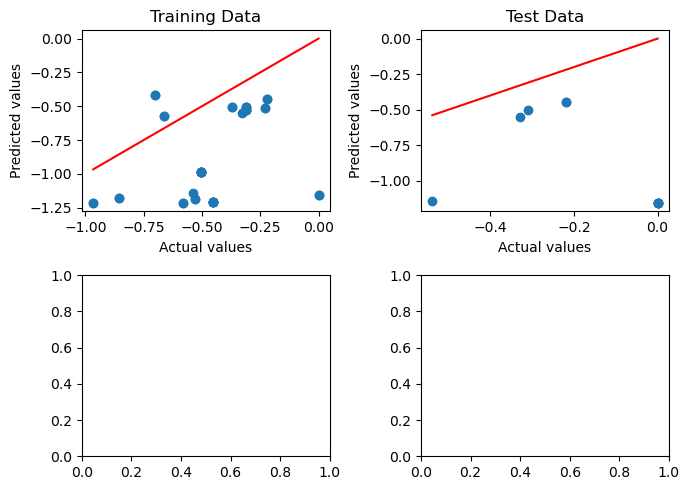

[c] Epoch [60/2000], Loss: 0.0438
Train R²:  0.07607
Test R² :  -3.46637


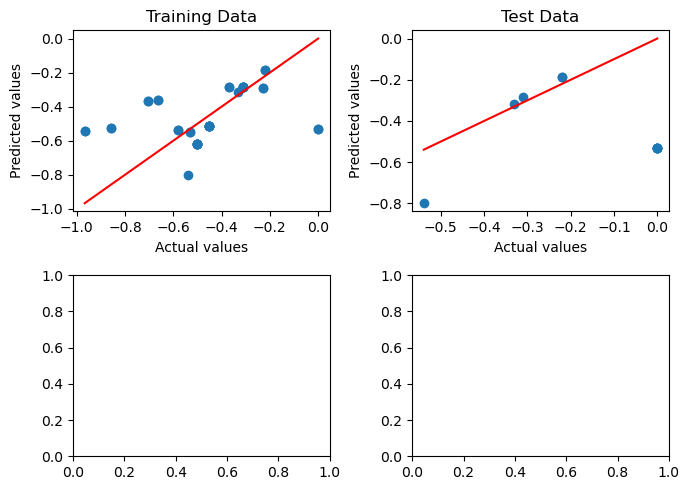

[c] Epoch [80/2000], Loss: 0.0424
Train R²:  0.10542
Test R² :  -2.46881


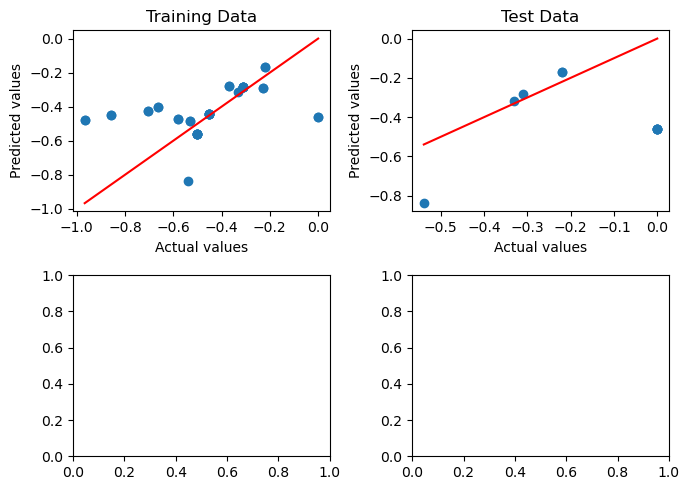

[c] Epoch [100/2000], Loss: 0.0374
Train R²:  0.21065
Test R² :  -2.95842


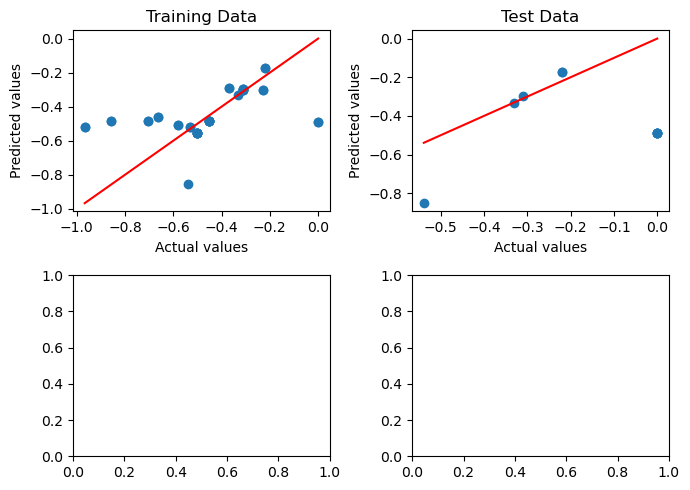

[c] Epoch [120/2000], Loss: 0.0350
Train R²:  0.26226
Test R² :  -3.30247


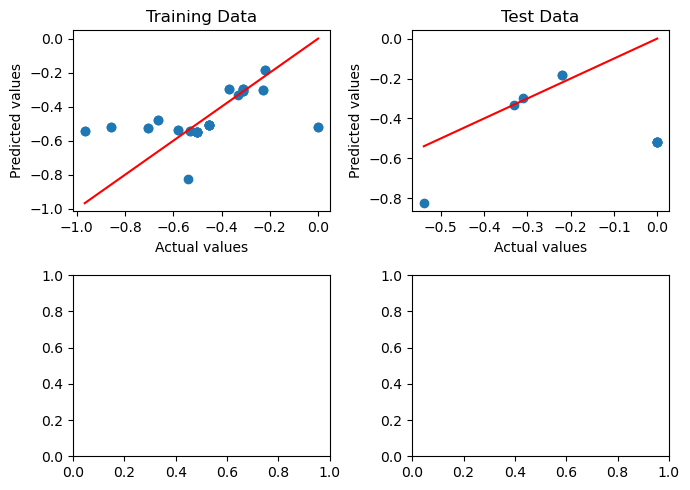

[c] Epoch [140/2000], Loss: 0.0333
Train R²:  0.29877
Test R² :  -3.44162


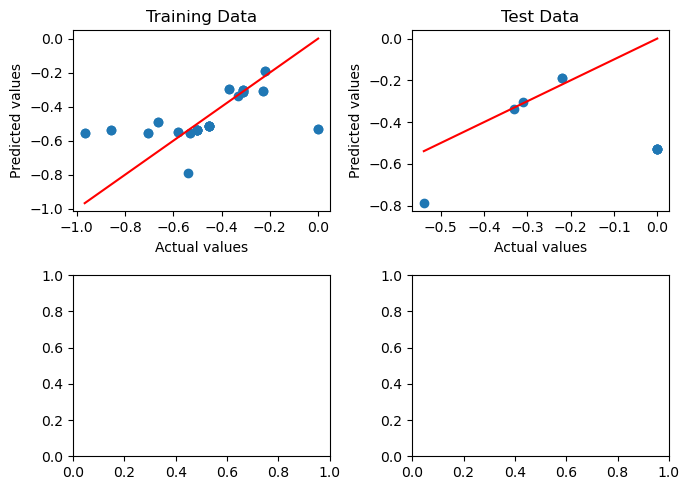

[c] Epoch [160/2000], Loss: 0.0320
Train R²:  0.32609
Test R² :  -3.51805


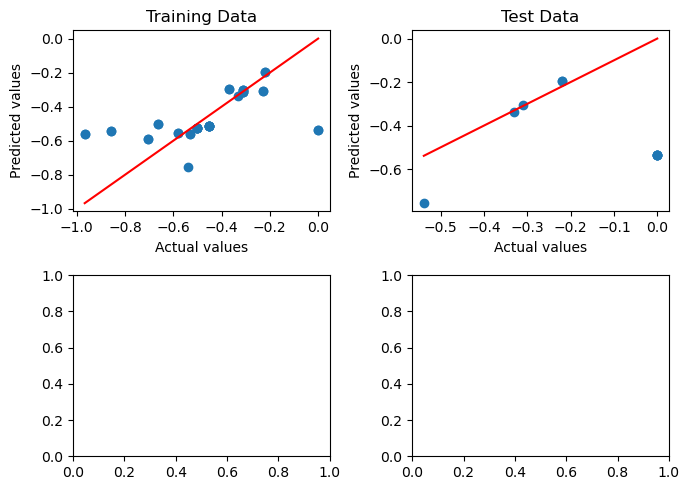

[c] Epoch [180/2000], Loss: 0.0310
Train R²:  0.34715
Test R² :  -3.57808


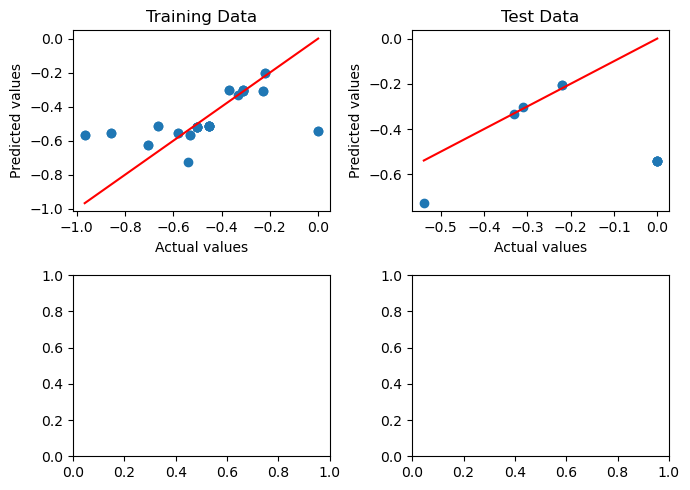

[c] Epoch [200/2000], Loss: 0.0303
Train R²:  0.36186
Test R² :  -3.59117


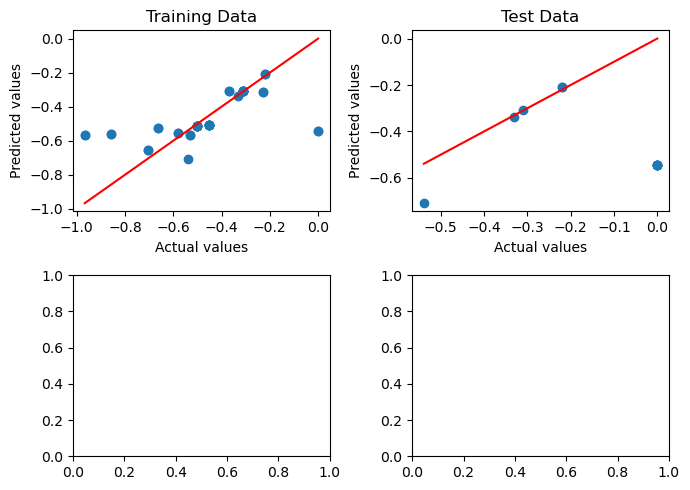

[c] Epoch [220/2000], Loss: 0.0297
Train R²:  0.37355
Test R² :  -3.61698


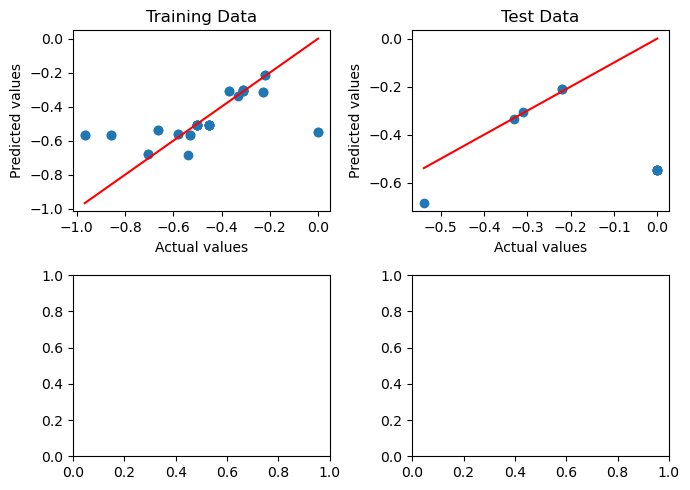

[c] Epoch [240/2000], Loss: 0.0293
Train R²:  0.38259
Test R² :  -3.62901


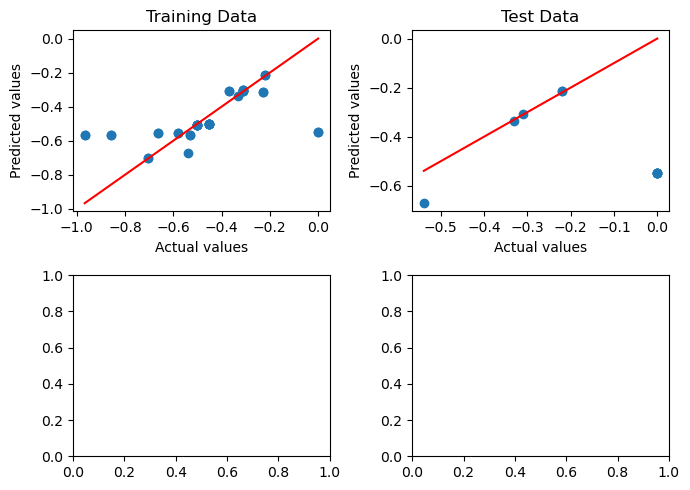

[c] Epoch [260/2000], Loss: 0.0289
Train R²:  0.38964
Test R² :  -3.69004


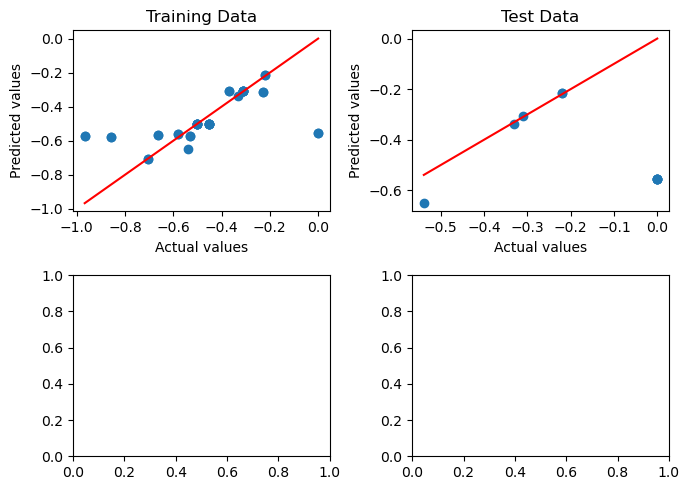

[c] Epoch [280/2000], Loss: 0.0287
Train R²:  0.39482
Test R² :  -3.71046


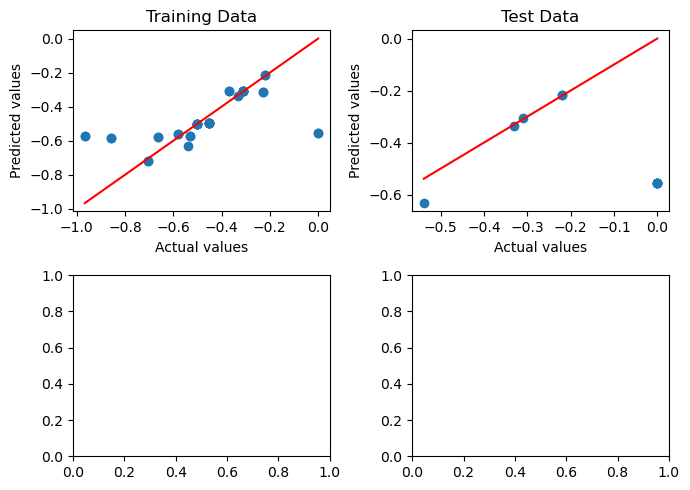

[c] Epoch [300/2000], Loss: 0.0285
Train R²:  0.39871
Test R² :  -3.72874


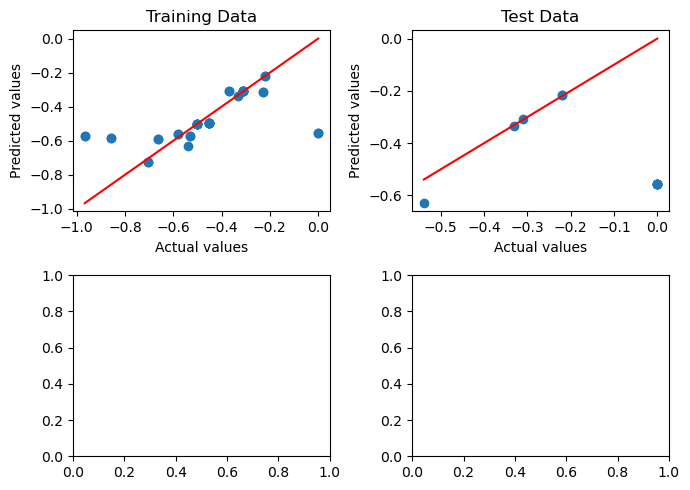

[c] Epoch [320/2000], Loss: 0.0284
Train R²:  0.40178
Test R² :  -3.74695


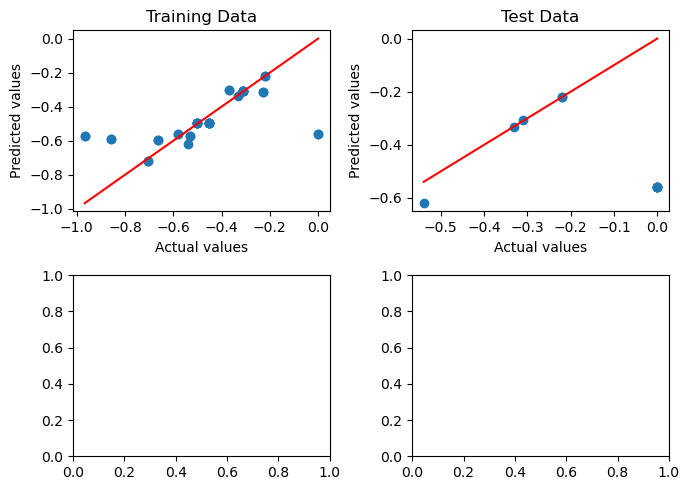

[c] Epoch [340/2000], Loss: 0.0282
Train R²:  0.40463
Test R² :  -3.77530


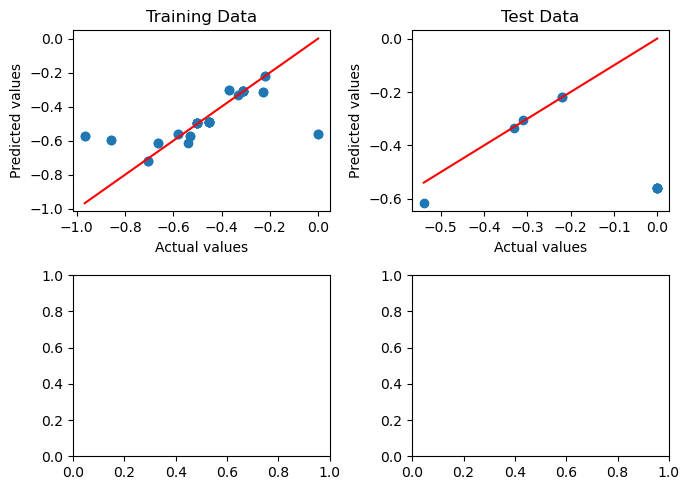

[c] Epoch [360/2000], Loss: 0.0281
Train R²:  0.40697
Test R² :  -3.81000


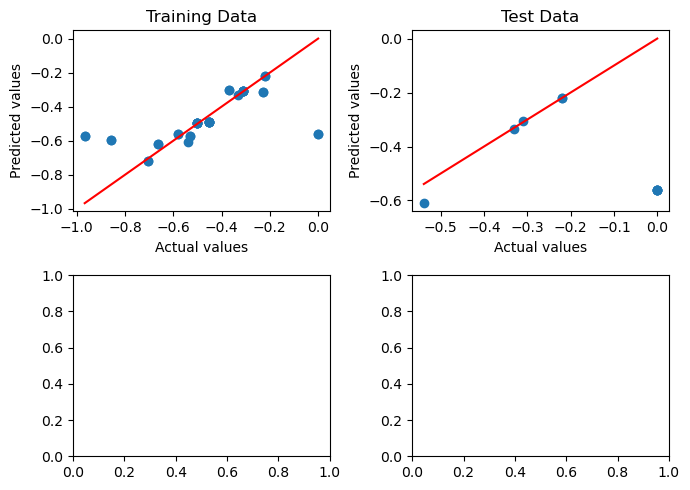

[c] Epoch [380/2000], Loss: 0.0280
Train R²:  0.40894
Test R² :  -3.81907


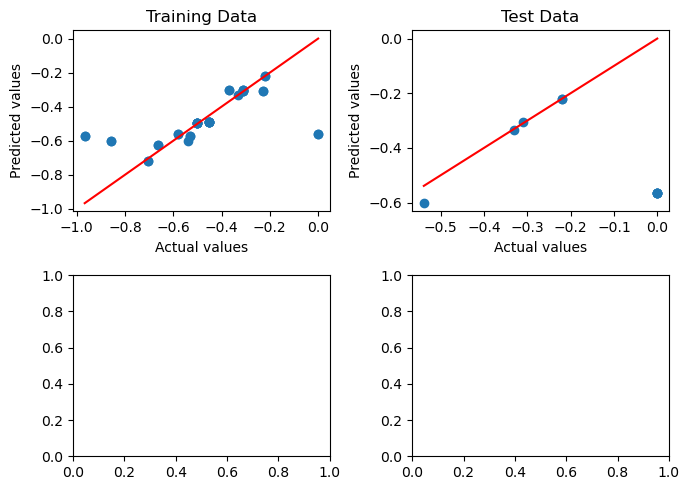

[c] Epoch [400/2000], Loss: 0.0279
Train R²:  0.41064
Test R² :  -3.84388


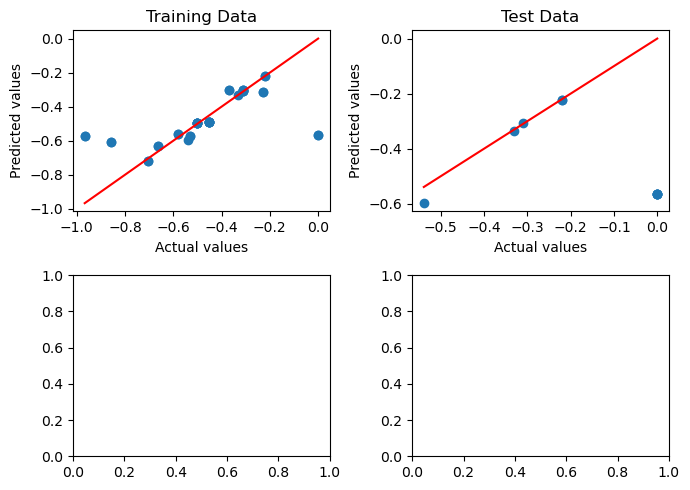

[c] Epoch [420/2000], Loss: 0.0279
Train R²:  0.41217
Test R² :  -3.84244


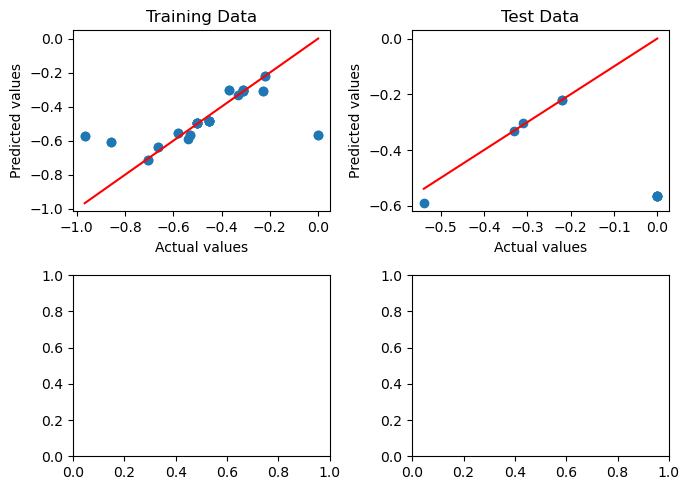

[c] Epoch [440/2000], Loss: 0.0278
Train R²:  0.41348
Test R² :  -3.88155


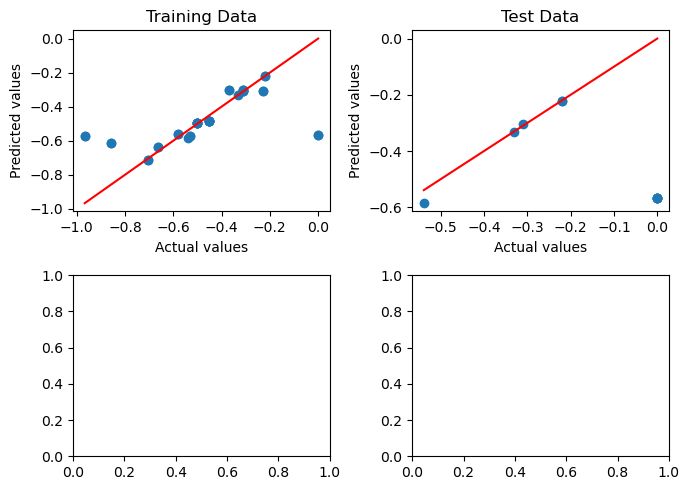

[c] Epoch [460/2000], Loss: 0.0278
Train R²:  0.41463
Test R² :  -3.88566


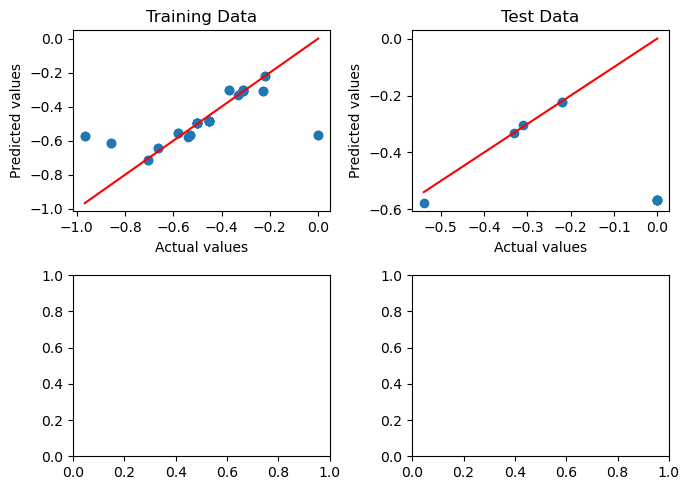

[c] Epoch [480/2000], Loss: 0.0277
Train R²:  0.41562
Test R² :  -3.89800


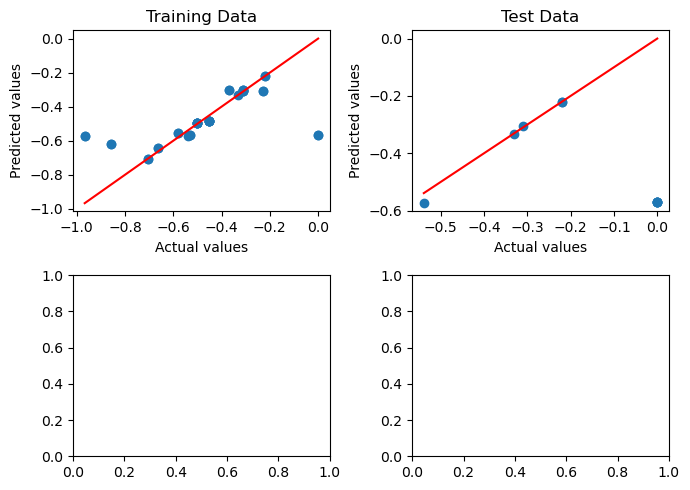

[c] Epoch [500/2000], Loss: 0.0277
Train R²:  0.41654
Test R² :  -3.91029


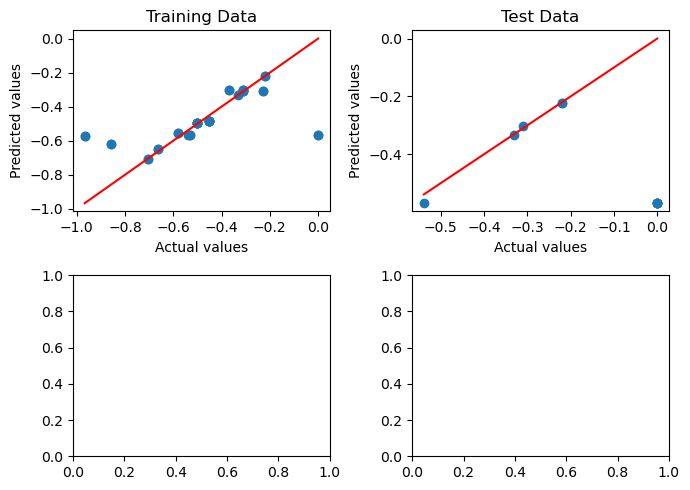

[c] Epoch [520/2000], Loss: 0.0276
Train R²:  0.41733
Test R² :  -3.91891


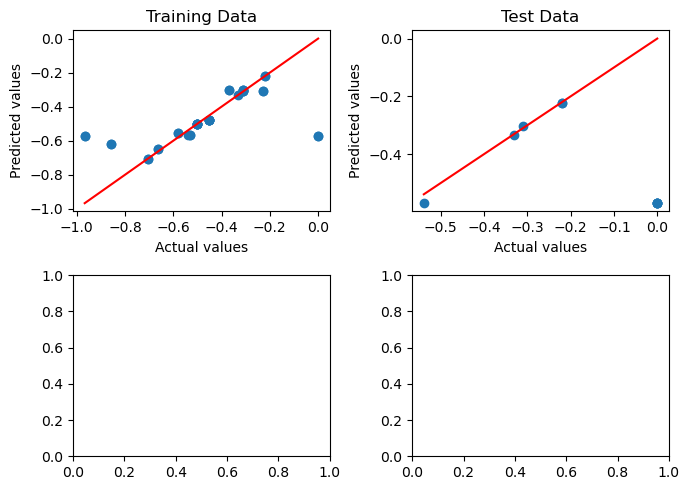

[c] Epoch [540/2000], Loss: 0.0276
Train R²:  0.41806
Test R² :  -3.91981


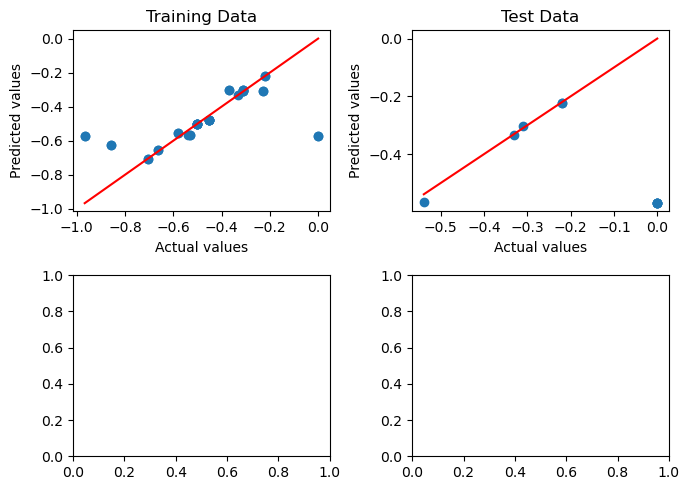

[c] Epoch [560/2000], Loss: 0.0276
Train R²:  0.41879
Test R² :  -3.93522


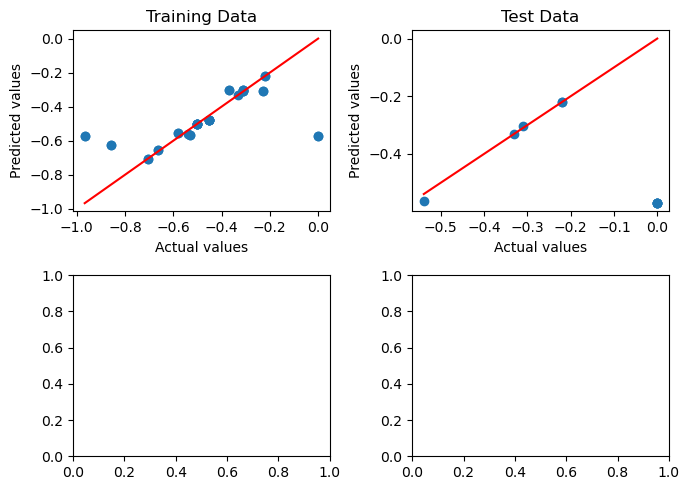

[c] Epoch [580/2000], Loss: 0.0275
Train R²:  0.41949
Test R² :  -3.93601


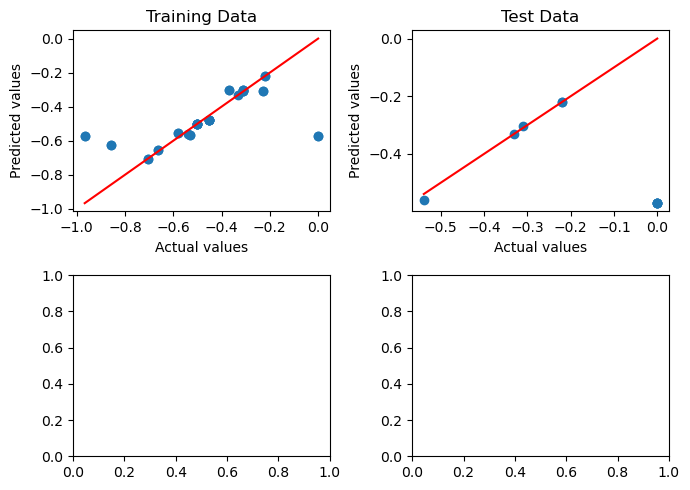

[c] Epoch [600/2000], Loss: 0.0275
Train R²:  0.42012
Test R² :  -3.94050


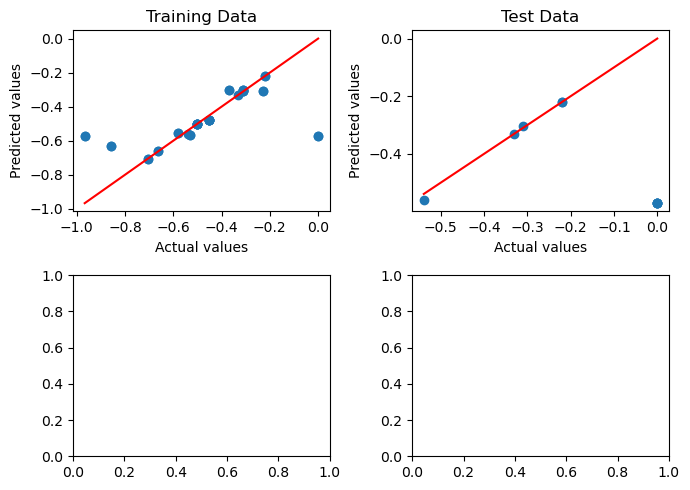

[c] Epoch [620/2000], Loss: 0.0275
Train R²:  0.42077
Test R² :  -3.94470


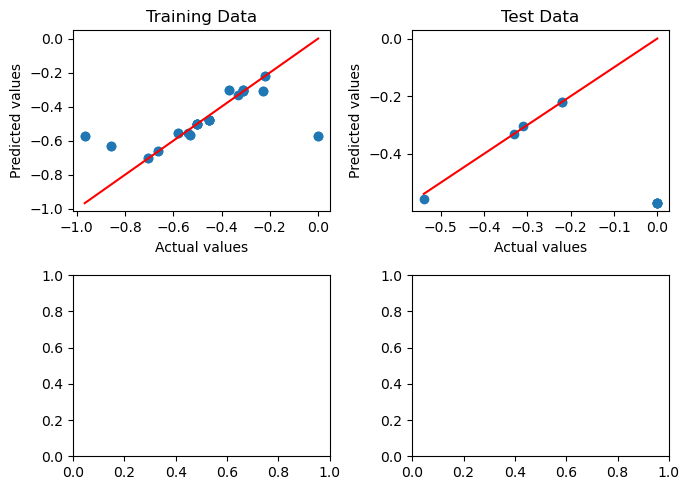

[c] Epoch [640/2000], Loss: 0.0274
Train R²:  0.42140
Test R² :  -3.94754


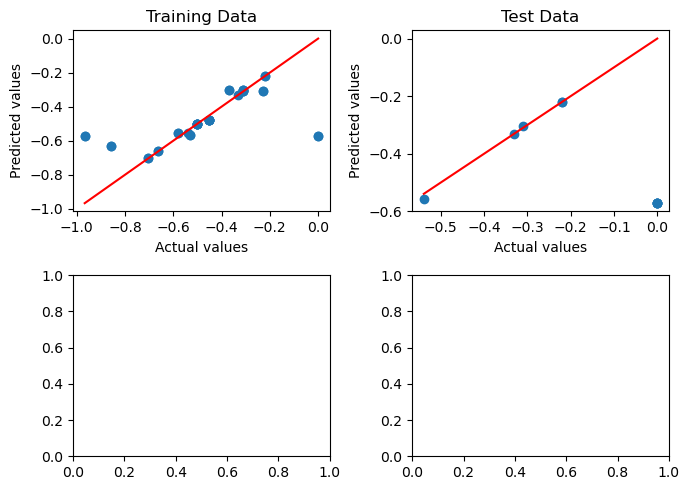

[c] Epoch [660/2000], Loss: 0.0274
Train R²:  0.42199
Test R² :  -3.94330


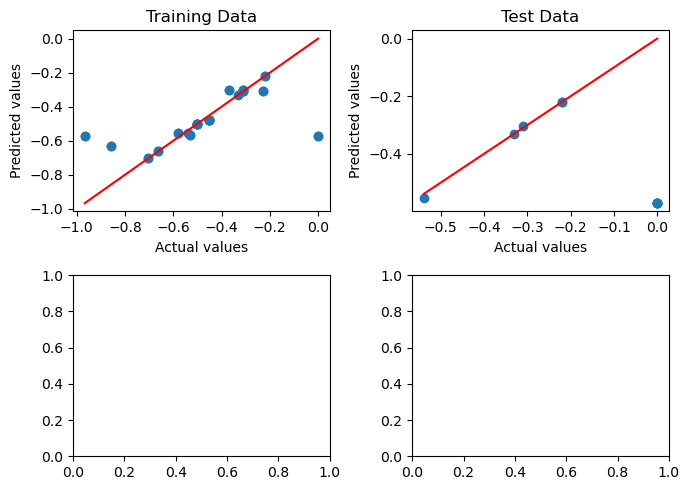

[c] Epoch [680/2000], Loss: 0.0274
Train R²:  0.42260
Test R² :  -3.94469


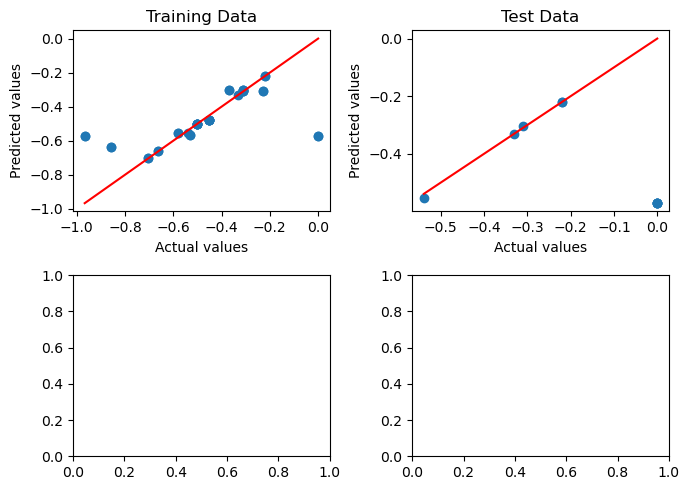

[c] Epoch [700/2000], Loss: 0.0274
Train R²:  0.42314
Test R² :  -3.94000


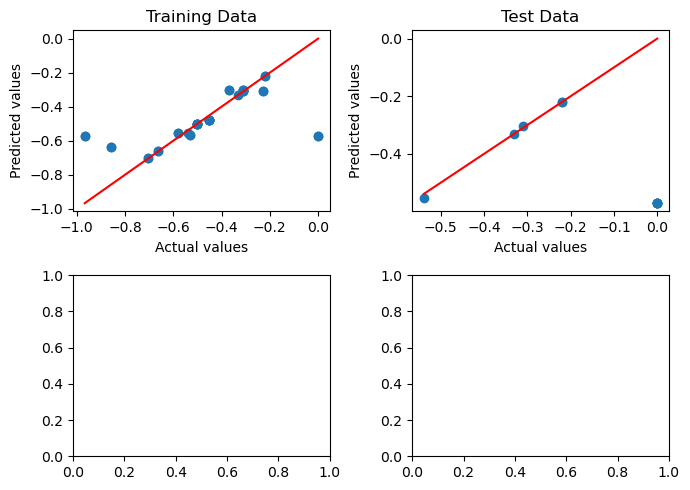

[c] Epoch [720/2000], Loss: 0.0273
Train R²:  0.42379
Test R² :  -3.94097


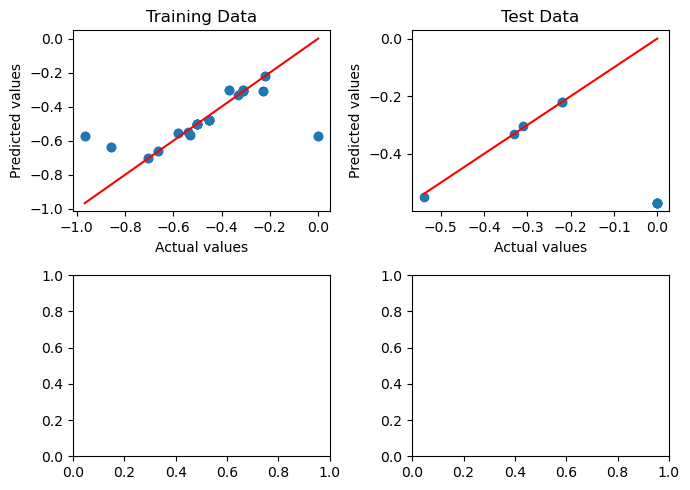

[c] Epoch [740/2000], Loss: 0.0273
Train R²:  0.42441
Test R² :  -3.93849


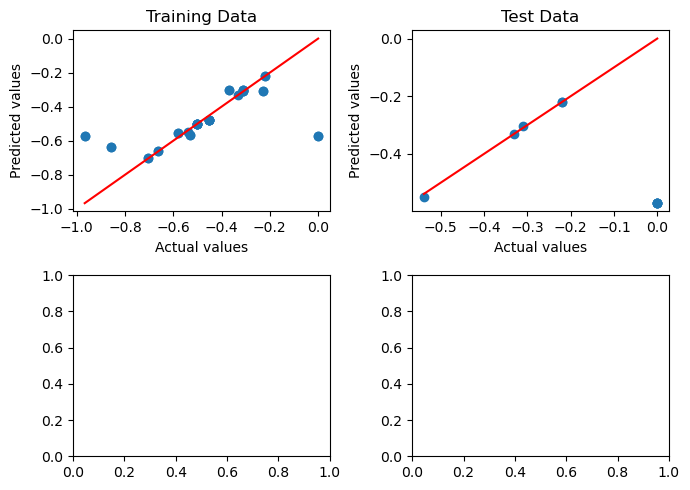

[c] Epoch [760/2000], Loss: 0.0273
Train R²:  0.42500
Test R² :  -3.93384


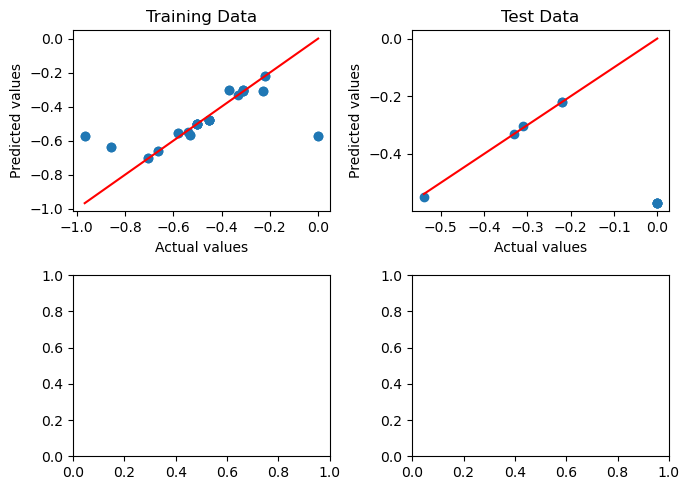

[c] Epoch [780/2000], Loss: 0.0272
Train R²:  0.42558
Test R² :  -3.93070


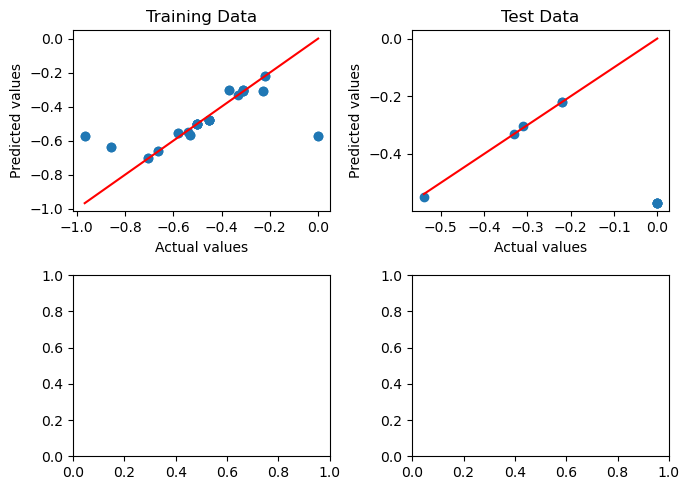

[c] Epoch [800/2000], Loss: 0.0272
Train R²:  0.42622
Test R² :  -3.92684


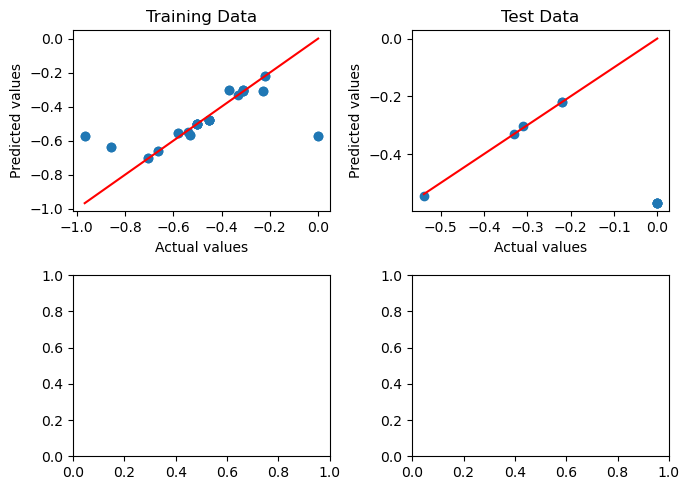

[c] Epoch [820/2000], Loss: 0.0272
Train R²:  0.42678
Test R² :  -3.92286


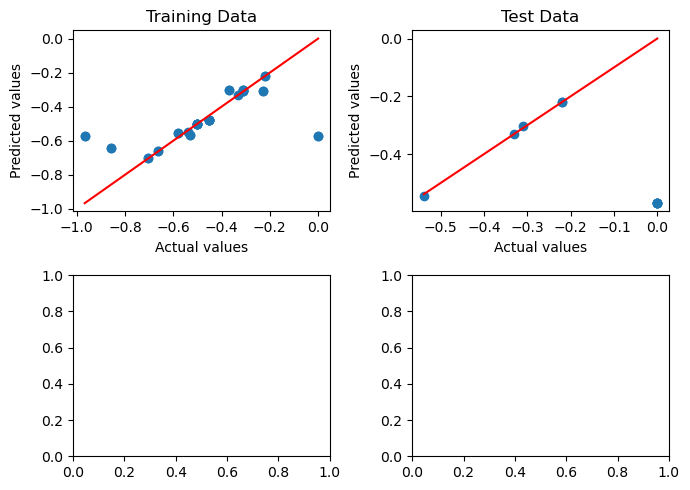

[c] Epoch [840/2000], Loss: 0.0272
Train R²:  0.42744
Test R² :  -3.91458


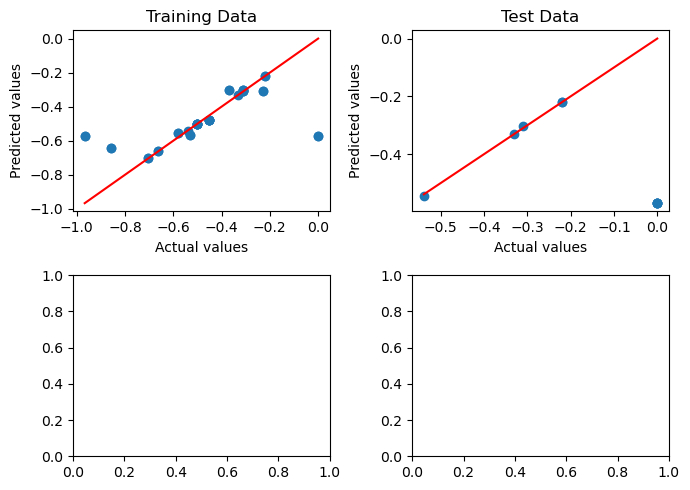

[c] Epoch [860/2000], Loss: 0.0271
Train R²:  0.42805
Test R² :  -3.90739


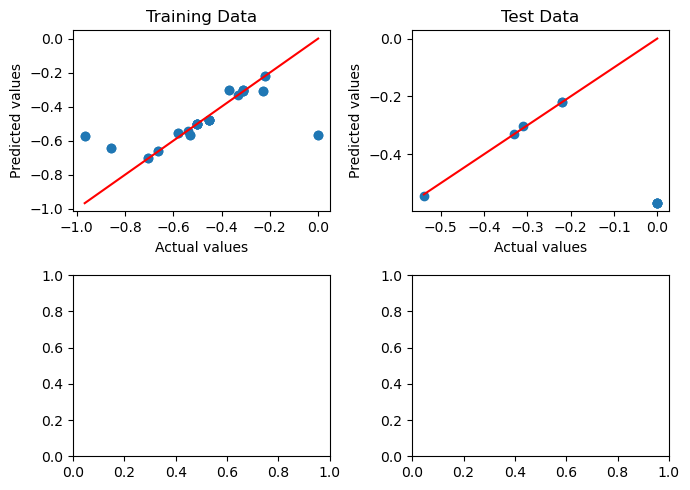

[c] Epoch [880/2000], Loss: 0.0271
Train R²:  0.42868
Test R² :  -3.90236


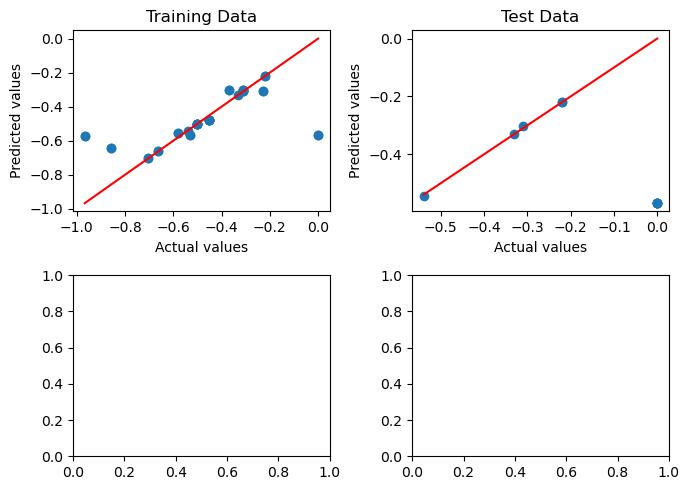

[c] Epoch [900/2000], Loss: 0.0271
Train R²:  0.42930
Test R² :  -3.89902


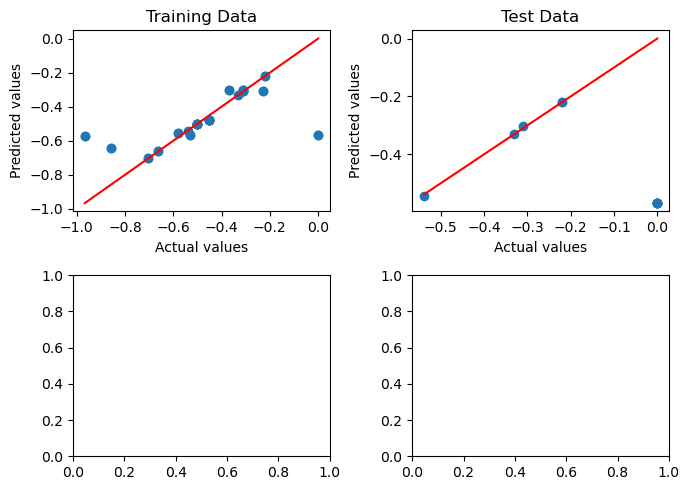

[c] Epoch [920/2000], Loss: 0.0270
Train R²:  0.42995
Test R² :  -3.89295


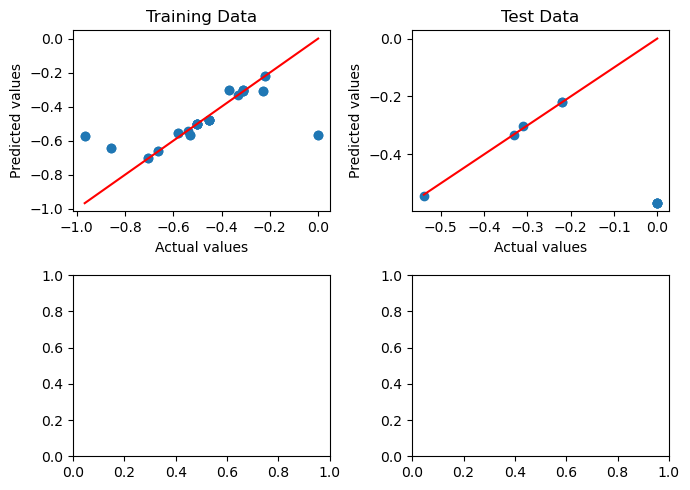

[c] Epoch [940/2000], Loss: 0.0270
Train R²:  0.43060
Test R² :  -3.88458


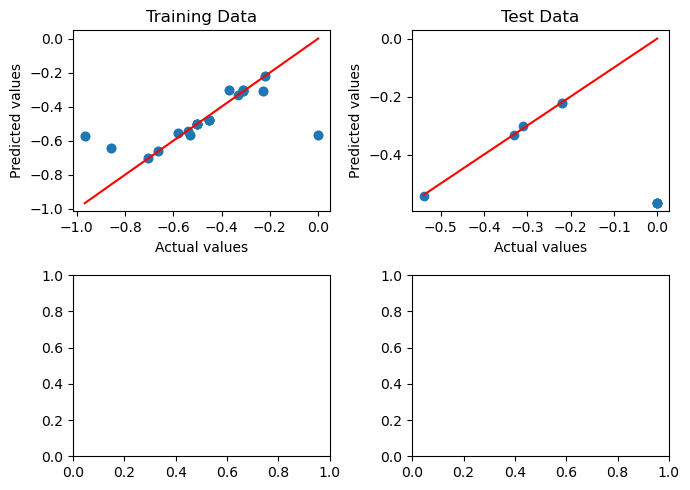

[c] Epoch [960/2000], Loss: 0.0270
Train R²:  0.43120
Test R² :  -3.87549


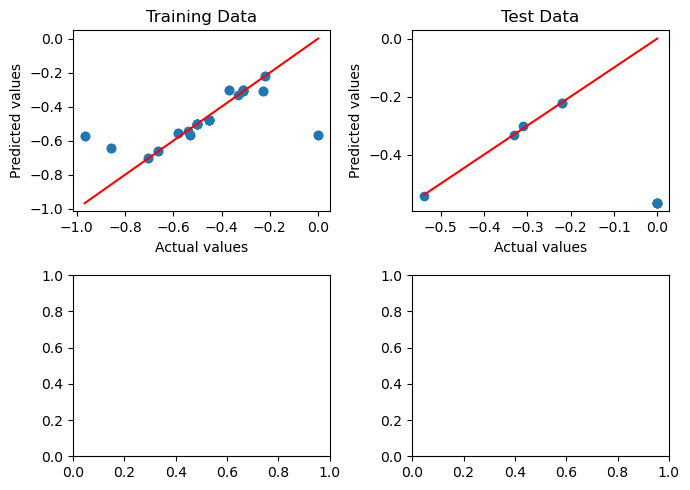

[c] Epoch [980/2000], Loss: 0.0269
Train R²:  0.43188
Test R² :  -3.86960


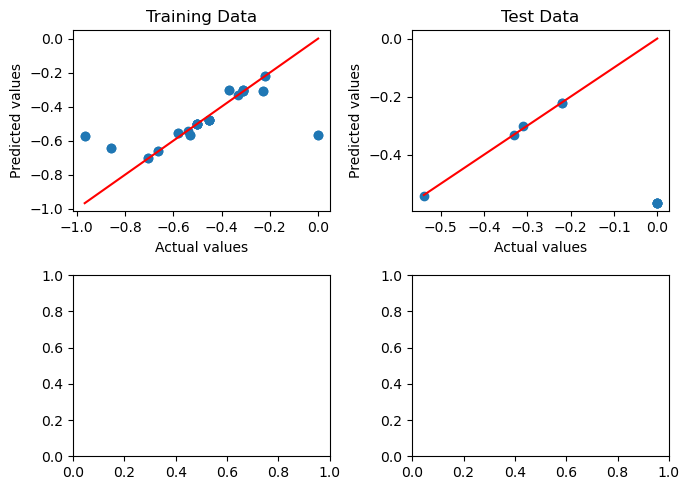

[c] Epoch [1000/2000], Loss: 0.0269
Train R²:  0.43256
Test R² :  -3.86554


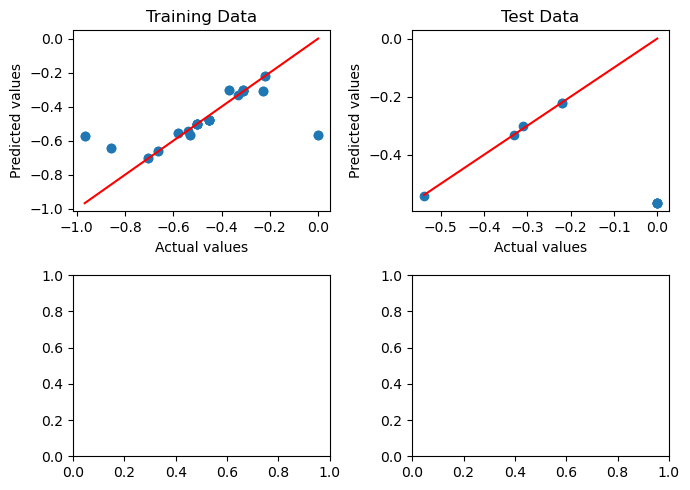

[c] Epoch [1020/2000], Loss: 0.0269
Train R²:  0.43322
Test R² :  -3.85927


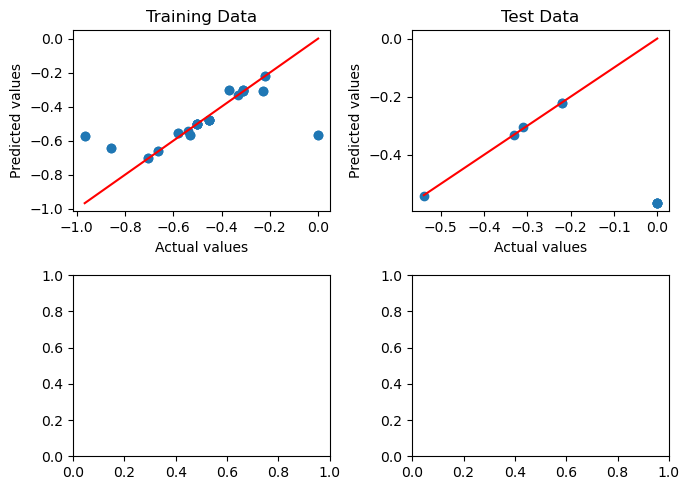

[c] Epoch [1040/2000], Loss: 0.0268
Train R²:  0.43388
Test R² :  -3.84852


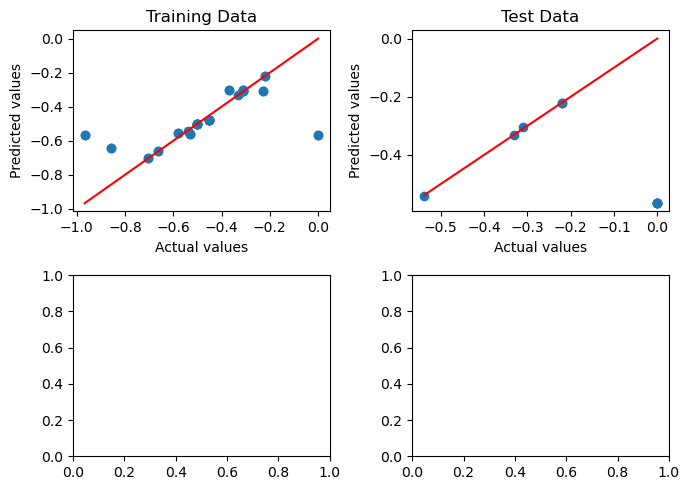

[c] Epoch [1060/2000], Loss: 0.0268
Train R²:  0.43454
Test R² :  -3.84161


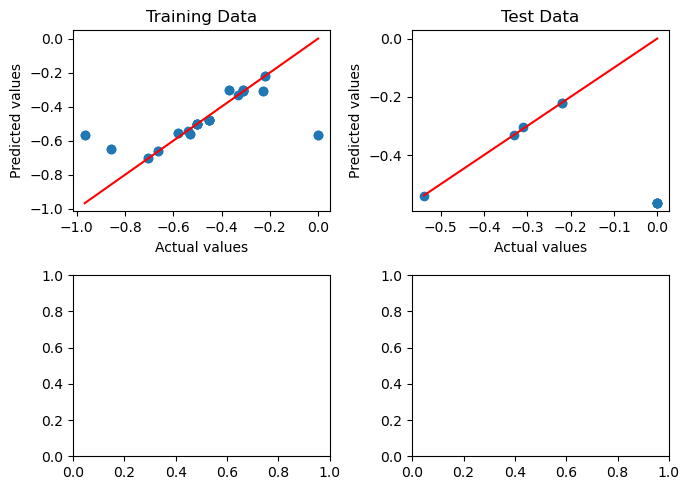

[c] Epoch [1080/2000], Loss: 0.0268
Train R²:  0.43522
Test R² :  -3.83735


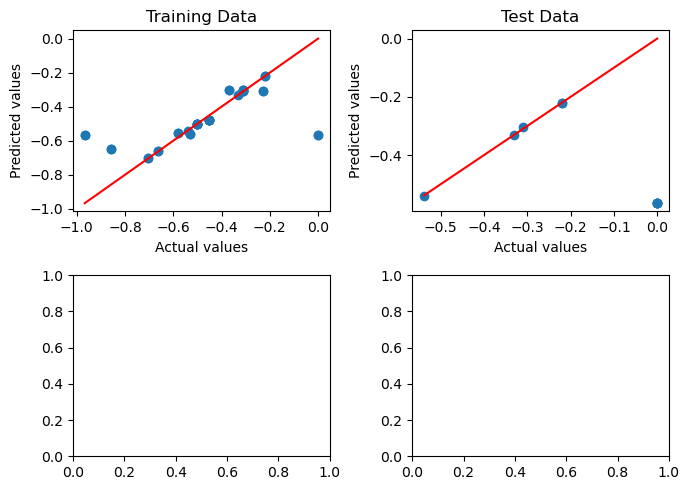

[c] Epoch [1100/2000], Loss: 0.0267
Train R²:  0.43593
Test R² :  -3.83163


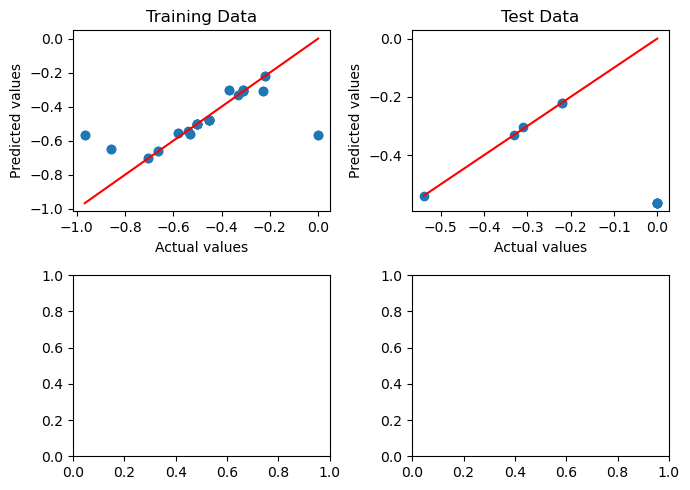

[c] Epoch [1120/2000], Loss: 0.0267
Train R²:  0.43663
Test R² :  -3.82070


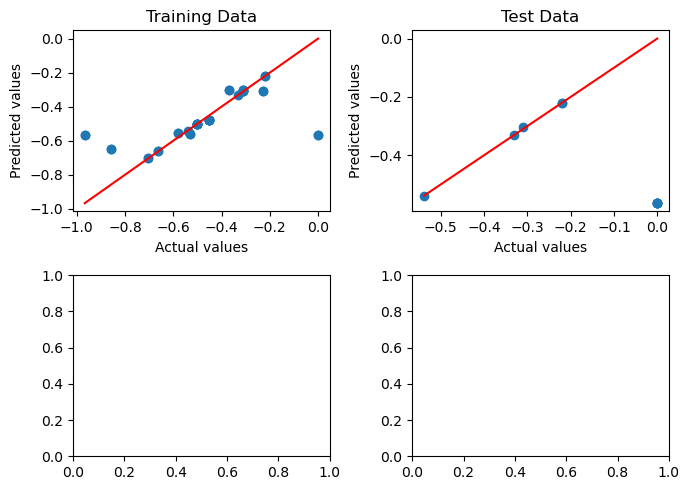

[c] Epoch [1140/2000], Loss: 0.0267
Train R²:  0.43729
Test R² :  -3.81065


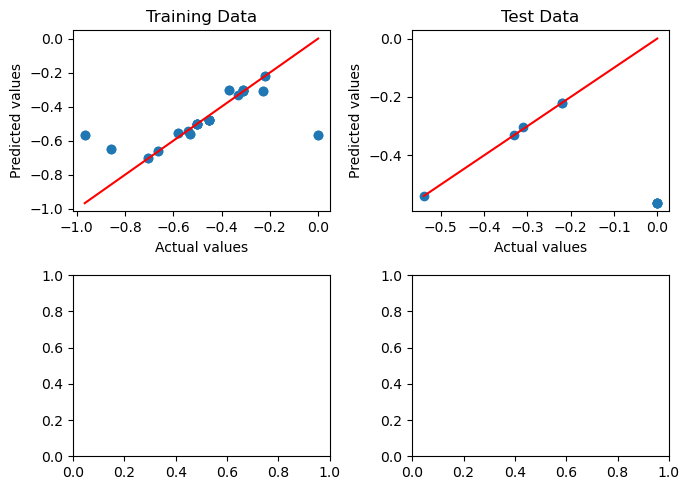

[c] Epoch [1160/2000], Loss: 0.0266
Train R²:  0.43804
Test R² :  -3.80780


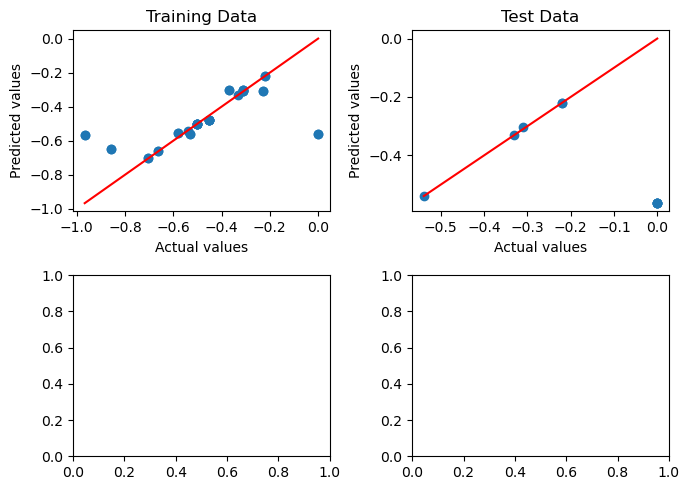

[c] Epoch [1180/2000], Loss: 0.0266
Train R²:  0.43890
Test R² :  -3.80334


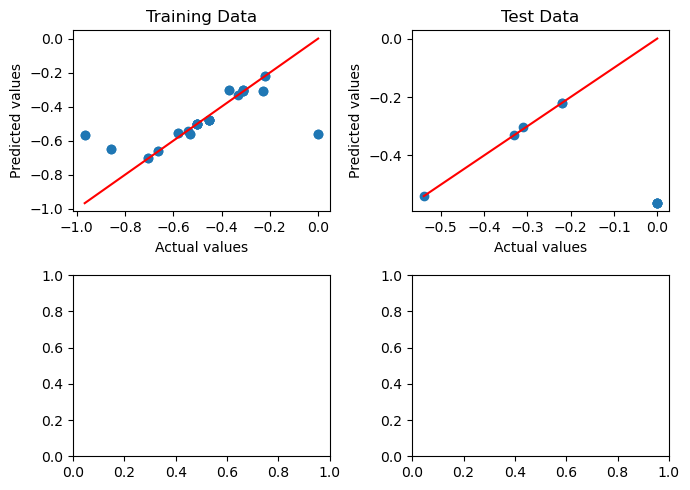

[c] Epoch [1200/2000], Loss: 0.0266
Train R²:  0.43970
Test R² :  -3.79108


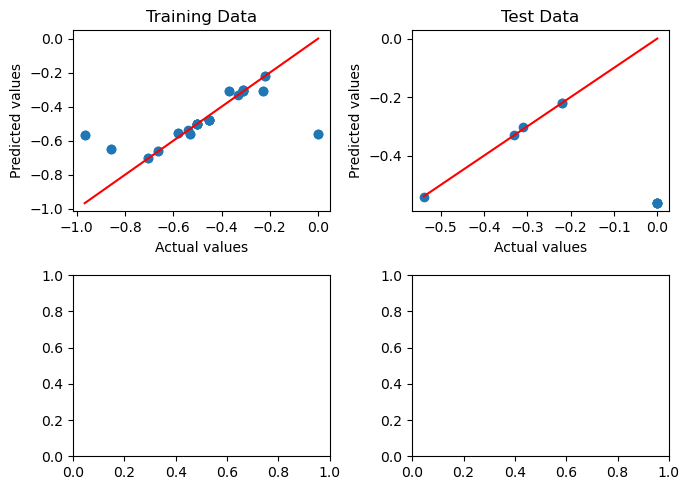

[c] Epoch [1220/2000], Loss: 0.0265
Train R²:  0.44043
Test R² :  -3.77938


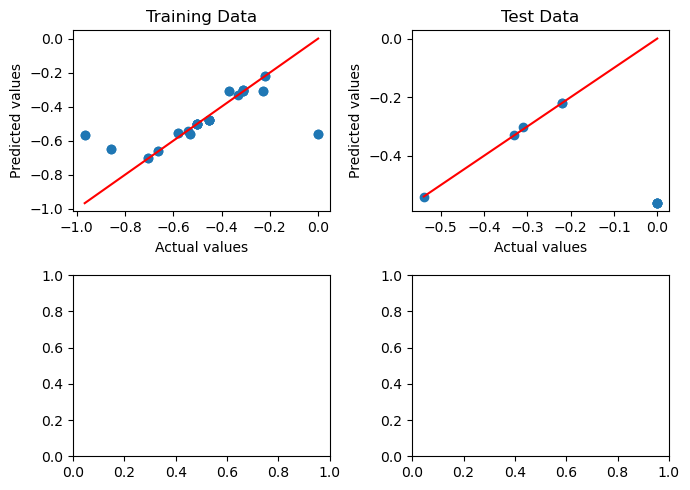

[c] Epoch [1240/2000], Loss: 0.0265
Train R²:  0.44119
Test R² :  -3.77692


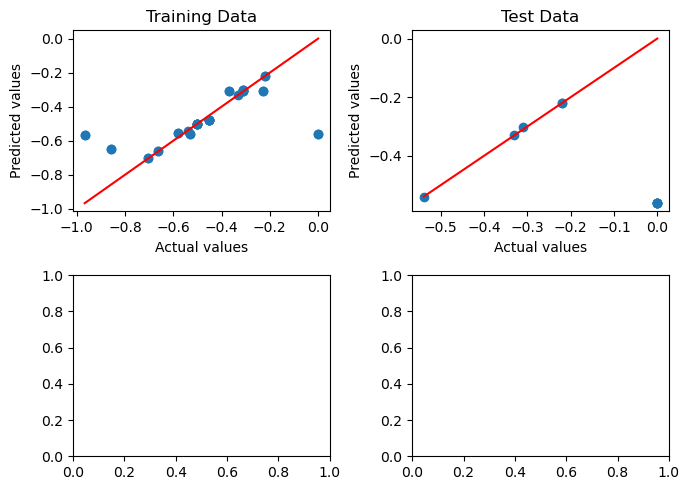

[c] Epoch [1260/2000], Loss: 0.0265
Train R²:  0.44194
Test R² :  -3.77065


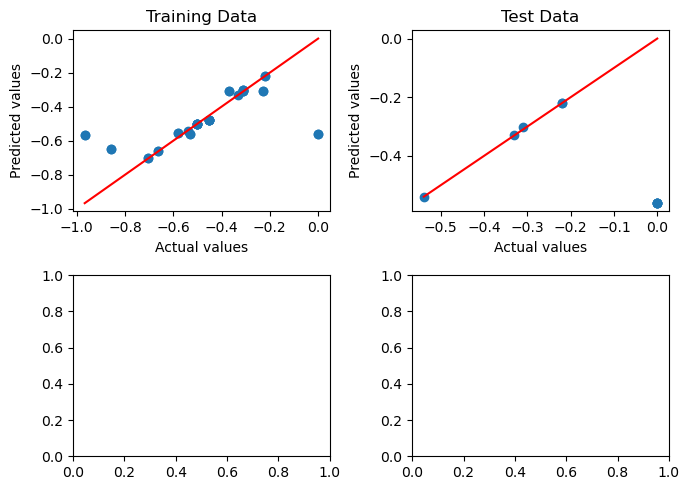

[c] Epoch [1280/2000], Loss: 0.0264
Train R²:  0.44269
Test R² :  -3.75168


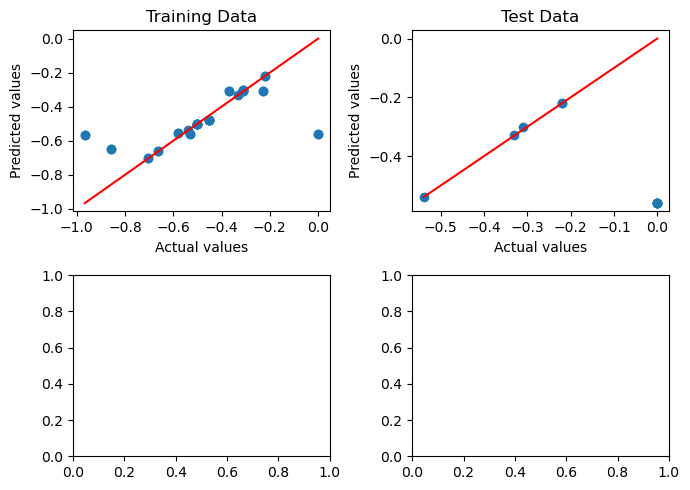

[c] Epoch [1300/2000], Loss: 0.0264
Train R²:  0.44352
Test R² :  -3.75223


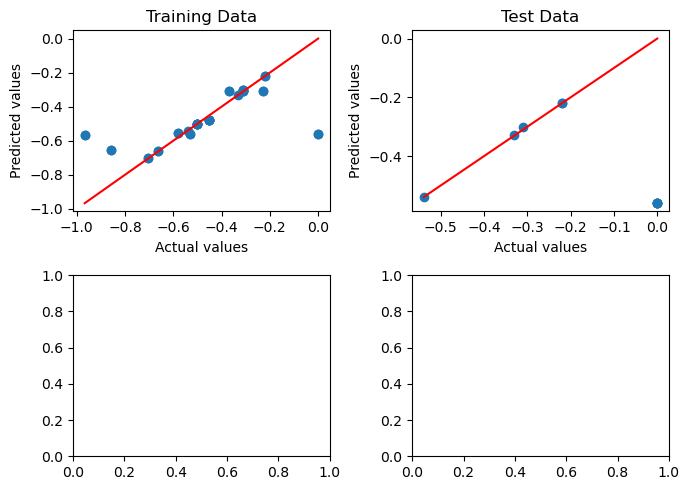

[c] Epoch [1320/2000], Loss: 0.0264
Train R²:  0.44429
Test R² :  -3.74242


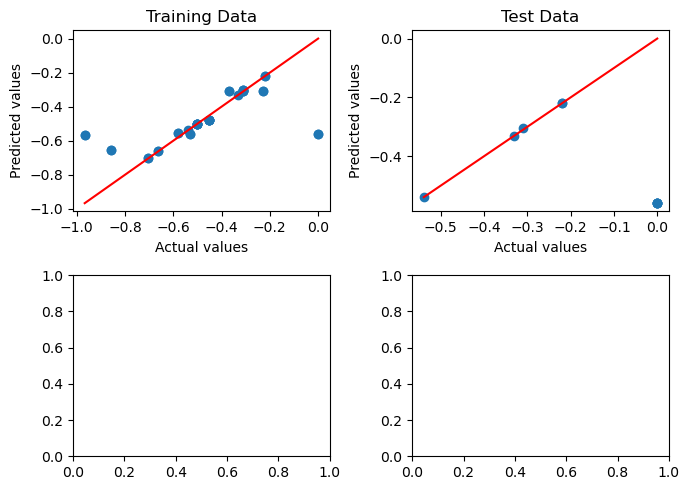

[c] Epoch [1340/2000], Loss: 0.0263
Train R²:  0.44505
Test R² :  -3.73134


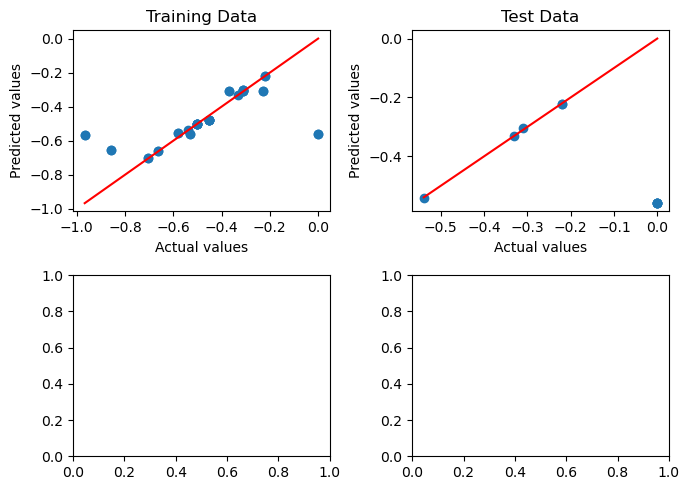

[c] Epoch [1360/2000], Loss: 0.0263
Train R²:  0.44587
Test R² :  -3.72853


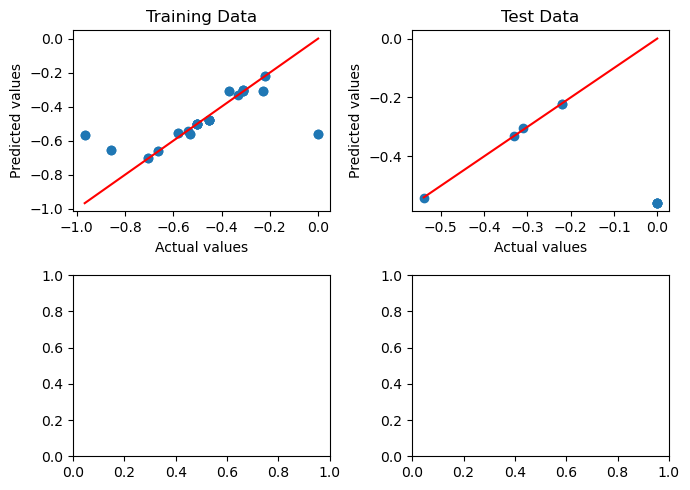

[c] Epoch [1380/2000], Loss: 0.0262
Train R²:  0.44666
Test R² :  -3.71414


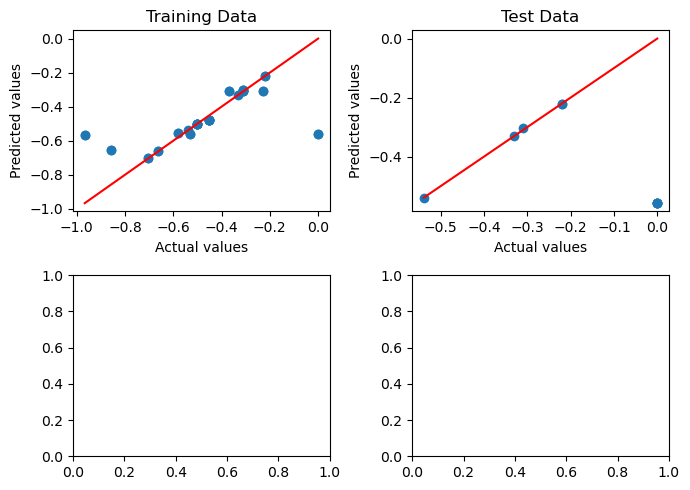

[c] Epoch [1400/2000], Loss: 0.0262
Train R²:  0.44745
Test R² :  -3.71021


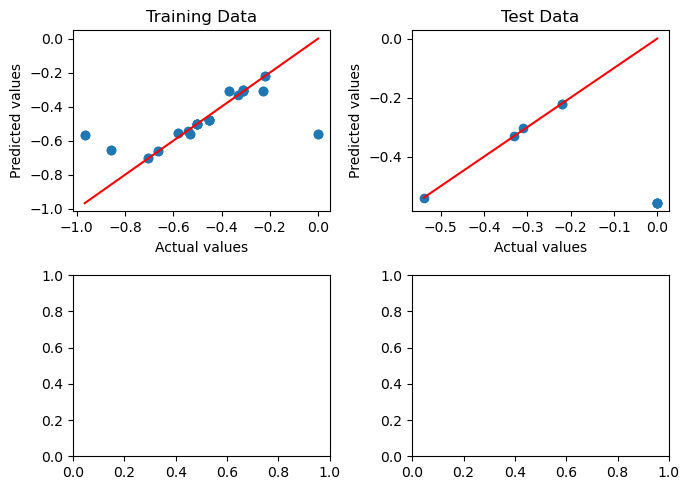

[c] Epoch [1420/2000], Loss: 0.0262
Train R²:  0.44828
Test R² :  -3.70475


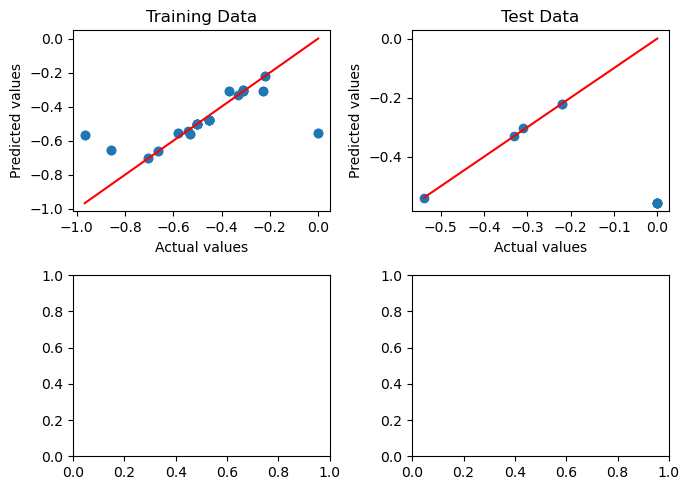

[c] Epoch [1440/2000], Loss: 0.0261
Train R²:  0.44907
Test R² :  -3.68573


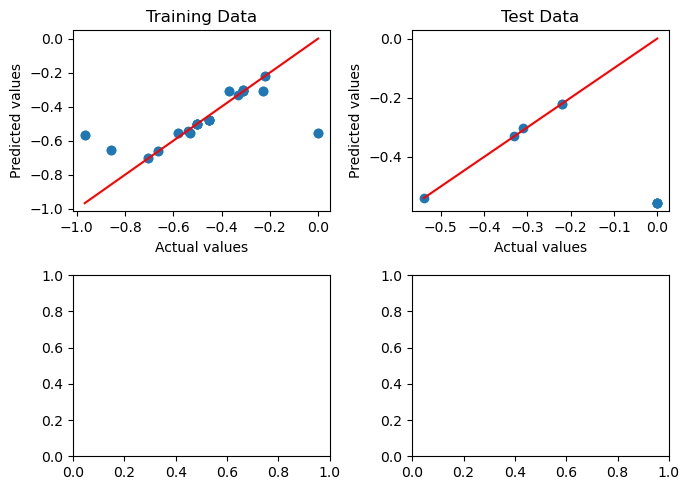

[c] Epoch [1460/2000], Loss: 0.0261
Train R²:  0.44996
Test R² :  -3.69234


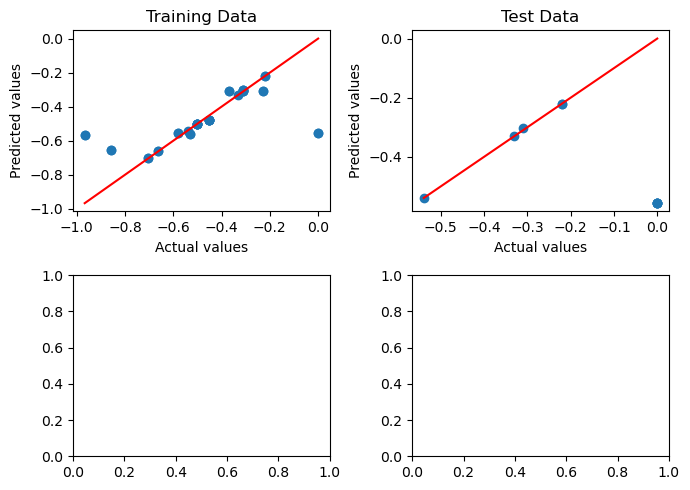

[c] Epoch [1480/2000], Loss: 0.0260
Train R²:  0.45079
Test R² :  -3.66848


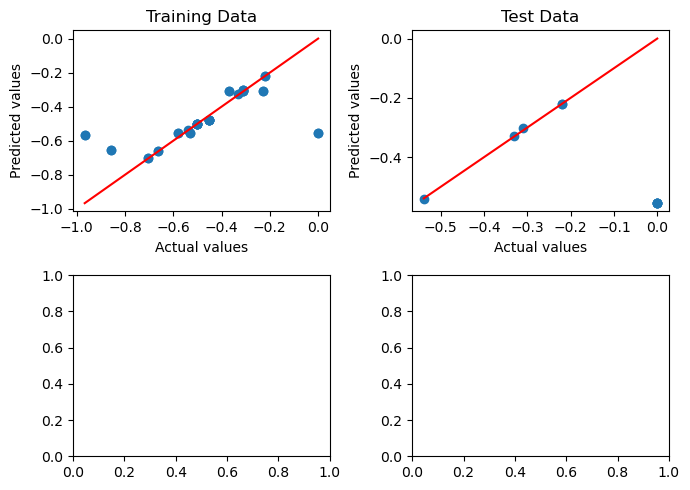

[c] Epoch [1500/2000], Loss: 0.0260
Train R²:  0.45170
Test R² :  -3.66906


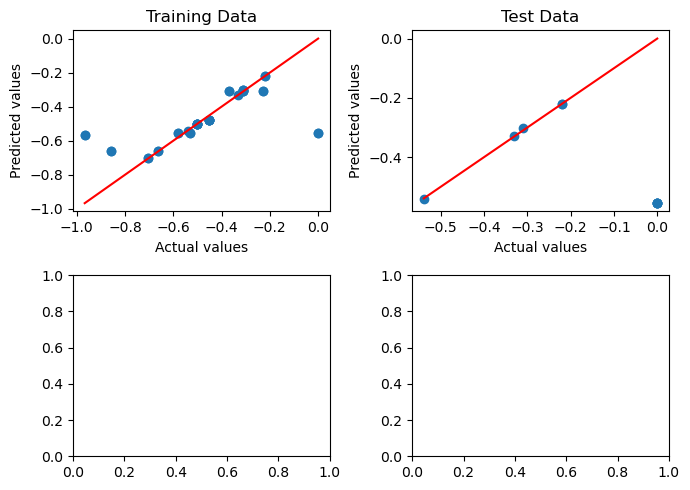

[c] Epoch [1520/2000], Loss: 0.0260
Train R²:  0.45262
Test R² :  -3.65946


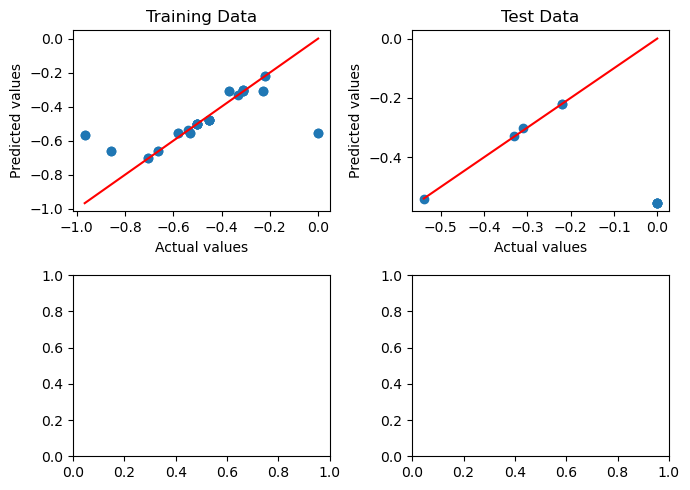

[c] Epoch [1540/2000], Loss: 0.0259
Train R²:  0.45350
Test R² :  -3.64464


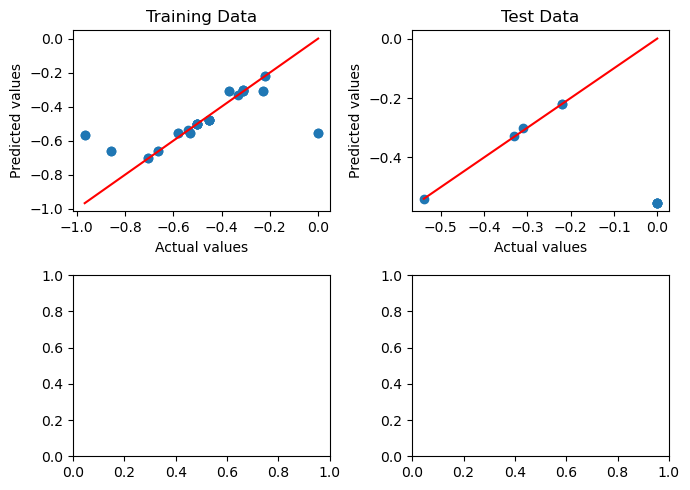

[c] Epoch [1560/2000], Loss: 0.0259
Train R²:  0.45430
Test R² :  -3.64535


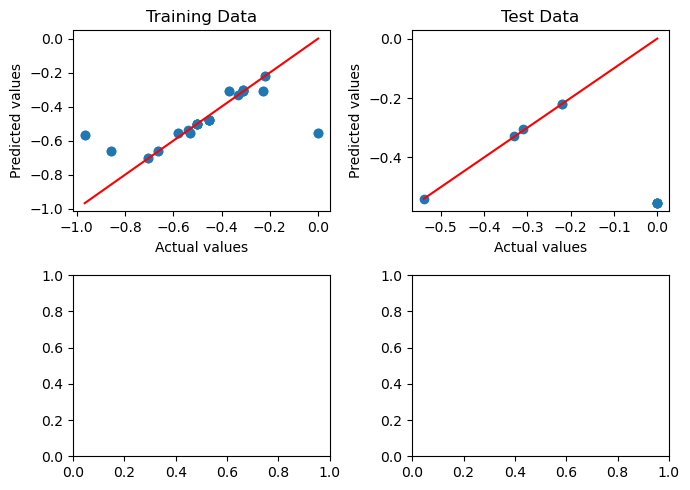

[c] Epoch [1580/2000], Loss: 0.0258
Train R²:  0.45523
Test R² :  -3.62570


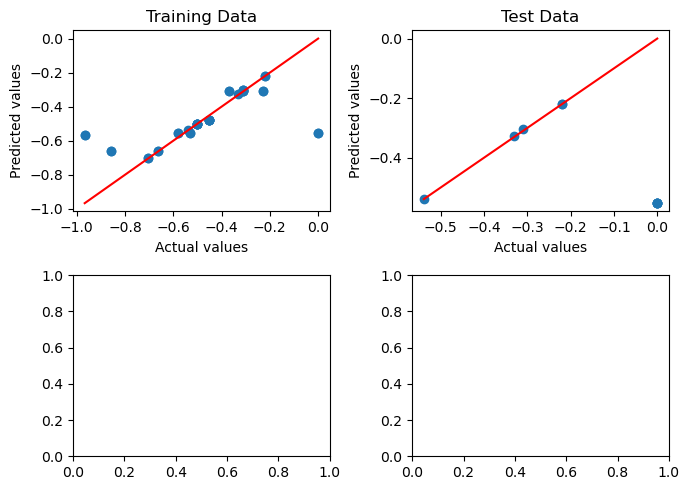

[c] Epoch [1600/2000], Loss: 0.0258
Train R²:  0.45622
Test R² :  -3.63002


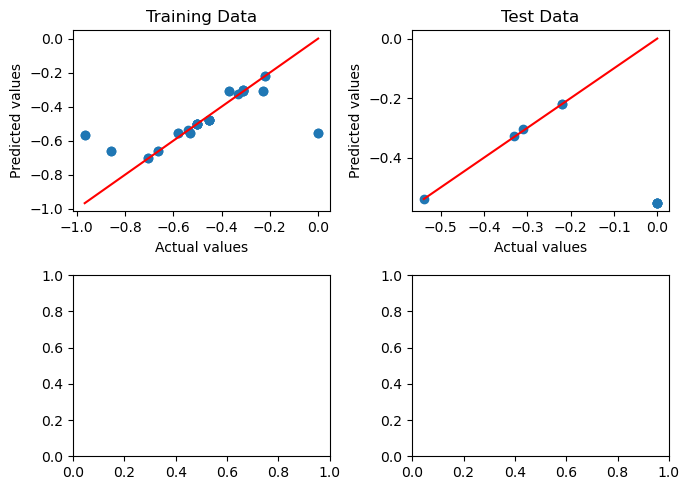

[c] Epoch [1620/2000], Loss: 0.0257
Train R²:  0.45716
Test R² :  -3.60545


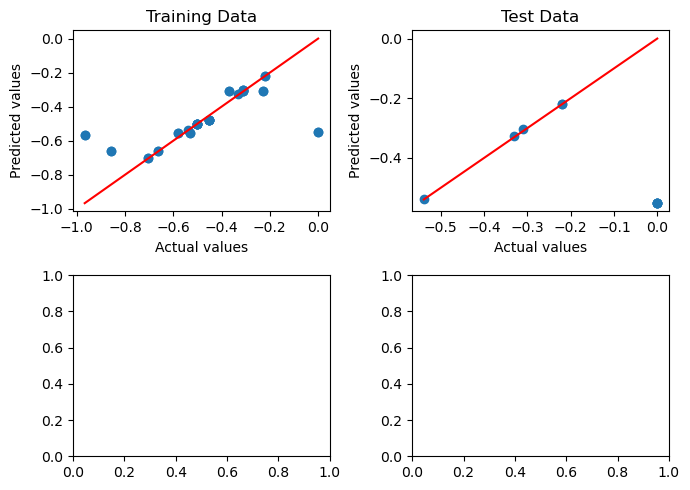

[c] Epoch [1640/2000], Loss: 0.0257
Train R²:  0.45790
Test R² :  -3.60042


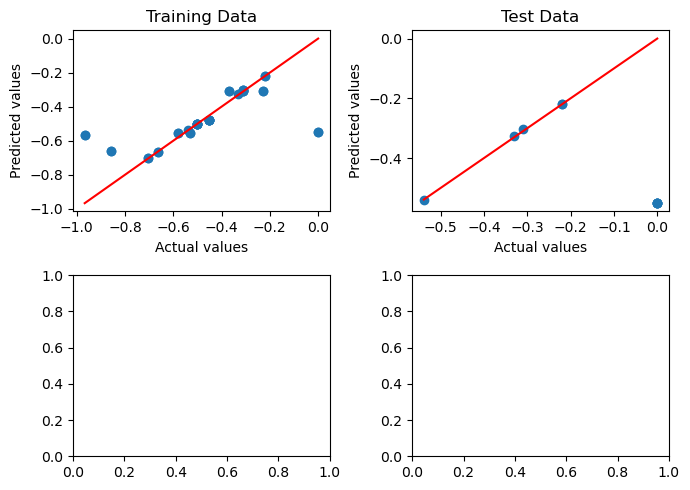

[c] Epoch [1660/2000], Loss: 0.0257
Train R²:  0.45891
Test R² :  -3.58798


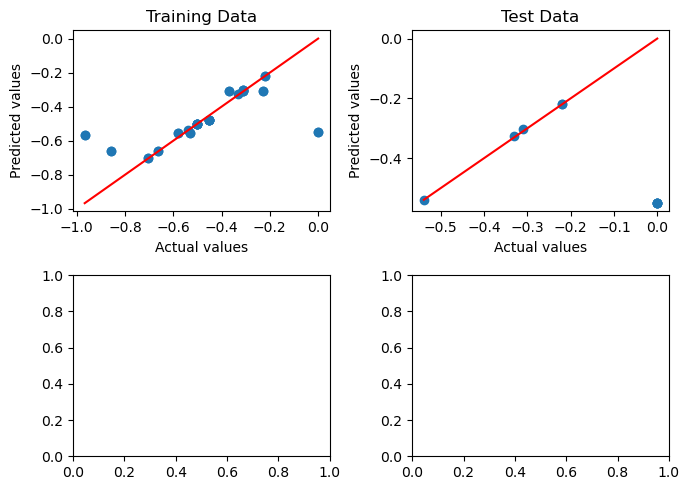

[c] Epoch [1680/2000], Loss: 0.0256
Train R²:  0.46002
Test R² :  -3.58629


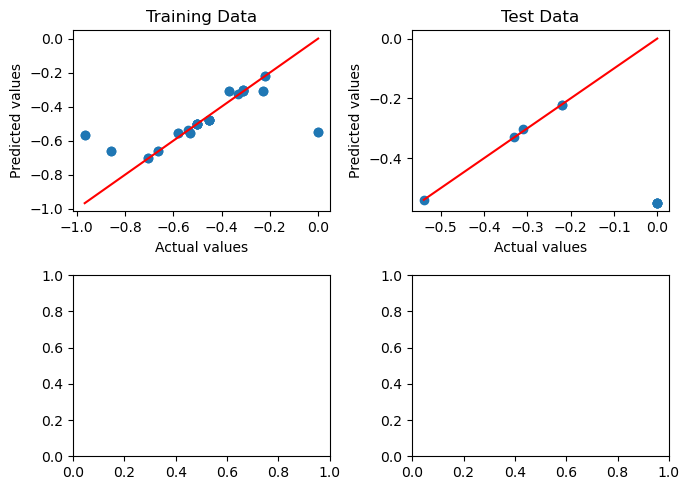

[c] Epoch [1700/2000], Loss: 0.0256
Train R²:  0.46106
Test R² :  -3.56613


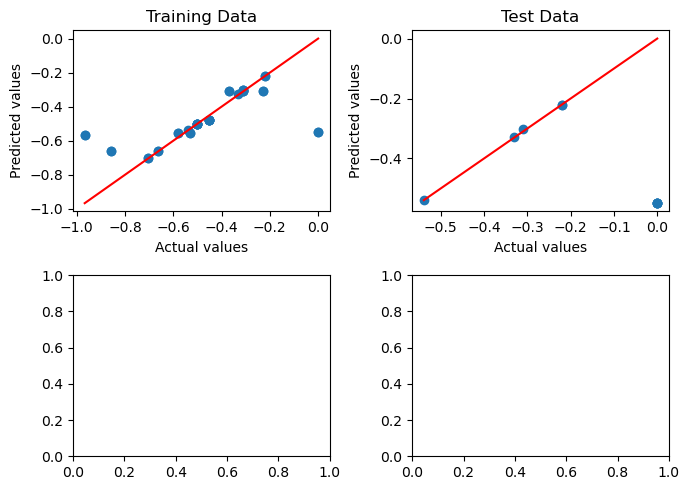

[c] Epoch [1720/2000], Loss: 0.0255
Train R²:  0.46207
Test R² :  -3.56432


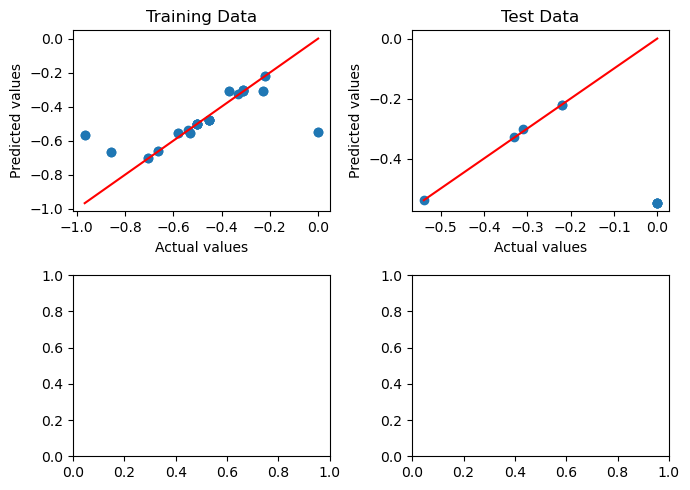

[c] Epoch [1740/2000], Loss: 0.0255
Train R²:  0.46309
Test R² :  -3.56224


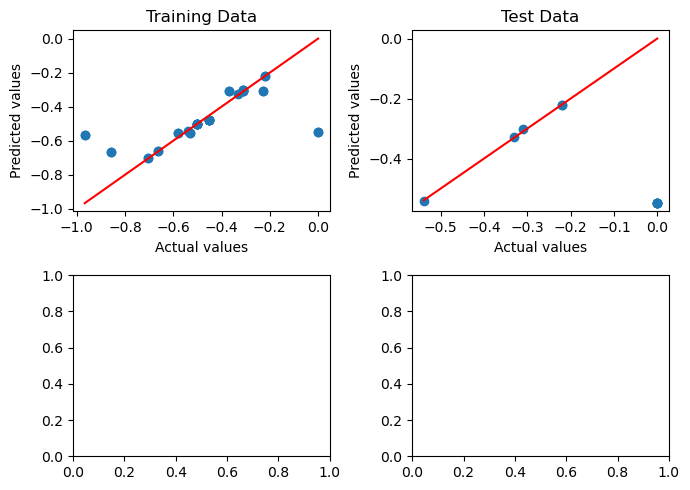

[c] Epoch [1760/2000], Loss: 0.0254
Train R²:  0.46408
Test R² :  -3.53687


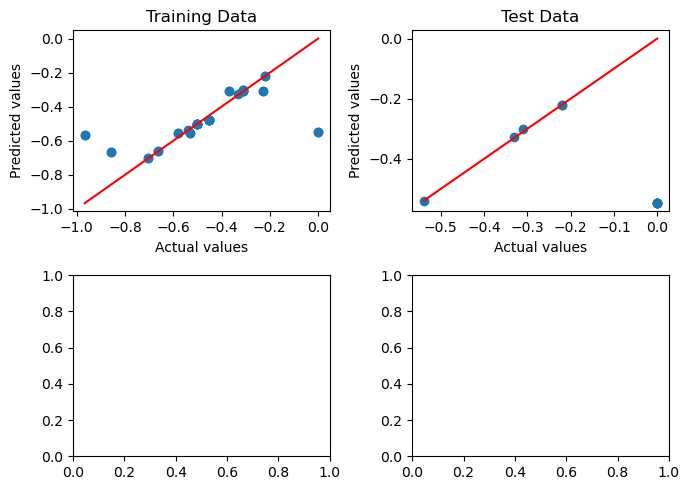

[c] Epoch [1780/2000], Loss: 0.0254
Train R²:  0.46525
Test R² :  -3.53054


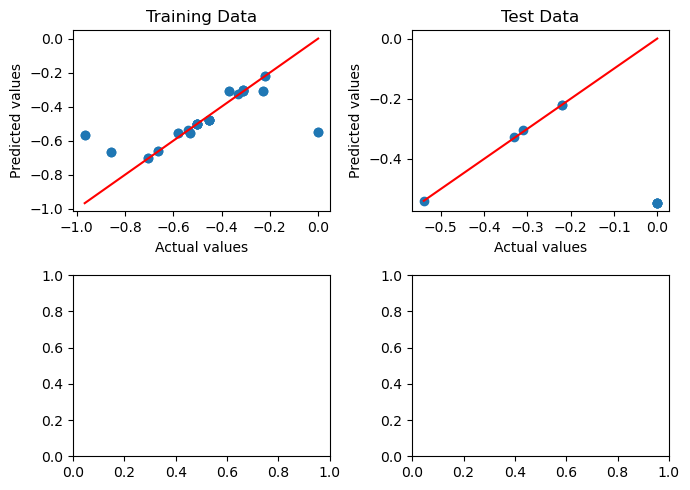

[c] Epoch [1800/2000], Loss: 0.0253
Train R²:  0.46628
Test R² :  -3.51561


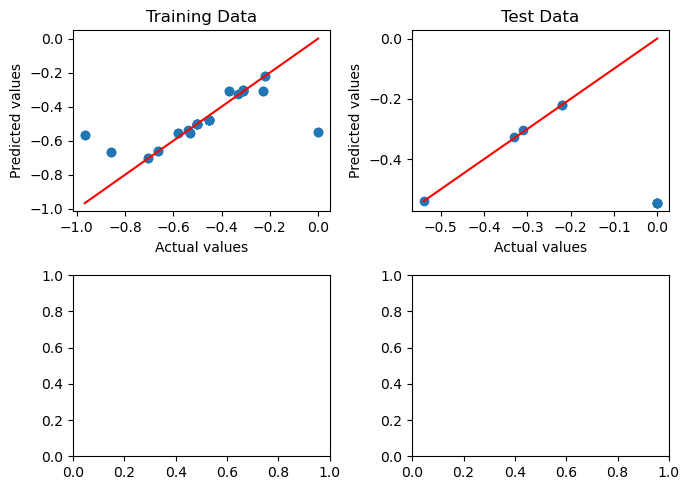

[c] Epoch [1820/2000], Loss: 0.0253
Train R²:  0.46744
Test R² :  -3.51807


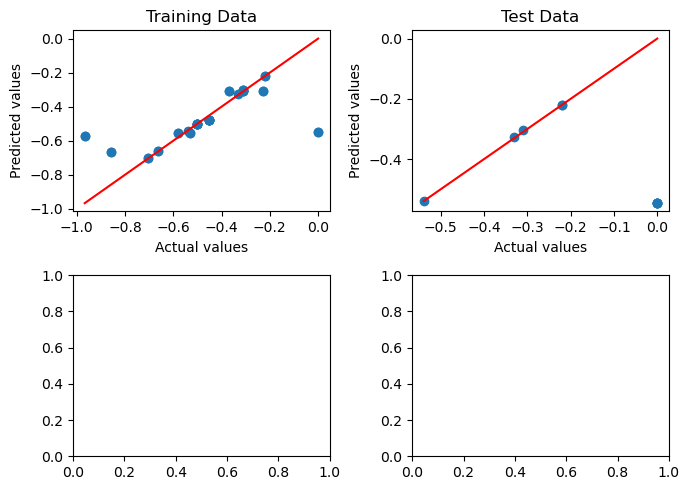

[c] Epoch [1840/2000], Loss: 0.0252
Train R²:  0.46856
Test R² :  -3.49403


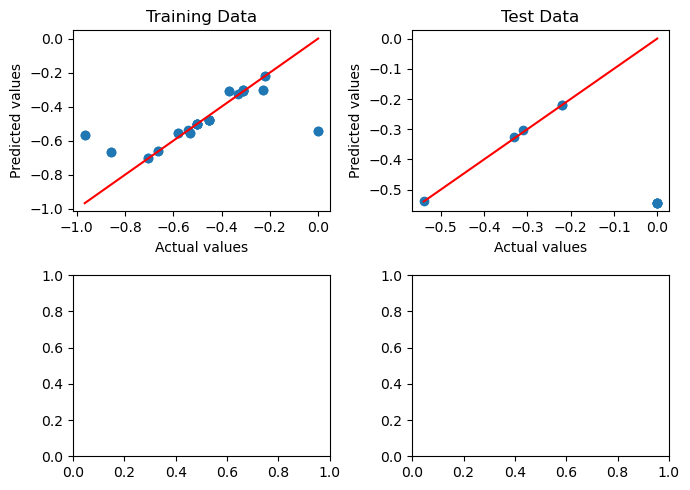

[c] Epoch [1860/2000], Loss: 0.0252
Train R²:  0.46946
Test R² :  -3.47393


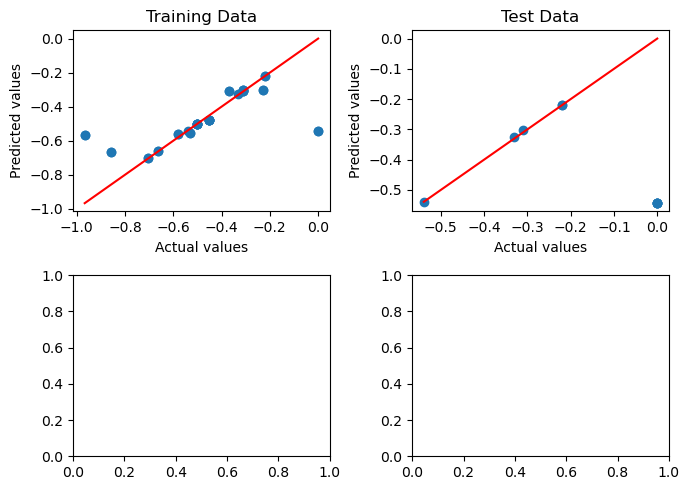

[c] Epoch [1880/2000], Loss: 0.0251
Train R²:  0.47085
Test R² :  -3.46815


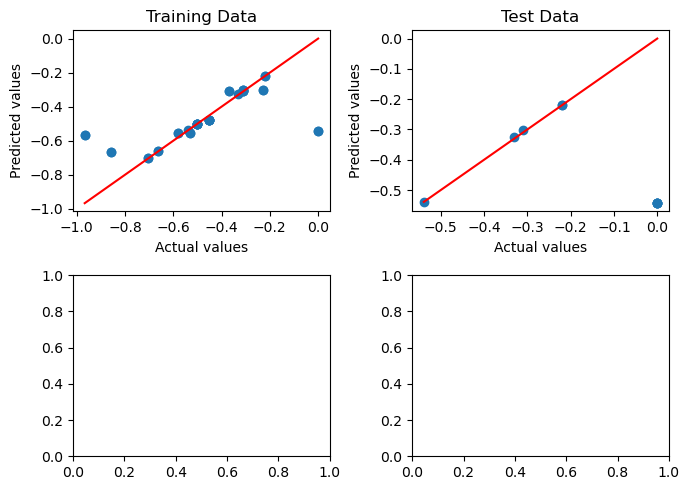

[c] Epoch [1900/2000], Loss: 0.0250
Train R²:  0.47203
Test R² :  -3.46695


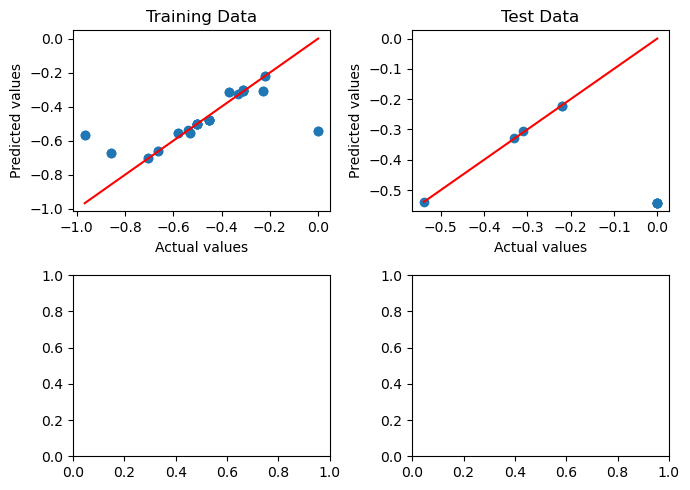

[c] Epoch [1920/2000], Loss: 0.0250
Train R²:  0.47318
Test R² :  -3.46128


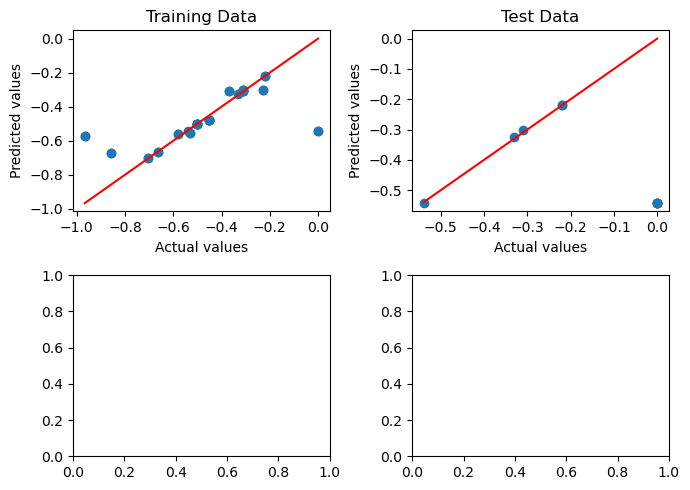

[c] Epoch [1940/2000], Loss: 0.0249
Train R²:  0.47439
Test R² :  -3.43318


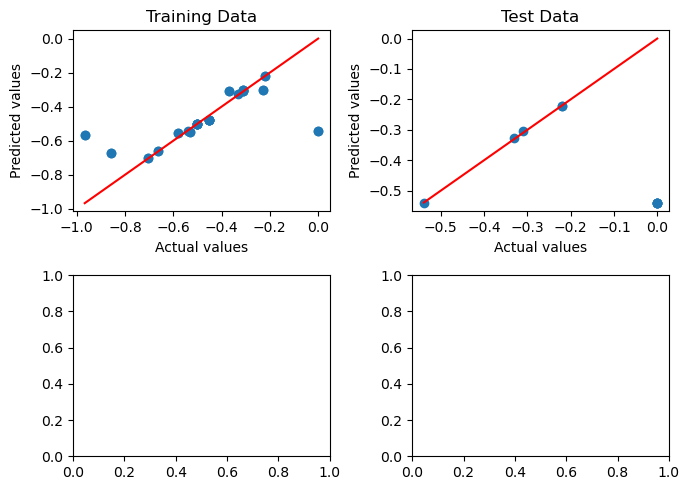

[c] Epoch [1960/2000], Loss: 0.0249
Train R²:  0.47565
Test R² :  -3.42412


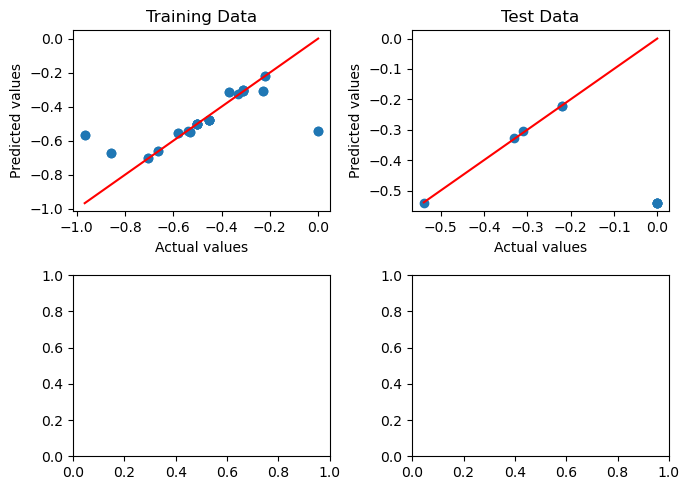

[c] Epoch [1980/2000], Loss: 0.0248
Train R²:  0.47698
Test R² :  -3.43684


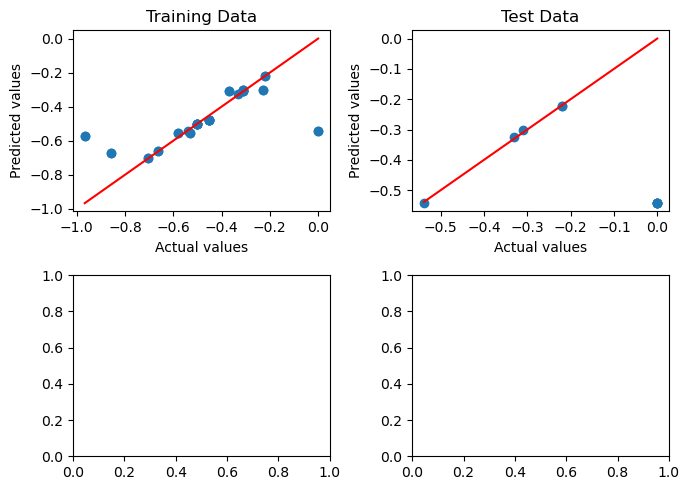

[c] Epoch [2000/2000], Loss: 0.0247
Train R²:  0.47842
Test R² :  -3.41659


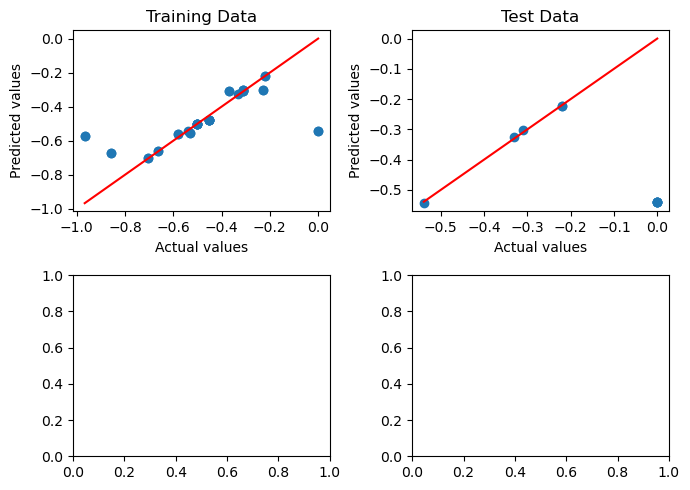

In [10]:
DNN(7)

---

# Pure GBR

In [25]:
def GBR(variable):
    name_list = ["Sigmaf", "b", "Epsilonf", "c"]

    # Prepare the data
    df_x = pd.read_excel(root,usecols=[0,1,2,3])
    df_y = pd.read_excel(root,usecols=[variable])
    
    X_train, X_test, y_train, y_test = train_test_split(df_x, df_y, test_size = 0.2, random_state = 42)
    
    y_train = np.array(y_train,dtype = np.float32).ravel()
    y_test = np.array(y_test,dtype = np.float32).ravel()
    
    # Train the Gradient Boosting Regressor #Original: 10000, 0.01, 2, tol 1e-5
    gbr = GradientBoostingRegressor(n_estimators = 10000, learning_rate = 0.01, max_depth = 2, random_state = 42, tol = 1e-5)
    gbr.fit(X_train, y_train)
    
    # Get the predictions from Gradient Boosting Regressor
    y_train_pred = gbr.predict(X_train)
    y_test_pred = gbr.predict(X_test)

    # R2 Scores
    r2_train = r2_score(y_train, y_train_pred)
    r2_test  = r2_score(y_test, y_test_pred)

    print(f'[{name_list[variable-4]}]')
    print("Train R²: ", "%.5f" % round(r2_train, 5))
    print("Test R² : ", "%.5f" % round(r2_test, 5))

    fig, axes = plt.subplots(2, 2, figsize = (7,5))
    axes[0, 0].scatter(y_train, y_train_pred)
    axes[0, 0].plot([min(y_train), max(y_train)],[min(y_train), max(y_train)], color = 'r')
    axes[0, 0].set_title("Training Data")
    axes[0, 0].set_xlabel("Actual values")
    axes[0, 0].set_ylabel("Predicted values")

    axes[0, 1].scatter(y_test, y_test_pred)
    axes[0, 1].plot([min(y_test), max(y_test)],[min(y_test), max(y_test)], color = 'r')
    axes[0, 1].set_title("Test Data")
    axes[0, 1].set_xlabel("Actual values")
    axes[0, 1].set_ylabel("Predicted values")

    axes[1, 0].plot(y_train,'tab:orange', label = 'real')
    axes[1, 0].plot(y_train_pred,'tab:green',label = 'pred')
    axes[1, 0].set_xlabel("Sample Number")
    axes[1, 0].set_ylabel("Fatigue Constant Value")
    axes[1, 0].legend()

    axes[1, 1].plot(y_test, 'tab:orange',label = 'real')
    axes[1, 1].plot(y_test_pred,'tab:green',label = 'pred')
    axes[1, 1].set_xlabel("Sample Number")
    axes[1, 1].set_ylabel("Fatigue Constant Value")
    axes[1, 1].legend()
    plt.show()

[Sigmaf]
Train R²:  1.00000
Test R² :  1.00000


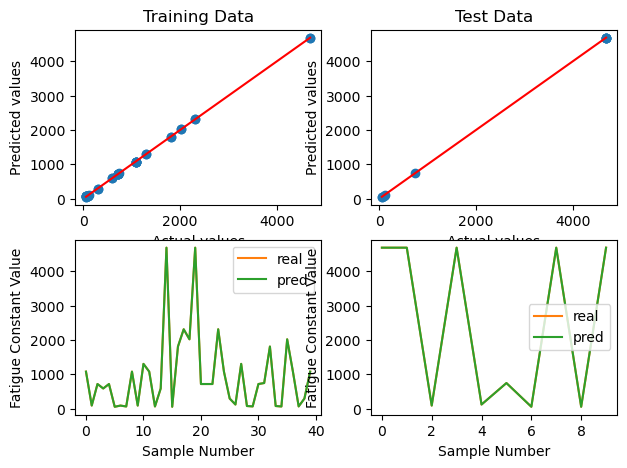

In [26]:
GBR(4)

[b]
Train R²:  1.00000
Test R² :  1.00000


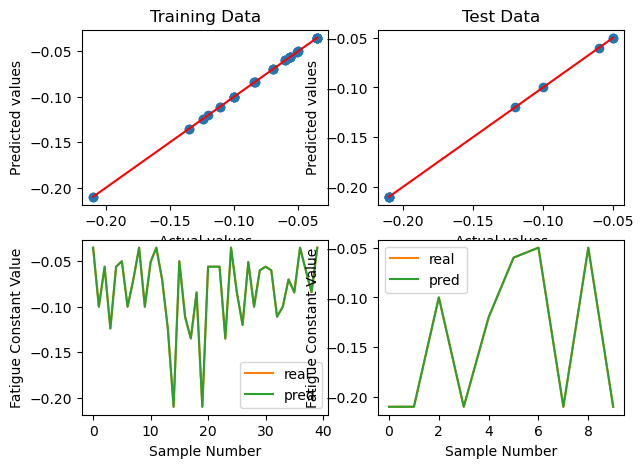

In [27]:
GBR(5)

[Epsilonf]
Train R²:  1.00000
Test R² :  1.00000


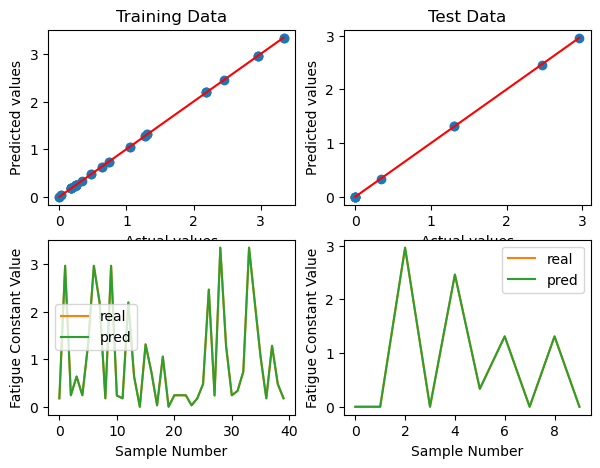

In [28]:
GBR(6)

[c]
Train R²:  1.00000
Test R² :  1.00000


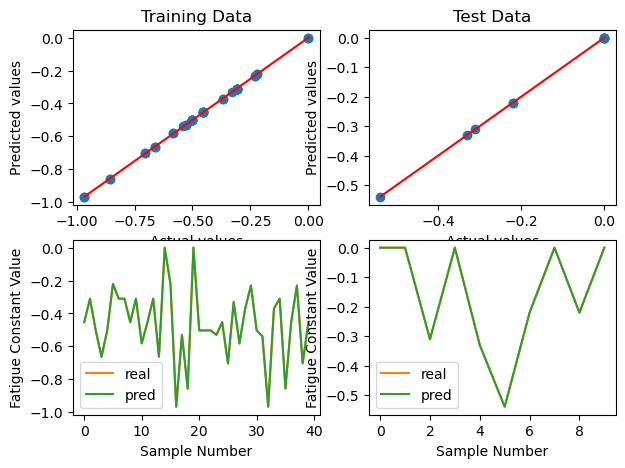

In [29]:
GBR(7)